# Notebook 3 - k-means Clustering


> Test for blockquote

<blockquote> Test for blockquote </blockquote>

`test for code hightlight`

```Python
str = "Test for writing code"
print(str)
```

The following work is the main clustering process for the project, including data loading and preparation, log normalization, feature selection through Pearson correlation and dendogram analysis, clustering process, and result visualization. The clustering in k-means including elbow plots. The visual representation of the clustering results including crossplots, KDEs, histograms, and well log plots. Also included testing using another clustering method for discussion purposes, such as GMM.


## Load Libraries


In [2]:
import pandas as pd
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch, PathPatch
from matplotlib.ticker import LogLocator

import math
from math import log, log10, log2, log1p

import seaborn as sns
import plotly.graph_objects as go

from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from scipy.spatial.distance import squareform

from sklearn.preprocessing import StandardScaler, PowerTransformer, MinMaxScaler
from sklearn.cluster import KMeans
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.mixture import GaussianMixture

## Clustering model
import scipy.cluster.hierarchy as sch
from sklearn.cluster import AgglomerativeClustering

## Import well file (CSV format)

Import data from well file (CSV) to a pandas Dataframe called **data**. All datasets used is from an open-sourced geoscience subsurface data from _FORCE 2020 lithofacies prediction from well logs competition_, including well log las files, csv file data, NPD lithostratigraphy, well X-Y positions. The following will use training well data and hidden test data.


In [2]:
#Load data with new stratigraphy
data = pd.read_csv('mergedata.csv', sep=',')

#data = pd.read_csv("cenozoic_mergedata.csv", sep=',')
#data = pd.read_csv("cretaceous_mergedata.csv", sep=',')
#data = pd.read_csv("jurassic_mergedata.csv", sep=',')
#data = pd.read_csv("triassic_mergedata.csv", sep=',')
#data = pd.read_csv("lowertriassic_mergedata.csv", sep=',')

data = data[data.columns[1:]]

#well.head()
#data.dropna(subset=['RXO'])
#data['DEPTH'] = data['DEPTH'].abs()
#data.sample(10)
data.head(10)

C:\Users\V330\AppData\Local\Temp\ipykernel_29972\3064618148.py:2: DtypeWarning: Columns (20,21) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('mergedata.csv', sep=',')


,WELL,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,...,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY,GROUP,FORMATION,GROUP_NEW,FORMATION_NEW
0,15/9-23,1518.280,15.506232,NaN,NaN,0.878615,NaN,103.451515,NaN,0.439925,...,17.5,326.451263,0.109706,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
1,15/9-23,1518.432,18.524611,NaN,NaN,0.874237,NaN,94.124893,NaN,0.504055,...,17.5,322.926361,-0.006418,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
2,15/9-23,1518.584,18.855669,NaN,NaN,0.869858,NaN,93.586487,NaN,0.512960,...,17.5,325.283142,0.022769,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
3,15/9-23,1518.736,19.163353,NaN,NaN,0.865479,NaN,91.113373,NaN,0.500070,...,17.5,334.233185,0.024972,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
4,15/9-23,1518.888,18.489744,NaN,0.849849,0.863804,NaN,100.228333,NaN,0.277670,...,17.5,330.952362,0.024527,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
5,15/9-23,1519.040,15.919361,NaN,0.929877,0.882300,NaN,97.489906,NaN,0.300810,...,17.5,316.437927,0.019025,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
6,15/9-23,1519.192,13.566401,NaN,0.973370,0.918941,NaN,96.966949,NaN,0.404170,...,17.5,316.381134,-0.008151,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
7,15/9-23,1519.344,12.201807,NaN,1.020846,0.948801,NaN,105.671333,NaN,0.359548,...,17.5,319.537354,-0.029403,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
8,15/9-23,1519.496,12.069018,NaN,1.064951,1.015625,NaN,111.120483,NaN,0.345833,...,17.5,328.520630,-0.051000,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.
9,15/9-23,1519.648,12.012268,NaN,1.079303,1.046690,NaN,100.817406,NaN,0.421200,...,17.5,335.690613,-0.084551,NaN,NaN,65000,HORDALAND GP.,Skade Fm.,HORDALAND GP.,Frigg Fm.


In [3]:
# If using old stratigraphy
#data = pd.read_csv('mergedata_old.csv', sep=',')

data = pd.read_csv("cenozoic_mergedata_old.csv", sep=',')
#data = pd.read_csv("cretaceous_mergedata_old.csv", sep=',')
#data = pd.read_csv("jurassic_mergedata_old.csv", sep=',')
#data = pd.read_csv("triassic_mergedata_old.csv", sep=',')
#data = pd.read_csv("lowertriassic_mergedata_old.csv", sep=',')

data = data[data.columns[1:]]


#well.head()
#data.dropna(subset=['RXO'])
#data['DEPTH'] = data['DEPTH'].abs()
#data.sample(10)
data.head(10)

,WELL,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,...,DTC,SP,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY,GROUP,FORMATION
0,15/9-13,494.528,19.480835,NaN,1.611410,1.798681,1.884186,80.200851,NaN,NaN,...,161.131180,24.612379,NaN,NaN,-0.574928,NaN,NaN,65000,NORDLAND GP.,NaN
1,15/9-13,494.680,19.468800,NaN,1.618070,1.795641,1.889794,79.262886,NaN,NaN,...,160.603470,23.895531,NaN,NaN,-0.570188,NaN,NaN,65000,NORDLAND GP.,NaN
2,15/9-13,494.832,19.468800,NaN,1.626459,1.800733,1.896523,74.821999,NaN,NaN,...,160.173615,23.916357,NaN,NaN,-0.574245,NaN,NaN,65000,NORDLAND GP.,NaN
3,15/9-13,494.984,19.459282,NaN,1.621594,1.801517,1.891913,72.878922,NaN,NaN,...,160.149429,23.793688,NaN,NaN,-0.586315,NaN,NaN,65000,NORDLAND GP.,NaN
4,15/9-13,495.136,19.453100,NaN,1.602679,1.795299,1.880034,71.729141,NaN,NaN,...,160.128342,24.104078,NaN,NaN,-0.597914,NaN,NaN,65000,NORDLAND GP.,NaN
5,15/9-13,495.288,19.453100,NaN,1.585567,1.804719,1.879687,72.014420,NaN,NaN,...,160.149292,23.931278,NaN,NaN,-0.601600,NaN,NaN,65000,NORDLAND GP.,NaN
6,15/9-13,495.440,19.462496,NaN,1.576569,1.805498,1.878731,72.588089,NaN,NaN,...,161.250381,23.381790,NaN,NaN,-0.598369,NaN,NaN,65000,NORDLAND GP.,NaN
7,15/9-13,495.592,19.468800,NaN,1.587011,1.808367,1.867837,71.283051,NaN,NaN,...,162.214416,23.632166,NaN,NaN,-0.602039,NaN,NaN,65000,NORDLAND GP.,NaN
8,15/9-13,495.744,19.468800,NaN,1.613674,1.815813,1.847233,69.721436,NaN,NaN,...,161.575104,22.163542,NaN,NaN,-0.614364,NaN,NaN,65000,NORDLAND GP.,NaN
9,15/9-13,495.896,19.468800,NaN,1.634622,1.813916,1.836309,66.677727,NaN,NaN,...,160.583359,23.659925,NaN,NaN,-0.621813,NaN,NaN,65000,NORDLAND GP.,NaN


In [4]:
#Check statistics of each column
data.describe()

,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY
count,583733.000000,518564.000000,281050.000000,566261.000000,581591.000000,458109.000000,583733.000000,14832.000000,260074.000000,328620.000000,531397.000000,469608.000000,315169.000000,55214.000000,442570.000000,60667.000000,141195.000000,583733.000000
mean,1400.448605,15.600446,1.570994,2.227187,1.228082,2.064709,66.854247,58.553594,0.455029,6.732521,140.014502,53.438244,14.033136,325.313458,0.002194,1.186352,-133.466761,61347.116750
std,517.487115,3.378256,21.724611,45.430846,7.438579,0.180166,29.212827,16.515113,0.102029,11.740457,18.961345,73.390659,3.081716,80.876227,0.130373,30.475629,350.052477,13665.104593
min,136.086000,6.268975,0.005141,0.039904,0.031701,1.005849,0.624403,19.446173,-0.000180,0.351116,7.415132,-400.000000,8.500000,69.163177,-6.043000,0.056586,-999.900024,30000.000000
25%,1016.081023,12.618999,0.701000,0.719546,0.717278,1.982386,46.218605,46.137317,0.407349,3.067578,132.021606,28.499394,12.250001,273.255432,-0.009511,0.479074,0.479589,65000.000000
50%,1399.267200,15.886572,0.907650,0.924558,0.939069,2.075663,63.377834,62.219118,0.461261,4.161247,142.561981,50.763792,12.250001,335.727783,0.003582,0.771412,0.817448,65000.000000
75%,1777.758400,18.142486,1.241652,1.243724,1.315329,2.171872,82.942894,70.316301,0.506620,6.501336,151.116379,71.442766,17.500000,385.422073,0.028782,1.118863,1.268546,65000.000000
max,2705.920000,28.278999,1999.936157,1950.000000,1932.446289,3.357802,529.875671,133.587250,0.999570,383.129974,320.478882,526.547302,26.000002,676.578125,1.773997,6567.910156,11907.053711,99000.000000


In [5]:
# Filter invalid data 
data.loc[data['RXO'] < 0, 'RXO'] = np.NaN
data.loc[data['RMED'] < 0, 'RMED'] = np.NaN
data.loc[data['SP'] < -998, 'SP'] = np.NaN
data.loc[data['DRHO'] < -999, 'DRHO'] = np.NaN
data.loc[data['SGR'] < 0, 'SGR'] = np.NaN
data.describe()

,DEPTH_MD,CALI,RSHA,RMED,RDEP,RHOB,GR,SGR,NPHI,PEF,DTC,SP,BS,DTS,DRHO,RMIC,RXO,LITHOLOGY
count,583733.000000,518564.000000,281050.000000,566261.000000,581591.000000,458109.000000,583733.000000,14832.000000,260074.000000,328620.000000,531397.000000,469608.000000,315169.000000,55214.000000,442570.000000,60667.000000,121953.000000,583733.000000
mean,1400.448605,15.600446,1.570994,2.227187,1.228082,2.064709,66.854247,58.553594,0.455029,6.732521,140.014502,53.438244,14.033136,325.313458,0.002194,1.186352,3.181668,61347.116750
std,517.487115,3.378256,21.724611,45.430846,7.438579,0.180166,29.212827,16.515113,0.102029,11.740457,18.961345,73.390659,3.081716,80.876227,0.130373,30.475629,69.544667,13665.104593
min,136.086000,6.268975,0.005141,0.039904,0.031701,1.005849,0.624403,19.446173,-0.000180,0.351116,7.415132,-400.000000,8.500000,69.163177,-6.043000,0.056586,0.100000,30000.000000
25%,1016.081023,12.618999,0.701000,0.719546,0.717278,1.982386,46.218605,46.137317,0.407349,3.067578,132.021606,28.499394,12.250001,273.255432,-0.009511,0.479074,0.638614,65000.000000
50%,1399.267200,15.886572,0.907650,0.924558,0.939069,2.075663,63.377834,62.219118,0.461261,4.161247,142.561981,50.763792,12.250001,335.727783,0.003582,0.771412,0.919264,65000.000000
75%,1777.758400,18.142486,1.241652,1.243724,1.315329,2.171872,82.942894,70.316301,0.506620,6.501336,151.116379,71.442766,17.500000,385.422073,0.028782,1.118863,1.356298,65000.000000
max,2705.920000,28.278999,1999.936157,1950.000000,1932.446289,3.357802,529.875671,133.587250,0.999570,383.129974,320.478882,526.547302,26.000002,676.578125,1.773997,6567.910156,11907.053711,99000.000000


## Columns list

Including renaming them to make it easier to call the column


In [5]:
# If using new stratigraphy
data.rename(columns = {'DEPTH_MD':'DEPTH'}, inplace = True)
data= data[['WELL', 'DEPTH', 'CALI','RSHA','RMED','RDEP','RXO','RMIC','GR','SGR','NPHI','PEF','RHOB','SP','BS','DRHO','DTC','DTS', 'LITHOLOGY', 'GROUP_NEW', 'FORMATION_NEW']]
data.rename(columns = {'FORMATION_NEW':'FORMATION'}, inplace = True)
data.rename(columns = {'GROUP_NEW':'GROUP'}, inplace = True)

data.columns

Index(['WELL', 'DEPTH', 'CALI', 'RSHA', 'RMED', 'RDEP', 'RXO', 'RMIC', 'GR',
       'SGR', 'NPHI', 'PEF', 'RHOB', 'SP', 'BS', 'DRHO', 'DTC', 'DTS',
       'LITHOLOGY', 'GROUP', 'FORMATION'],
      dtype='object')

In [6]:
# If using old stratigraphy
data.rename(columns = {'DEPTH_MD':'DEPTH'}, inplace = True)
data= data[['WELL', 'DEPTH', 'CALI','RSHA','RMED','RDEP','RXO','RMIC','GR','SGR','NPHI','PEF','RHOB','SP','BS','DRHO','DTC','DTS', 'LITHOLOGY', 'GROUP', 'FORMATION']]
data.columns

Index(['WELL', 'DEPTH', 'CALI', 'RSHA', 'RMED', 'RDEP', 'RXO', 'RMIC', 'GR',
       'SGR', 'NPHI', 'PEF', 'RHOB', 'SP', 'BS', 'DRHO', 'DTC', 'DTS',
       'LITHOLOGY', 'GROUP', 'FORMATION'],
      dtype='object')

In [7]:
well = data.copy()
well

,WELL,DEPTH,CALI,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,...,PEF,RHOB,SP,BS,DRHO,DTC,DTS,LITHOLOGY,GROUP,FORMATION
0,15/9-13,494.5280,19.480835,NaN,1.611410,1.798681,NaN,NaN,80.200851,NaN,...,20.915468,1.884186,24.612379,NaN,-0.574928,161.131180,NaN,65000,NORDLAND GP.,NaN
1,15/9-13,494.6800,19.468800,NaN,1.618070,1.795641,NaN,NaN,79.262886,NaN,...,19.383013,1.889794,23.895531,NaN,-0.570188,160.603470,NaN,65000,NORDLAND GP.,NaN
2,15/9-13,494.8320,19.468800,NaN,1.626459,1.800733,NaN,NaN,74.821999,NaN,...,22.591518,1.896523,23.916357,NaN,-0.574245,160.173615,NaN,65000,NORDLAND GP.,NaN
3,15/9-13,494.9840,19.459282,NaN,1.621594,1.801517,NaN,NaN,72.878922,NaN,...,32.191910,1.891913,23.793688,NaN,-0.586315,160.149429,NaN,65000,NORDLAND GP.,NaN
4,15/9-13,495.1360,19.453100,NaN,1.602679,1.795299,NaN,NaN,71.729141,NaN,...,38.495632,1.880034,24.104078,NaN,-0.597914,160.128342,NaN,65000,NORDLAND GP.,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,35/9-7,1766.2668,12.238290,NaN,1.197426,1.214096,NaN,NaN,83.147964,NaN,...,4.354927,2.345521,NaN,12.250001,0.047172,113.713493,269.392853,65000,ROGALAND GP.,EGGA FM (INFORMAL).
583729,35/9-7,1766.4188,12.153356,NaN,1.235018,1.294403,NaN,NaN,79.262672,NaN,...,4.417637,2.356758,NaN,12.250001,0.048443,107.487816,256.188995,65000,ROGALAND GP.,EGGA FM (INFORMAL).
583730,35/9-7,1766.5708,12.070336,NaN,1.271628,1.402378,NaN,NaN,74.124725,NaN,...,4.612125,2.396056,NaN,12.250001,0.058514,99.575928,240.236771,65000,ROGALAND GP.,EGGA FM (INFORMAL).
583731,35/9-7,1766.7228,12.122781,NaN,1.390259,1.549507,NaN,NaN,60.120319,NaN,...,5.024710,2.467660,NaN,12.250001,0.075756,95.313583,226.625778,65000,ROGALAND GP.,EGGA FM (INFORMAL).


## Wells List


In [8]:
well_name=data['WELL'].unique()
print(len(well_name))
well_name

80


array(['15/9-13', '15/9-15', '15/9-17', '16/1-6 A', '16/10-1', '16/10-3',
       '16/11-1 ST3', '16/2-11 A', '16/2-16', '16/2-6', '16/4-1',
       '16/7-4', '16/7-5', '16/8-1', '17/11-1', '25/11-15', '25/11-19 S',
       '25/11-5', '25/2-13 T4', '25/2-14', '25/2-7', '25/3-1', '25/4-5',
       '25/5-1', '25/5-4', '25/6-1', '25/6-2', '25/6-3', '25/7-2',
       '25/8-5 S', '25/8-7', '25/9-1', '26/4-1', '29/6-1', '30/3-3',
       '30/6-5', '31/2-1', '31/2-19 S', '31/2-7', '31/2-8', '31/2-9',
       '31/3-1', '31/3-2', '31/3-3', '31/3-4', '31/4-10', '31/4-5',
       '31/5-4 S', '31/6-5', '31/6-8', '33/9-1', '33/9-17', '34/10-19',
       '34/10-21', '34/10-35', '34/11-2 S', '34/2-4', '34/7-20',
       '34/7-21', '34/8-1', '34/8-3', '35/11-1', '35/11-11', '35/11-12',
       '35/11-6', '35/11-7', '35/12-1', '35/4-1', '35/8-6 S', '35/9-2',
       '7/1-1', '15/9-23', '16/2-7', '16/7-6', '17/4-1', '25/10-9',
       '31/2-10', '31/2-21 S', '35/11-5', '35/9-7'], dtype=object)

## Groupby lithology


In [9]:
well['LIT'] = well.loc[:, 'LITHOLOGY']
well['LIT'].isnull()
well.replace({'LIT': {30000: 'Sandstone', 
                      65030: 'Sandy Shale', 
                      65000:'Shale', 
                      80000:'Marl', 
                      74000:'Dolomite', 
                      70000:'Limestone', 
                      70032:'Chalk', 
                      88000:'Halite', 
                      86000:'Anhydrite', 
                      99000:'Volcaniclastics', 
                      90000:'Coal', 
                      93000:'Basement'}}, inplace=True)
well['LIT']=well['LIT'].astype('category')

well['LITCOLOR'] = well.loc[:, 'LITHOLOGY']
well['LITCOLOR'].isnull()
well.replace({'LITCOLOR': {30000: '#ffff00', 
                      65030: '#ffe119', 
                      65000:'#bebebe', 
                      80000:'#7cfc00', 
                      74000:'#8080ff', 
                      70000:'#80ffff', 
                      70032:'#80ffff', 
                      88000:'#7ddfbe', 
                      86000:'#ff80ff', 
                      99000:'#ff8c00', 
                      90000:'black', 
                      93000:'#ef138a'}}, inplace=True)
well['LITCOLOR']=well['LITCOLOR'].astype('category')

litoname = list(set(well['LIT']))
litocolor = {'Sandstone': '#ffff00', 
             'Sandy Shale': '#c1f80a', 
             'Shale': '#bebebe', 
             'Marl': '#069af3', 
             'Dolomite': '#8080ff', 
             'Limestone': '#80ffff', 
             'Chalk': '#7bc8f6', 
             'Halite': '#7ddfbe', 
             'Anhydrite': '#ff80ff', 
             'Volcaniclastics': '#ff8c00', 
             'Coal': 'black', 
             'Basement': '#ef138a'}



In [10]:
grouped = well.groupby('LIT', sort=False)

keys = [key for key, _ in grouped] #groupby based on unique keys or categories (1)
keys #show groupby keys or categories
#grouped.groups.keys() #groupby based on unique keys or categories (1)
#grouped.apply(display) #show groupby data

C:\Users\V330\AppData\Local\Temp\ipykernel_11160\856599071.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = well.groupby('LIT', sort=False)


['Shale',
 'Sandstone',
 'Sandy Shale',
 'Limestone',
 'Volcaniclastics',
 'Marl',
 'Dolomite',
 'Coal',
 'Chalk']

## Log normalization


In [11]:
#Using log normalized
well_log = well.copy()
well_log['GR_log2'] = well_log['GR'].apply(lambda x: log2(x))
well_log['GR_log10'] = well_log['GR'].apply(lambda x: log10(x))
well_log['GR_log1p'] = well_log['GR'].apply(lambda x: log1p(x))
well_log['GR_logn'] = well_log['GR'].apply(lambda x: log(x))


In [12]:
#Using sklearn preprocessing

ss = StandardScaler()
well_log['GR_SS'] = ss.fit_transform(well_log[['GR']])

pt_yj = PowerTransformer(method='yeo-johnson', standardize=False)
well_log['GR_PTYJ'] = pt_yj.fit_transform(well_log[['GR']])

pt_bc = PowerTransformer(method='box-cox', standardize=False)
well_log['GR_PTBC'] = pt_bc.fit_transform(well_log[['GR']])

mms = MinMaxScaler()
well_log['GR_MMS'] = mms.fit_transform(well_log[['GR']])



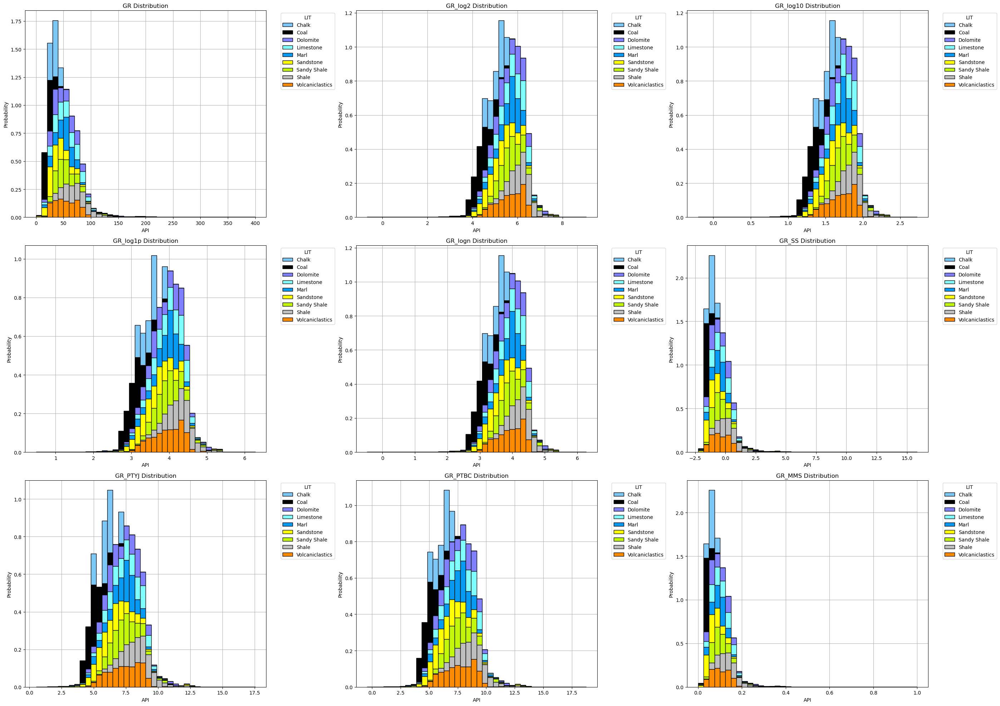

In [13]:
gr_curves=['GR', 'GR_log2', 'GR_log10', 'GR_log1p','GR_logn', 'GR_SS', 'GR_PTYJ', 'GR_PTBC', 'GR_MMS']
fig = plt.figure(figsize=(28,20))

for i, feature in enumerate(gr_curves):
    ax=fig.add_subplot(3,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    fig.suptitle('')
    
    #ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(0,10),fill=True, log_scale=False, palette=litocolor, common_norm=False)
    #ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
    #ax.set_xscale("linear")
    #ax.set_xscale("log")
    #ax.set_xlabel('API')
    
    if i==0:
        #well_log.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(0,400), fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('API')
    
    else:
        #well_log.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(800)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        #ax.set_xscale("log")
        ax=sns.histplot(data=well_log, x=feature, hue='LIT', stat='probability', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('API')
    
    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()
#plt.subplots_adjust(top=0.95)
plt.subplots_adjust(hspace=0.15, wspace=0.5)

plt.tight_layout()
plt.savefig('grlognormalization_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

In [14]:
well_log10 = well.copy()
well_log10['RSHA_log10'] = well_log10['RSHA'].apply(lambda x: log10(x))
well_log10['RMED_log10'] = well_log10['RMED'].apply(lambda x: log10(x))
well_log10['RDEP_log10'] = well_log10['RDEP'].apply(lambda x: log10(x))
well_log10['RXO_log10'] = well_log10['RXO'].apply(lambda x: log10(x))
well_log10['RMIC_log10'] = well_log10['RMIC'].apply(lambda x: log10(x))
well_log10['GR_log10'] = well_log10['GR'].apply(lambda x: log10(x))
well_log10['SGR_log10'] = well_log10['SGR'].apply(lambda x: log10(x))
well_log10['PEF_log10'] = well_log10['PEF'].apply(lambda x: log10(x))
#well_log10.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)

In [15]:
well_logn = well.copy()
well_logn['RSHA_logn'] = well_logn['RSHA'].apply(lambda x: log(x))
well_logn['RMED_logn'] = well_logn['RMED'].apply(lambda x: log(x))
well_logn['RDEP_logn'] = well_logn['RDEP'].apply(lambda x: log(x))
well_logn['RXO_logn'] = well_logn['RXO'].apply(lambda x: log(x))
well_logn['RMIC_logn'] = well_logn['RMIC'].apply(lambda x: log(x))
well_logn['GR_logn'] = well_logn['GR'].apply(lambda x: log(x))
well_logn['SGR_logn'] = well_logn['SGR'].apply(lambda x: log(x))
well_logn['PEF_logn'] = well_logn['PEF'].apply(lambda x: log(x))
#well_logn.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)


In [16]:
well_logPTYJ = well.copy()
well_logPTYJ['RSHA_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RSHA']])
well_logPTYJ['RMED_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RMED']])
well_logPTYJ['RDEP_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RDEP']])
well_logPTYJ['RXO_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RXO']])
well_logPTYJ['RMIC_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['RMIC']])
well_logPTYJ['GR_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['GR']])
well_logPTYJ['SGR_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['SGR']])
well_logPTYJ['PEF_logPTYJ'] = pt_yj.fit_transform(well_logPTYJ[['PEF']])
#well_logPTYJ.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)

In [17]:
well_log['GR_PTBC'] = pt_bc.fit_transform(well_log[['GR']])

well_logPTBC = well.copy()
well_logPTBC['RSHA_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RSHA']])
well_logPTBC['RMED_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RMED']])
well_logPTBC['RDEP_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RDEP']])
well_logPTBC['RXO_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RXO']])
well_logPTBC['RMIC_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['RMIC']])
well_logPTBC['GR_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['GR']])
well_logPTBC['SGR_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['SGR']])
well_logPTBC['PEF_logPTBC'] = pt_bc.fit_transform(well_logPTBC[['PEF']])
#well_logPTBC.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)

## Well log Correlation (Pearson)


### Data initiation

In [18]:
#Histogram on each specific column for more detail
well_corr = well.copy()
well_corr.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corr

,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,NPHI,PEF,RHOB,SP,DTC,DTS
0,NaN,1.611410,1.798681,NaN,NaN,80.200851,NaN,NaN,20.915468,1.884186,24.612379,161.131180,NaN
1,NaN,1.618070,1.795641,NaN,NaN,79.262886,NaN,NaN,19.383013,1.889794,23.895531,160.603470,NaN
2,NaN,1.626459,1.800733,NaN,NaN,74.821999,NaN,NaN,22.591518,1.896523,23.916357,160.173615,NaN
3,NaN,1.621594,1.801517,NaN,NaN,72.878922,NaN,NaN,32.191910,1.891913,23.793688,160.149429,NaN
4,NaN,1.602679,1.795299,NaN,NaN,71.729141,NaN,NaN,38.495632,1.880034,24.104078,160.128342,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,NaN,1.197426,1.214096,NaN,NaN,83.147964,NaN,0.232723,4.354927,2.345521,NaN,113.713493,269.392853
583729,NaN,1.235018,1.294403,NaN,NaN,79.262672,NaN,0.215034,4.417637,2.356758,NaN,107.487816,256.188995
583730,NaN,1.271628,1.402378,NaN,NaN,74.124725,NaN,0.213298,4.612125,2.396056,NaN,99.575928,240.236771
583731,NaN,1.390259,1.549507,NaN,NaN,60.120319,NaN,0.211477,5.024710,2.467660,NaN,95.313583,226.625778


In [19]:
#Histogram on each specific column for more detail
well_corr10 = well_log10.copy()
well_corr10.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corr10.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corr10

,NPHI,RHOB,SP,DTC,DTS,RSHA_log10,RMED_log10,RDEP_log10,RXO_log10,RMIC_log10,GR_log10,SGR_log10,PEF_log10
0,NaN,1.884186,24.612379,161.131180,NaN,NaN,0.207206,0.254954,NaN,NaN,1.904179,NaN,1.320468
1,NaN,1.889794,23.895531,160.603470,NaN,NaN,0.208997,0.254220,NaN,NaN,1.899070,NaN,1.287421
2,NaN,1.896523,23.916357,160.173615,NaN,NaN,0.211243,0.255449,NaN,NaN,1.874029,NaN,1.353945
3,NaN,1.891913,23.793688,160.149429,NaN,NaN,0.209942,0.255638,NaN,NaN,1.862602,NaN,1.507747
4,NaN,1.880034,24.104078,160.128342,NaN,NaN,0.204847,0.254137,NaN,NaN,1.855696,NaN,1.585411
...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,0.232723,2.345521,NaN,113.713493,269.392853,NaN,0.078249,0.084253,NaN,NaN,1.919852,NaN,0.638981
583729,0.215034,2.356758,NaN,107.487816,256.188995,NaN,0.091673,0.112069,NaN,NaN,1.899069,NaN,0.645190
583730,0.213298,2.396056,NaN,99.575928,240.236771,NaN,0.104360,0.146865,NaN,NaN,1.869963,NaN,0.663901
583731,0.211477,2.467660,NaN,95.313583,226.625778,NaN,0.143096,0.190194,NaN,NaN,1.779021,NaN,0.701111


In [20]:
#Histogram on each specific column for more detail
well_corrn = well_logn.copy()
well_corrn.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corrn.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corrn

,NPHI,RHOB,SP,DTC,DTS,RSHA_logn,RMED_logn,RDEP_logn,RXO_logn,RMIC_logn,GR_logn,SGR_logn,PEF_logn
0,NaN,1.884186,24.612379,161.131180,NaN,NaN,0.477109,0.587054,NaN,NaN,4.384534,NaN,3.040489
1,NaN,1.889794,23.895531,160.603470,NaN,NaN,0.481234,0.585362,NaN,NaN,4.372770,NaN,2.964397
2,NaN,1.896523,23.916357,160.173615,NaN,NaN,0.486405,0.588194,NaN,NaN,4.315112,NaN,3.117575
3,NaN,1.891913,23.793688,160.149429,NaN,NaN,0.483410,0.588629,NaN,NaN,4.288799,NaN,3.471715
4,NaN,1.880034,24.104078,160.128342,NaN,NaN,0.471677,0.585172,NaN,NaN,4.272897,NaN,3.650545
...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,0.232723,2.345521,NaN,113.713493,269.392853,NaN,0.180175,0.194000,NaN,NaN,4.420622,NaN,1.471308
583729,0.215034,2.356758,NaN,107.487816,256.188995,NaN,0.211085,0.258049,NaN,NaN,4.372767,NaN,1.485605
583730,0.213298,2.396056,NaN,99.575928,240.236771,NaN,0.240298,0.338170,NaN,NaN,4.305749,NaN,1.528689
583731,0.211477,2.467660,NaN,95.313583,226.625778,NaN,0.329490,0.437937,NaN,NaN,4.096348,NaN,1.614368


In [21]:
#Histogram on each specific column for more detail
well_corrptyj = well_logPTYJ.copy()
well_corrptyj.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corrptyj.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corrptyj

,NPHI,RHOB,SP,DTC,DTS,RSHA_logPTYJ,RMED_logPTYJ,RDEP_logPTYJ,RXO_logPTYJ,RMIC_logPTYJ,GR_logPTYJ,SGR_logPTYJ,PEF_logPTYJ
0,NaN,1.884186,24.612379,161.131180,NaN,NaN,0.465368,0.497273,NaN,NaN,8.802524,NaN,1.175511
1,NaN,1.889794,23.895531,160.603470,NaN,NaN,0.465843,0.497071,NaN,NaN,8.761711,NaN,1.168639
2,NaN,1.896523,23.916357,160.173615,NaN,NaN,0.466437,0.497408,NaN,NaN,8.563717,NaN,1.182113
3,NaN,1.891913,23.793688,160.149429,NaN,NaN,0.466093,0.497460,NaN,NaN,8.474476,NaN,1.208242
4,NaN,1.880034,24.104078,160.128342,NaN,NaN,0.464741,0.497048,NaN,NaN,8.420878,NaN,1.219125
...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,0.232723,2.345521,NaN,113.713493,269.392853,NaN,0.427714,0.444371,NaN,NaN,8.928608,NaN,0.940516
583729,0.215034,2.356758,NaN,107.487816,256.188995,NaN,0.431937,0.453781,NaN,NaN,8.761702,NaN,0.943688
583730,0.213298,2.396056,NaN,99.575928,240.236771,NaN,0.435867,0.465142,NaN,NaN,8.531883,NaN,0.953124
583731,0.211477,2.467660,NaN,95.313583,226.625778,NaN,0.447482,0.478613,NaN,NaN,7.842496,NaN,0.971342


In [22]:
#Histogram on each specific column for more detail
well_corrptbc = well_logPTBC.copy()
well_corrptbc.drop(['RSHA','RMED','RDEP', 'RXO', 'GR', 'PEF', 'SGR', 'RMIC'], axis=1, inplace=True)
well_corrptbc.drop(['WELL','DEPTH','CALI','BS', 'DRHO','LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR'], axis=1, inplace=True)
well_corrptbc

,NPHI,RHOB,SP,DTC,DTS,RSHA_logPTBC,RMED_logPTBC,RDEP_logPTBC,RXO_logPTBC,RMIC_logPTBC,GR_logPTBC,SGR_logPTBC,PEF_logPTBC
0,NaN,1.884186,24.612379,161.131180,NaN,NaN,0.428363,0.517105,NaN,NaN,9.154099,NaN,1.636468
1,NaN,1.889794,23.895531,160.603470,NaN,NaN,0.431672,0.515799,NaN,NaN,9.109809,NaN,1.617364
2,NaN,1.896523,23.916357,160.173615,NaN,NaN,0.435810,0.517984,NaN,NaN,8.895003,NaN,1.655151
3,NaN,1.891913,23.793688,160.149429,NaN,NaN,0.433414,0.518319,NaN,NaN,8.798215,NaN,1.732955
4,NaN,1.880034,24.104078,160.128342,NaN,NaN,0.423996,0.515652,NaN,NaN,8.740092,NaN,1.767679
...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,0.232723,2.345521,NaN,113.713493,269.392853,NaN,0.172907,0.185919,NaN,NaN,9.290951,NaN,1.068816
583729,0.215034,2.356758,NaN,107.487816,256.188995,NaN,0.201157,0.243884,NaN,NaN,9.109799,NaN,1.076055
583730,0.213298,2.396056,NaN,99.575928,240.236771,NaN,0.227488,0.314122,NaN,NaN,8.860474,NaN,1.097584
583731,0.211477,2.467660,NaN,95.313583,226.625778,NaN,0.305726,0.398178,NaN,NaN,8.113261,NaN,1.139149


### Precaution

In [23]:
#Only for Cenozoic wells
well_corr.drop(['SGR'], axis=1, inplace=True)
well_corr10.drop(['SGR_log10'], axis=1, inplace=True)
well_corrn.drop(['SGR_logn'], axis=1, inplace=True)
well_corrptyj.drop(['SGR_logPTYJ'], axis=1, inplace=True)
well_corrptbc.drop(['SGR_logPTBC'], axis=1, inplace=True)

### Linear correlation


In [24]:
correlate = well_corr.corr(method = 'pearson')
correlate

,RSHA,RMED,RDEP,RXO,RMIC,GR,NPHI,PEF,RHOB,SP,DTC,DTS
RSHA,1.000000,0.518909,0.025434,0.057593,0.103318,-0.012680,-0.039367,-0.005213,-0.035322,-0.000649,-0.075665,-0.148720
RMED,0.518909,1.000000,0.010247,-0.000239,0.011975,-0.000450,-0.026994,0.027326,-0.088564,-0.016388,-0.102703,-0.176439
RDEP,0.025434,0.010247,1.000000,-0.004404,0.017323,-0.012205,-0.019916,0.006683,0.015742,-0.007322,-0.039481,-0.196278
RXO,0.057593,-0.000239,-0.004404,1.000000,0.000414,0.018072,-0.000854,0.067209,0.029377,0.005754,-0.000703,-0.124686
RMIC,0.103318,0.011975,0.017323,0.000414,1.000000,-0.005037,-0.100393,-0.007137,0.119281,0.007145,-0.113049,-0.050717
GR,-0.012680,-0.000450,-0.012205,0.018072,-0.005037,1.000000,0.123089,-0.101377,0.114523,0.204851,0.087806,0.275658
NPHI,-0.039367,-0.026994,-0.019916,-0.000854,-0.100393,0.123089,1.000000,0.116295,-0.404147,-0.395098,0.475112,0.677169
PEF,-0.005213,0.027326,0.006683,0.067209,-0.007137,-0.101377,0.116295,1.000000,-0.169366,-0.053017,0.009538,0.145154
RHOB,-0.035322,-0.088564,0.015742,0.029377,0.119281,0.114523,-0.404147,-0.169366,1.000000,0.014489,-0.565312,-0.510410
SP,-0.000649,-0.016388,-0.007322,0.005754,0.007145,0.204851,-0.395098,-0.053017,0.014489,1.000000,0.009913,-0.108598


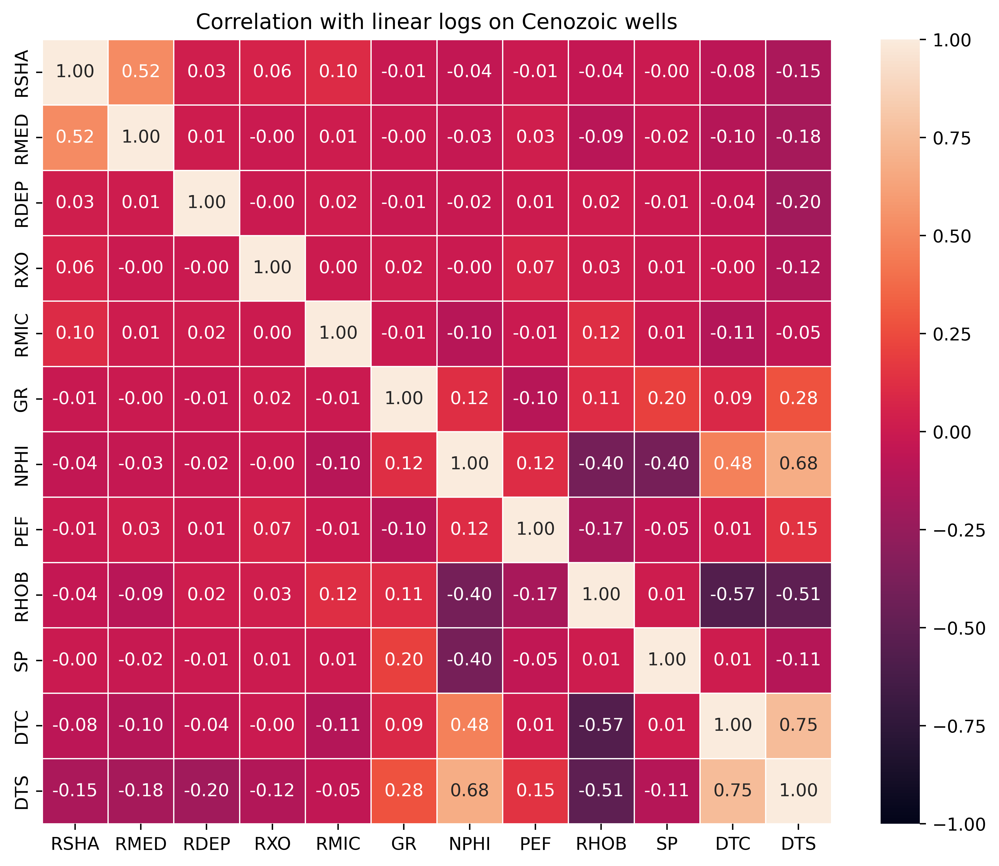

In [25]:
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with linear logs on Cenozoic wells")
plt.savefig('pearsonlinear_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

### Log-lin correlation (with log10)


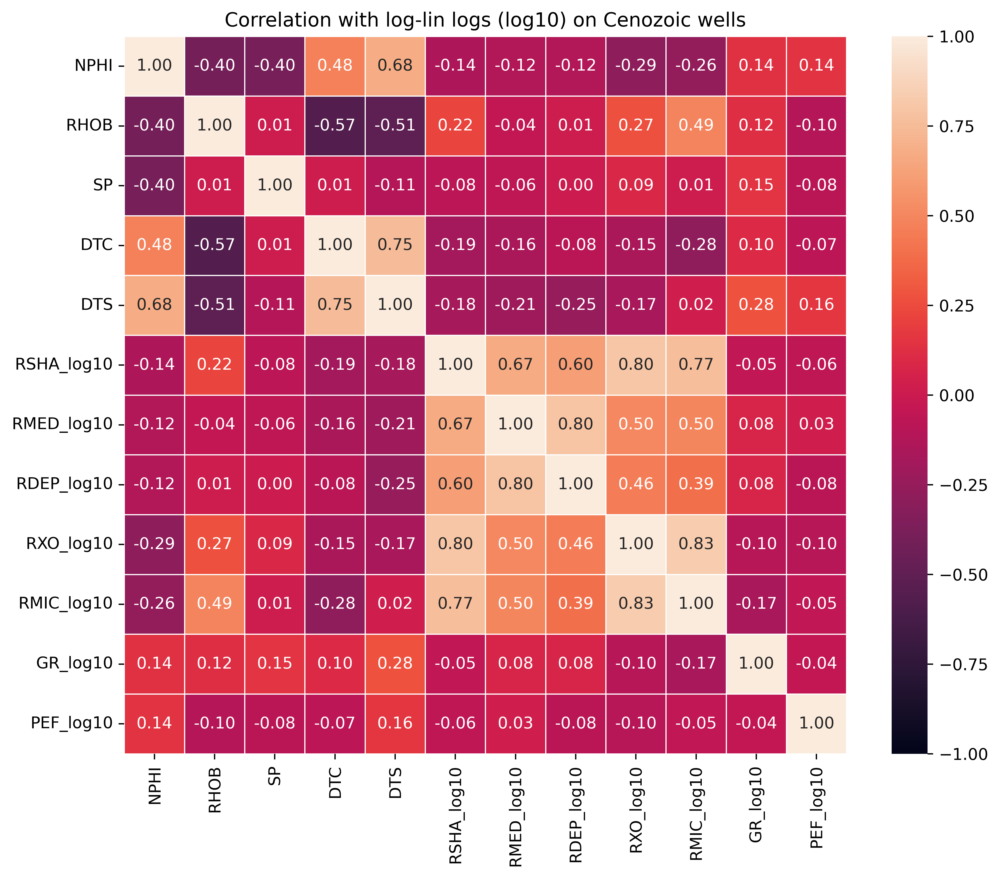

In [26]:
correlate_log10 = well_corr10.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_log10,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (log10) on Cenozoic wells")
plt.savefig('pearsonloglin_log10_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

### Log-lin correlation (with logn)


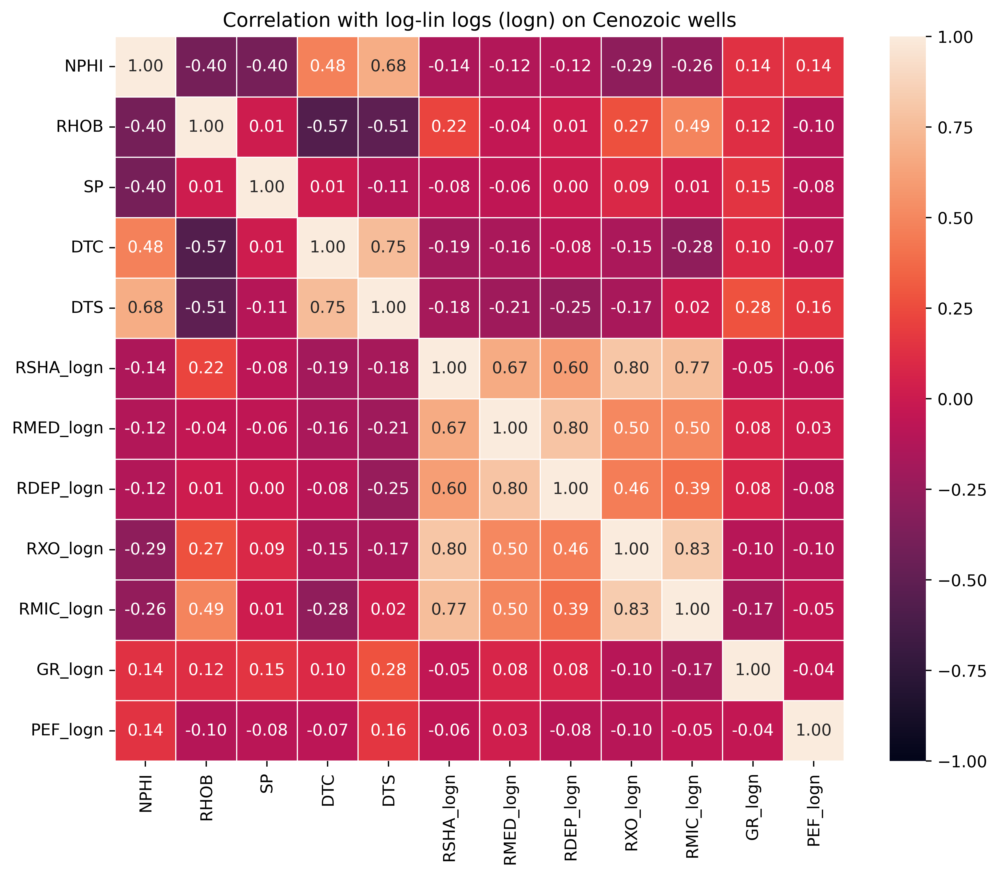

In [27]:
correlate_logn = well_corrn.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_logn,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (logn) on Cenozoic wells")
plt.savefig('pearsonloglin_logn_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

### Log-lin correlation (with PowerTransform yeo-johnson)


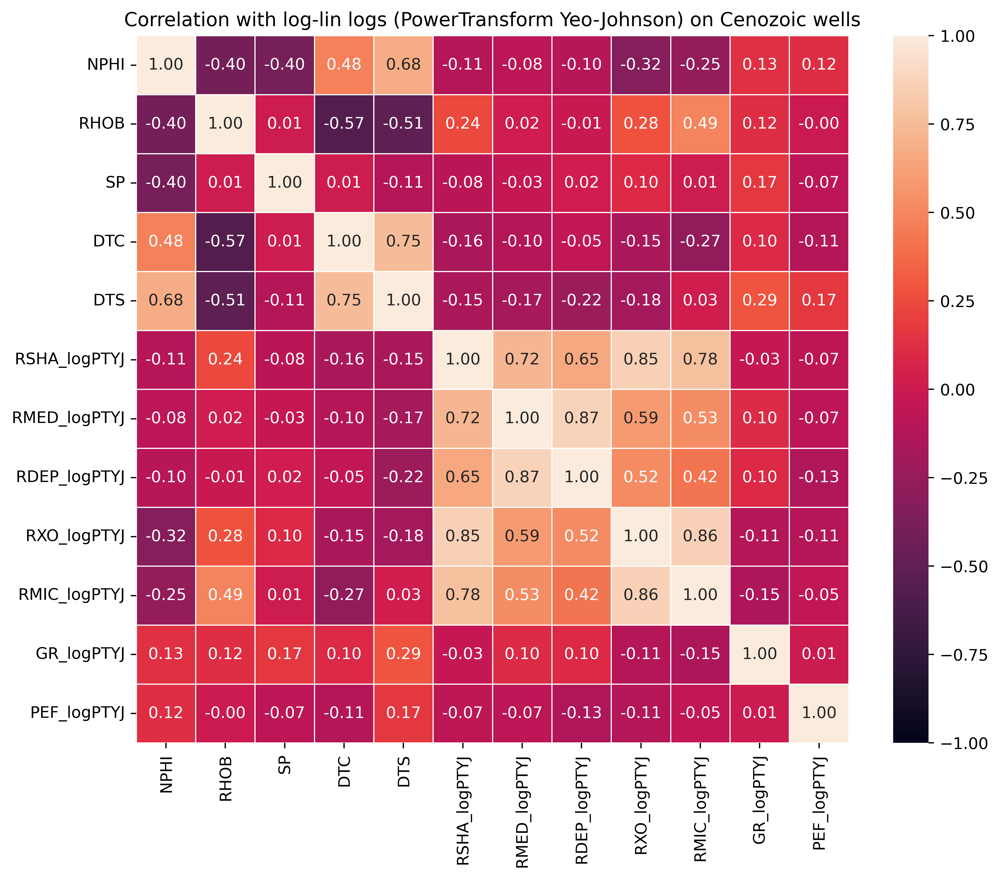

In [28]:
correlate_logptyj = well_corrptyj.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_logptyj,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (PowerTransform Yeo-Johnson) on Cenozoic wells")
plt.savefig('pearsonloglin_logptyj_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

### Log-lin correlation (with PowerTransform box-cox)


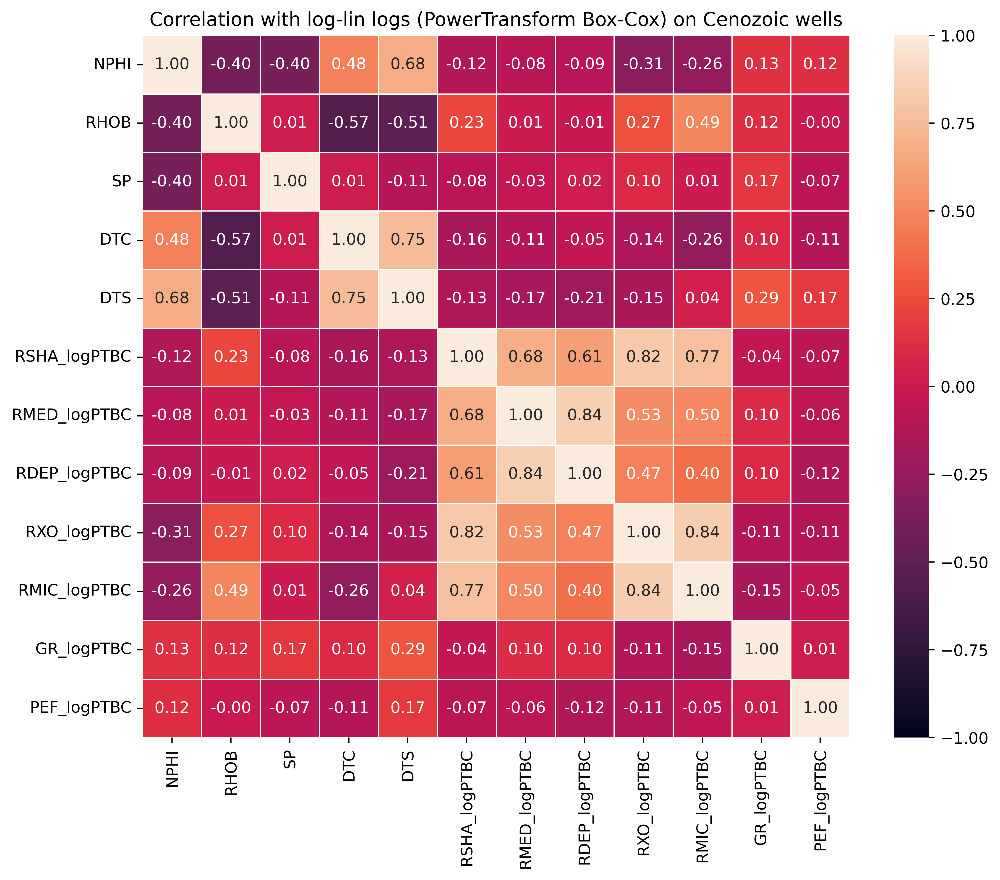

In [29]:
correlate_logptbc = well_corrptbc.corr(method = 'pearson')
plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_logptbc,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Correlation with log-lin logs (PowerTransform Box-Cox) on Cenozoic wells")
plt.savefig('pearsonloglin_logptbc_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

### Other correlation method (not used)


In [239]:
correlate.style.background_gradient(cmap='coolwarm')

,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,NPHI,PEF,RHOB,SP,DTC,DTS
RSHA,1.000000,0.518909,0.025434,0.057593,0.103318,-0.012680,-0.123365,-0.039367,-0.005213,-0.035322,-0.000649,-0.075665,-0.148720
RMED,0.518909,1.000000,0.010247,-0.000239,0.011975,-0.000450,0.029404,-0.026994,0.027326,-0.088564,-0.016388,-0.102703,-0.176439
RDEP,0.025434,0.010247,1.000000,-0.004404,0.017323,-0.012205,-0.005754,-0.019916,0.006683,0.015742,-0.007322,-0.039481,-0.196278
RXO,0.057593,-0.000239,-0.004404,1.000000,0.000414,0.018072,-0.099187,-0.000854,0.067209,0.029377,0.005754,-0.000703,-0.124686
RMIC,0.103318,0.011975,0.017323,0.000414,1.000000,-0.005037,0.466856,-0.100393,-0.007137,0.119281,0.007145,-0.113049,-0.050717
GR,-0.012680,-0.000450,-0.012205,0.018072,-0.005037,1.000000,0.792893,0.123089,-0.101377,0.114523,0.204851,0.087806,0.275658
SGR,-0.123365,0.029404,-0.005754,-0.099187,0.466856,0.792893,1.000000,0.279329,-0.159744,-0.104381,-0.056603,0.249906,nan
NPHI,-0.039367,-0.026994,-0.019916,-0.000854,-0.100393,0.123089,0.279329,1.000000,0.116295,-0.404147,-0.395098,0.475112,0.677169
PEF,-0.005213,0.027326,0.006683,0.067209,-0.007137,-0.101377,-0.159744,0.116295,1.000000,-0.169366,-0.053017,0.009538,0.145154
RHOB,-0.035322,-0.088564,0.015742,0.029377,0.119281,0.114523,-0.104381,-0.404147,-0.169366,1.000000,0.014489,-0.565312,-0.510410


## Dendogram for Hierarchical Clustering


In [30]:
def link_dissimilarity (correlate):
    dissimilarity = 1 - abs(correlate)
    z = linkage(squareform(dissimilarity), 'complete')
    
    return z

In [31]:
def dendogram_cluster (z, well_data):
    # Clusterize the data
    threshold = 0.8
    labels = fcluster(z, threshold, criterion='distance')

    # Keep the indices to sort labels
    labels_order = np.argsort(labels)

    # Build a new dataframe with the sorted columns
    for idx, i in enumerate(well_data.columns[labels_order]):
        if idx == 0:
            clustered = pd.DataFrame(well_data[i])
        else:
            df_to_append = pd.DataFrame(well_data[i])
            clustered = pd.concat([clustered, df_to_append], axis=1)
    
    return clustered

### Linear dendogram


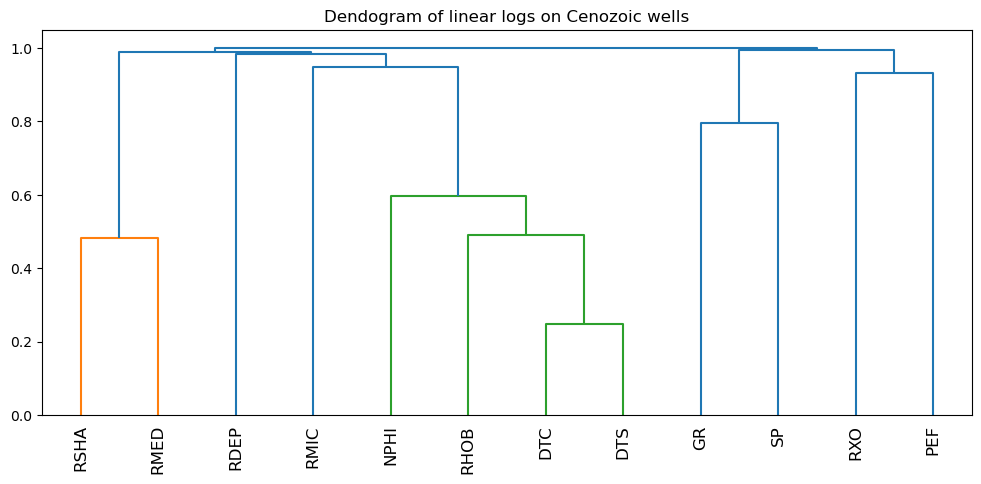

In [32]:
z = link_dissimilarity(correlate)

plt.figure(figsize=(12,5))
dendrogram(z, labels=well_corr.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of linear logs on Cenozoic wells")
plt.savefig('dendogram_linear_cenozoicdata_old.png', bbox_inches='tight')

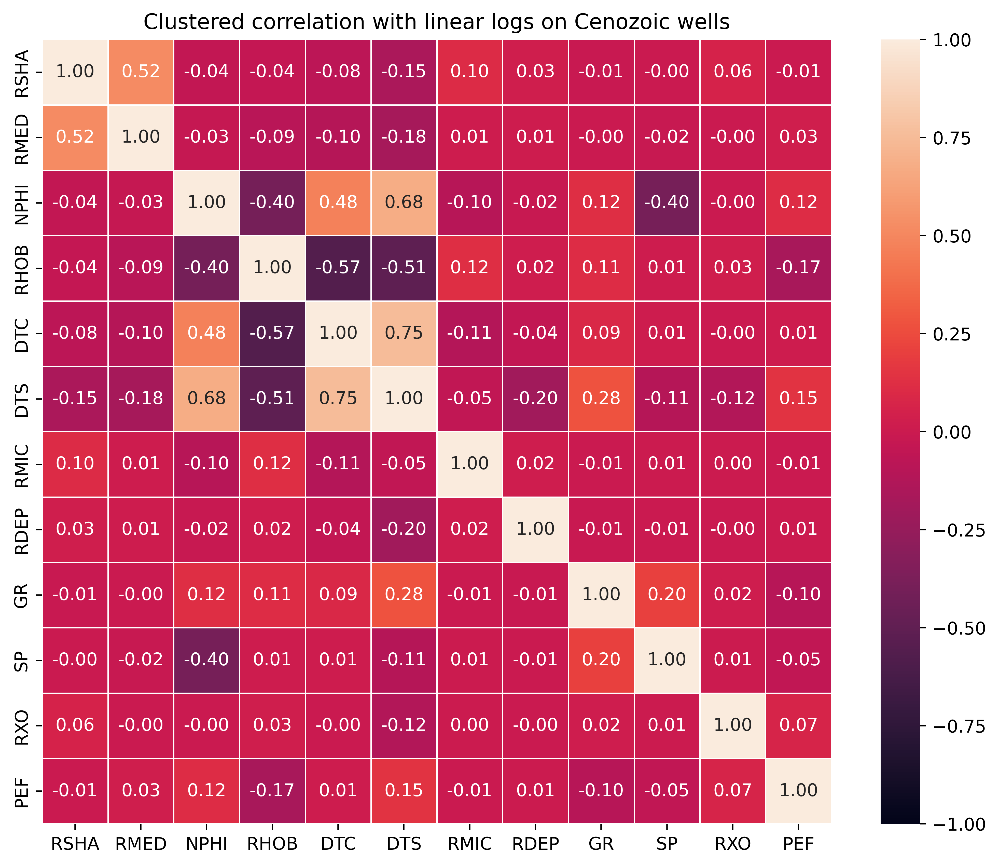

In [33]:
clustered = dendogram_cluster(z, well_corr)
correlate_clustered = clustered.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with linear logs on Cenozoic wells")
plt.savefig('clusteredcorrelation_linear_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

### Log-lin dendogram (log10)


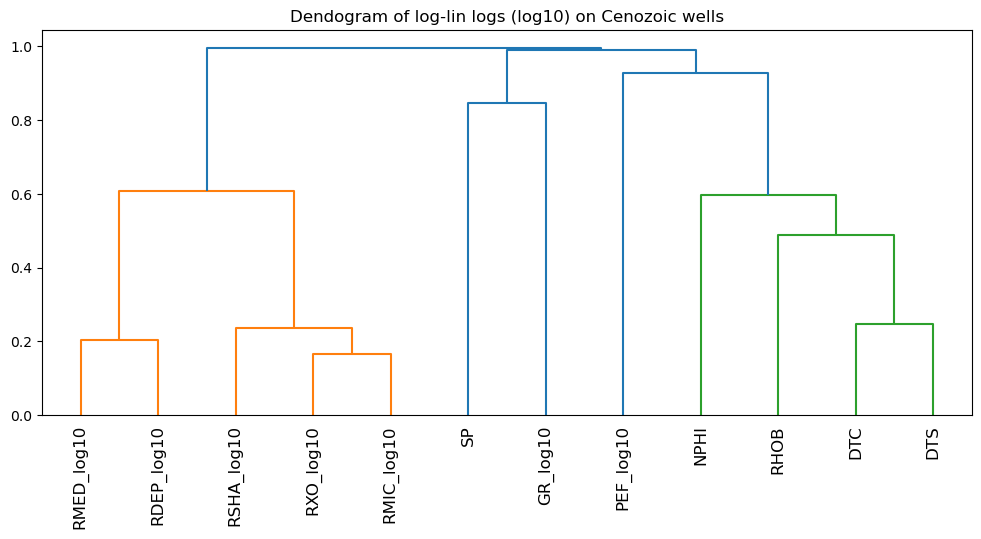

In [34]:
z_log10 = link_dissimilarity(correlate_log10)

plt.figure(figsize=(12,5))
dendrogram(z_log10, labels=well_corr10.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (log10) on Cenozoic wells")
plt.savefig('dendogram_loglin_log10_cenozoicdata_old.png', bbox_inches='tight')

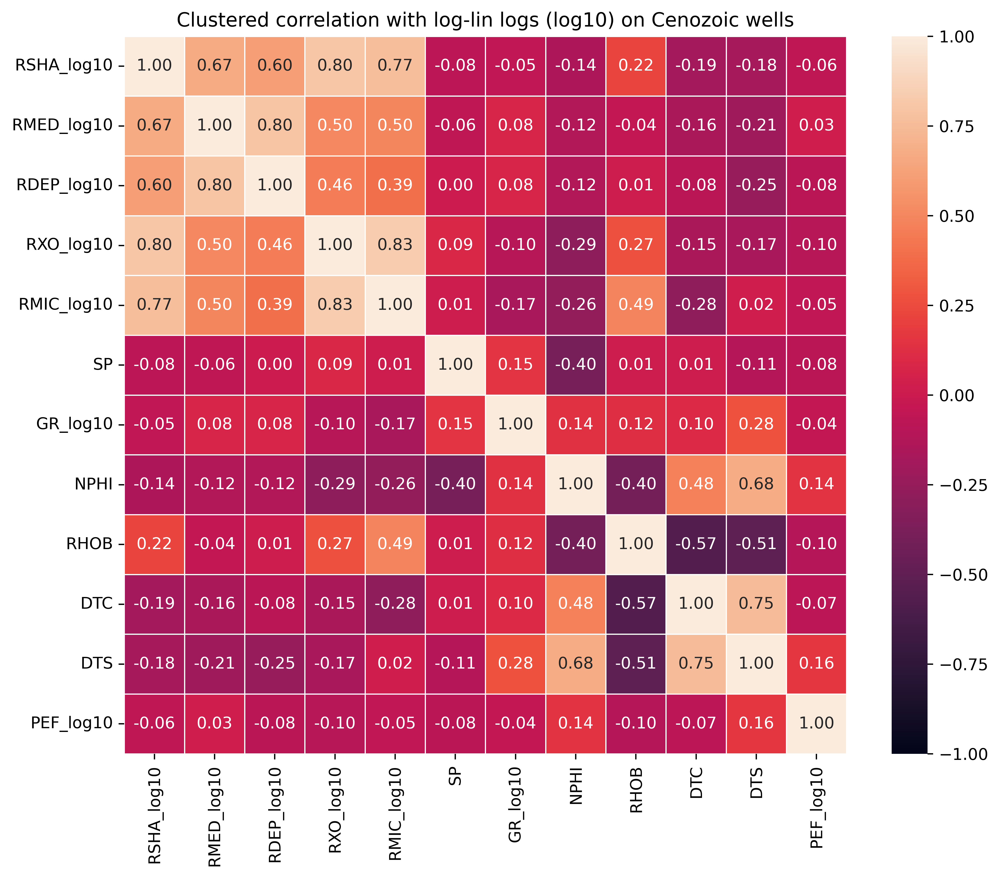

In [35]:
clustered_log10 = dendogram_cluster(z_log10, well_corr10)
correlate_clustered_log10 = clustered_log10.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_log10,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (log10) on Cenozoic wells")
plt.savefig('clusteredcorrelation_loglin_log10_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

### Log-lin dendogram (logn)


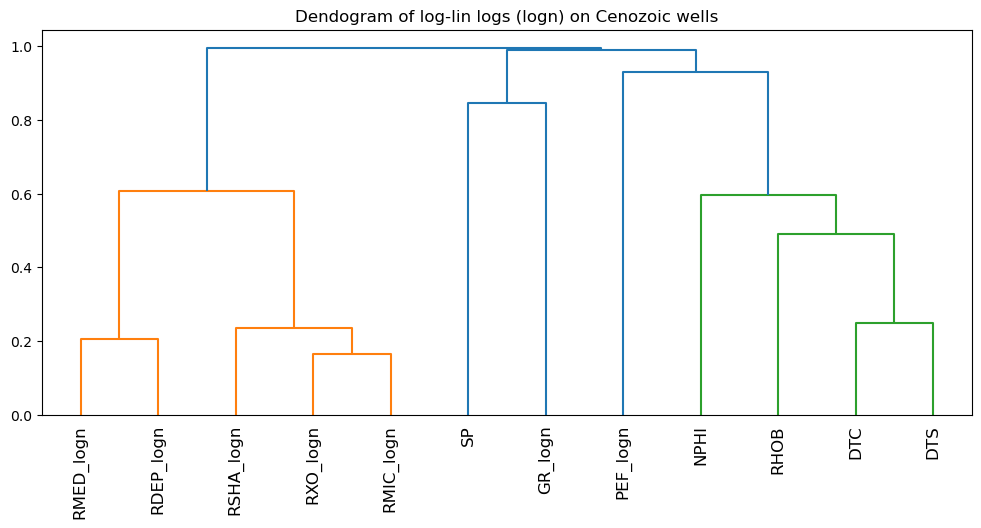

In [36]:
z_logn = link_dissimilarity(correlate_logn)

plt.figure(figsize=(12,5))
dendrogram(z_logn, labels=well_corrn.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (logn) on Cenozoic wells")
plt.savefig('dendogram_loglin_logn_cenozoicdata_old.png', bbox_inches='tight')

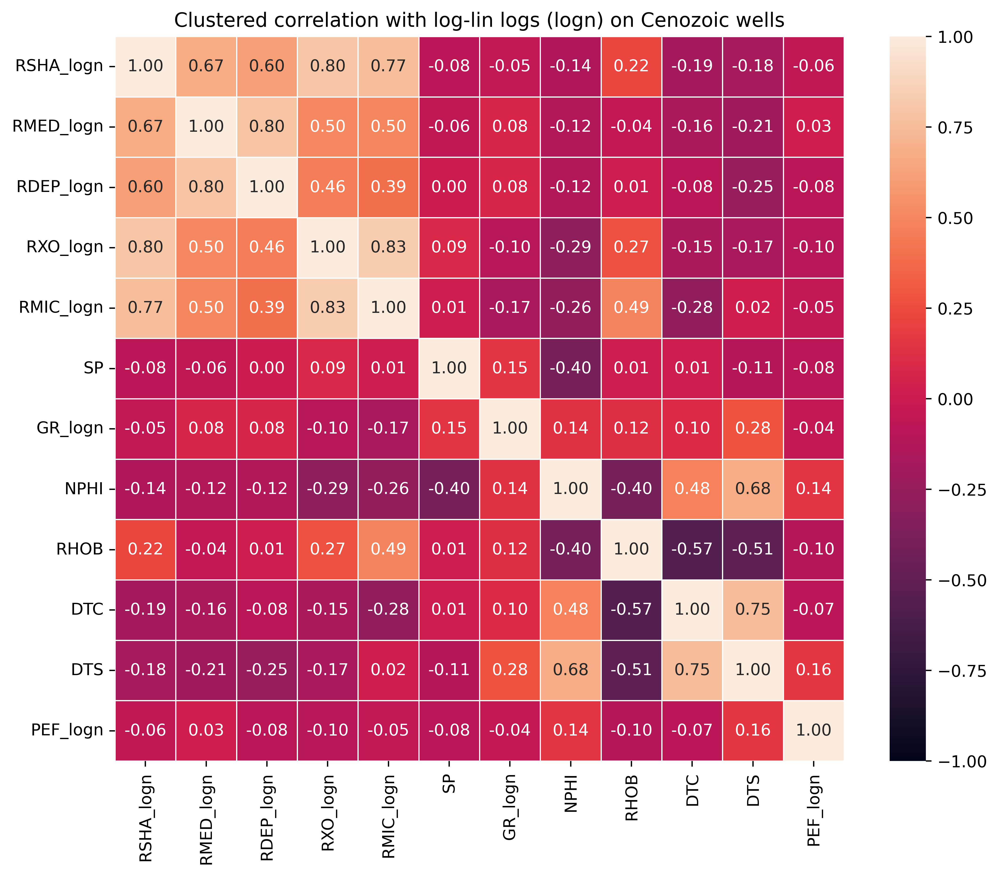

In [37]:
clustered_logn = dendogram_cluster(z_logn, well_corrn)
correlate_clustered_logn = clustered_logn.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_logn,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (logn) on Cenozoic wells")
plt.savefig('clusteredcorrelation_loglin_logn_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

### Log-lin dendogram (PowerTransform yeo-johnson)


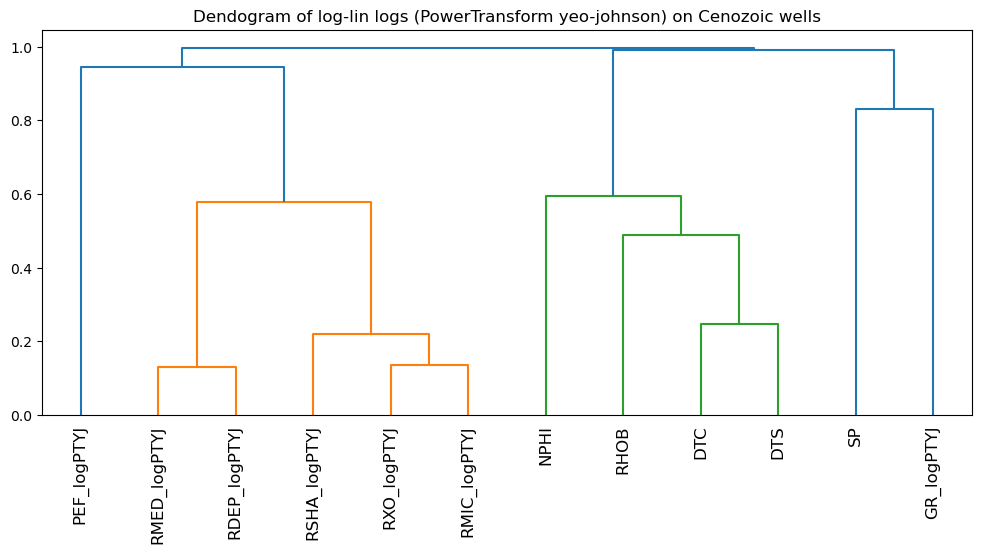

In [38]:
z_logptyj = link_dissimilarity(correlate_logptyj)

plt.figure(figsize=(12,5))
dendrogram(z_logptyj, labels=well_corrptyj.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (PowerTransform yeo-johnson) on Cenozoic wells")
plt.savefig('dendogram_loglin_logptyj_cenozoicdata_old.png', bbox_inches='tight')

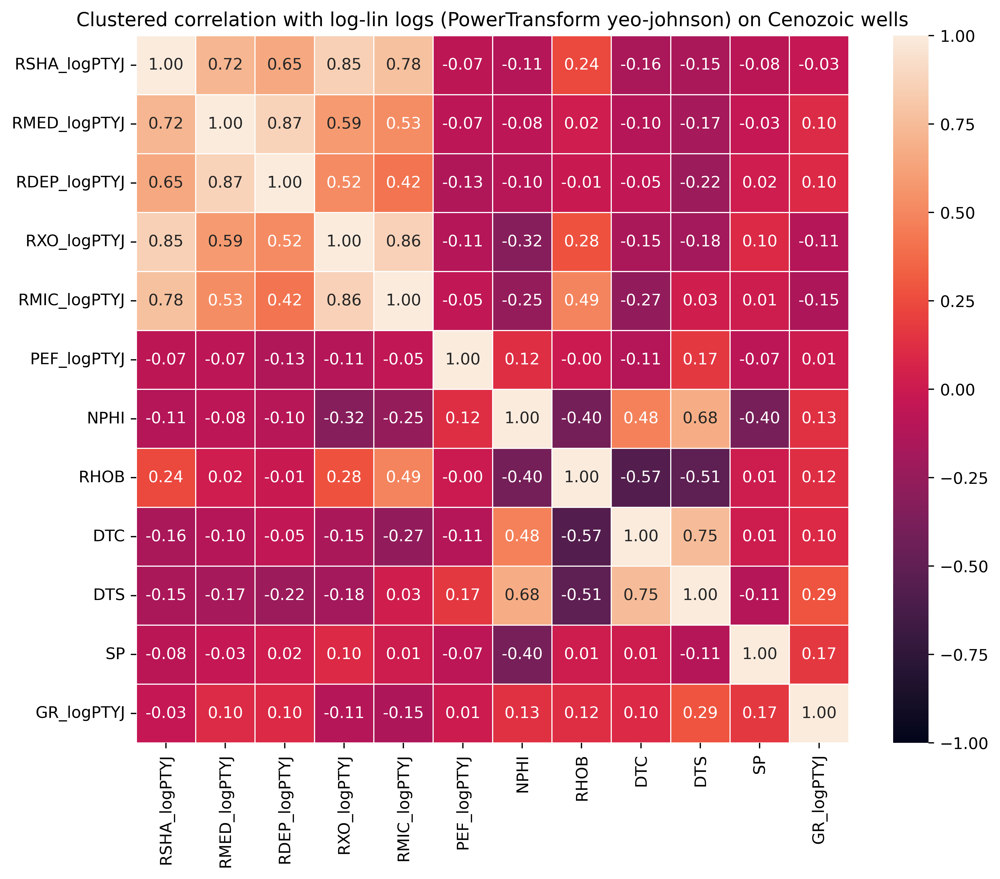

In [39]:
clustered_logptyj = dendogram_cluster(z_logptyj, well_corrptyj)
correlate_clustered_logptyj = clustered_logptyj.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_logptyj,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (PowerTransform yeo-johnson) on Cenozoic wells")
plt.savefig('clusteredcorrelation_loglin_logptyj_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

### Log-lin dendogram (PowerTransform box-cox)


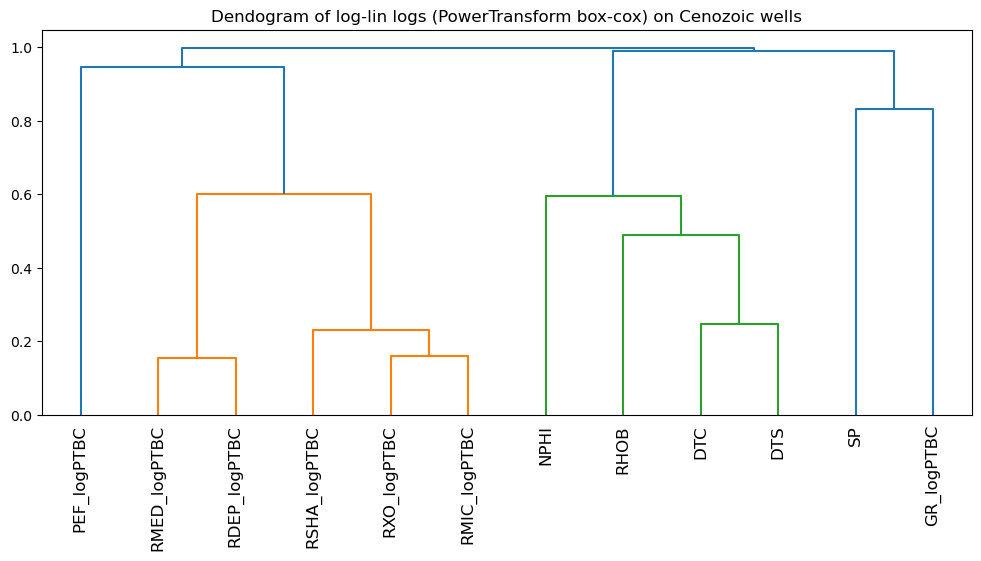

In [40]:
z_logptbc = link_dissimilarity(correlate_logptbc)

plt.figure(figsize=(12,5))
dendrogram(z_logptbc, labels=well_corrptbc.columns, orientation='top', 
           leaf_rotation=90);
plt.title("Dendogram of log-lin logs (PowerTransform box-cox) on Cenozoic wells")
plt.savefig('dendogram_loglin_logptbc_cenozoicdata_old.png', bbox_inches='tight')

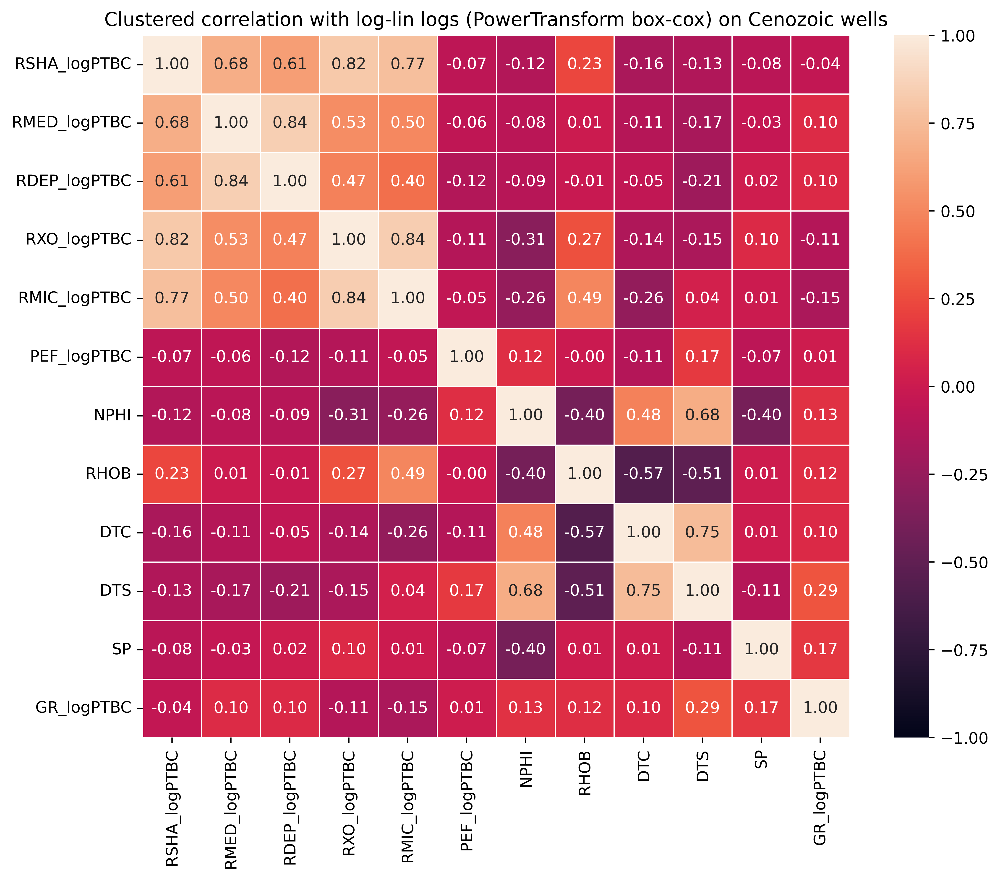

In [41]:
clustered_logptbc = dendogram_cluster(z_logptbc, well_corrptbc)
correlate_clustered_logptbc = clustered_logptbc.corr()

plt.figure(figsize=(10,8), dpi =500)
sns.heatmap(correlate_clustered_logptbc,annot=True,fmt=".2f", vmin=-1, vmax=1, linewidth=.5)
plt.title("Clustered correlation with log-lin logs (PowerTransform box-cox) on Cenozoic wells")
plt.savefig('clusteredcorrelation_loglin_logptbc_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

## k-means Clustering


### Data Initiation

Based on Pearson and dendogram analysis, well log data that normalized with PowerTransform yeo-johnson gives the best result and correlation.


In [42]:
well_clustered = well_logPTYJ.copy()
well_clustered

,WELL,DEPTH,CALI,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,...,LIT,LITCOLOR,RSHA_logPTYJ,RMED_logPTYJ,RDEP_logPTYJ,RXO_logPTYJ,RMIC_logPTYJ,GR_logPTYJ,SGR_logPTYJ,PEF_logPTYJ
0,15/9-13,494.5280,19.480835,NaN,1.611410,1.798681,NaN,NaN,80.200851,NaN,...,Shale,#bebebe,NaN,0.465368,0.497273,NaN,NaN,8.802524,NaN,1.175511
1,15/9-13,494.6800,19.468800,NaN,1.618070,1.795641,NaN,NaN,79.262886,NaN,...,Shale,#bebebe,NaN,0.465843,0.497071,NaN,NaN,8.761711,NaN,1.168639
2,15/9-13,494.8320,19.468800,NaN,1.626459,1.800733,NaN,NaN,74.821999,NaN,...,Shale,#bebebe,NaN,0.466437,0.497408,NaN,NaN,8.563717,NaN,1.182113
3,15/9-13,494.9840,19.459282,NaN,1.621594,1.801517,NaN,NaN,72.878922,NaN,...,Shale,#bebebe,NaN,0.466093,0.497460,NaN,NaN,8.474476,NaN,1.208242
4,15/9-13,495.1360,19.453100,NaN,1.602679,1.795299,NaN,NaN,71.729141,NaN,...,Shale,#bebebe,NaN,0.464741,0.497048,NaN,NaN,8.420878,NaN,1.219125
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,35/9-7,1766.2668,12.238290,NaN,1.197426,1.214096,NaN,NaN,83.147964,NaN,...,Shale,#bebebe,NaN,0.427714,0.444371,NaN,NaN,8.928608,NaN,0.940516
583729,35/9-7,1766.4188,12.153356,NaN,1.235018,1.294403,NaN,NaN,79.262672,NaN,...,Shale,#bebebe,NaN,0.431937,0.453781,NaN,NaN,8.761702,NaN,0.943688
583730,35/9-7,1766.5708,12.070336,NaN,1.271628,1.402378,NaN,NaN,74.124725,NaN,...,Shale,#bebebe,NaN,0.435867,0.465142,NaN,NaN,8.531883,NaN,0.953124
583731,35/9-7,1766.7228,12.122781,NaN,1.390259,1.549507,NaN,NaN,60.120319,NaN,...,Shale,#bebebe,NaN,0.447482,0.478613,NaN,NaN,7.842496,NaN,0.971342


In [180]:
#Test if the best data is logn
well_clustered = well_logn.copy()
well_clustered

,WELL,DEPTH,CALI,RSHA,RMED,RDEP,RXO,RMIC,GR,SGR,...,LIT,LITCOLOR,RSHA_logn,RMED_logn,RDEP_logn,RXO_logn,RMIC_logn,GR_logn,SGR_logn,PEF_logn
0,15/9-13,494.5280,19.480835,NaN,1.611410,1.798681,NaN,NaN,80.200851,NaN,...,Shale,#bebebe,NaN,0.477109,0.587054,NaN,NaN,4.384534,NaN,3.040489
1,15/9-13,494.6800,19.468800,NaN,1.618070,1.795641,NaN,NaN,79.262886,NaN,...,Shale,#bebebe,NaN,0.481234,0.585362,NaN,NaN,4.372770,NaN,2.964397
2,15/9-13,494.8320,19.468800,NaN,1.626459,1.800733,NaN,NaN,74.821999,NaN,...,Shale,#bebebe,NaN,0.486405,0.588194,NaN,NaN,4.315112,NaN,3.117575
3,15/9-13,494.9840,19.459282,NaN,1.621594,1.801517,NaN,NaN,72.878922,NaN,...,Shale,#bebebe,NaN,0.483410,0.588629,NaN,NaN,4.288799,NaN,3.471715
4,15/9-13,495.1360,19.453100,NaN,1.602679,1.795299,NaN,NaN,71.729141,NaN,...,Shale,#bebebe,NaN,0.471677,0.585172,NaN,NaN,4.272897,NaN,3.650545
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292903,35/9-7,2973.2988,8.276272,NaN,2.820439,3.158570,NaN,2.311106,90.720284,NaN,...,Shale,#bebebe,NaN,1.036893,1.150119,NaN,0.837726,4.507781,NaN,NaN
1292904,35/9-7,2973.4508,8.267273,NaN,3.020778,3.332977,NaN,1.853418,87.062027,NaN,...,Shale,#bebebe,NaN,1.105514,1.203866,NaN,0.617032,4.466621,NaN,NaN
1292905,35/9-7,2973.6028,8.250099,NaN,2.795711,3.044179,NaN,1.325961,86.115921,NaN,...,Shale,#bebebe,NaN,1.028086,1.113231,NaN,0.282138,4.455694,NaN,NaN
1292906,35/9-7,2973.7548,NaN,NaN,2.658694,2.847681,NaN,1.260347,89.497131,NaN,...,Shale,#bebebe,NaN,0.977835,1.046505,NaN,0.231387,4.494207,NaN,NaN


In [43]:
well_clustered.isnull().sum()

WELL                 0
DEPTH                0
CALI             65169
RSHA            302683
RMED             17472
RDEP              2142
RXO             461780
RMIC            523066
GR                   0
SGR             568901
NPHI            323659
PEF             255113
RHOB            125624
SP              114125
BS              268564
DRHO            141163
DTC              52336
DTS             528519
LITHOLOGY            0
GROUP                0
FORMATION       143865
LIT                  0
LITCOLOR             0
RSHA_logPTYJ    302683
RMED_logPTYJ     17472
RDEP_logPTYJ      2142
RXO_logPTYJ     461780
RMIC_logPTYJ    523066
GR_logPTYJ           0
SGR_logPTYJ     568901
PEF_logPTYJ     255113
dtype: int64

In [44]:
well_clustered.columns

Index(['WELL', 'DEPTH', 'CALI', 'RSHA', 'RMED', 'RDEP', 'RXO', 'RMIC', 'GR',
       'SGR', 'NPHI', 'PEF', 'RHOB', 'SP', 'BS', 'DRHO', 'DTC', 'DTS',
       'LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR', 'RSHA_logPTYJ',
       'RMED_logPTYJ', 'RDEP_logPTYJ', 'RXO_logPTYJ', 'RMIC_logPTYJ',
       'GR_logPTYJ', 'SGR_logPTYJ', 'PEF_logPTYJ'],
      dtype='object')

In [199]:
#With SP
well_clustered = well_clustered[['WELL', 'DEPTH','GR_logPTYJ', 'RDEP_logPTYJ', 'PEF_logPTYJ', 'NPHI', 'RHOB', 'SP', 'DTC', 'CALI', 'GR', 'RDEP', 'PEF', 'LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR']]

well_clustered.rename(columns = {'RDEP_logPTYJ':'RDEP_log'}, inplace = True)
well_clustered.rename(columns = {'GR_logPTYJ':'GR_log'}, inplace = True)
well_clustered.rename(columns = {'PEF_logPTYJ':'PEF_log'}, inplace = True)

well_clustered


C:\Users\V330\AppData\Local\Temp\ipykernel_1728\2089836737.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'RDEP_logPTYJ':'RDEP_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\2089836737.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'GR_logPTYJ':'GR_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_1728\2089836737.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/ind

,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,SP,DTC,CALI,GR,RDEP,PEF,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR
0,15/9-13,494.5280,8.802524,0.497273,1.175511,NaN,1.884186,24.612379,161.131180,19.480835,80.200851,1.798681,20.915468,65000,NORDLAND GP.,NaN,Shale,#bebebe
1,15/9-13,494.6800,8.761711,0.497071,1.168639,NaN,1.889794,23.895531,160.603470,19.468800,79.262886,1.795641,19.383013,65000,NORDLAND GP.,NaN,Shale,#bebebe
2,15/9-13,494.8320,8.563717,0.497408,1.182113,NaN,1.896523,23.916357,160.173615,19.468800,74.821999,1.800733,22.591518,65000,NORDLAND GP.,NaN,Shale,#bebebe
3,15/9-13,494.9840,8.474476,0.497460,1.208242,NaN,1.891913,23.793688,160.149429,19.459282,72.878922,1.801517,32.191910,65000,NORDLAND GP.,NaN,Shale,#bebebe
4,15/9-13,495.1360,8.420878,0.497048,1.219125,NaN,1.880034,24.104078,160.128342,19.453100,71.729141,1.795299,38.495632,65000,NORDLAND GP.,NaN,Shale,#bebebe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,35/9-7,1766.2668,8.928608,0.444371,0.940516,0.232723,2.345521,NaN,113.713493,12.238290,83.147964,1.214096,4.354927,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe
583729,35/9-7,1766.4188,8.761702,0.453781,0.943688,0.215034,2.356758,NaN,107.487816,12.153356,79.262672,1.294403,4.417637,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe
583730,35/9-7,1766.5708,8.531883,0.465142,0.953124,0.213298,2.396056,NaN,99.575928,12.070336,74.124725,1.402378,4.612125,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe
583731,35/9-7,1766.7228,7.842496,0.478613,0.971342,0.211477,2.467660,NaN,95.313583,12.122781,60.120319,1.549507,5.024710,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe


In [45]:
#Without SP
well_clustered = well_clustered[['WELL', 'DEPTH','GR_logPTYJ', 'RDEP_logPTYJ', 'PEF_logPTYJ', 
                                 'NPHI', 'RHOB', 'DTC', 'GR', 'RDEP', 'PEF', 'CALI',
                                 'LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR']]

well_clustered.rename(columns = {'RDEP_logPTYJ':'RDEP_log'}, inplace = True)
well_clustered.rename(columns = {'GR_logPTYJ':'GR_log'}, inplace = True)
well_clustered.rename(columns = {'PEF_logPTYJ':'PEF_log'}, inplace = True)

well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_11160\3297859463.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'RDEP_logPTYJ':'RDEP_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_11160\3297859463.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'GR_logPTYJ':'GR_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_11160\3297859463.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/

,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,DTC,GR,RDEP,PEF,CALI,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR
0,15/9-13,494.5280,8.802524,0.497273,1.175511,NaN,1.884186,161.131180,80.200851,1.798681,20.915468,19.480835,65000,NORDLAND GP.,NaN,Shale,#bebebe
1,15/9-13,494.6800,8.761711,0.497071,1.168639,NaN,1.889794,160.603470,79.262886,1.795641,19.383013,19.468800,65000,NORDLAND GP.,NaN,Shale,#bebebe
2,15/9-13,494.8320,8.563717,0.497408,1.182113,NaN,1.896523,160.173615,74.821999,1.800733,22.591518,19.468800,65000,NORDLAND GP.,NaN,Shale,#bebebe
3,15/9-13,494.9840,8.474476,0.497460,1.208242,NaN,1.891913,160.149429,72.878922,1.801517,32.191910,19.459282,65000,NORDLAND GP.,NaN,Shale,#bebebe
4,15/9-13,495.1360,8.420878,0.497048,1.219125,NaN,1.880034,160.128342,71.729141,1.795299,38.495632,19.453100,65000,NORDLAND GP.,NaN,Shale,#bebebe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,35/9-7,1766.2668,8.928608,0.444371,0.940516,0.232723,2.345521,113.713493,83.147964,1.214096,4.354927,12.238290,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe
583729,35/9-7,1766.4188,8.761702,0.453781,0.943688,0.215034,2.356758,107.487816,79.262672,1.294403,4.417637,12.153356,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe
583730,35/9-7,1766.5708,8.531883,0.465142,0.953124,0.213298,2.396056,99.575928,74.124725,1.402378,4.612125,12.070336,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe
583731,35/9-7,1766.7228,7.842496,0.478613,0.971342,0.211477,2.467660,95.313583,60.120319,1.549507,5.024710,12.122781,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe


In [183]:
#Without SP for logn
well_clustered = well_clustered[['WELL', 'DEPTH','GR_logn', 'RDEP_logn', 'PEF_logn', 
                                 'NPHI', 'RHOB', 'DTC', 'GR', 'RDEP', 'PEF', 'CALI',
                                 'LITHOLOGY', 'GROUP', 'FORMATION', 'LIT', 'LITCOLOR']]

well_clustered.rename(columns = {'RDEP_logn':'RDEP_log'}, inplace = True)
well_clustered.rename(columns = {'GR_logn':'GR_log'}, inplace = True)
well_clustered.rename(columns = {'PEF_logn':'PEF_log'}, inplace = True)

C:\Users\V330\AppData\Local\Temp\ipykernel_39768\195667422.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'RDEP_logn':'RDEP_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_39768\195667422.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.rename(columns = {'GR_logn':'GR_log'}, inplace = True)
C:\Users\V330\AppData\Local\Temp\ipykernel_39768\195667422.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.

In [46]:
well_clustered.dropna(inplace=True)
well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_11160\1168242641.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered.dropna(inplace=True)


,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,DTC,GR,RDEP,PEF,CALI,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR
4238,15/9-13,1138.7040,7.612351,0.428138,0.681509,0.765867,1.774626,147.837677,55.892757,1.091499,1.631495,19.322735,30000,NORDLAND GP.,Utsira Fm.,Sandstone,#ffff00
4239,15/9-13,1138.8560,7.885222,0.432506,0.683944,0.800262,1.800986,142.382431,60.929138,1.122706,1.645080,18.613674,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe
4240,15/9-13,1139.0080,7.947269,0.435942,0.684085,0.765957,1.817696,138.258331,62.117264,1.148141,1.645873,18.212072,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe
4241,15/9-13,1139.1600,7.889517,0.438938,0.679471,0.702521,1.829333,139.198914,61.010860,1.170984,1.620216,18.134182,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe
4242,15/9-13,1139.3120,7.755739,0.440619,0.657696,0.639708,1.813854,144.290085,58.501236,1.184080,1.504854,18.033762,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,35/9-7,1766.2668,8.928608,0.444371,0.940516,0.232723,2.345521,113.713493,83.147964,1.214096,4.354927,12.238290,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe
583729,35/9-7,1766.4188,8.761702,0.453781,0.943688,0.215034,2.356758,107.487816,79.262672,1.294403,4.417637,12.153356,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe
583730,35/9-7,1766.5708,8.531883,0.465142,0.953124,0.213298,2.396056,99.575928,74.124725,1.402378,4.612125,12.070336,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe
583731,35/9-7,1766.7228,7.842496,0.478613,0.971342,0.211477,2.467660,95.313583,60.120319,1.549507,5.024710,12.122781,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe


### Elbow plot


In [201]:
def optimal_cluster(data, maxcluster):
    means=[]
    inertias = []
    
    for k in range(1, maxcluster):
        kmeans= KMeans(n_clusters = k)
        kmeans.fit(data)
        
        means.append(k)
        inertias.append(kmeans.inertia_)
    
    return means, inertias


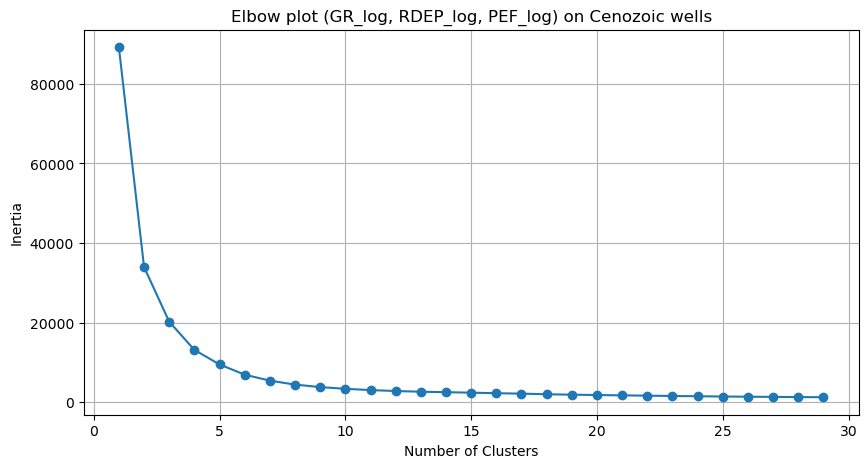

In [202]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppef_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

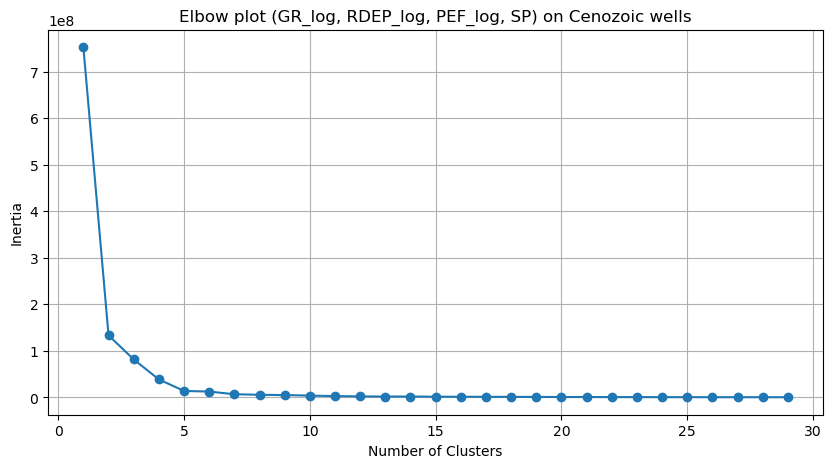

In [203]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, SP) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefsp_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

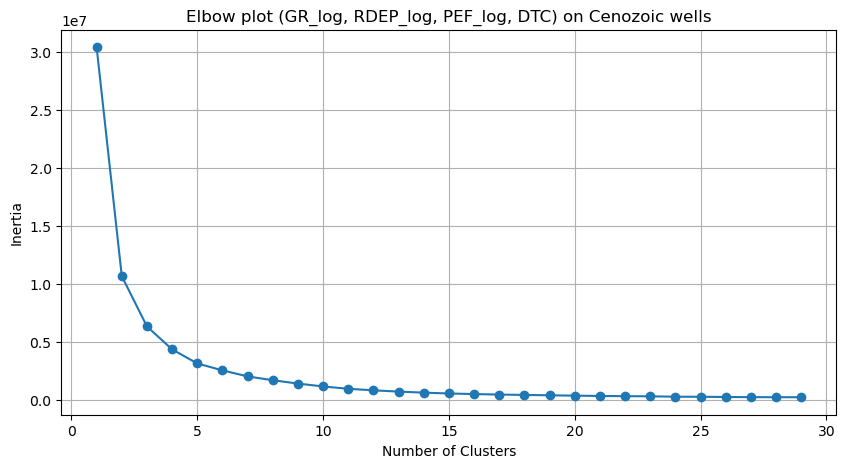

In [204]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, DTC) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefdtc_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

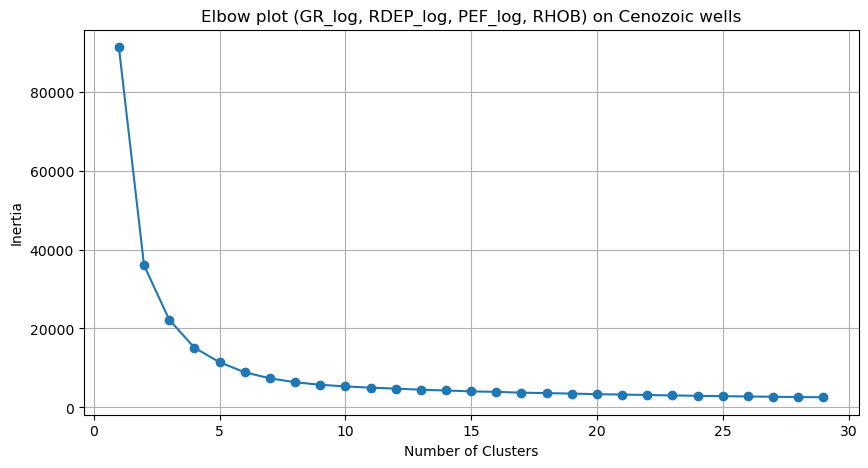

In [205]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefrhob_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

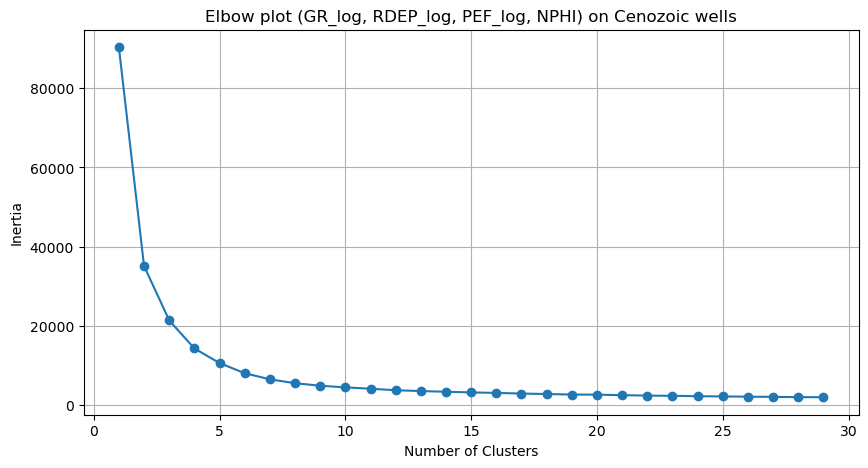

In [206]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphi_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

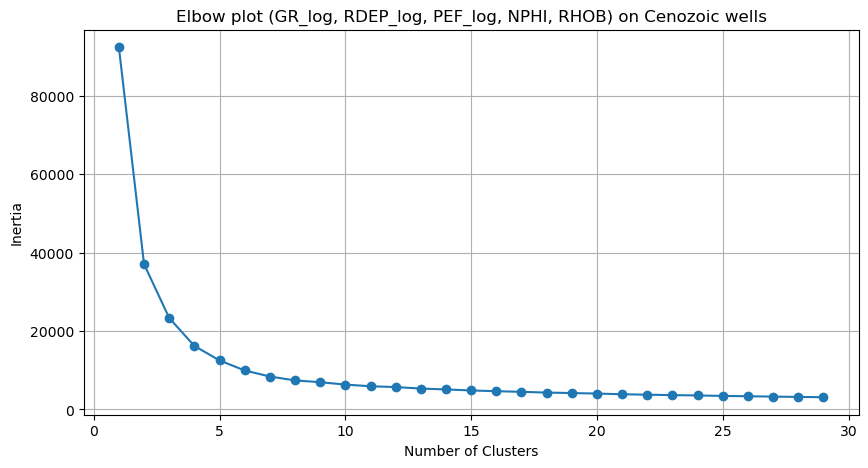

In [207]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphirhob_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

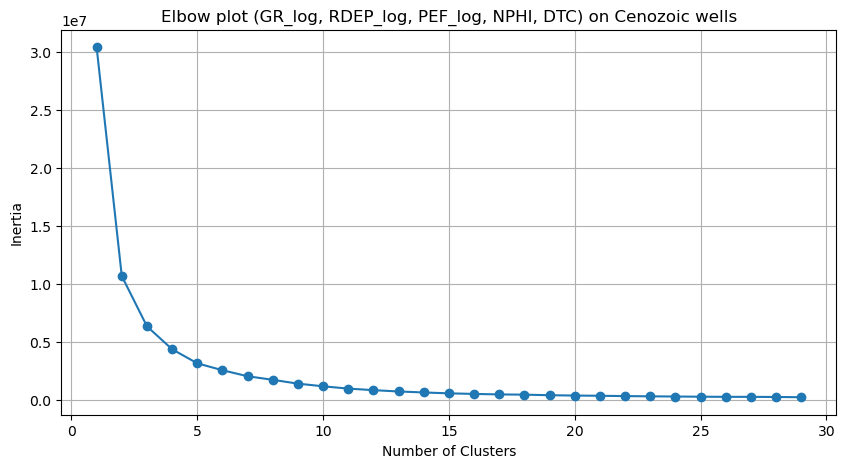

In [208]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, DTC) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphidtc_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

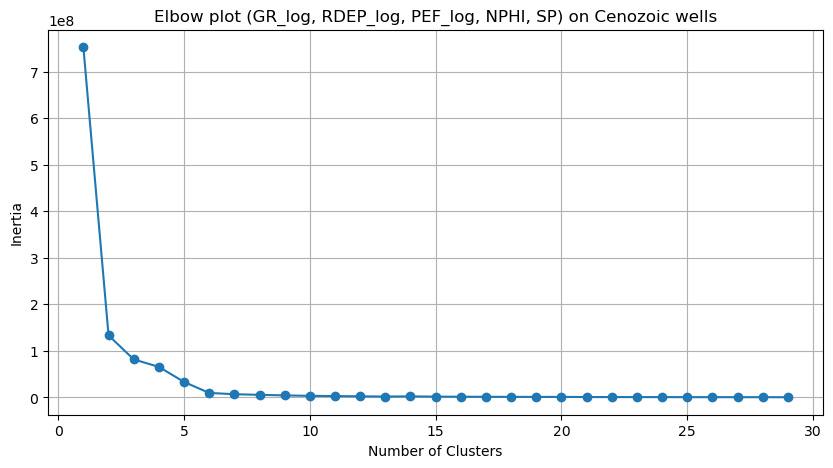

In [209]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, SP) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphisp_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

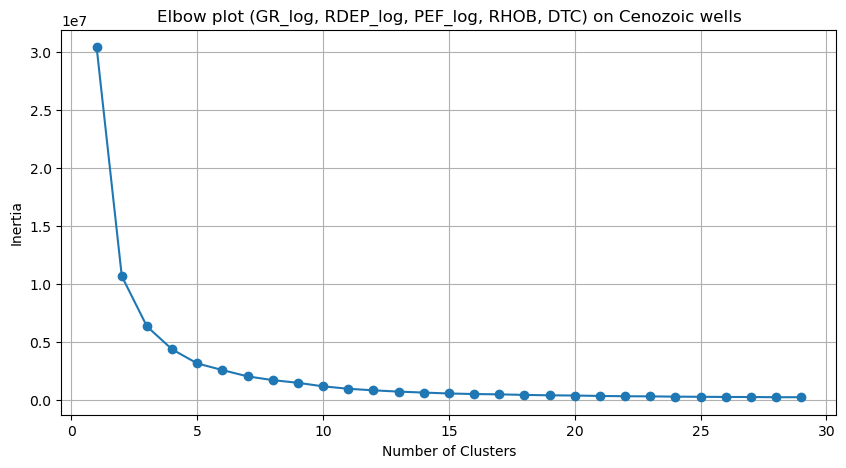

In [210]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB, DTC) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefrhobdtc_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

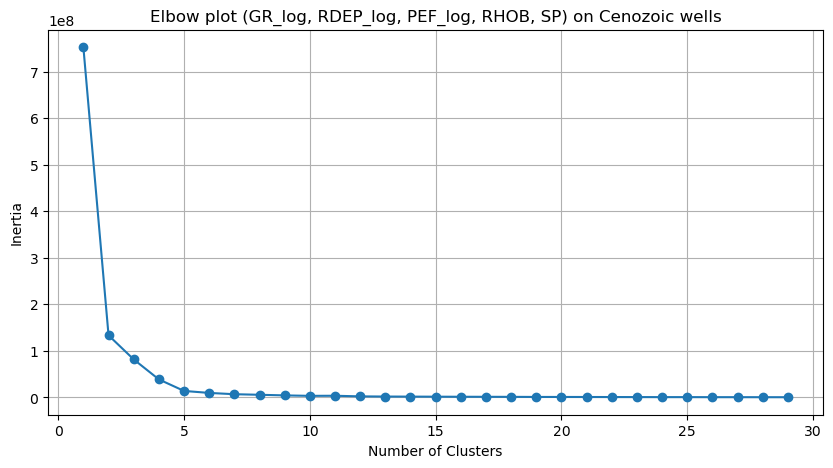

In [211]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB, SP) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefrhobsp_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

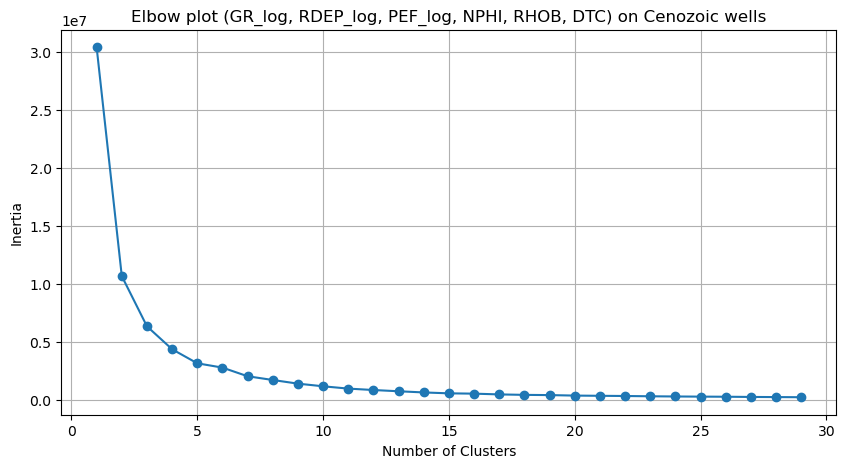

In [212]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'DTC']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, DTC) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphirhobdtc_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

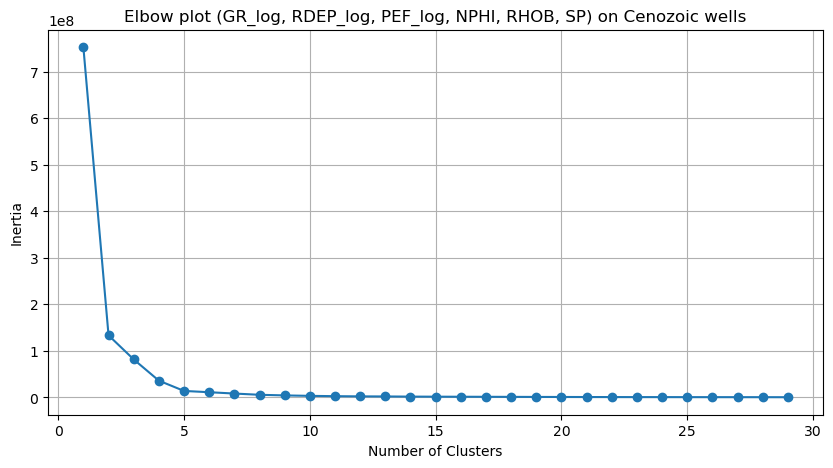

In [213]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, SP) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphirhobsp_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

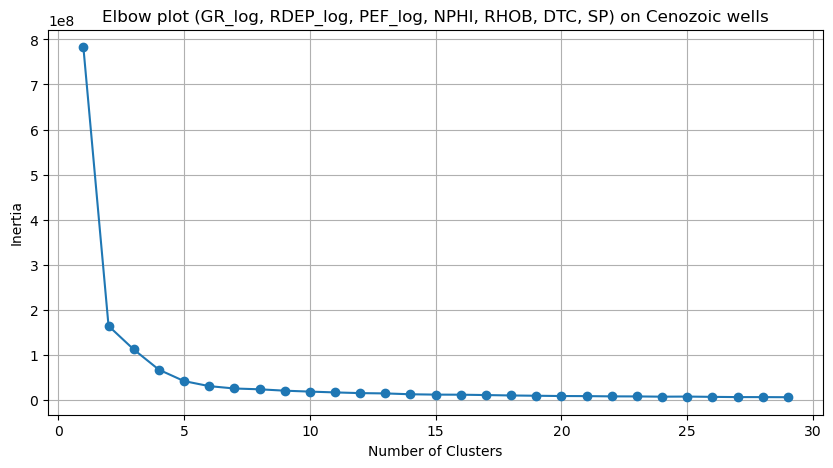

In [214]:
means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'DTC', 'SP']], 30)

#Generate the elbow plot
plt.subplots(figsize = (10,5))
plt.plot(means, inertias, 'o-')
plt.xlabel('Number of Clusters')
plt.ylabel('Inertia')
plt.title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, DTC, SP) on Cenozoic wells')
plt.grid(True)
plt.savefig('elbowplot_grrdeppefnphirhobdtcsp_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

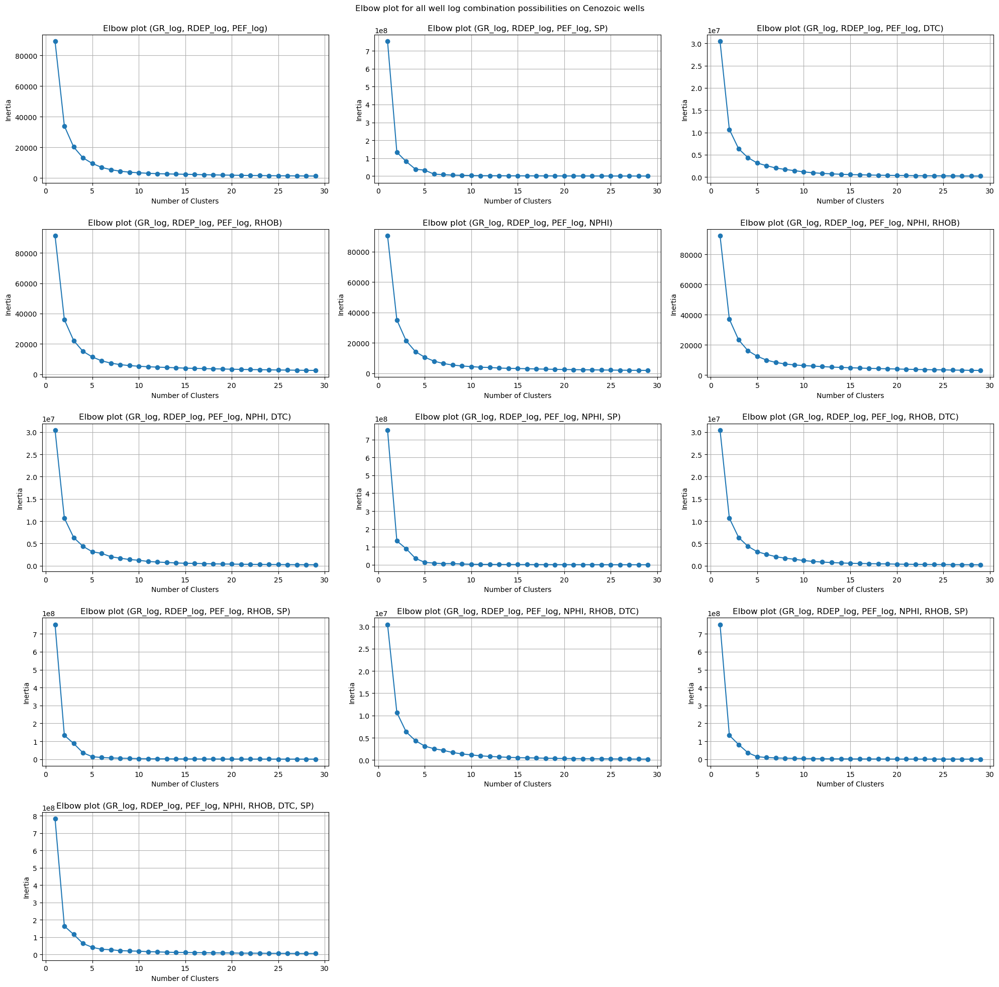

In [215]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Elbow plot for all well log combination possibilities on Cenozoic wells')
for i in range(15):
    ax = fig.add_subplot(5,3, i+1)
    ax.set_axisbelow(True)
    ax.set_xlabel('Number of Clusters')
    ax.set_ylabel('Inertia')
    
    if i==0:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log)')
    elif i==1:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'SP']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, SP)')
    elif i==2:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'DTC']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, DTC)')
    elif i==3:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB)')
    elif i==4:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI)')
    elif i==5:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB)')
    elif i==6:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'DTC']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, DTC)')
    elif i==7:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'SP']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, SP)')
    elif i==8:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB', 'DTC']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB, DTC)')
    elif i==9:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'RHOB', 'SP']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, RHOB, SP)')
    elif i==10:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'DTC']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, DTC)')
    elif i==11:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'SP']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, SP)')
    elif i==12:
        means, inertias = optimal_cluster(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB', 'DTC', 'SP']], 30)
        ax.plot(means, inertias, 'o-')
        ax.set_title('Elbow plot (GR_log, RDEP_log, PEF_log, NPHI, RHOB, DTC, SP)')
    else:
        ax.remove()
        
    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('elbowplot_all_cenozoicdata_old.png', bbox_inches='tight')
plt.show()
    

### Clustering


In [47]:
Kmeans = KMeans(n_clusters = 5, init='k-means++', n_init=20, max_iter=1000, random_state=42)


In [48]:
Kmeans.fit(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB']])

KMeans(max_iter=1000, n_clusters=5, n_init=20, random_state=42)

In [49]:
means1=Kmeans.cluster_centers_
means1

array([[ 7.43443128,  0.37250692,  0.96037834,  0.43692954,  2.09583651],
       [ 9.24548895,  0.38867478,  0.92475563,  0.48811799,  2.12249711],
       [ 8.3596591 ,  0.37847805,  0.91986885,  0.45866594,  2.11638578],
       [ 6.1536385 ,  0.37392367,  0.91174801,  0.33855595,  2.16026412],
       [10.29138458,  0.4097671 ,  0.93228421,  0.45754742,  2.16106791]])

In [50]:
well_clustered['KMeans'] = Kmeans.labels_
well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_11160\870997332.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered['KMeans'] = Kmeans.labels_


,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,DTC,GR,RDEP,PEF,CALI,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR,KMeans
4238,15/9-13,1138.7040,7.612351,0.428138,0.681509,0.765867,1.774626,147.837677,55.892757,1.091499,1.631495,19.322735,30000,NORDLAND GP.,Utsira Fm.,Sandstone,#ffff00,0
4239,15/9-13,1138.8560,7.885222,0.432506,0.683944,0.800262,1.800986,142.382431,60.929138,1.122706,1.645080,18.613674,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,2
4240,15/9-13,1139.0080,7.947269,0.435942,0.684085,0.765957,1.817696,138.258331,62.117264,1.148141,1.645873,18.212072,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,2
4241,15/9-13,1139.1600,7.889517,0.438938,0.679471,0.702521,1.829333,139.198914,61.010860,1.170984,1.620216,18.134182,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,2
4242,15/9-13,1139.3120,7.755739,0.440619,0.657696,0.639708,1.813854,144.290085,58.501236,1.184080,1.504854,18.033762,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
583728,35/9-7,1766.2668,8.928608,0.444371,0.940516,0.232723,2.345521,113.713493,83.147964,1.214096,4.354927,12.238290,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe,1
583729,35/9-7,1766.4188,8.761702,0.453781,0.943688,0.215034,2.356758,107.487816,79.262672,1.294403,4.417637,12.153356,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe,2
583730,35/9-7,1766.5708,8.531883,0.465142,0.953124,0.213298,2.396056,99.575928,74.124725,1.402378,4.612125,12.070336,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe,2
583731,35/9-7,1766.7228,7.842496,0.478613,0.971342,0.211477,2.467660,95.313583,60.120319,1.549507,5.024710,12.122781,65000,ROGALAND GP.,EGGA FM (INFORMAL).,Shale,#bebebe,0


In [51]:
print(confusion_matrix(well_clustered['KMeans'],Kmeans.labels_))
print(classification_report(well_clustered['KMeans'],Kmeans.labels_))

[[35992     0     0     0     0]
 [    0 38469     0     0     0]
 [    0     0 38903     0     0]
 [    0     0     0 12123     0]
 [    0     0     0     0 14899]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     35992
           1       1.00      1.00      1.00     38469
           2       1.00      1.00      1.00     38903
           3       1.00      1.00      1.00     12123
           4       1.00      1.00      1.00     14899

    accuracy                           1.00    140386
   macro avg       1.00      1.00      1.00    140386
weighted avg       1.00      1.00      1.00    140386



In [52]:
well_clustered['KMeans'].unique()

array([0, 2, 3, 1, 4])

In [53]:
well_clustered['KMeans'] = well_clustered['KMeans'].apply(lambda x: x+1)
well_clustered['KMeans'].unique()

C:\Users\V330\AppData\Local\Temp\ipykernel_11160\1861890788.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered['KMeans'] = well_clustered['KMeans'].apply(lambda x: x+1)


array([1, 3, 4, 2, 5], dtype=int64)

In [54]:
kmeanscolor = {1: '#bebebe',
               2: '#ffff00',
               3: '#ff8c00',
               4: '#80ffff',
               5: '#008100'}

## Test other clustering methods

### Gaussian Mixture Models

In [61]:
gmm = GaussianMixture(n_components=5, random_state=42)
gmm_labels = gmm.fit_predict(well_clustered[['GR_log', 'RDEP_log', 'PEF_log', 'NPHI', 'RHOB']])


In [62]:
well_clustered['GMM'] = gmm_labels
well_clustered

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\3491001460.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered['GMM'] = gmm_labels


,WELL,DEPTH,GR_log,RDEP_log,PEF_log,NPHI,RHOB,DTC,GR,RDEP,PEF,CALI,LITHOLOGY,GROUP,FORMATION,LIT,LITCOLOR,KMeans,GMM
4238,15/9-13,1138.7040,13.186658,0.518990,0.666955,0.765867,1.774626,147.837677,55.892757,1.091499,1.631495,19.322735,30000,NORDLAND GP.,Utsira Fm.,Sandstone,#ffff00,5,1
4239,15/9-13,1138.8560,13.847989,0.525930,0.669271,0.800262,1.800986,142.382431,60.929138,1.122706,1.645080,18.613674,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,5,1
4240,15/9-13,1139.0080,14.000061,0.531436,0.669406,0.765957,1.817696,138.258331,62.117264,1.148141,1.645873,18.212072,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,5,1
4241,15/9-13,1139.1600,13.858495,0.536270,0.665015,0.702521,1.829333,139.198914,61.010860,1.170984,1.620216,18.134182,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,5,1
4242,15/9-13,1139.3120,13.532657,0.538995,0.644262,0.639708,1.813854,144.290085,58.501236,1.184080,1.504854,18.033762,65000,NORDLAND GP.,Utsira Fm.,Shale,#bebebe,5,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1292884,35/9-7,2970.4108,15.382661,0.619545,0.877733,0.162661,2.364000,77.891953,73.434174,1.658935,3.748971,8.317346,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,2,2
1292885,35/9-7,2970.5628,15.374335,0.621334,0.875642,0.162905,2.363551,76.698967,73.363243,1.671857,3.713399,8.334090,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,2,2
1292886,35/9-7,2970.7148,15.042288,0.623383,0.875119,0.162685,2.363479,75.748085,70.562103,1.686821,3.704569,8.346820,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,2,2
1292887,35/9-7,2970.8668,14.611376,0.620159,0.877262,0.160029,2.364090,76.182335,67.006660,1.663354,3.740919,8.350366,30000,BAAT GP.,Etive Fm.,Sandstone,#ffff00,2,2


In [63]:
well_clustered['GMM'].unique()

array([1, 4, 3, 2, 0], dtype=int64)

In [64]:
well_clustered['GMM'] = well_clustered['GMM'].apply(lambda x: x+1)
well_clustered['GMM'].unique()

C:\Users\V330\AppData\Local\Temp\ipykernel_1728\4207833585.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  well_clustered['GMM'] = well_clustered['GMM'].apply(lambda x: x+1)


array([2, 5, 4, 3, 1], dtype=int64)

## Clustering result


### Groupby and lists


In [55]:
grouped_kmeans = well_clustered.groupby('KMeans', sort=True)

keys_kmeans = [key for key, _ in grouped_kmeans] #groupby based on unique keys or categories (1)
keys_kmeans #show groupby keys or categories
#grouped.groups.keys() #groupby based on unique keys or categories (1)
#grouped.apply(display) #show groupby data

[1, 2, 3, 4, 5]

In [56]:
grouped_lithology = well_clustered.groupby('LIT', sort=False)

keys_lithology = [key for key, _ in grouped_lithology] #groupby based on unique keys or categories (1)
keys_lithology #show groupby keys or categories
#grouped.groups.keys() #groupby based on unique keys or categories (1)
#grouped.apply(display) #show groupby data

C:\Users\V330\AppData\Local\Temp\ipykernel_11160\2648459692.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_lithology = well_clustered.groupby('LIT', sort=False)


['Sandstone',
 'Shale',
 'Sandy Shale',
 'Limestone',
 'Volcaniclastics',
 'Marl',
 'Dolomite',
 'Chalk',
 'Coal']

In [57]:
#Histogram on each specific column for more detail
well_clustered_curves = list(well_clustered) #Create a list of curve names
well_clustered_curves.remove("WELL") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("DEPTH") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("LITHOLOGY") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("GROUP") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("FORMATION") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("LIT") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("LITCOLOR") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("GR_log") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("RDEP_log") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("PEF_log") #Remove the depth curve to focus only on curves
well_clustered_curves.remove("KMeans") #Remove the depth curve to focus only on curves

well_clustered_curves = ['RDEP', 'GR', 'PEF', 'NPHI', 'RHOB', 'SP', 'DTC']
well_clustered_curves

['RDEP', 'GR', 'PEF', 'NPHI', 'RHOB', 'SP', 'DTC']

In [58]:
# Without SP
well_clustered_curves = ['RDEP', 'GR', 'PEF', 'NPHI', 'RHOB', 'DTC']
well_clustered_curves

['RDEP', 'GR', 'PEF', 'NPHI', 'RHOB', 'DTC']

### Crossplot


#### NPHI-RHOB


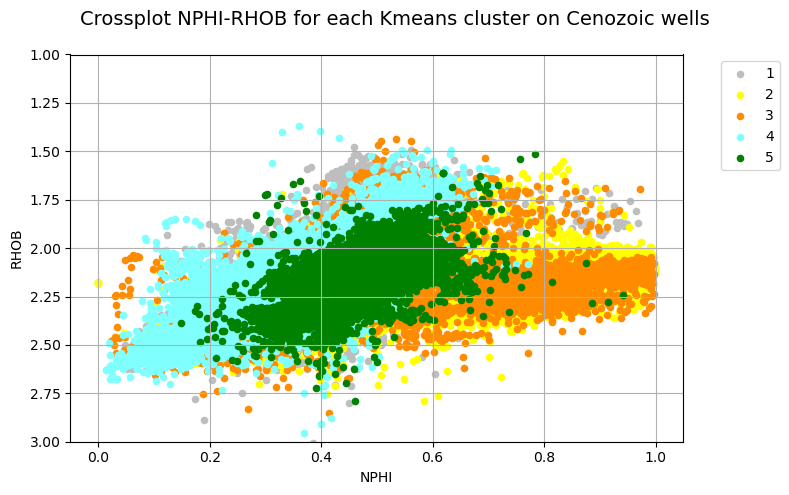

In [59]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each Kmeans cluster on Cenozoic wells', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotnphirhoball_kmeans_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

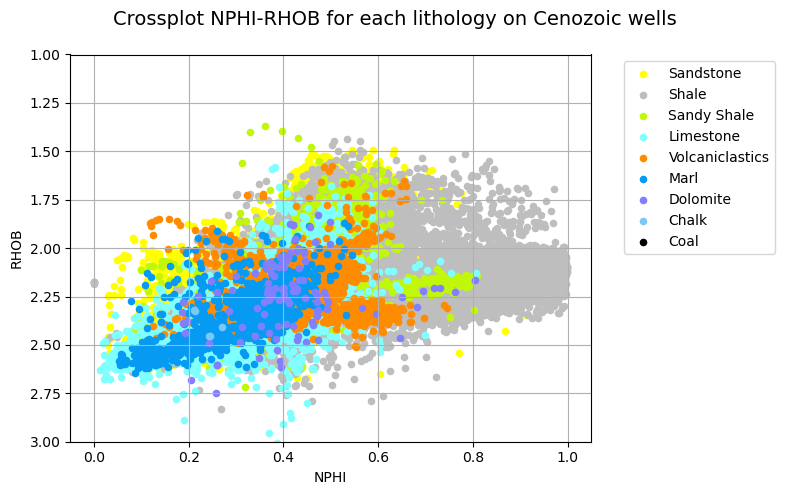

In [60]:
#Crossplot NPHI-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot NPHI-RHOB for each lithology on Cenozoic wells', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
#plt.xlim(0,200)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('NPHI')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotnphirhoball_lithology_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

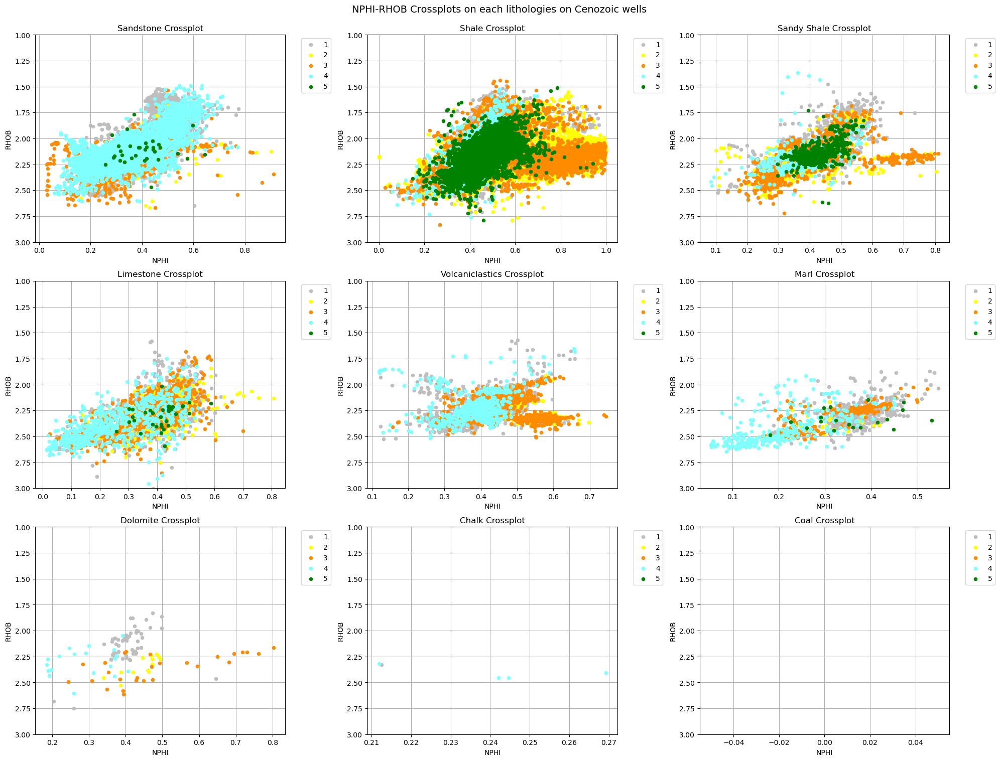

In [61]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each lithologies on Cenozoic wells', fontsize=14)
    
    for key, group in grouped_kmeans:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotnphirhoblithology_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

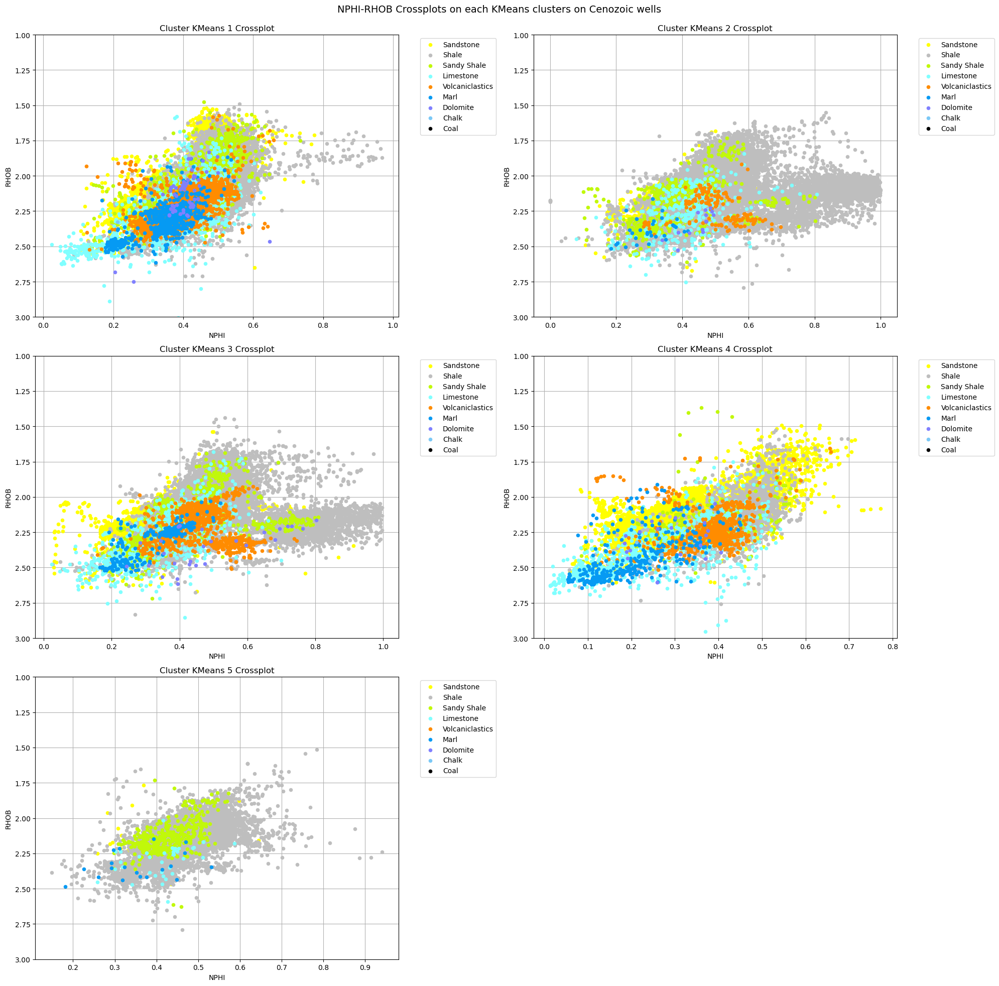

In [62]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('NPHI-RHOB Crossplots on each KMeans clusters on Cenozoic wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='NPHI', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    #ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('NPHI')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotnphirhobkmeans_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

#### GR-RHOB


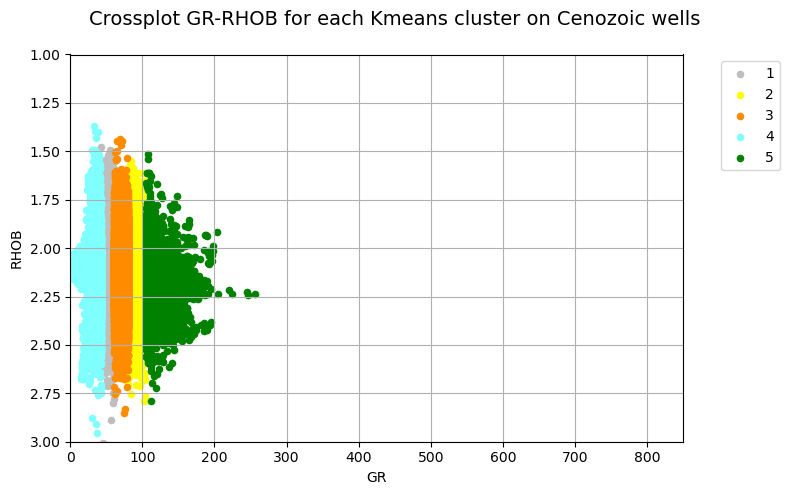

In [63]:
#Crossplot GR-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot GR-RHOB for each Kmeans cluster on Cenozoic wells', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='GR', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
plt.xlim(0,850)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('GR')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotgrrhoball_kmeans_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

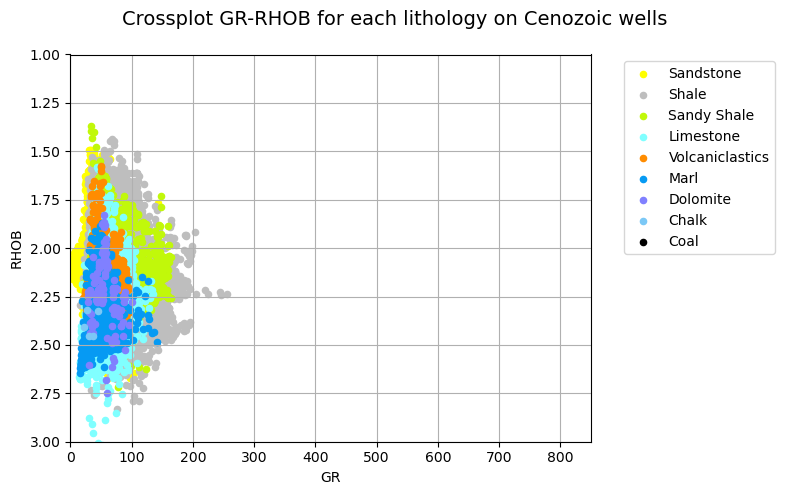

In [64]:
#Crossplot GR-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot GR-RHOB for each lithology on Cenozoic wells', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='GR', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
plt.xlim(0,850)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('GR')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotgrrhoball_lithology_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

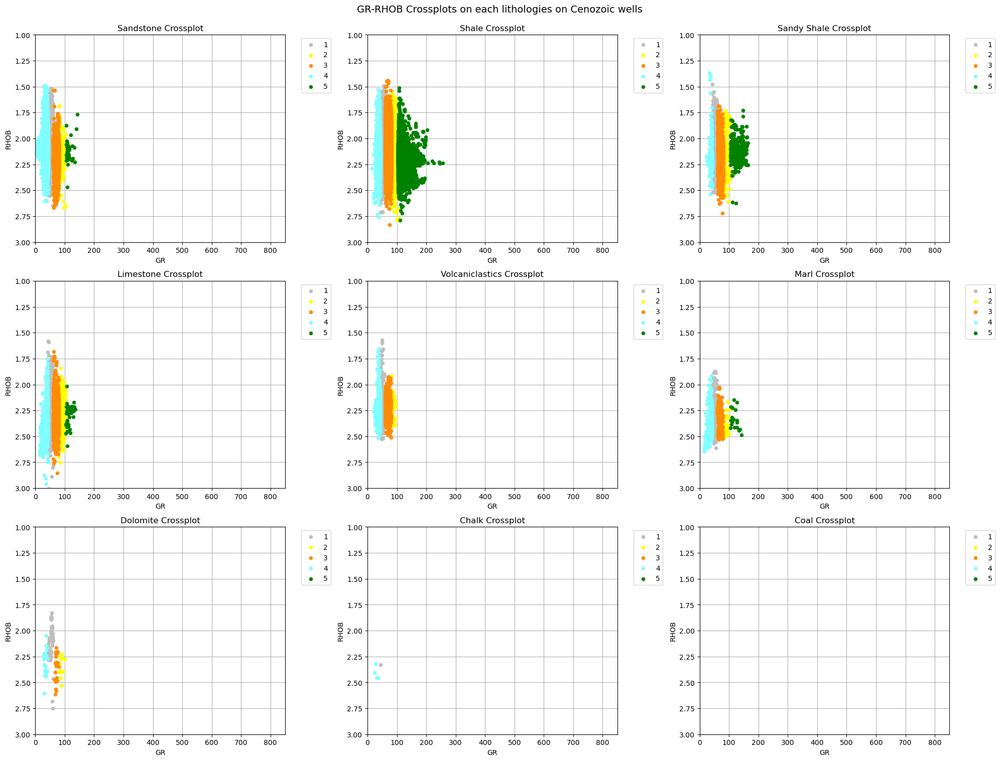

In [65]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('GR-RHOB Crossplots on each lithologies on Cenozoic wells', fontsize=14)
    
    for key, group in grouped_kmeans:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='GR', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(0, 850)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('GR')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotgrrhoblithology_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

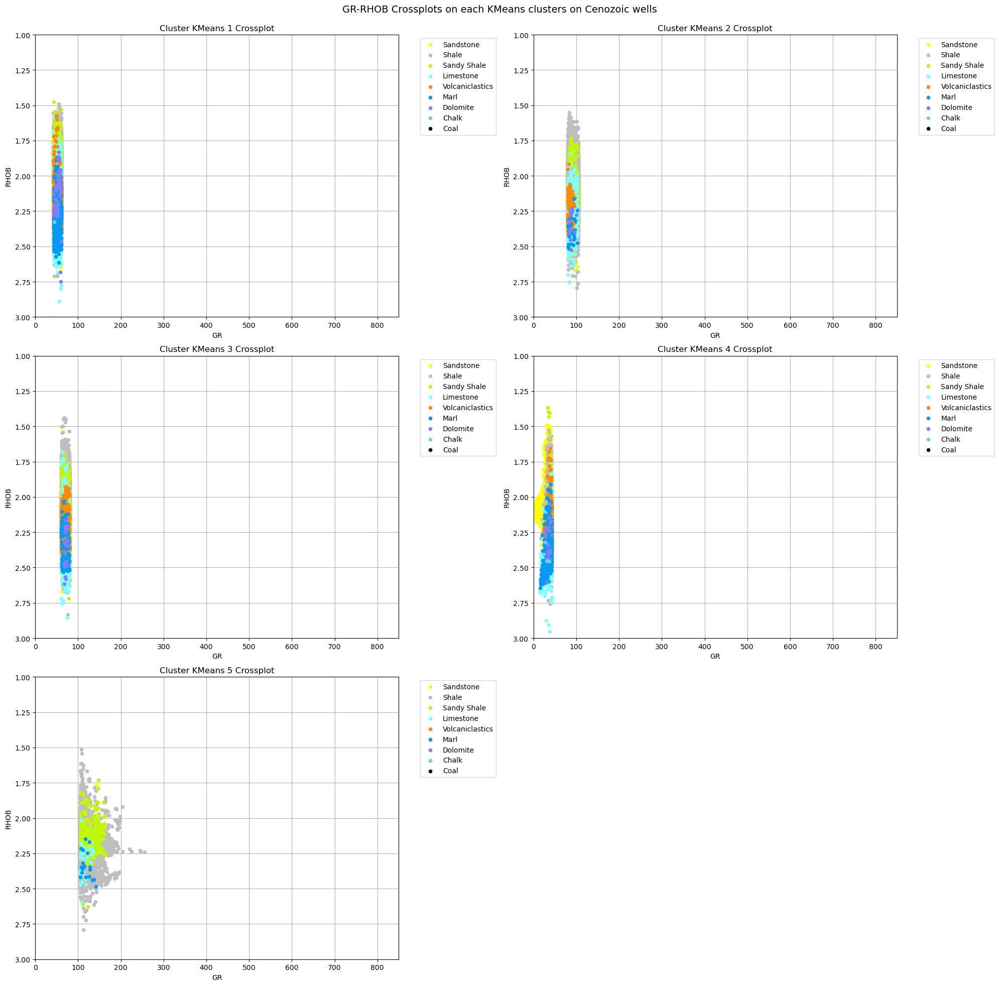

In [66]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('GR-RHOB Crossplots on each KMeans clusters on Cenozoic wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='GR', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(0, 850)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('GR')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotgrrhobkmeans_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

#### PEF-RHOB


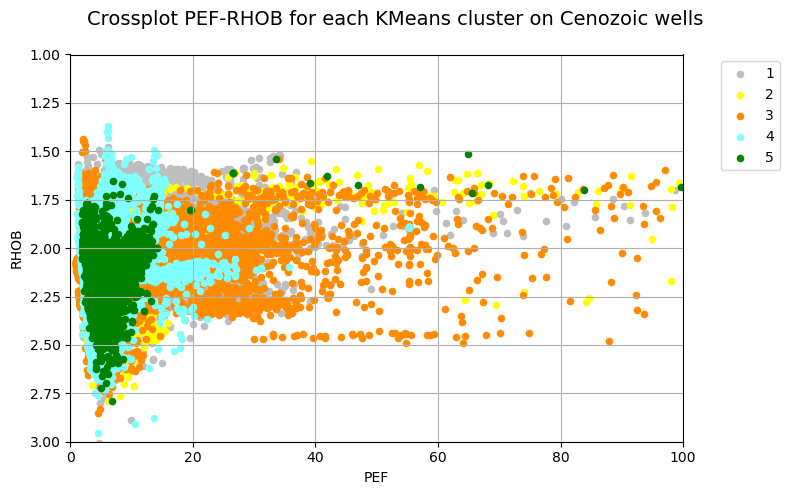

In [67]:
#Crossplot PEF-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot PEF-RHOB for each KMeans cluster on Cenozoic wells', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='PEF', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
plt.xlim(0, 100)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('PEF')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotpefrhoball_kmeans_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

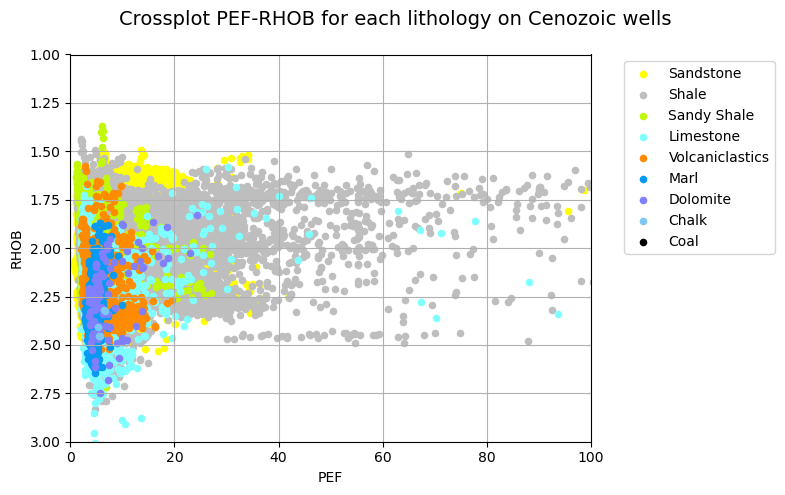

In [68]:
#Crossplot PEF-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot PEF-RHOB for each lithology on Cenozoic wells', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='PEF', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
plt.xlim(0,100)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('PEF')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotpefrhoball_lithology_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

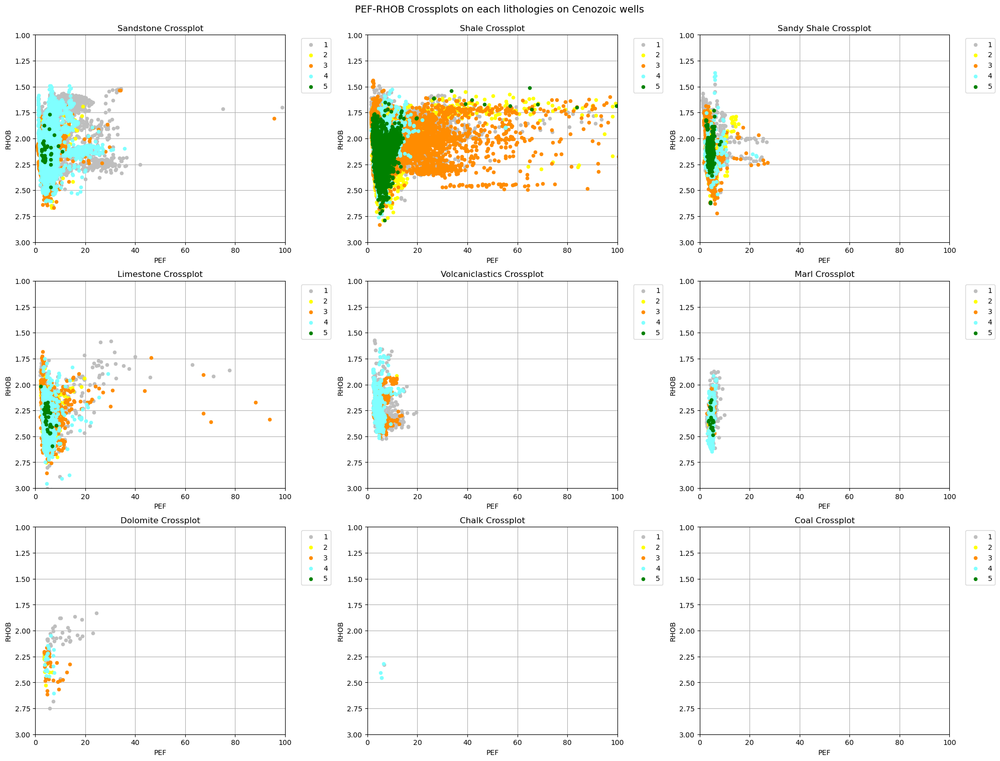

In [69]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('PEF-RHOB Crossplots on each lithologies on Cenozoic wells', fontsize=14)
    
    for key, group in grouped_kmeans:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='PEF', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(0, 100)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('PEF')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotpefrhoblithology_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

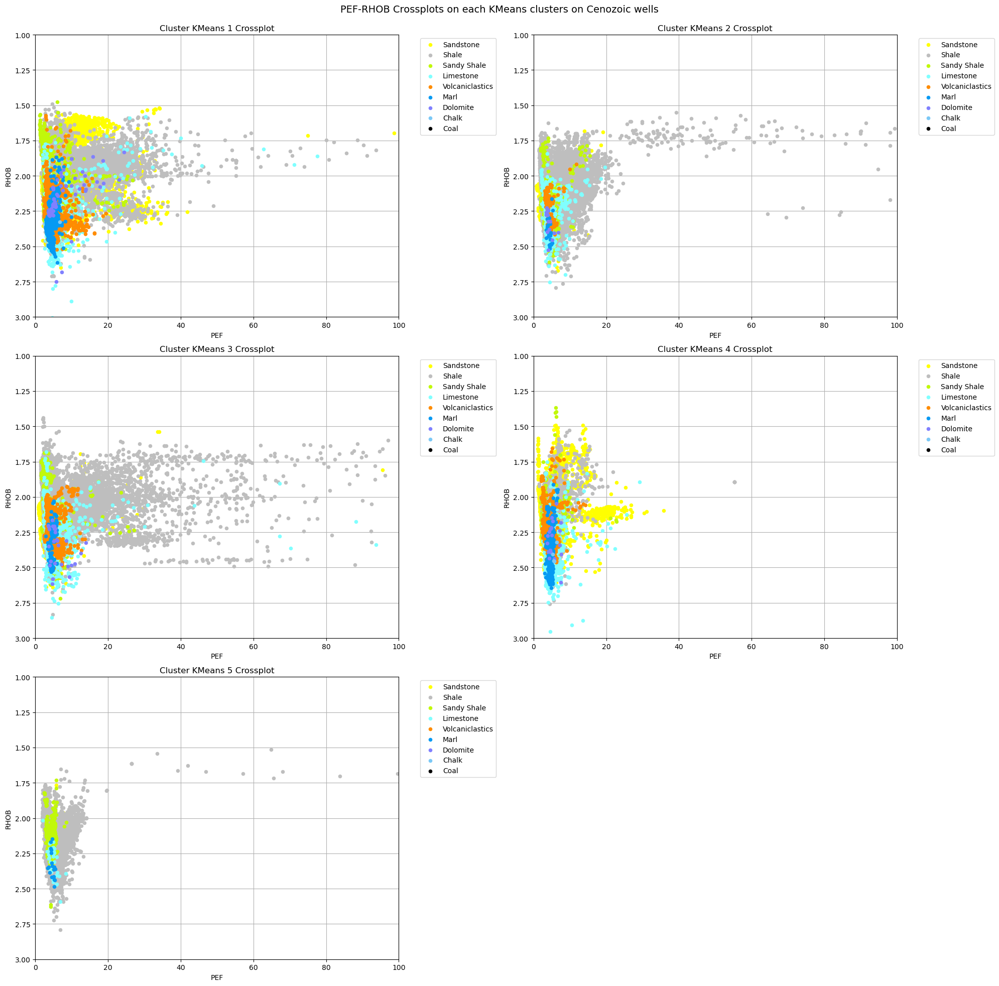

In [70]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('PEF-RHOB Crossplots on each KMeans clusters on Cenozoic wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='PEF', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(0, 100)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('PEF')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotpefrhobkmeans_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

#### DTC-RHOB


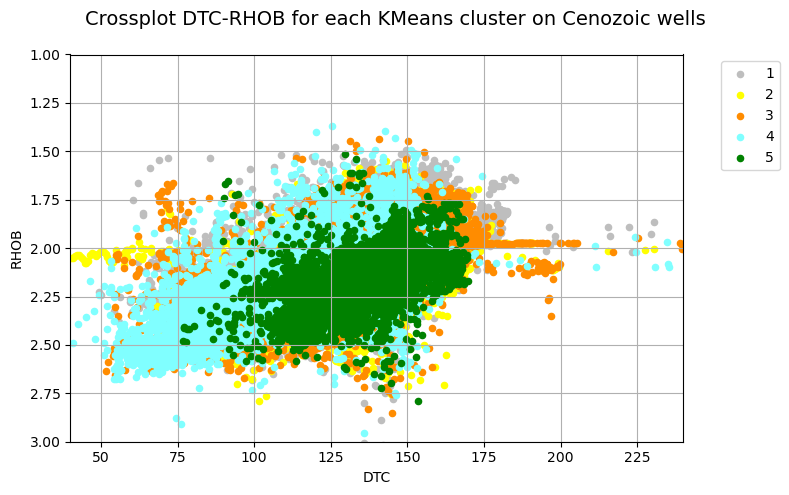

In [71]:
#Crossplot DTC-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot DTC-RHOB for each KMeans cluster on Cenozoic wells', fontsize=14)
for key, group in grouped_kmeans:
    group.plot(ax=ax, kind='scatter', x='DTC', y='RHOB', label=key, color=kmeanscolor[key])
    
plt.ylim(3,1)
plt.xlim(40, 240)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('DTC')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotdtcrhoball_kmeans_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

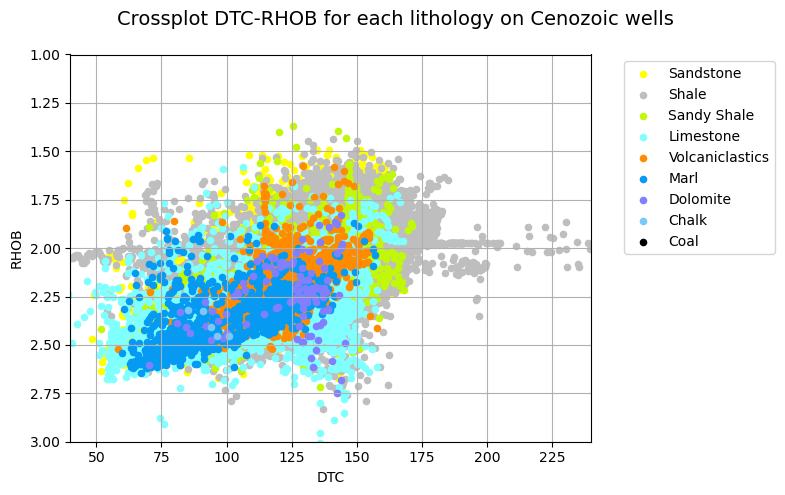

In [72]:
#Crossplot DTC-RHOB

fig, ax = plt.subplots(figsize=(8,5))
fig.suptitle('Crossplot DTC-RHOB for each lithology on Cenozoic wells', fontsize=14)
for key, group in grouped_lithology:
    group.plot(ax=ax, kind='scatter', x='DTC', y='RHOB', label=key, color=litocolor[key])
    
plt.ylim(3,1)
plt.xlim(40, 240)
plt.grid()
plt.ylabel('RHOB')
plt.xlabel('DTC')

plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.savefig('crossplotdtcrhoball_lithology_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

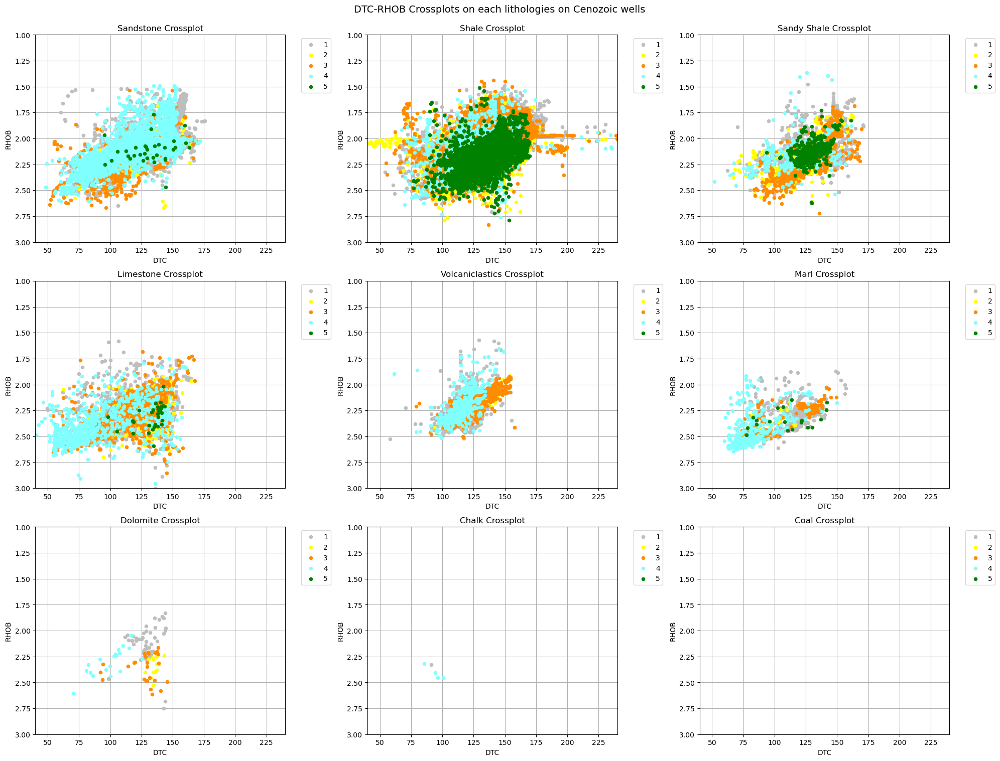

In [73]:
fig = plt.figure(figsize=(20,20))

for i, litho in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(litho+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('DTC-RHOB Crossplots on each lithologies on Cenozoic wells', fontsize=14)
    
    for key, group in grouped_kmeans:
        group[group['LIT'].isin([litho])].plot(ax=ax, kind='scatter', x='DTC', y='RHOB', label=key, color=kmeanscolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('DTC')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotdtcrhoblithology_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

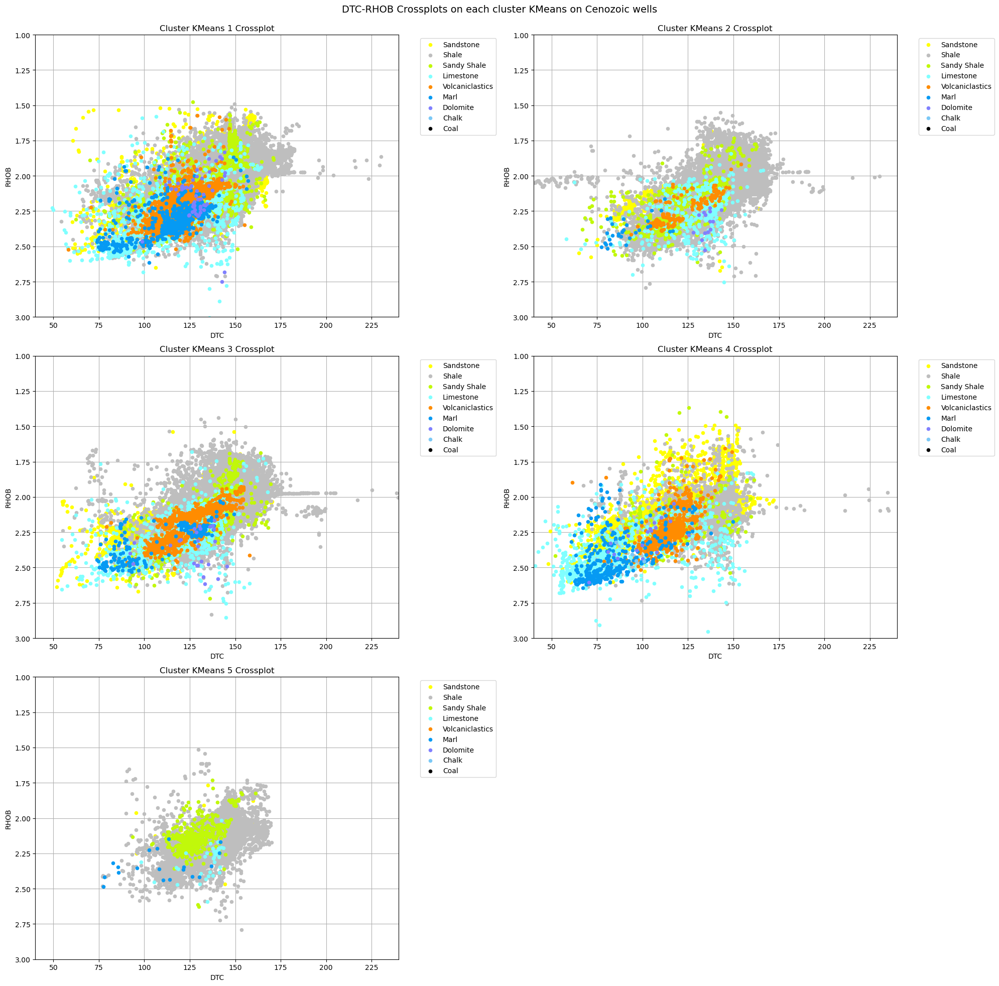

In [74]:
fig = plt.figure(figsize=(20,20))

for i, kmeans in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(kmeans)+" Crossplot")
    ax.set_axisbelow(True)
    fig.suptitle('DTC-RHOB Crossplots on each cluster KMeans on Cenozoic wells', fontsize=14)
    
    for key, group in grouped_lithology:
        group[group['KMeans'].isin([kmeans])].plot(ax=ax, kind='scatter', x='DTC', y='RHOB', label=key, color=litocolor[key])
    
    ax.set_ylim(3,1)
    ax.set_xlim(40,240)
    ax.grid()
    ax.set_ylabel('RHOB')
    ax.set_xlabel('DTC')

    ax.legend(loc='upper left', bbox_to_anchor=(1.05, 1.0))
#plt.subplots_adjust(top=0.95)
plt.tight_layout()
plt.subplots_adjust(top=0.95)
plt.savefig('crossplotdtcrhobkmeans_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

### Histograms


#### Histogram for cluster-lithology with frequency matrix (crosstab)


##### Frequency matrix

In [75]:
# calculate the distribution of `Clicked` per `Rank`
distribution1 = pd.crosstab(well_clustered.KMeans, well_clustered.LIT, normalize='index')
distribution1

LIT,Chalk,Dolomite,Limestone,Marl,Sandstone,Sandy Shale,Shale,Volcaniclastics
KMeans,,,,,,,,
1,0.000028,0.001584,0.030034,0.019199,0.158896,0.032702,0.700128,0.057429
2,0.000000,0.000364,0.009514,0.000780,0.018274,0.018976,0.948192,0.003899
3,0.000000,0.000694,0.019227,0.006323,0.087962,0.027967,0.835925,0.021901
4,0.000330,0.001567,0.063351,0.027716,0.637713,0.023921,0.190217,0.055184
5,0.000000,0.000000,0.002483,0.001275,0.002215,0.026646,0.967380,0.000000


In [76]:
distribution2 = pd.crosstab(well_clustered.KMeans, well_clustered.LIT, normalize='columns')
distribution2

LIT,Chalk,Dolomite,Limestone,Marl,Sandstone,Sandy Shale,Shale,Volcaniclastics
KMeans,,,,,,,,
1,0.2,0.487179,0.360333,0.522693,0.324796,0.319663,0.227194,0.552970
2,0.0,0.119658,0.122000,0.022693,0.039925,0.198262,0.328867,0.040128
3,0.0,0.230769,0.249333,0.186082,0.194343,0.295492,0.293200,0.227929
4,0.8,0.162393,0.256000,0.254160,0.439062,0.078762,0.020791,0.178973
5,0.0,0.000000,0.012333,0.014372,0.001874,0.107822,0.129948,0.000000


In [77]:
distribution3 = pd.crosstab(well_clustered.LIT, well_clustered.KMeans, normalize='index')
distribution3

KMeans,1,2,3,4,5
LIT,,,,,
Chalk,0.200000,0.000000,0.000000,0.800000,0.000000
Dolomite,0.487179,0.119658,0.230769,0.162393,0.000000
Limestone,0.360333,0.122000,0.249333,0.256000,0.012333
Marl,0.522693,0.022693,0.186082,0.254160,0.014372
Sandstone,0.324796,0.039925,0.194343,0.439062,0.001874
Sandy Shale,0.319663,0.198262,0.295492,0.078762,0.107822
Shale,0.227194,0.328867,0.293200,0.020791,0.129948
Volcaniclastics,0.552970,0.040128,0.227929,0.178973,0.000000


In [78]:
distribution4 = pd.crosstab(well_clustered.LIT, well_clustered.KMeans, normalize='columns')
distribution4

KMeans,1,2,3,4,5
LIT,,,,,
Chalk,0.000028,0.000000,0.000000,0.000330,0.000000
Dolomite,0.001584,0.000364,0.000694,0.001567,0.000000
Limestone,0.030034,0.009514,0.019227,0.063351,0.002483
Marl,0.019199,0.000780,0.006323,0.027716,0.001275
Sandstone,0.158896,0.018274,0.087962,0.637713,0.002215
Sandy Shale,0.032702,0.018976,0.027967,0.023921,0.026646
Shale,0.700128,0.948192,0.835925,0.190217,0.967380
Volcaniclastics,0.057429,0.003899,0.021901,0.055184,0.000000


##### Histogram result

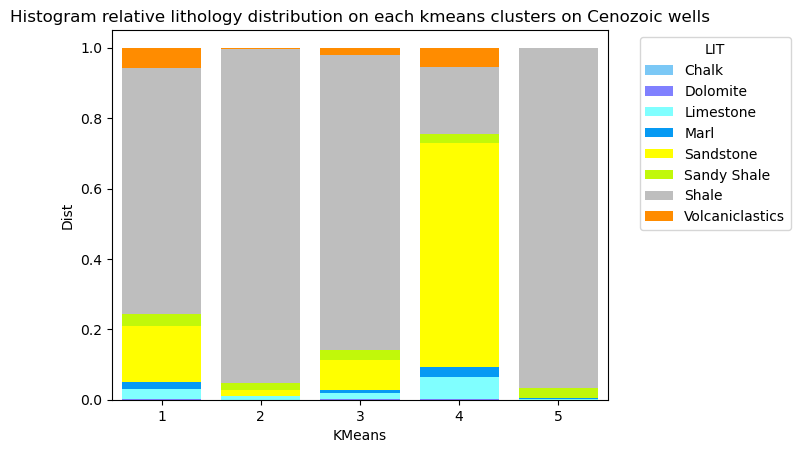

In [79]:
# plot the cumsum, with reverse hue order
ax=sns.barplot(data=distribution1.cumsum(axis=1).stack().reset_index(name='Dist'),
            x='KMeans', y='Dist', hue='LIT',
            hue_order = distribution1.columns[::-1],   # reverse hue order so that the taller bars got plotted first
            palette=litocolor, saturation=1, linewidth=1, 
            dodge=False)

sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0), reverse=True)
#plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram relative lithology distribution on each kmeans clusters on Cenozoic wells")
plt.savefig('histogramrelative_lithologycount_cenozoicdata_old.png', bbox_inches='tight')

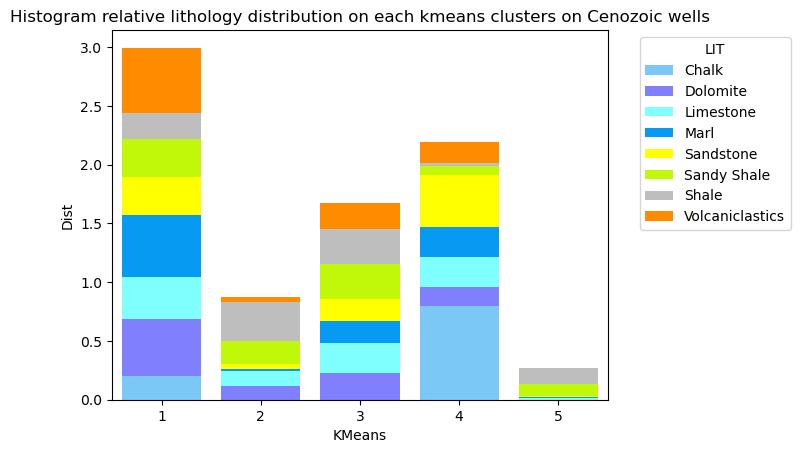

In [80]:
# plot the cumsum, with reverse hue order
ax=sns.barplot(data=distribution2.cumsum(axis=1).stack().reset_index(name='Dist'),
            x='KMeans', y='Dist', hue='LIT',
            hue_order = distribution2.columns[::-1],   # reverse hue order so that the taller bars got plotted first
            palette=litocolor, saturation=1,
            dodge=False)

sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0), reverse=True)
#plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram relative lithology distribution on each kmeans clusters on Cenozoic wells")
plt.savefig('histogramrelative_lithologyproportion_cenozoicdata_old.png', bbox_inches='tight')

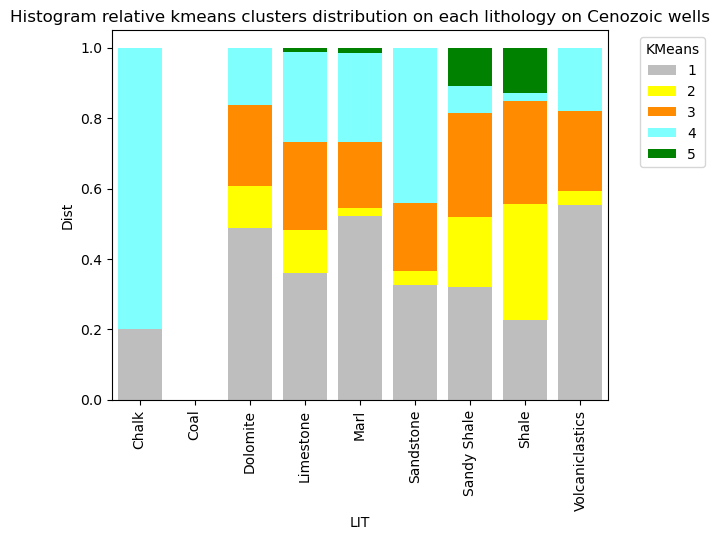

In [81]:
# plot the cumsum, with reverse hue order
ax=sns.barplot(data=distribution3.cumsum(axis=1).stack().reset_index(name='Dist'),
            x='LIT', y='Dist', hue='KMeans',
            hue_order = distribution3.columns[::-1],   # reverse hue order so that the taller bars got plotted first
            palette=kmeanscolor, saturation=1,
            dodge=False)

sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0), reverse=True)
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram relative kmeans clusters distribution on each lithology on Cenozoic wells")
plt.savefig('histogramrelative_kmeanscount_cenozoicdata_old.png', bbox_inches='tight')

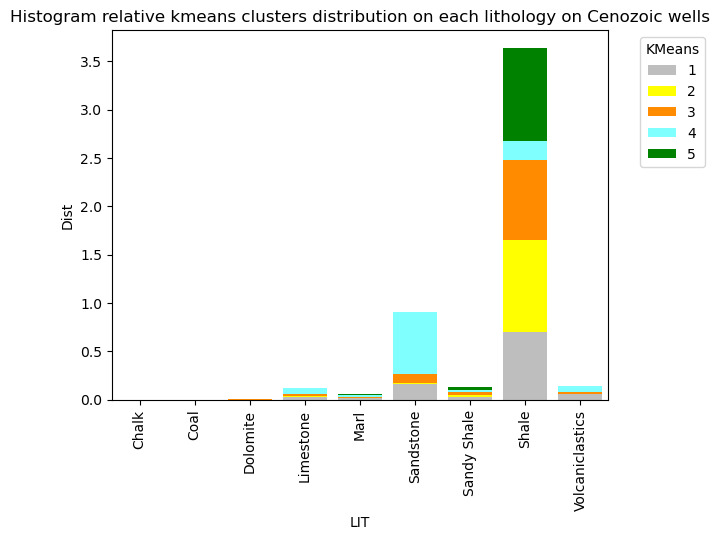

In [82]:
# plot the cumsum, with reverse hue order
ax=sns.barplot(data=distribution4.cumsum(axis=1).stack().reset_index(name='Dist'),
            x='LIT', y='Dist', hue='KMeans',
            hue_order = distribution4.columns[::-1],   # reverse hue order so that the taller bars got plotted first
            palette=kmeanscolor, saturation=1,
            dodge=False)

sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0), reverse=True)
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram relative kmeans clusters distribution on each lithology on Cenozoic wells")
plt.savefig('histogramrelative_kmeansproportion_cenozoicdata_old.png', bbox_inches='tight')

#### Histogram for cluster-lithology


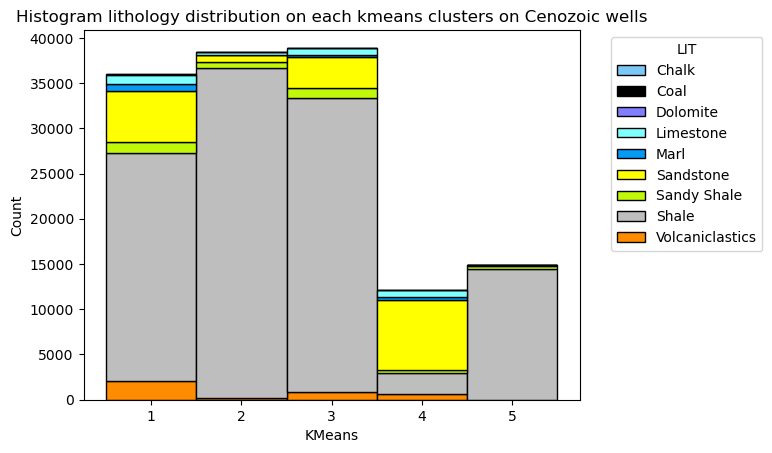

In [83]:
ax=sns.histplot(data=well_clustered, x='KMeans', hue='LIT', stat='count', multiple='stack', alpha=1, discrete=True, fill=True,  palette=litocolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.title("Histogram lithology distribution on each kmeans clusters on Cenozoic wells")
plt.savefig('histogramlithologykmeans_stackcount_cenozoicdata_old.png', bbox_inches='tight')

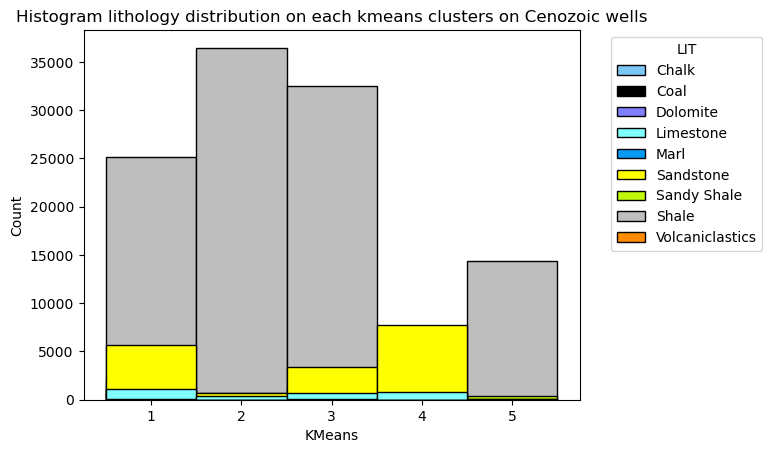

In [84]:
ax=sns.histplot(data=well_clustered, x='KMeans', hue='LIT', stat='count', multiple='layer', alpha=1, discrete=True, fill=True,  palette=litocolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.title("Histogram lithology distribution on each kmeans clusters on Cenozoic wells")
plt.savefig('histogramlithologykmeans_layercount_cenozoicdata_old.png', bbox_inches='tight')

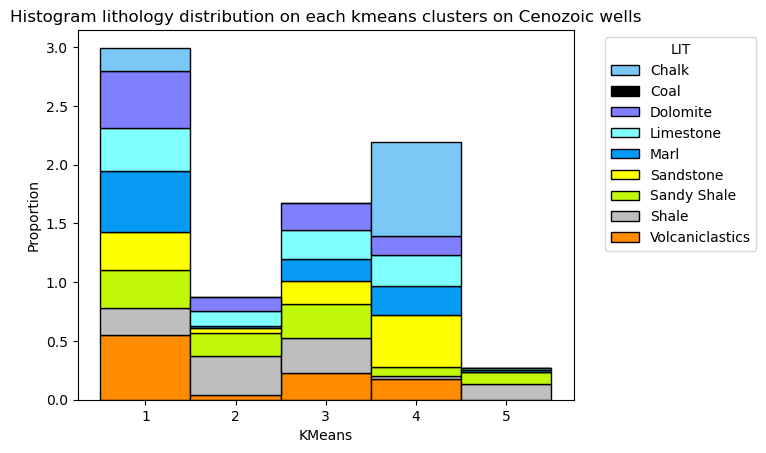

In [85]:
ax=sns.histplot(data=well_clustered, x='KMeans', hue='LIT', stat='proportion', multiple='stack', alpha=1, discrete=True, fill=True,  palette=litocolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.title("Histogram lithology distribution on each kmeans clusters on Cenozoic wells")
plt.savefig('histogramlithologykmeans_stackproportion_cenozoicdata_old.png', bbox_inches='tight')

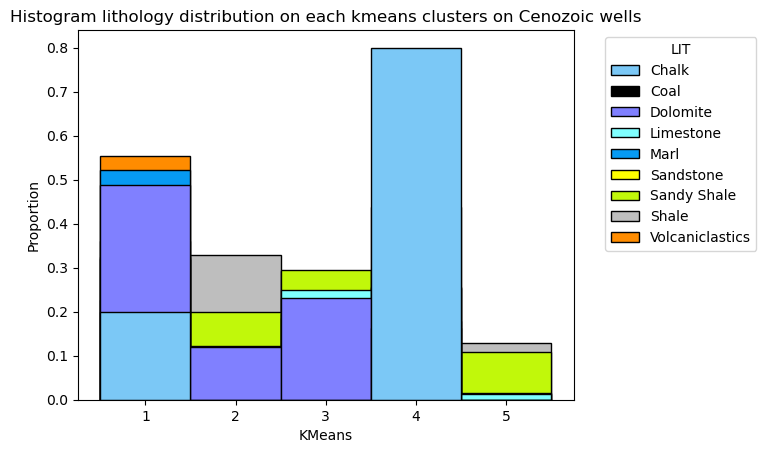

In [86]:
ax=sns.histplot(data=well_clustered, x='KMeans', hue='LIT', stat='proportion', multiple='layer', alpha=1, discrete=True, fill=True,  palette=litocolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.title("Histogram lithology distribution on each kmeans clusters on Cenozoic wells")
plt.savefig('histogramlithologykmeans_layerproportion_old.png', bbox_inches='tight')

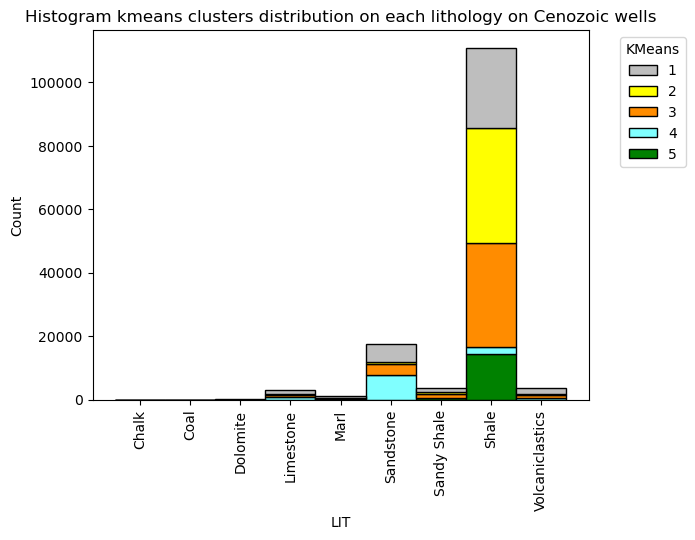

In [87]:
ax=sns.histplot(data=well_clustered, x='LIT', hue='KMeans', stat='count', multiple='stack', alpha=1, discrete=True, fill=True,  palette=kmeanscolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram kmeans clusters distribution on each lithology on Cenozoic wells")
plt.savefig('histogramkmeanslithology_stackcount_cenozoicdata_old.png', bbox_inches='tight')

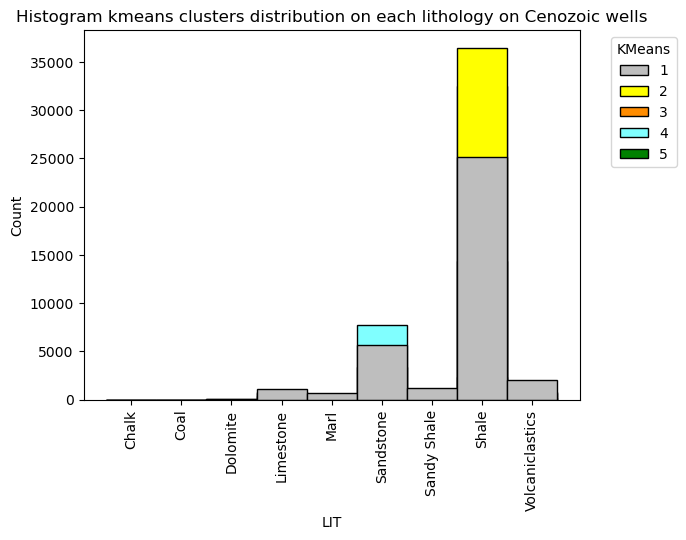

In [88]:
ax=sns.histplot(data=well_clustered, x='LIT', hue='KMeans', stat='count', multiple='layer', alpha=1, discrete=True, fill=True,  palette=kmeanscolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram kmeans clusters distribution on each lithology on Cenozoic wells")
plt.savefig('histogramkmeanslithology_layercount_cenozoicdata_old.png', bbox_inches='tight')

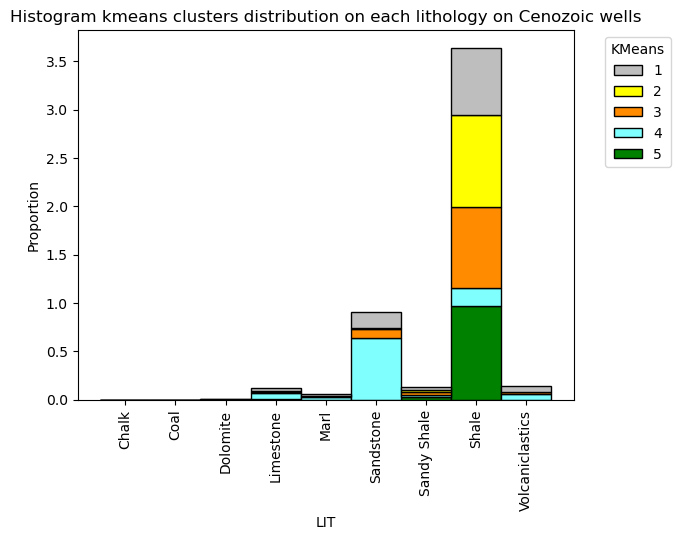

In [89]:
ax=sns.histplot(data=well_clustered, x='LIT', hue='KMeans', stat='proportion', multiple='stack', alpha=1, discrete=True, fill=True,  palette=kmeanscolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram kmeans clusters distribution on each lithology on Cenozoic wells")
plt.savefig('histogramkmeanslithology_stackproportion_cenozoicdata_old.png', bbox_inches='tight')

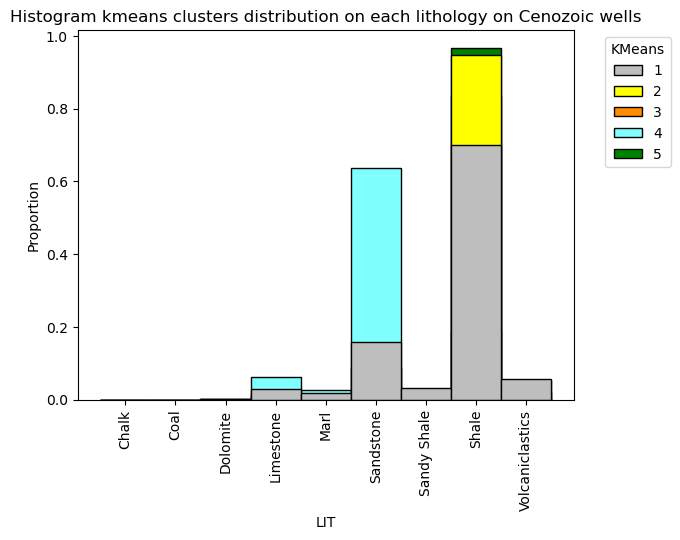

In [90]:
ax=sns.histplot(data=well_clustered, x='LIT', hue='KMeans', stat='proportion', multiple='layer', alpha=1, discrete=True, fill=True,  palette=kmeanscolor, common_norm=False)
sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
plt.setp(ax.get_xticklabels(), rotation=90)
plt.title("Histogram kmeans clusters distribution on each lithology on Cenozoic wells")
plt.savefig('histogramkmeanslithology_proportion_cenozoicdata_old.png', bbox_inches='tight')

#### Histogram for cluster-lithology (detail)


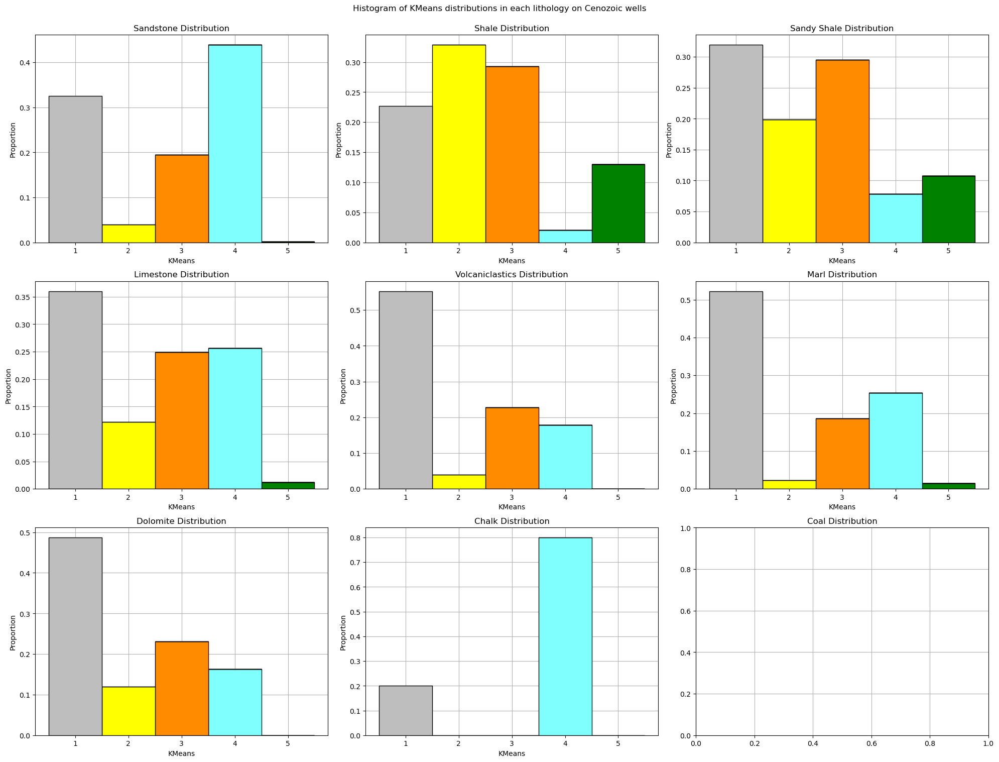

In [91]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of KMeans distributions in each lithology on Cenozoic wells')

for i, feature in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    
    if well_clustered[well_clustered['LIT']==feature]['KMeans'].unique().sum()==0:
        pass
    else:
        ax=sns.histplot(data=well_clustered[well_clustered['LIT']==feature], x='KMeans', hue='KMeans', palette=kmeanscolor, stat='proportion', multiple='stack', alpha=1, discrete=True, binrange=(1,5), fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramkmeans_stackproportion_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

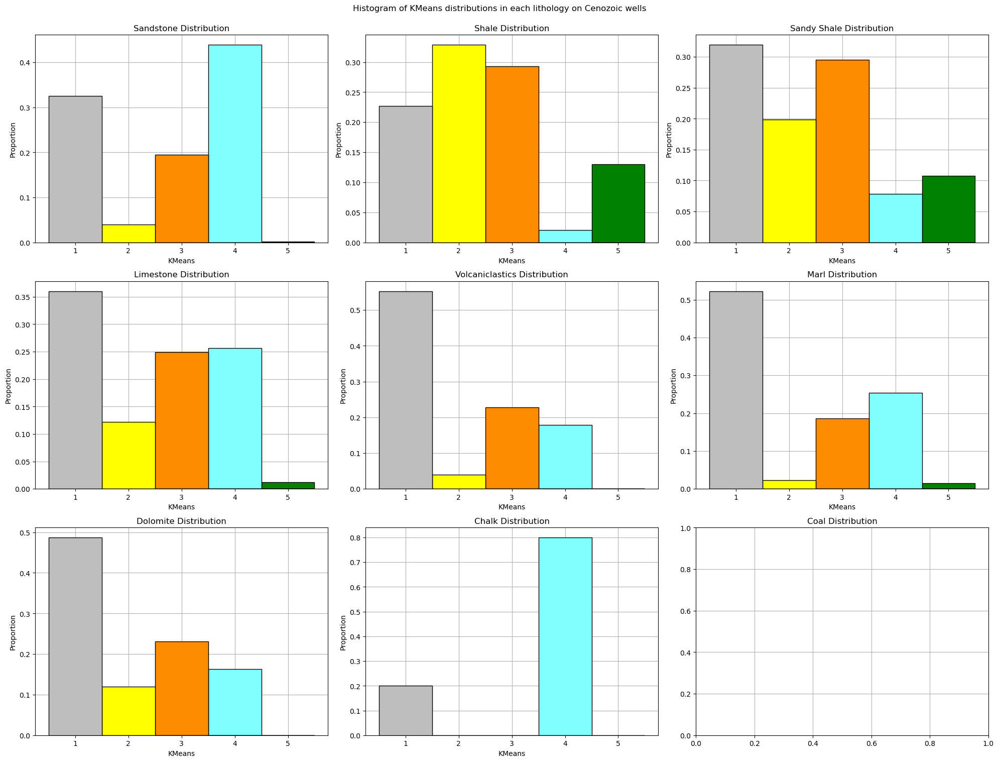

In [92]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of KMeans distributions in each lithology on Cenozoic wells')

for i, feature in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    
    if well_clustered[well_clustered['LIT']==feature]['KMeans'].unique().sum()==0:
        pass
    else:
        ax=sns.histplot(data=well_clustered[well_clustered['LIT']==feature], x='KMeans', hue='KMeans', palette=kmeanscolor, stat='proportion', multiple='layer', alpha=1, discrete=True, binrange=(1,5), fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramkmeans_layerproportion_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

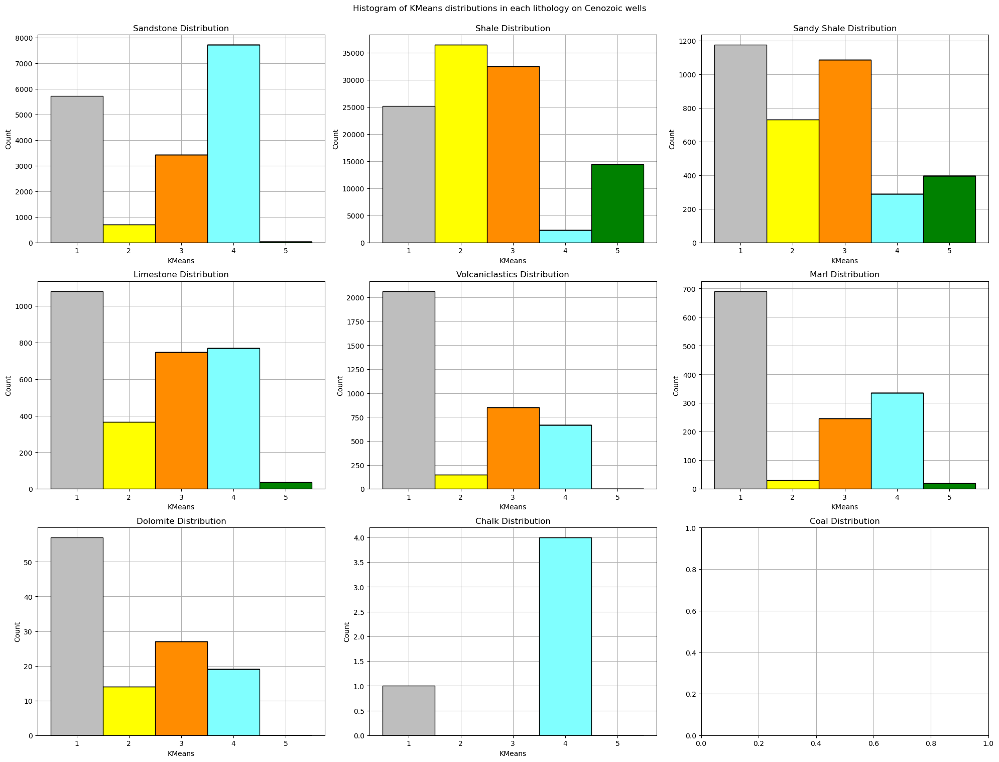

In [93]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of KMeans distributions in each lithology on Cenozoic wells')

for i, feature in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    
    if well_clustered[well_clustered['LIT']==feature]['KMeans'].unique().sum()==0:
        pass
    else:
        ax=sns.histplot(data=well_clustered[well_clustered['LIT']==feature], x='KMeans', hue='KMeans', palette=kmeanscolor, stat='count', multiple='stack', alpha=1, discrete=True, binrange=(1,5), fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramkmeans_stackcount_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

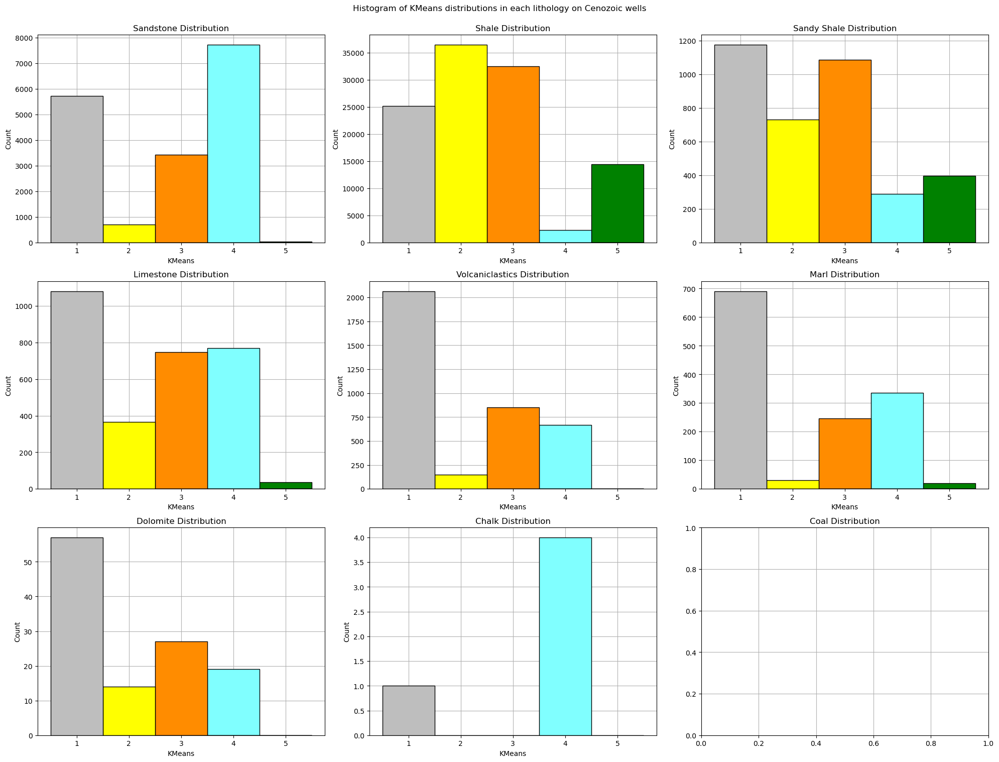

In [94]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of KMeans distributions in each lithology on Cenozoic wells')

for i, feature in enumerate(keys_lithology):
    ax=fig.add_subplot(4,3,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    
    if well_clustered[well_clustered['LIT']==feature]['KMeans'].unique().sum()==0:
        pass
    else:
        ax=sns.histplot(data=well_clustered[well_clustered['LIT']==feature], x='KMeans', hue='KMeans', palette=kmeanscolor, stat='count', multiple='layer', alpha=1, discrete=True, binrange=(1,5), fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramkmeans_layercount_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

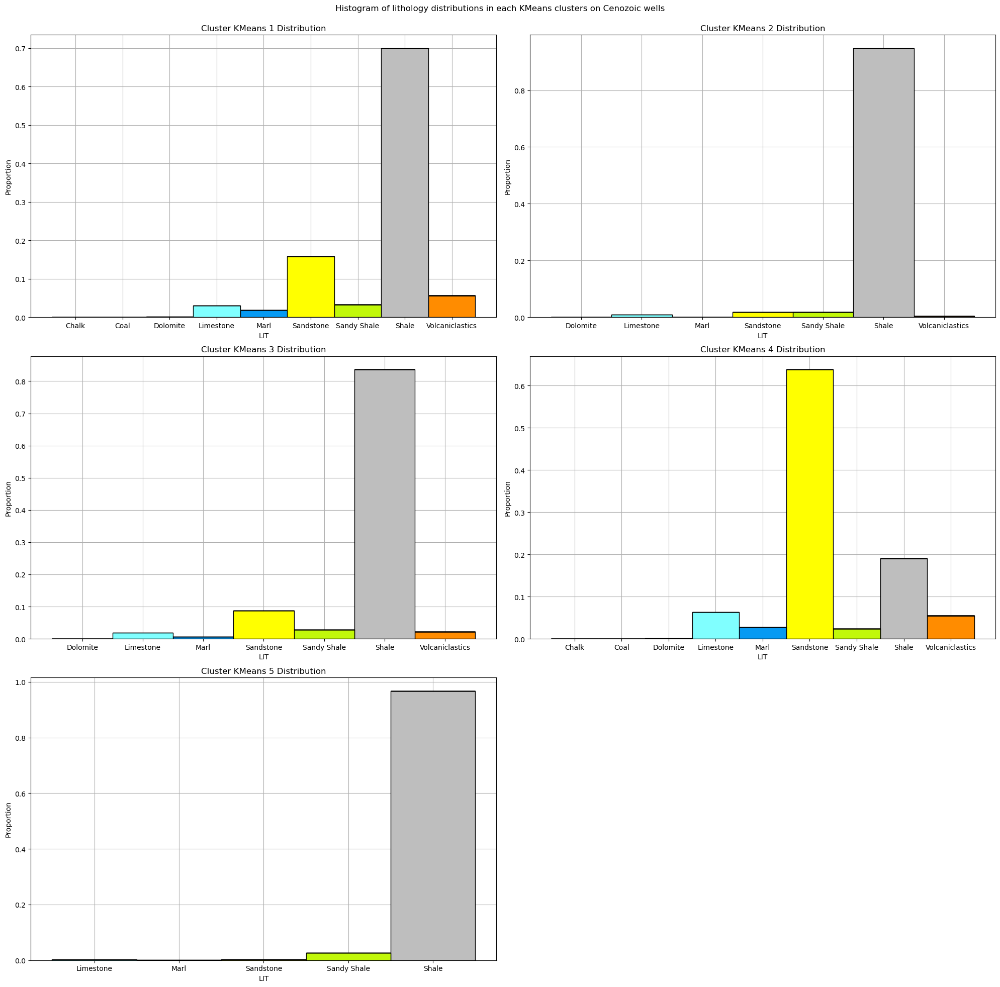

In [95]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of lithology distributions in each KMeans clusters on Cenozoic wells')

for i, feature in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(feature)+" Distribution")
    ax.set_axisbelow(True)
    
    
    ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==feature], x='LIT', hue='LIT', palette=litocolor, stat='proportion', multiple='stack', alpha=1, discrete=True, fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramlithology_stackproportion_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

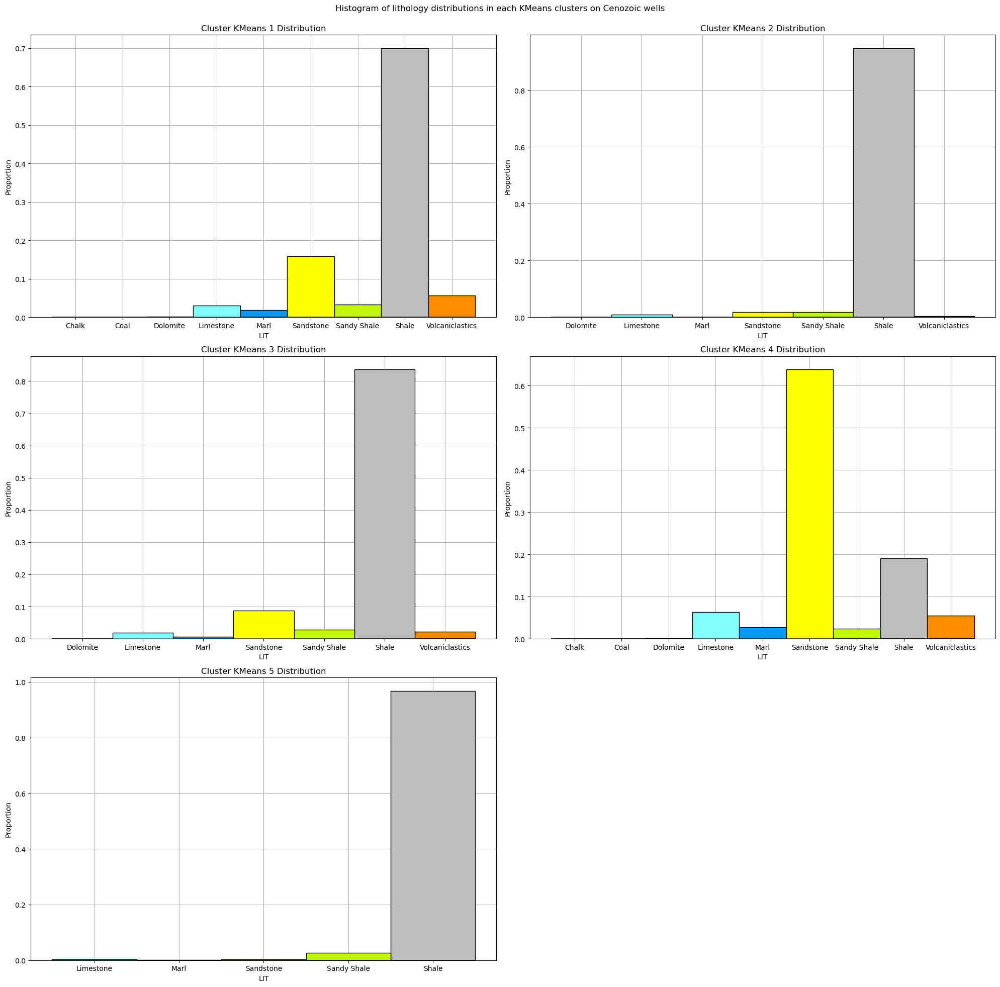

In [96]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of lithology distributions in each KMeans clusters on Cenozoic wells')

for i, feature in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(feature)+" Distribution")
    ax.set_axisbelow(True)
    
    
    ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==feature], x='LIT', hue='LIT', palette=litocolor, stat='proportion', multiple='layer', alpha=1, discrete=True, fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramlithology_layerproportion_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

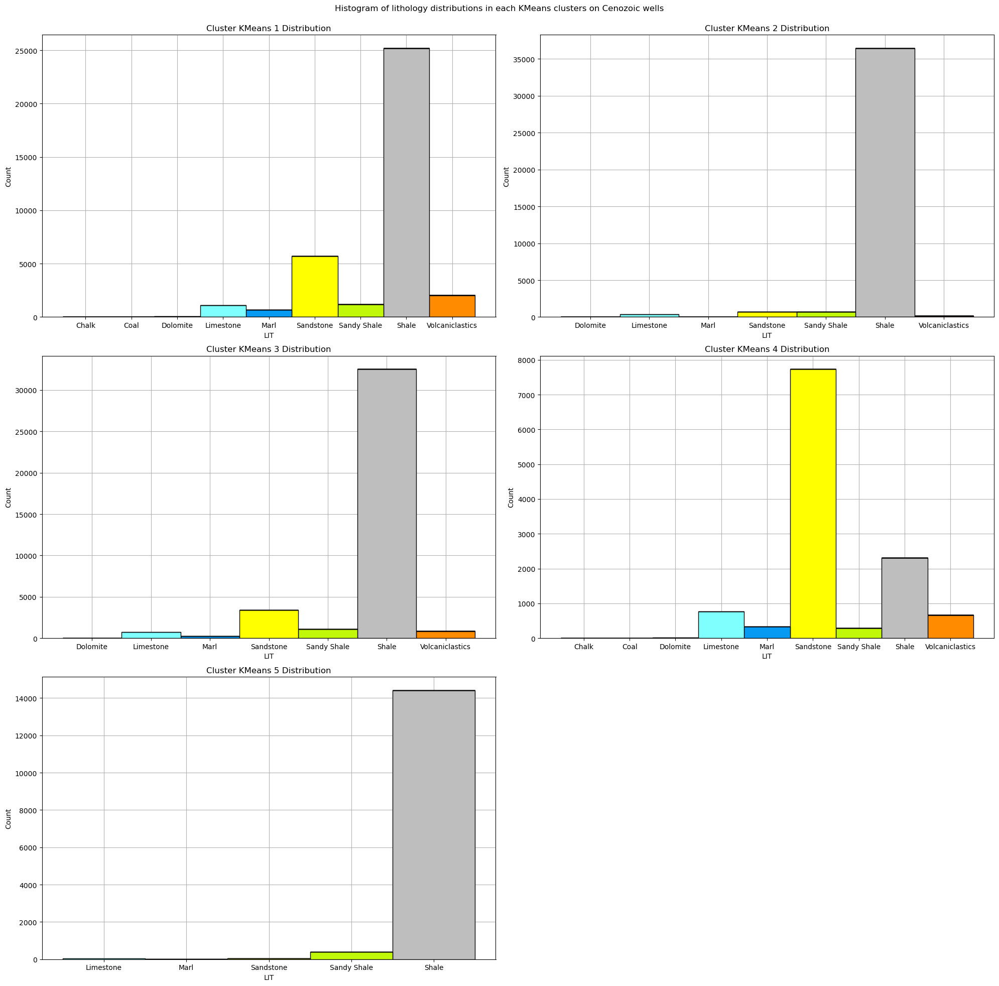

In [97]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of lithology distributions in each KMeans clusters on Cenozoic wells')

for i, feature in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(feature)+" Distribution")
    ax.set_axisbelow(True)
    
    
    ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==feature], x='LIT', hue='LIT', palette=litocolor, stat='count', multiple='stack', alpha=1, discrete=True, fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramlithology_stackcount_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

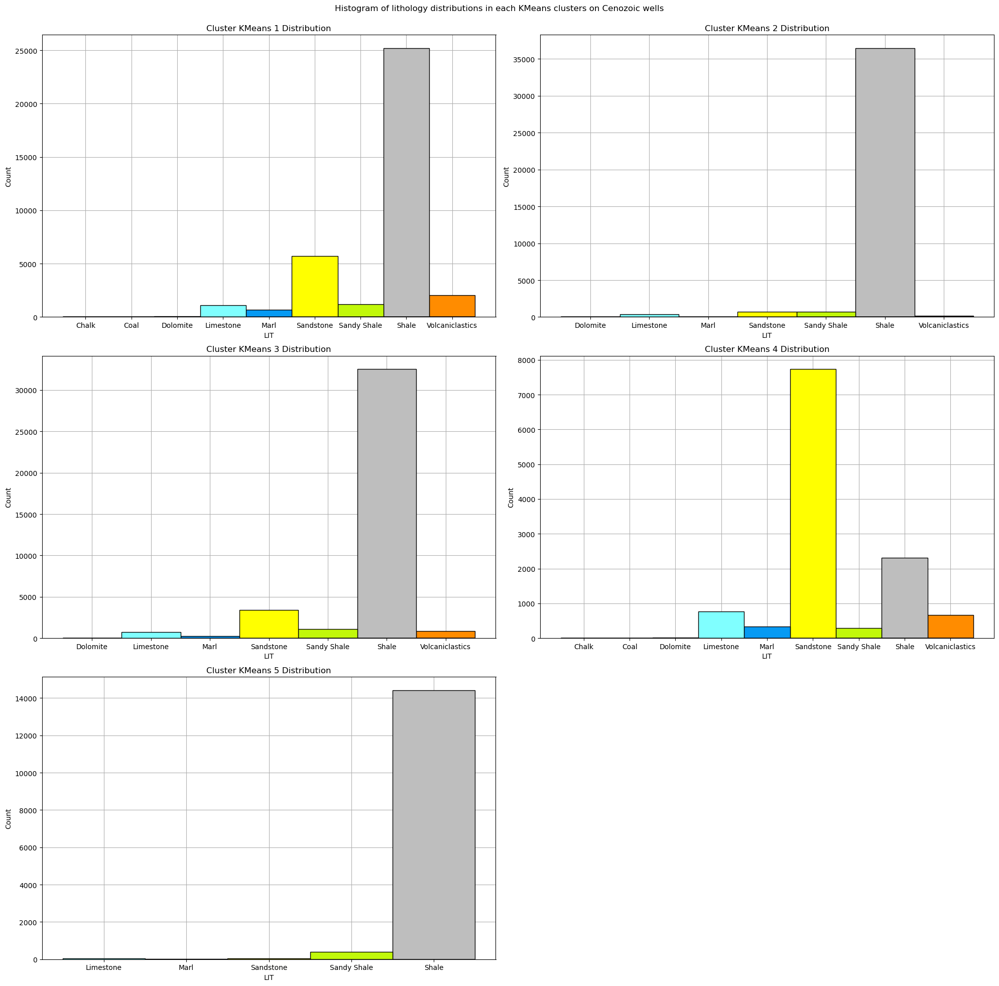

In [98]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of lithology distributions in each KMeans clusters on Cenozoic wells')

for i, feature in enumerate(keys_kmeans):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title("Cluster KMeans "+str(feature)+" Distribution")
    ax.set_axisbelow(True)
    
    
    ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==feature], x='LIT', hue='LIT', palette=litocolor, stat='count', multiple='layer', alpha=1, discrete=True, fill=True, legend=False, common_norm=True)

    ax.grid()

plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramlithology_layercount_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

#### Histogram for each well logs (cluster group, lithology hue)


##### On all clusters

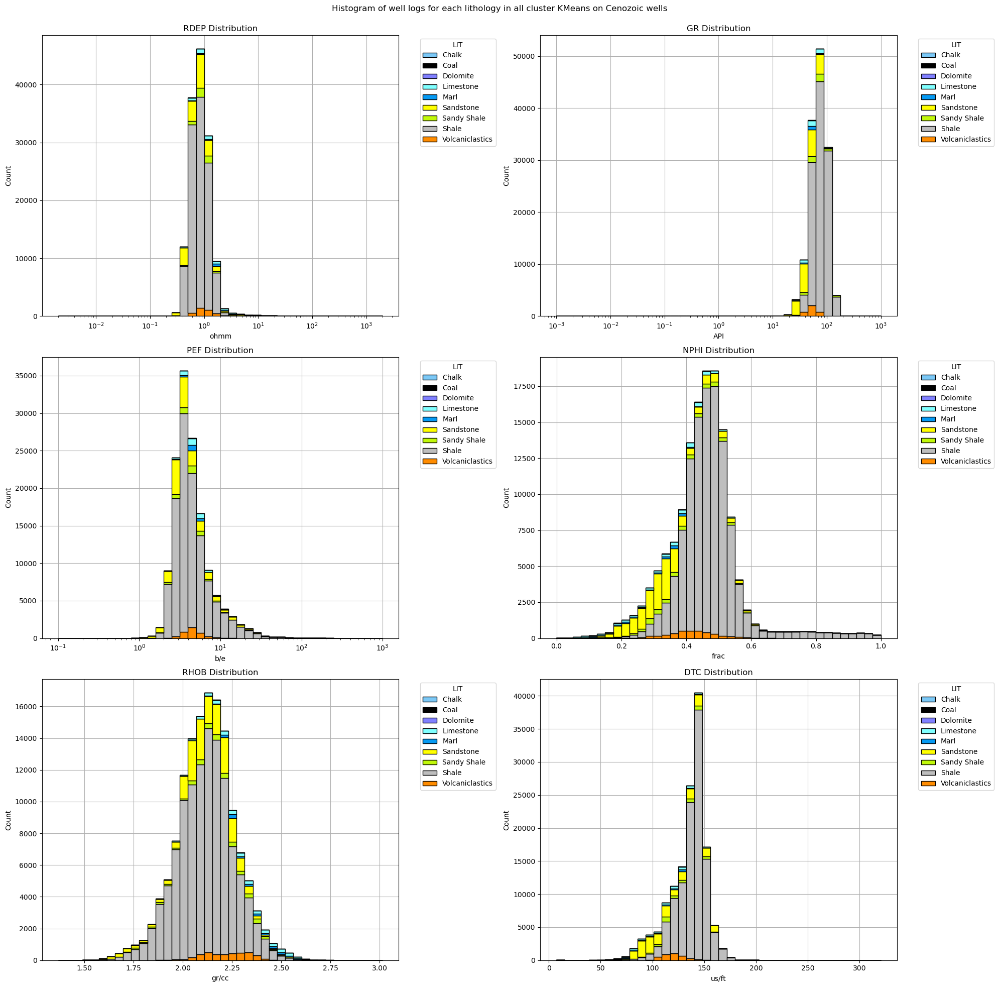

In [99]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each lithology in all cluster KMeans on Cenozoic wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
  
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')

    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwellloglithology_allclusters_stackcount_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

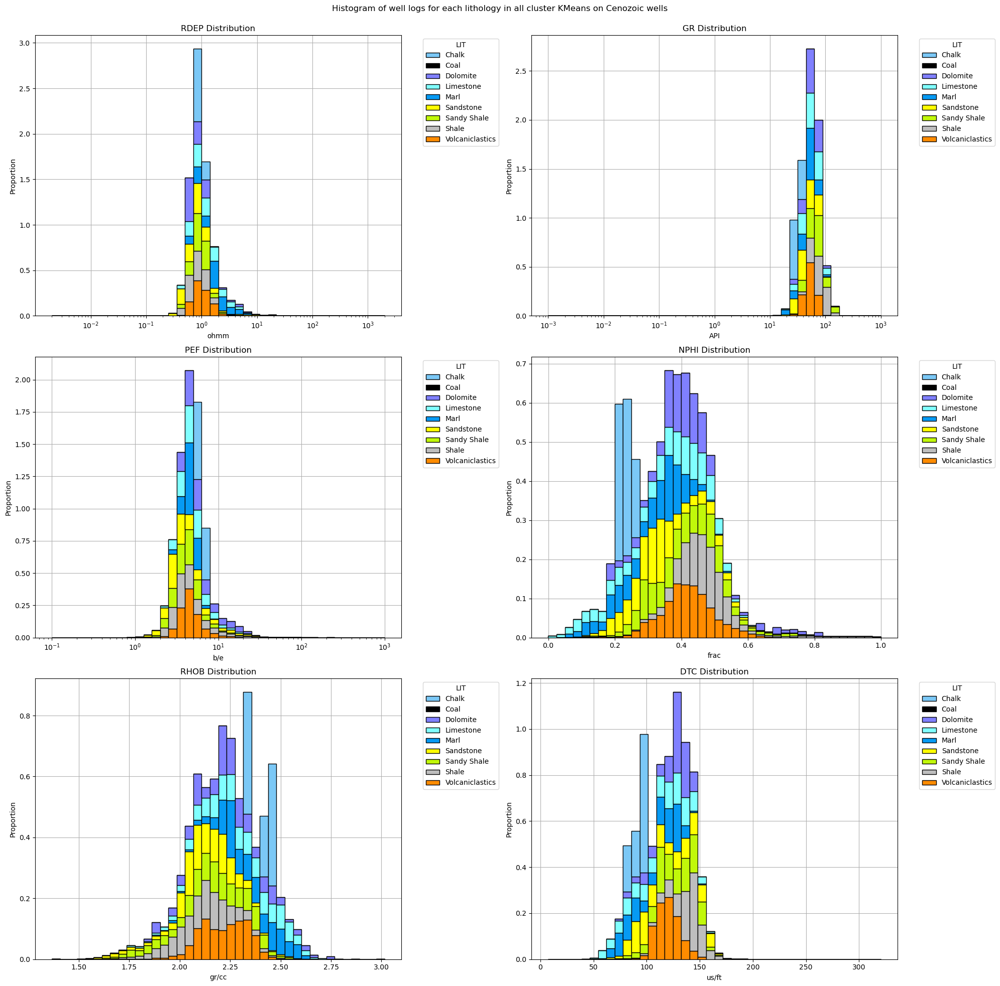

In [100]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each lithology in all cluster KMeans on Cenozoic wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
  
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')

    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwellloglithology_allclusters_stackproportion_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

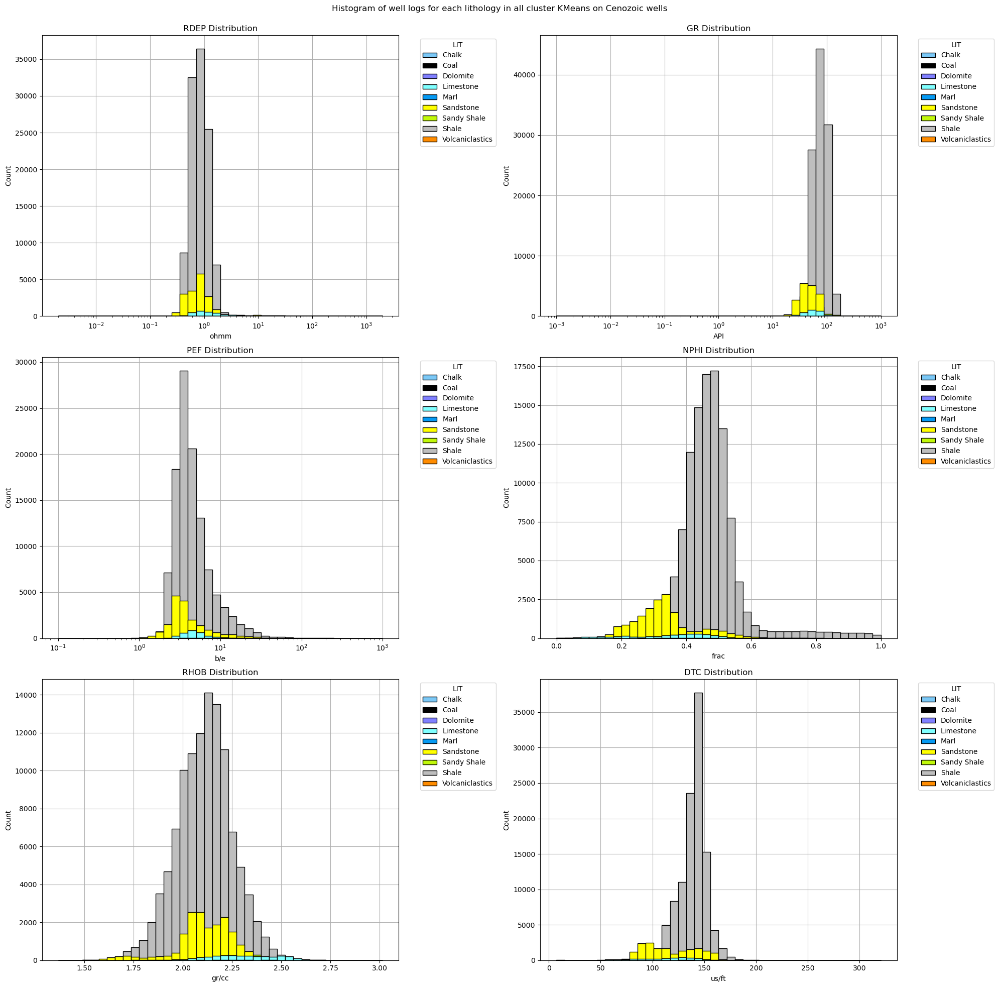

In [101]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each lithology in all cluster KMeans on Cenozoic wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
  
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')

    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwellloglithology_allclusters_layercount_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

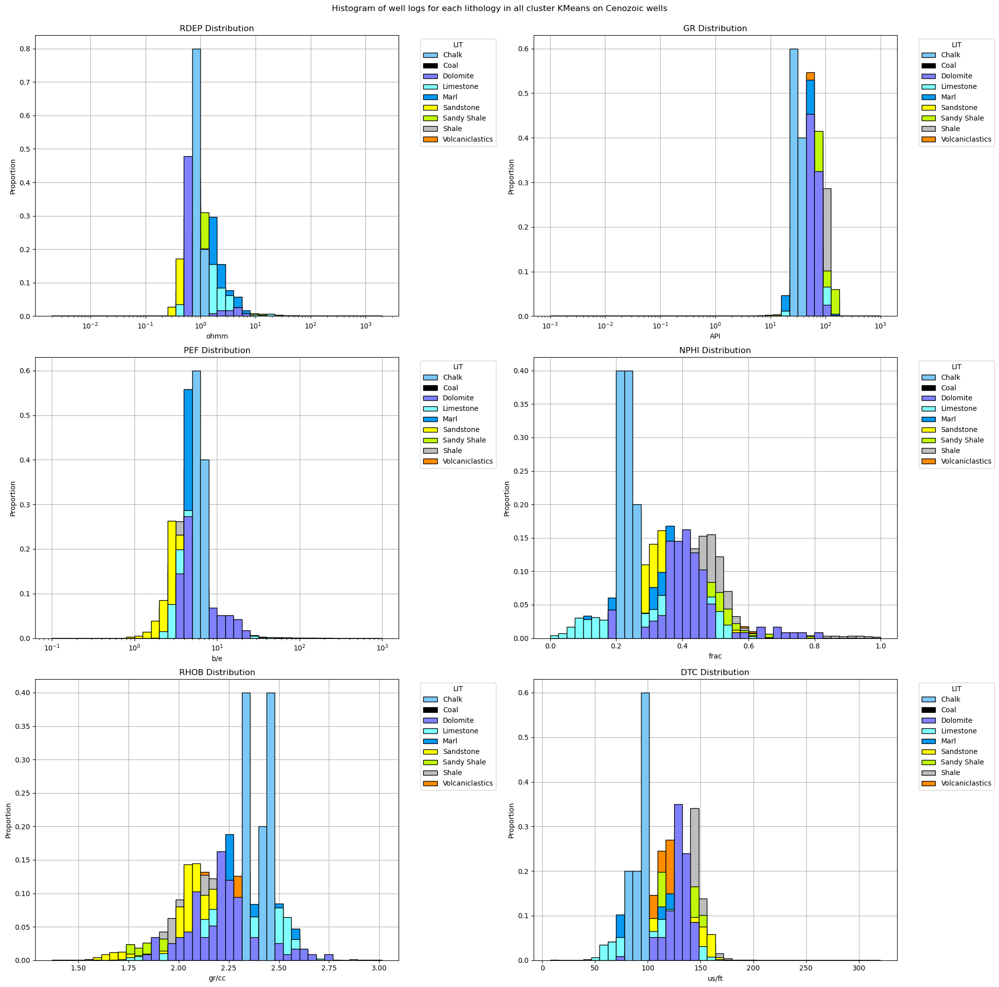

In [102]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each lithology in all cluster KMeans on Cenozoic wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
  
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')

    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwellloglithology_allclusters_layerproportion_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

##### On each cluster KMeans

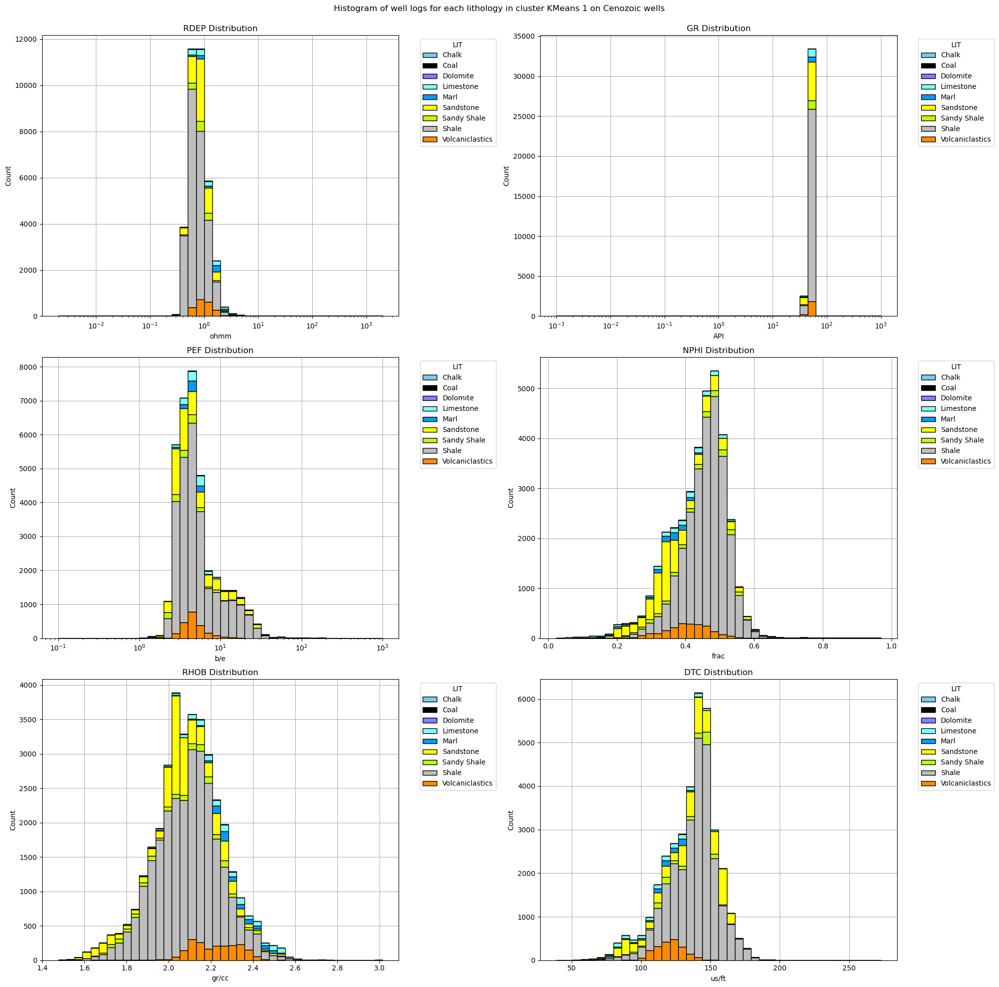

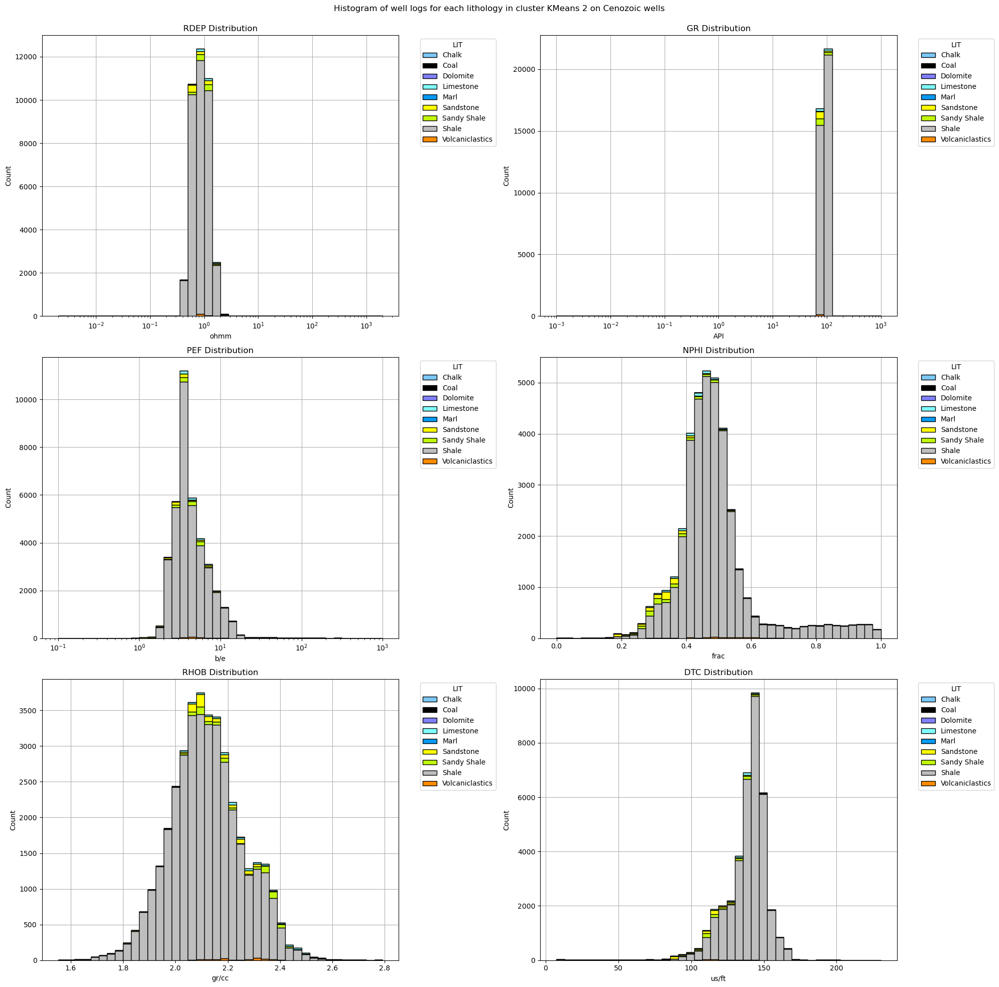

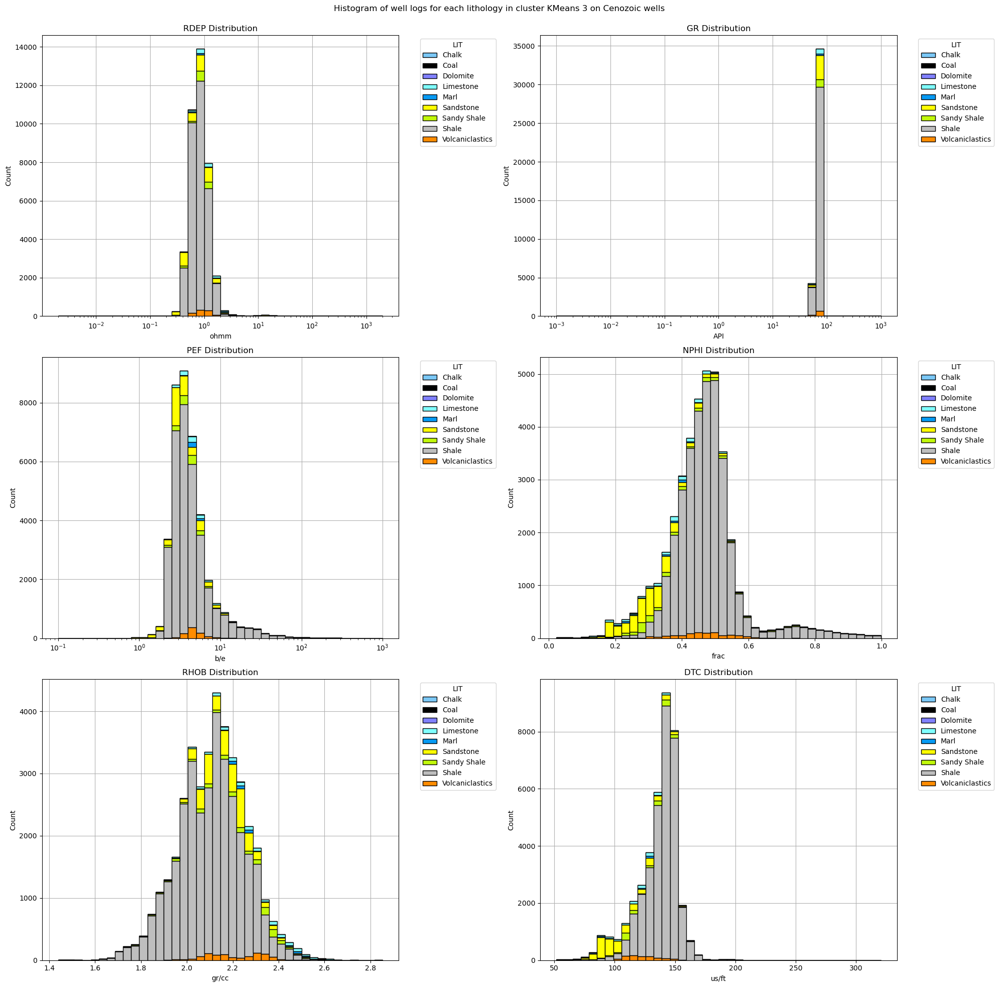

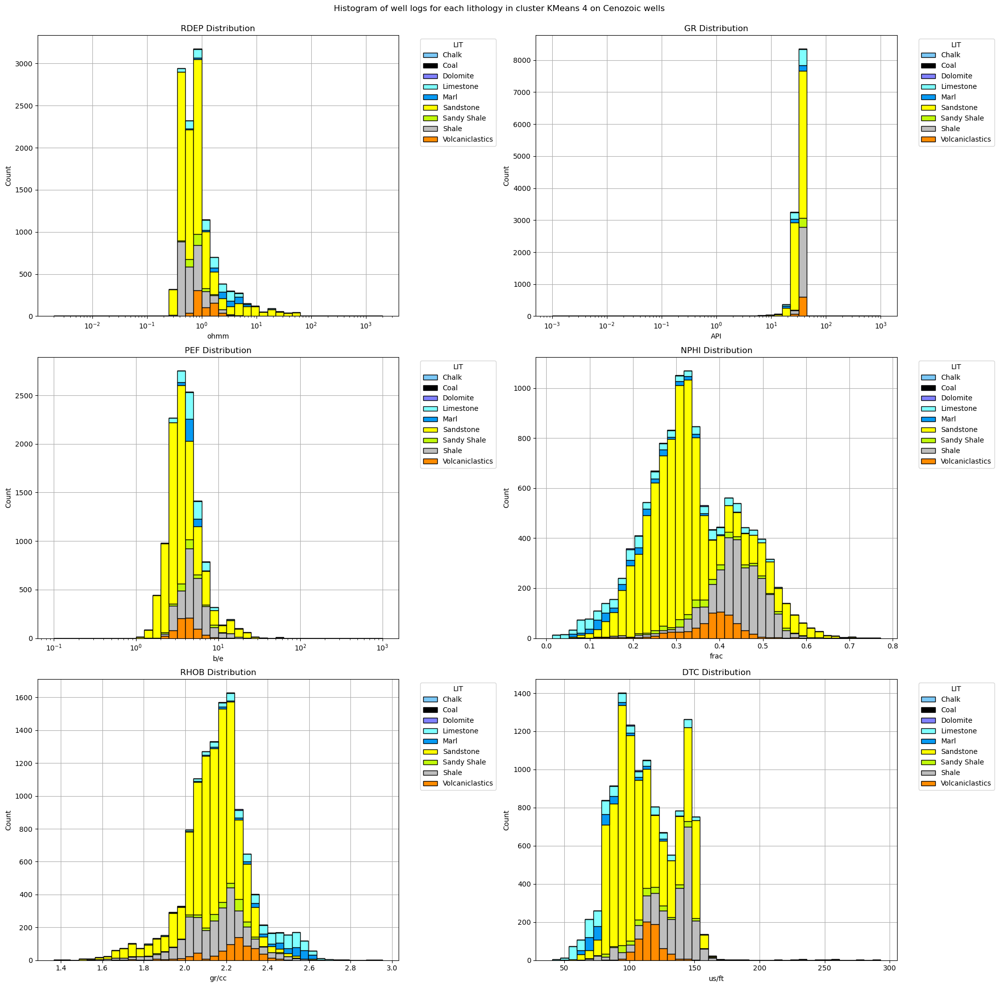

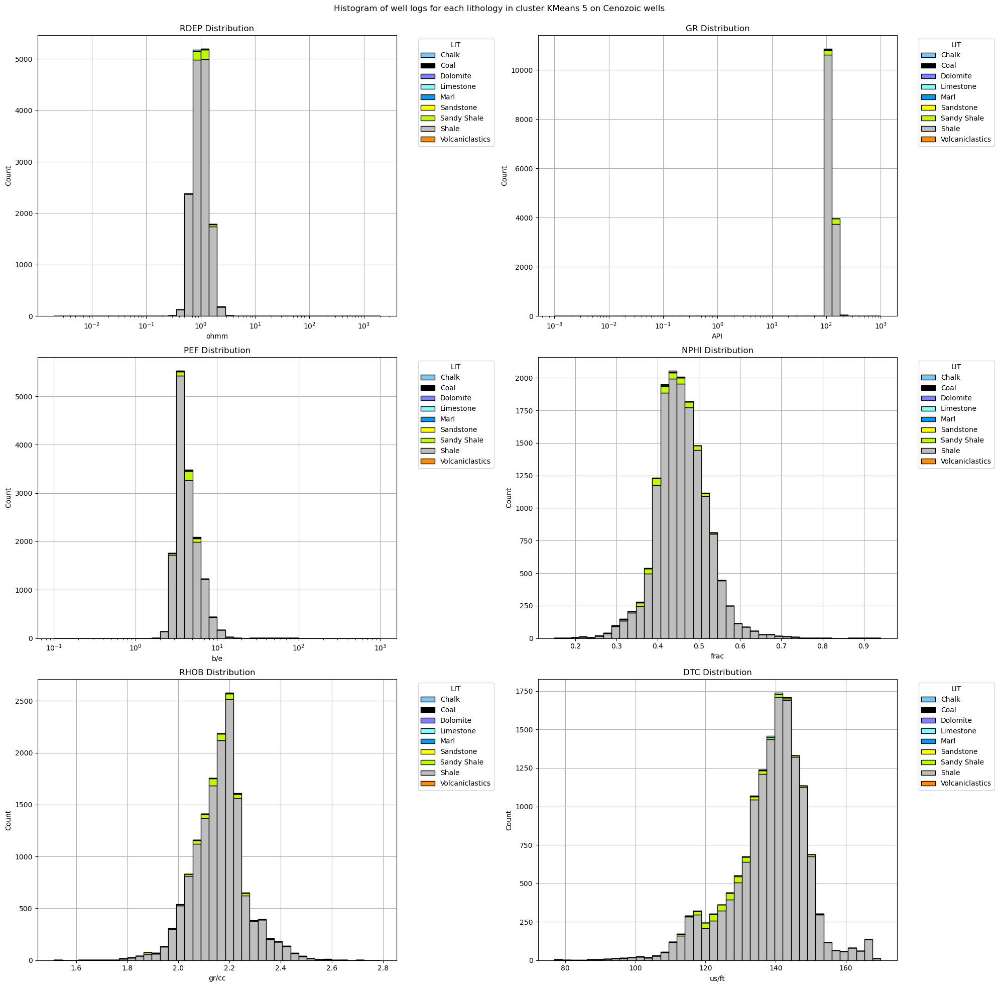

In [103]:
for i, kmeans in enumerate(keys_kmeans):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each lithology in cluster KMeans '+str(kmeans)+ ' on Cenozoic wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            #ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwellloglithology_kmeanscluster'+str(kmeans)+'_stackcount_cenozoicdata_old.png', bbox_inches='tight')
    plt.show()

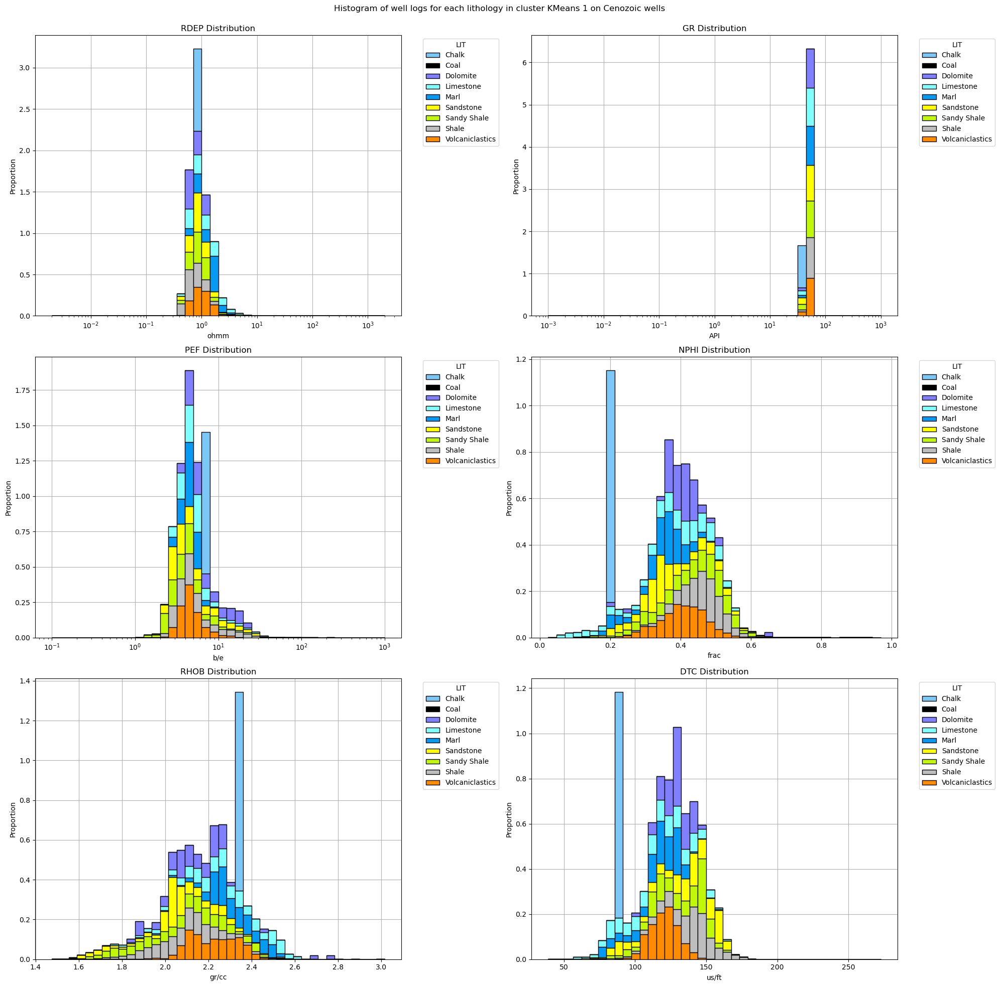

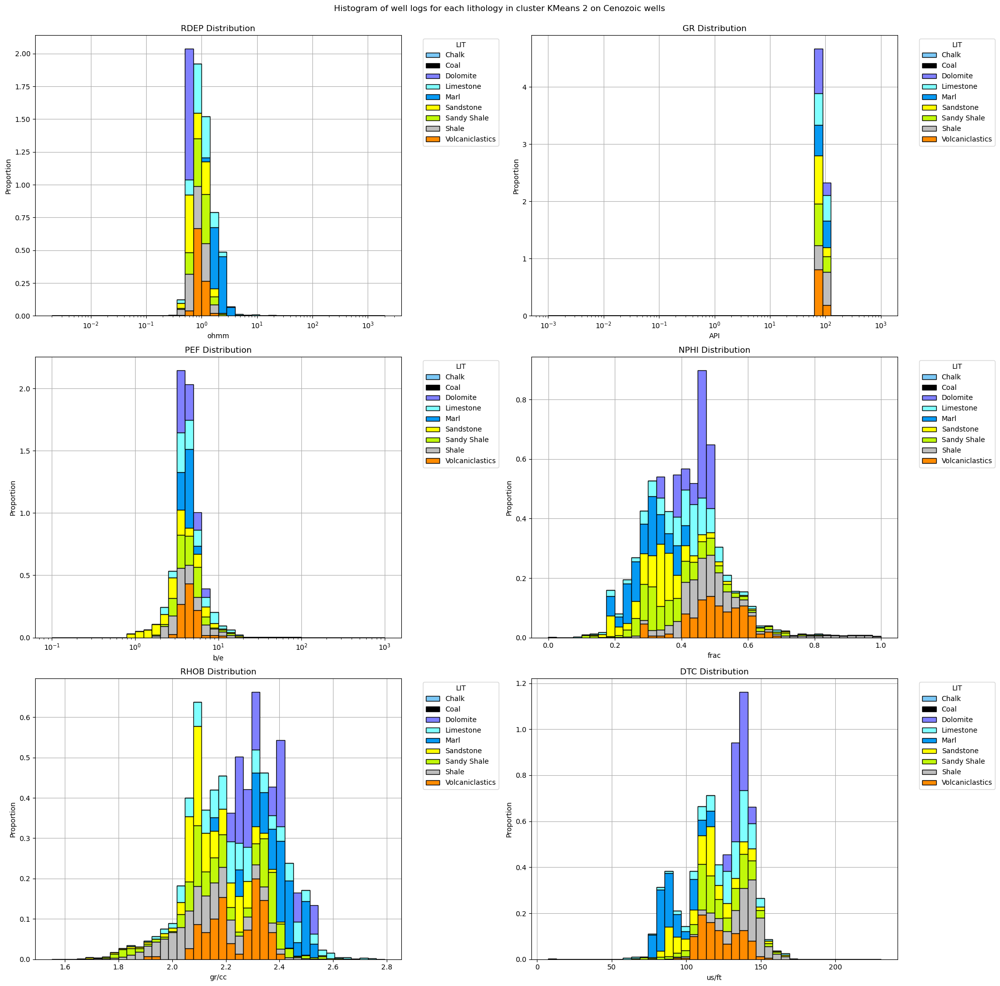

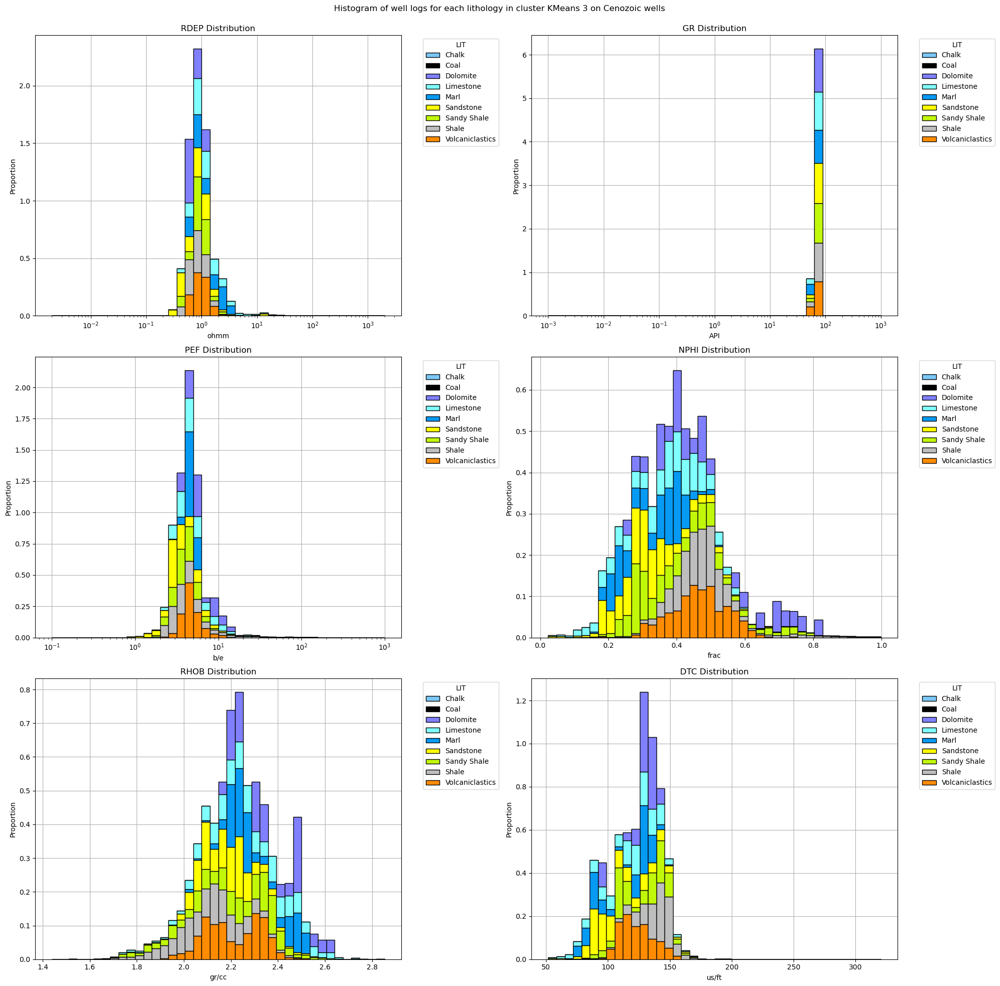

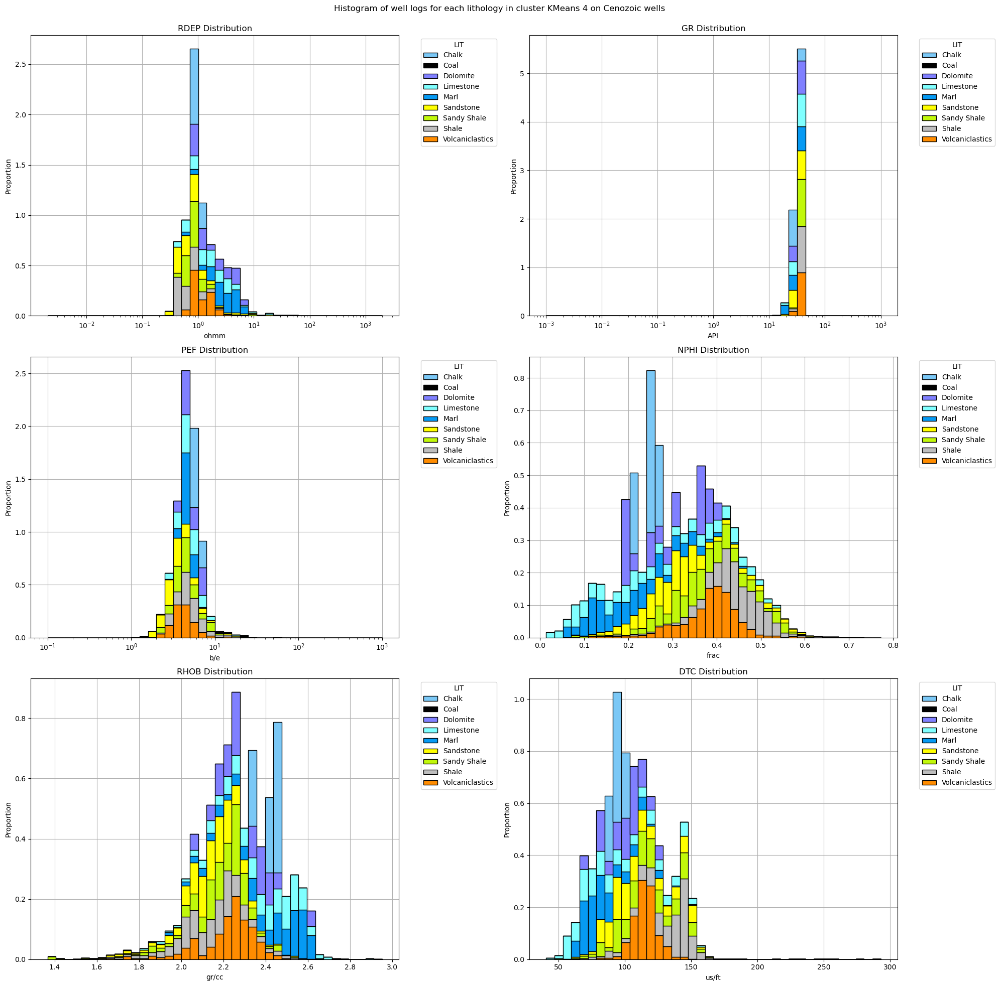

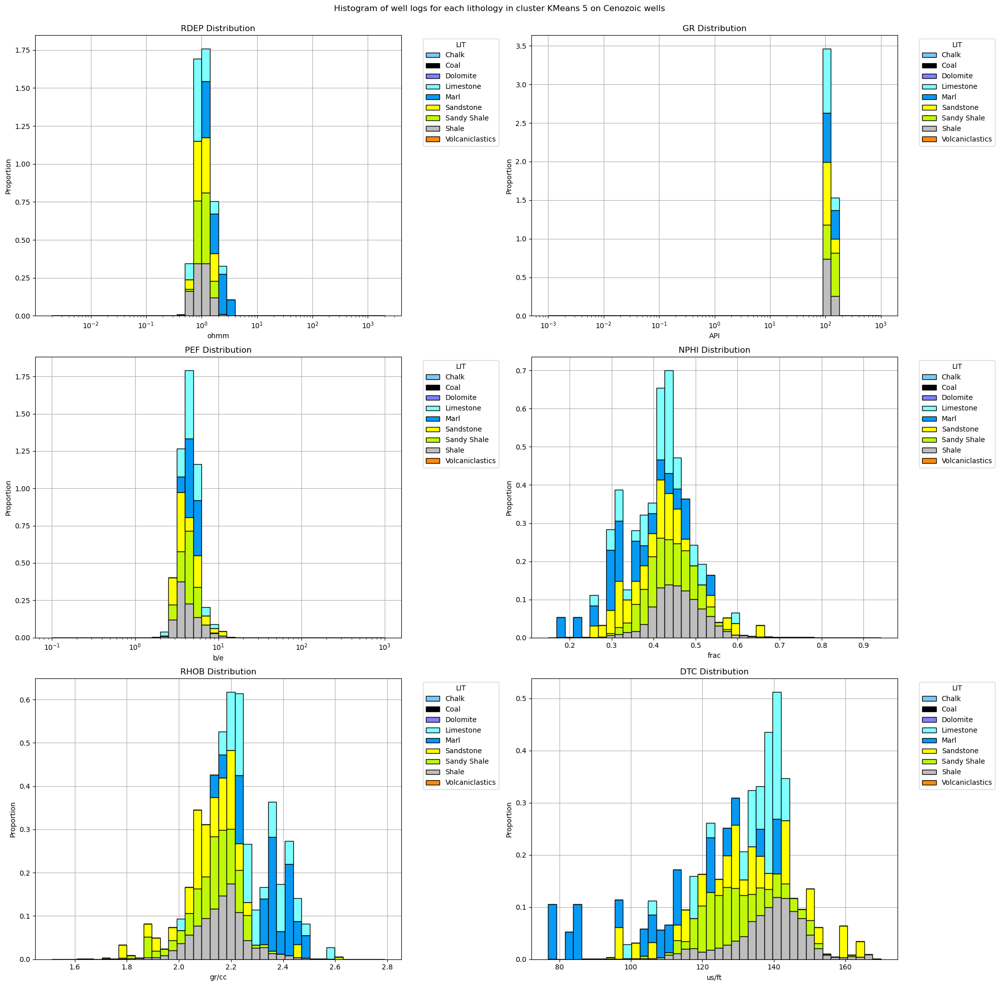

In [104]:
for i, kmeans in enumerate(keys_kmeans):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each lithology in cluster KMeans '+str(kmeans)+ ' on Cenozoic wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            #ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwellloglithology_kmeanscluster'+str(kmeans)+'stackproportion_cenozoicdata_old.png', bbox_inches='tight')
    plt.show()

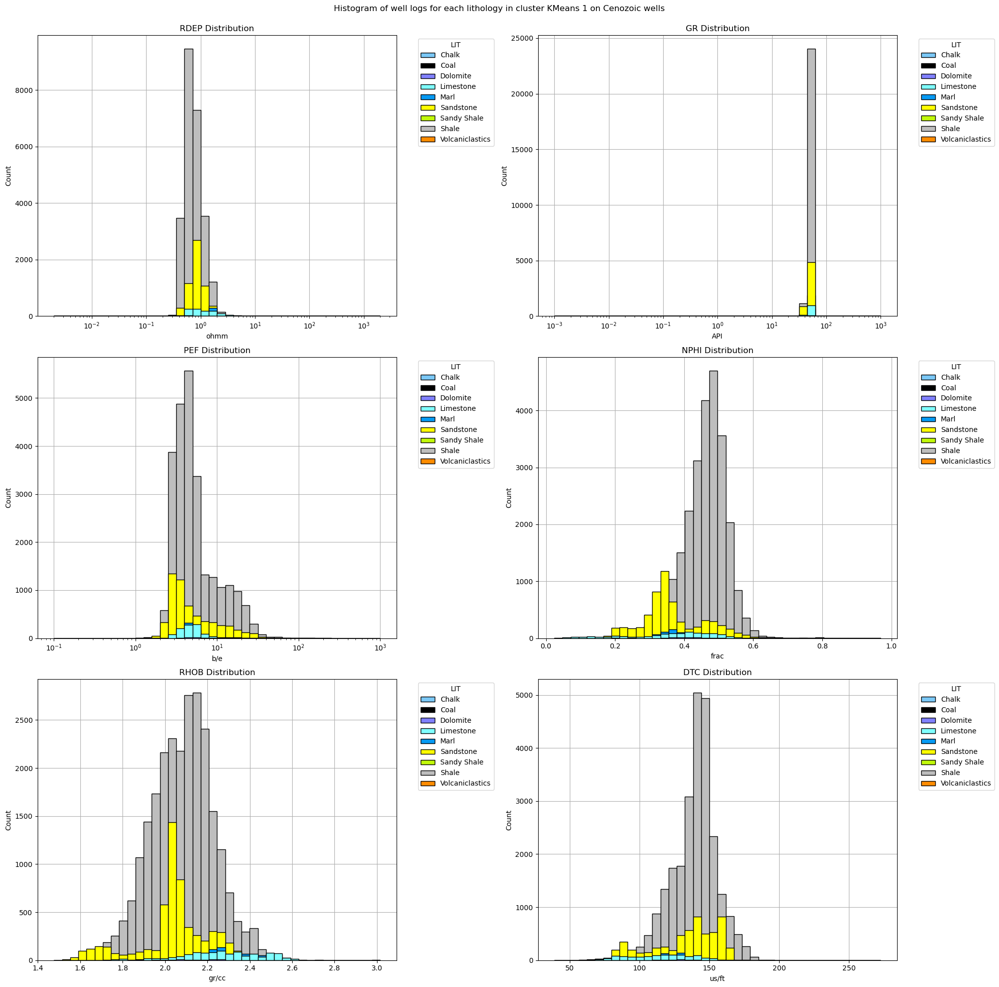

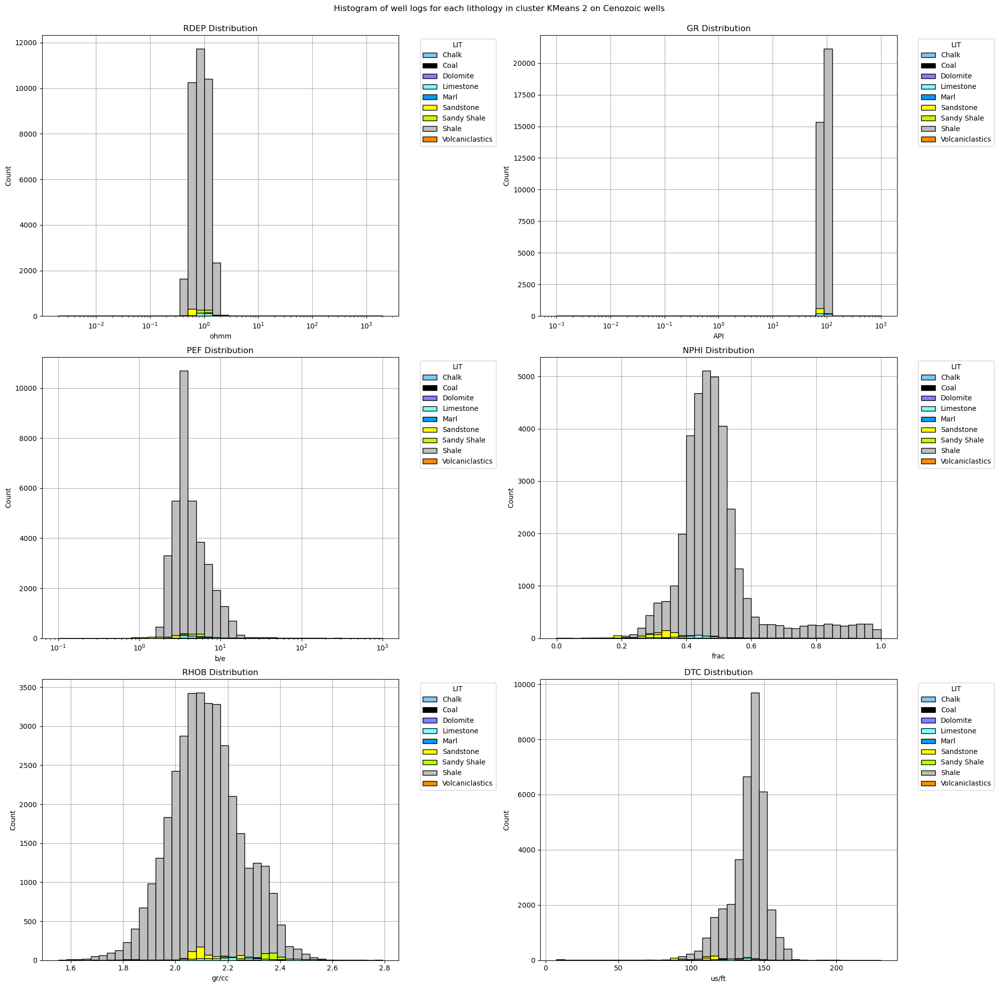

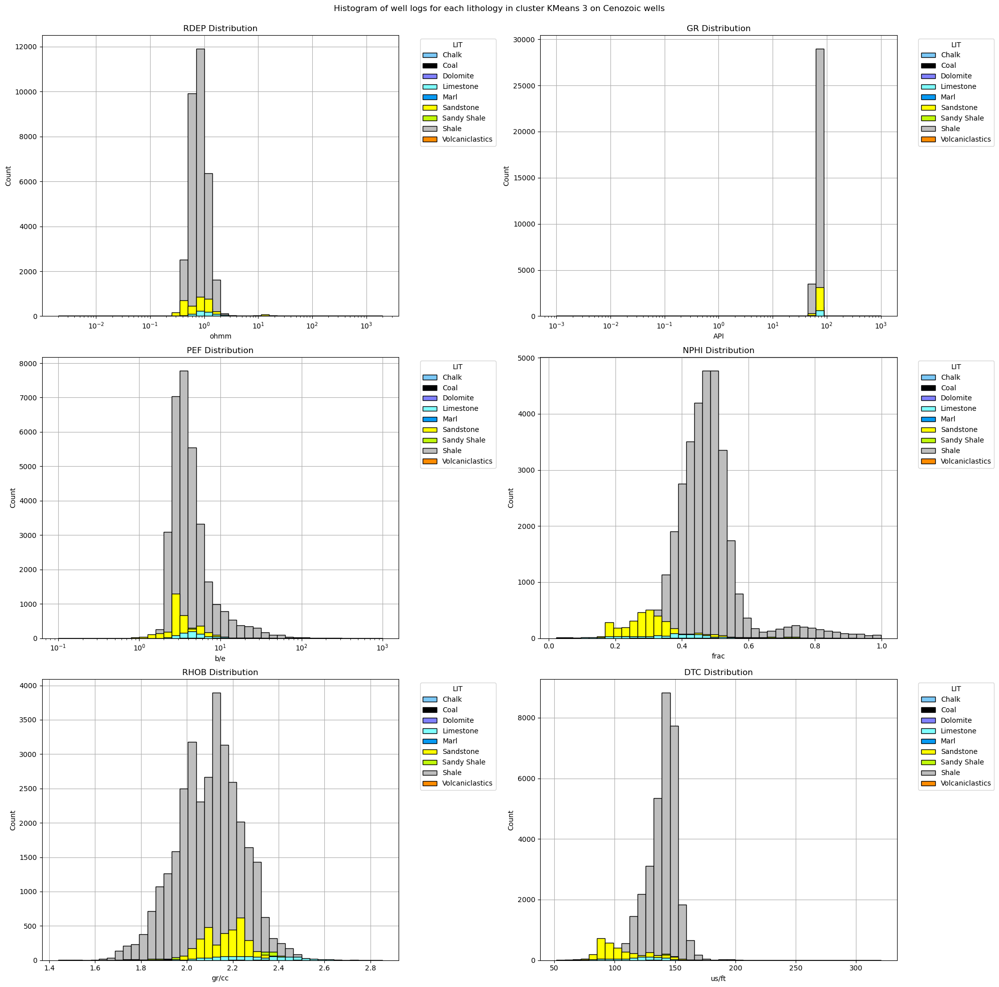

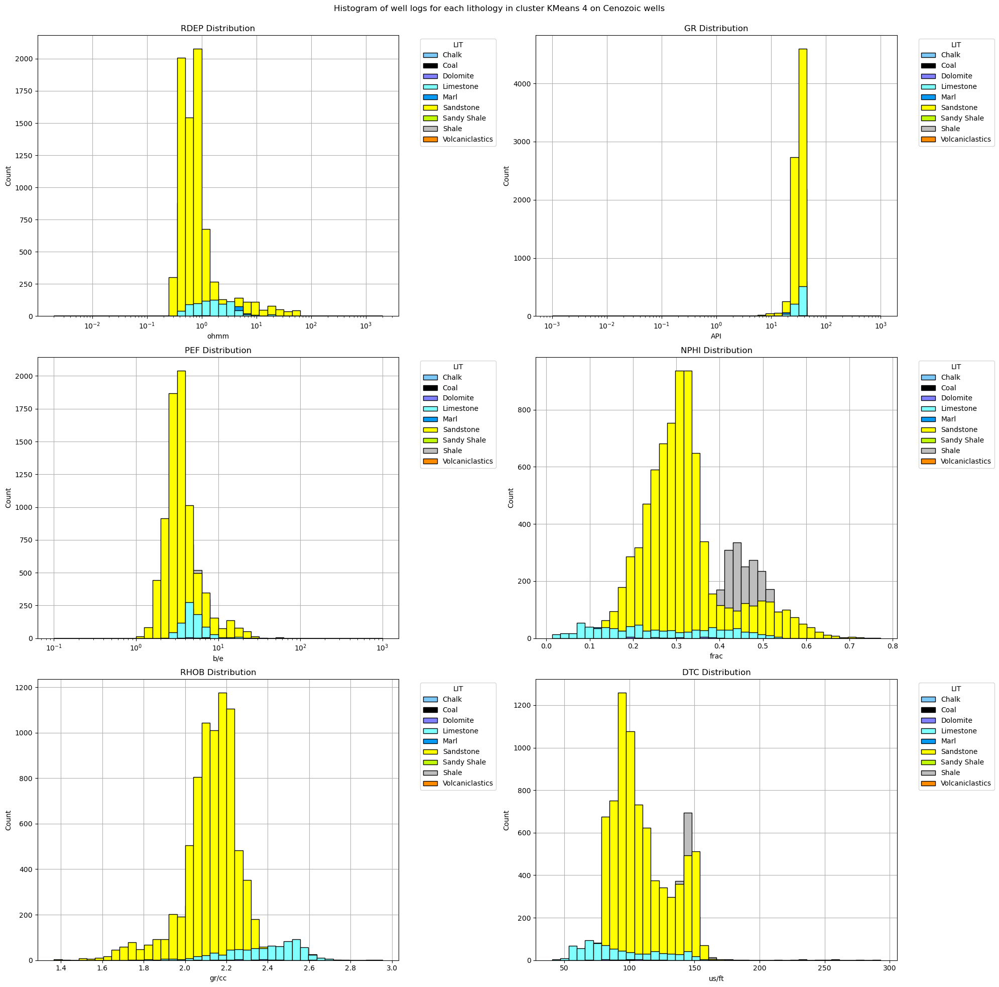

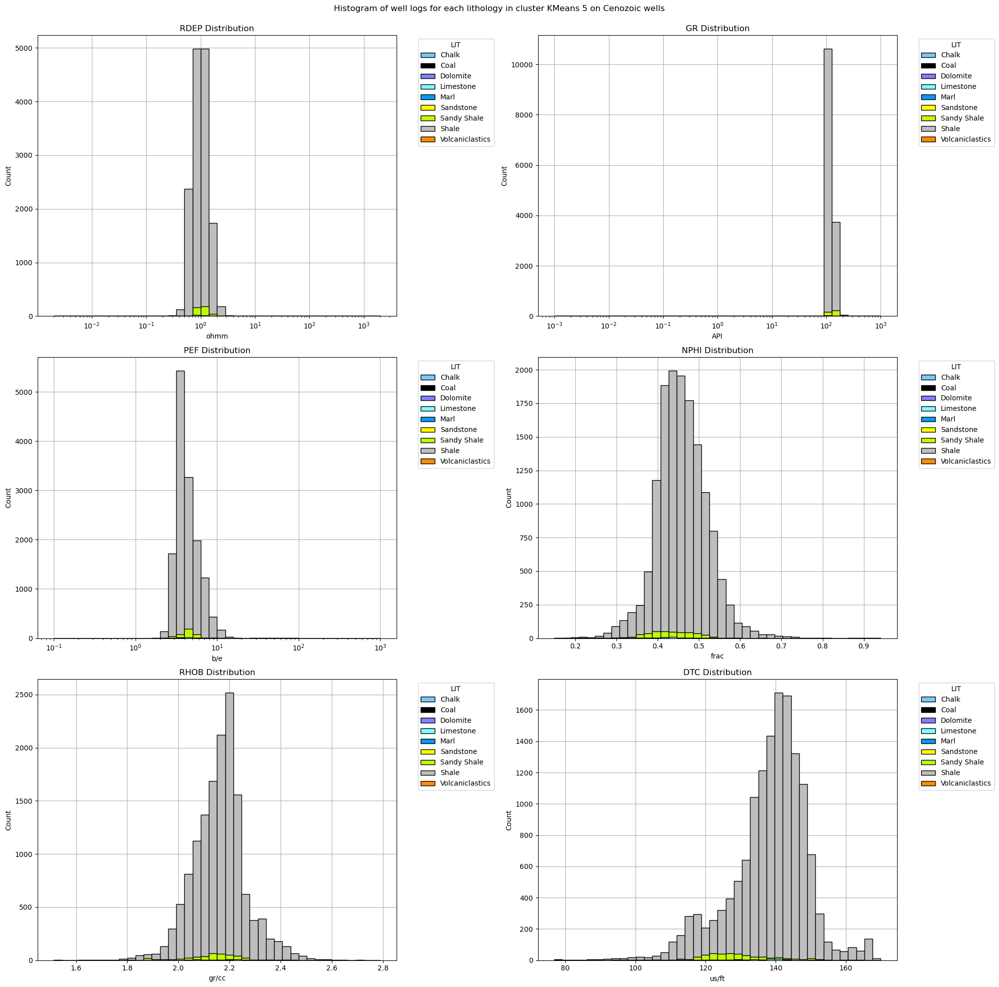

In [105]:
for i, kmeans in enumerate(keys_kmeans):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each lithology in cluster KMeans '+str(kmeans)+ ' on Cenozoic wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            #ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwellloglithology_kmeanscluster'+str(kmeans)+'_layercount_cenozoicdata_old.png', bbox_inches='tight')
    plt.show()

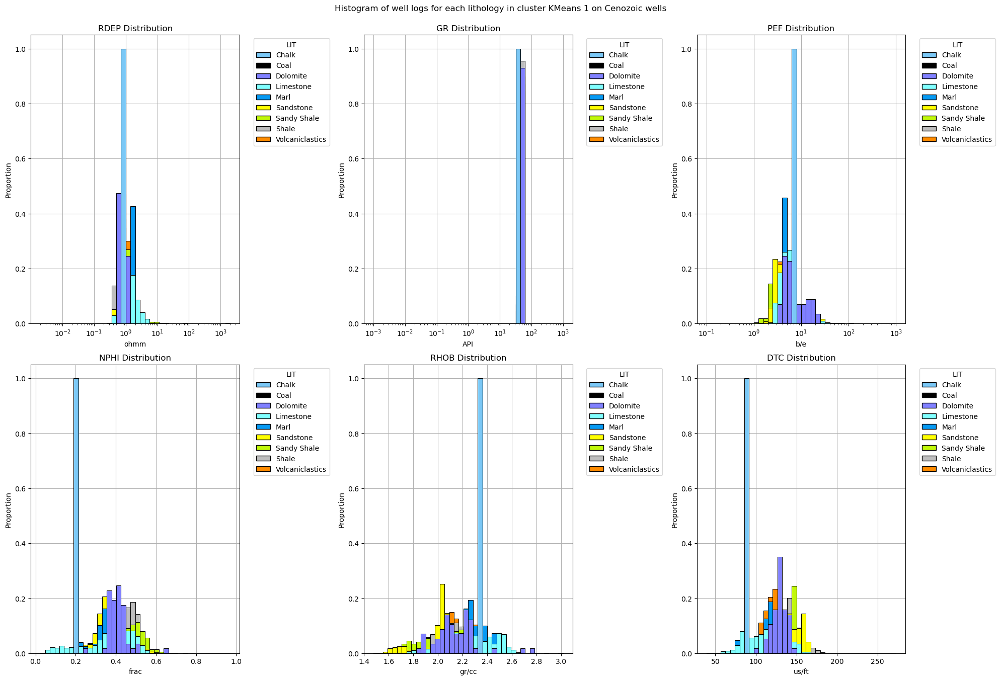

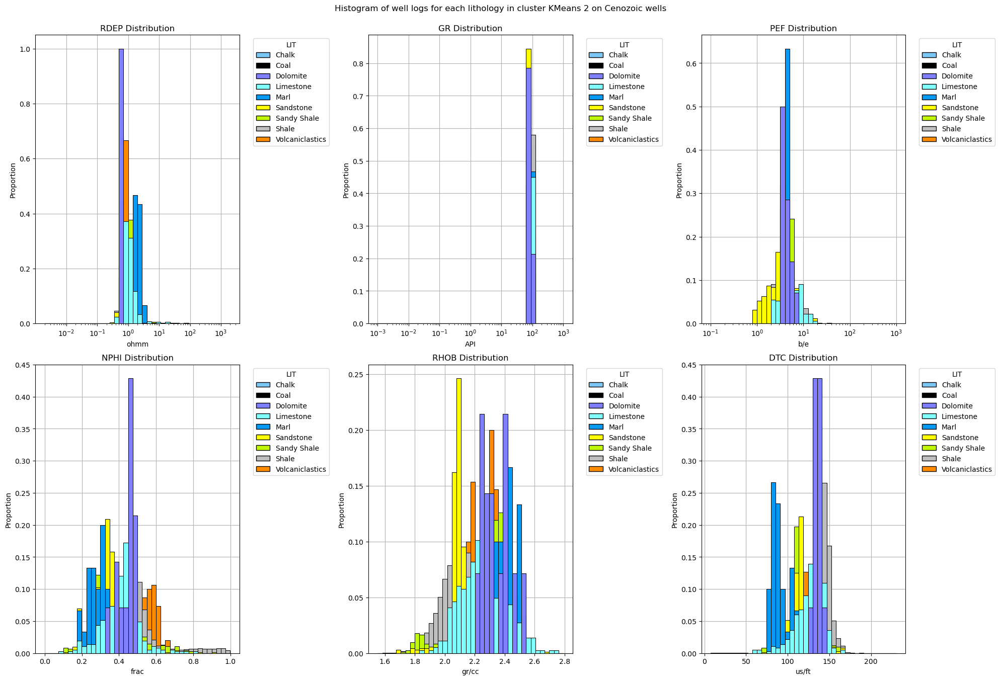

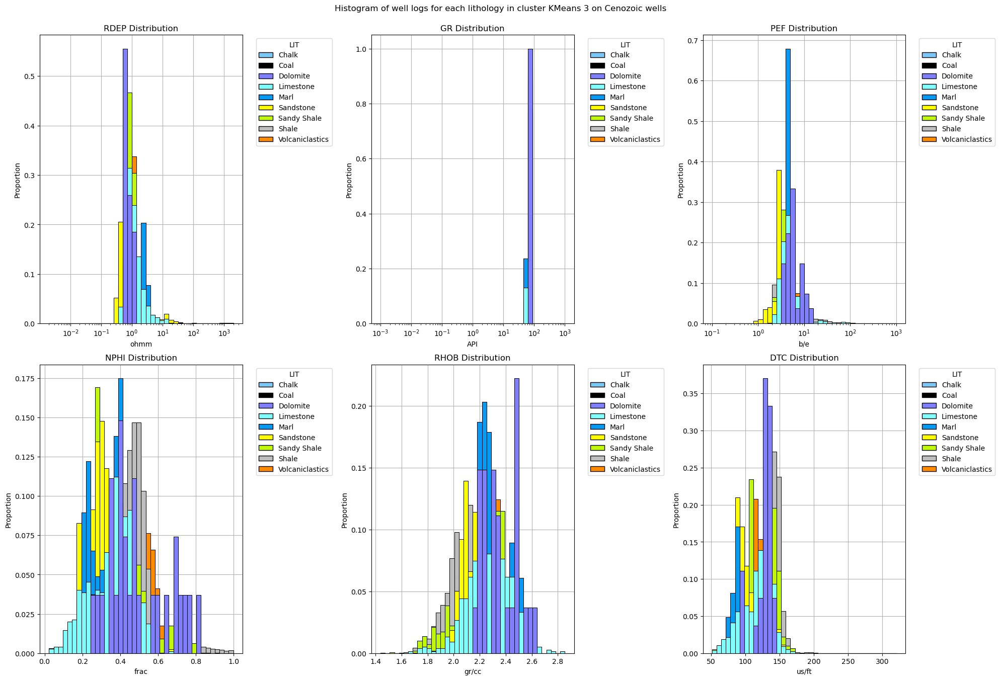

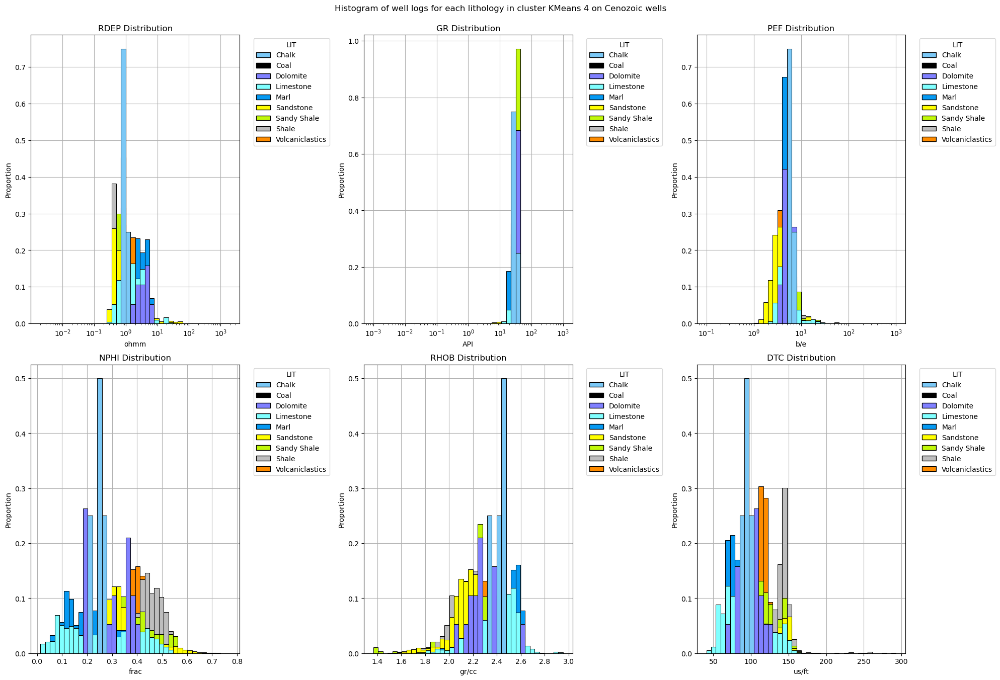

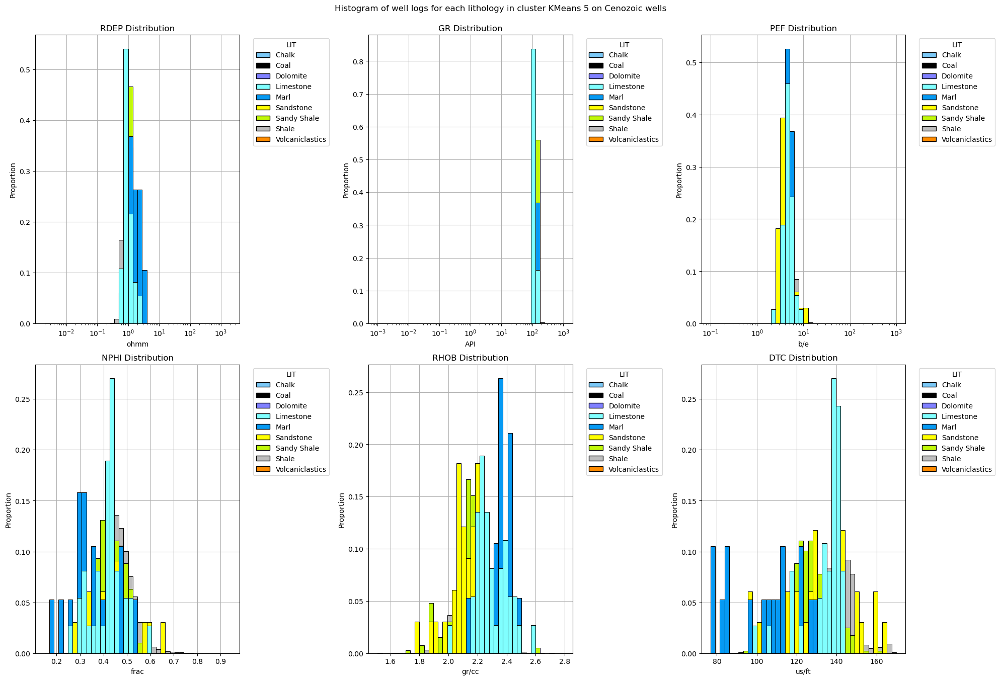

In [106]:
for i, kmeans in enumerate(keys_kmeans):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each lithology in cluster KMeans '+str(kmeans)+ ' on Cenozoic wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,3,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=litocolor, common_norm=False)
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            #ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=litocolor)
            ax=sns.histplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=litocolor, common_norm=False)
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwellloglithology_kmeanscluster'+str(kmeans)+'_layerproportion_cenozoicdata_old.png', bbox_inches='tight')
    plt.show()

#### Histogram for each well logs (lithology group, cluster hue)


##### On all lithology

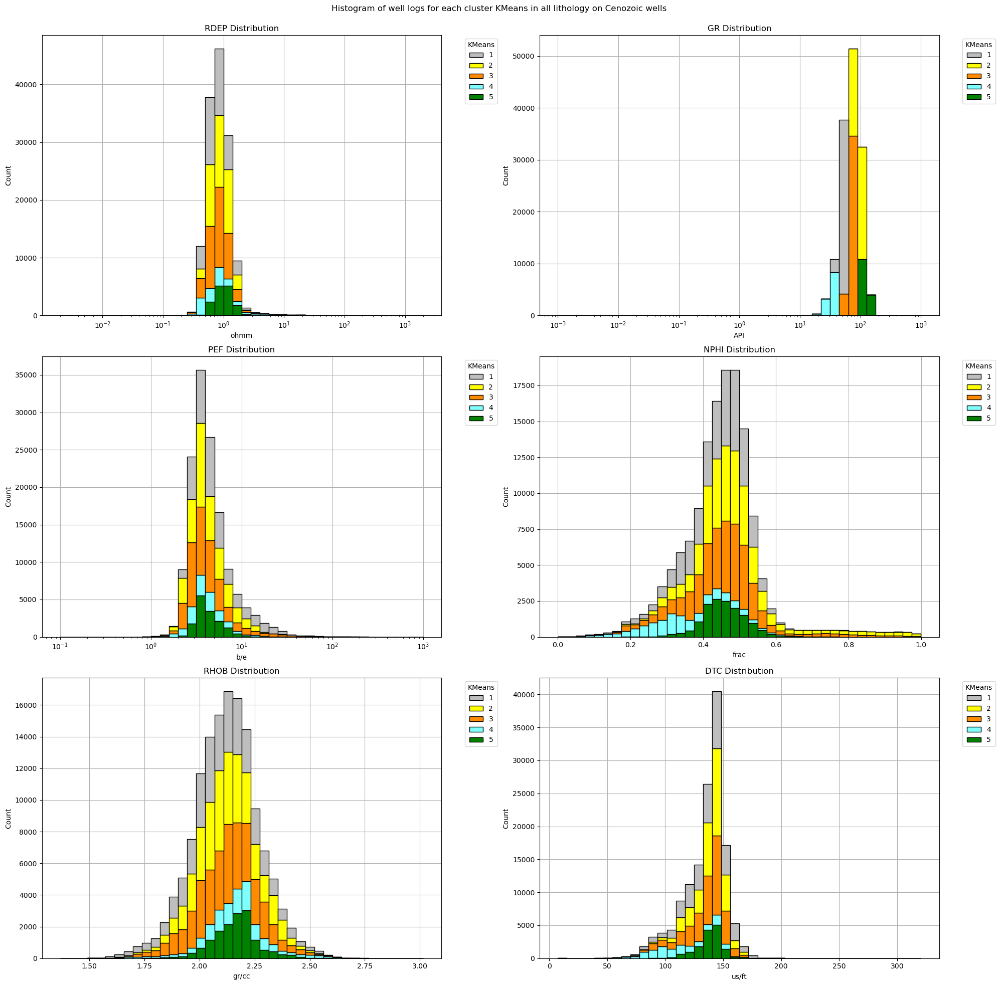

In [107]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each cluster KMeans in all lithology on Cenozoic wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwelllogkmeans_alllithology_stackcount_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

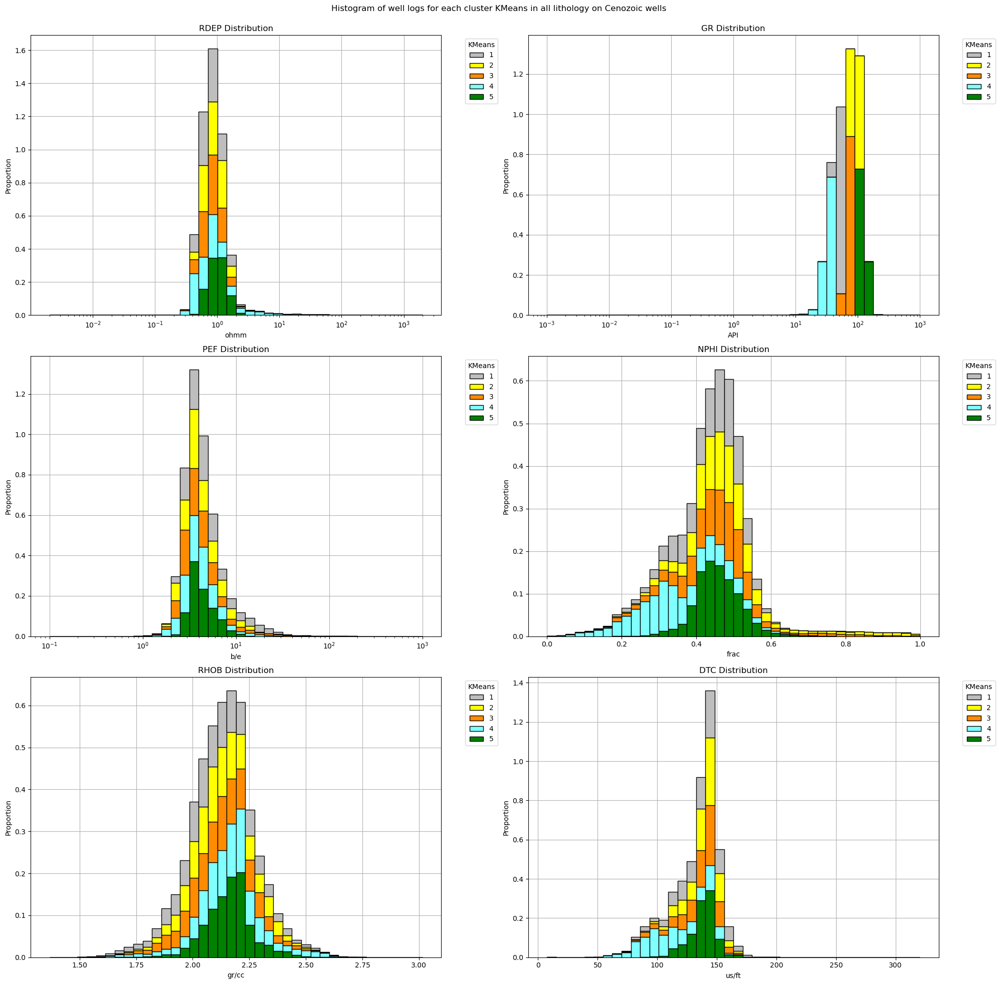

In [108]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each cluster KMeans in all lithology on Cenozoic wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwelllogkmeans_alllithology_stackproportion_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

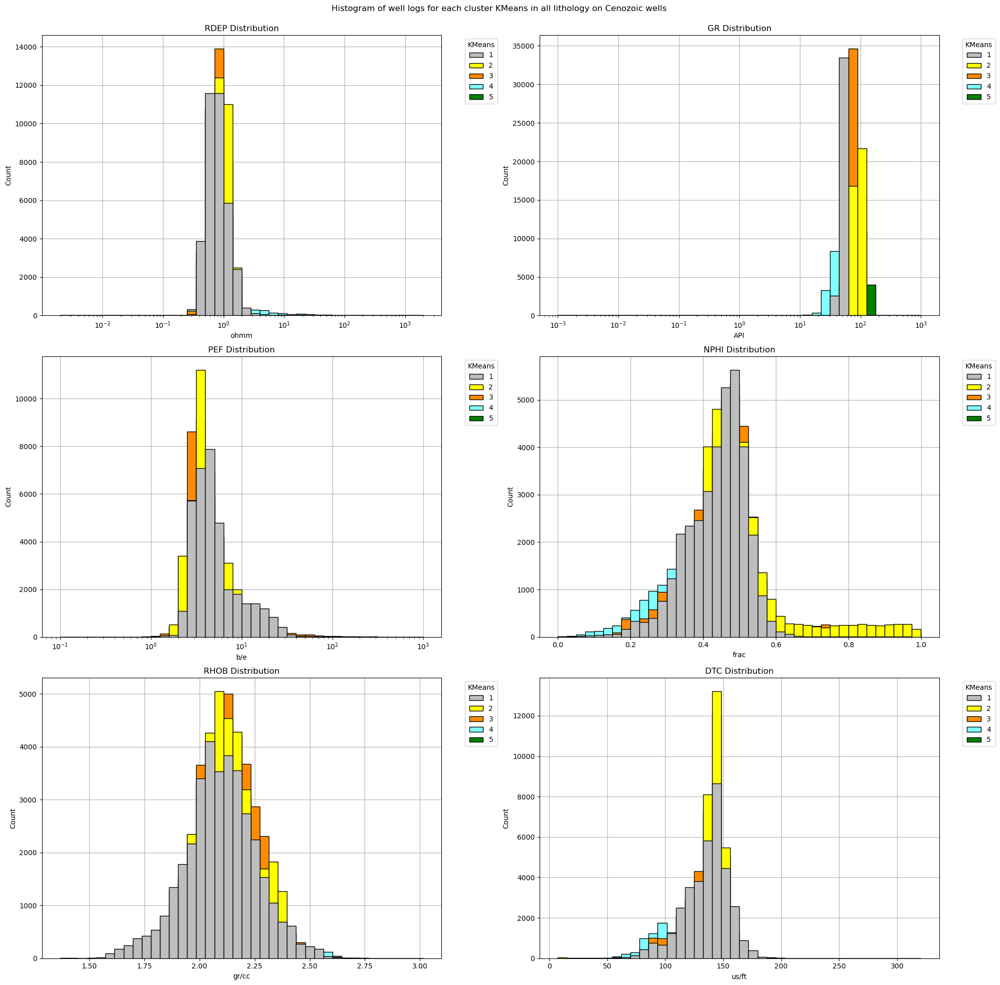

In [109]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each cluster KMeans in all lithology on Cenozoic wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwelllogkmeans_alllithology_layercount_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

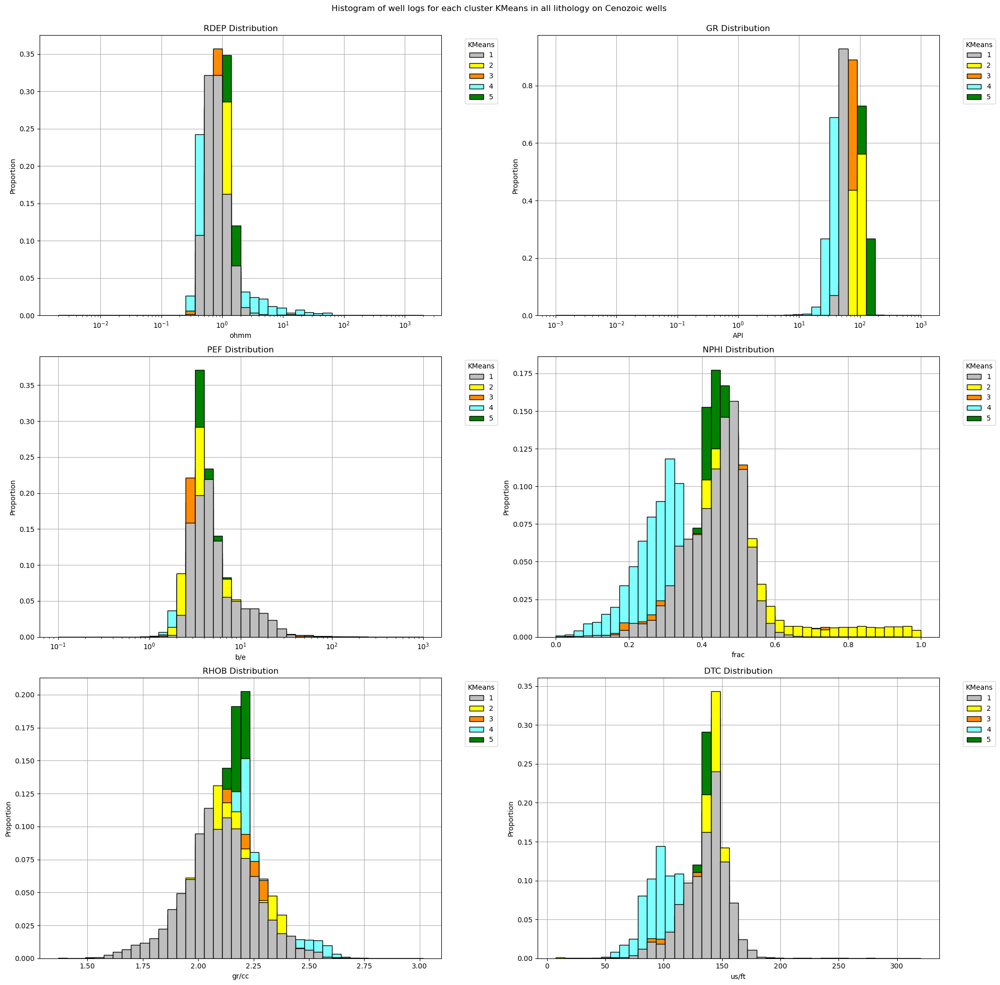

In [110]:
fig = plt.figure(figsize=(20,20))
fig.suptitle('Histogram of well logs for each cluster KMeans in all lithology on Cenozoic wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
        
    if i==0:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
    elif i==1:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('API')
    elif i==2:
        #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
    elif i==3:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
    elif i==4:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
    #elif i==5:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        #ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
    else:
        #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
        ax=sns.histplot(data=well_clustered, x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')

    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)
#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('histogramwelllogkmeans_alllithology_layerproportion_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

##### On each lithology

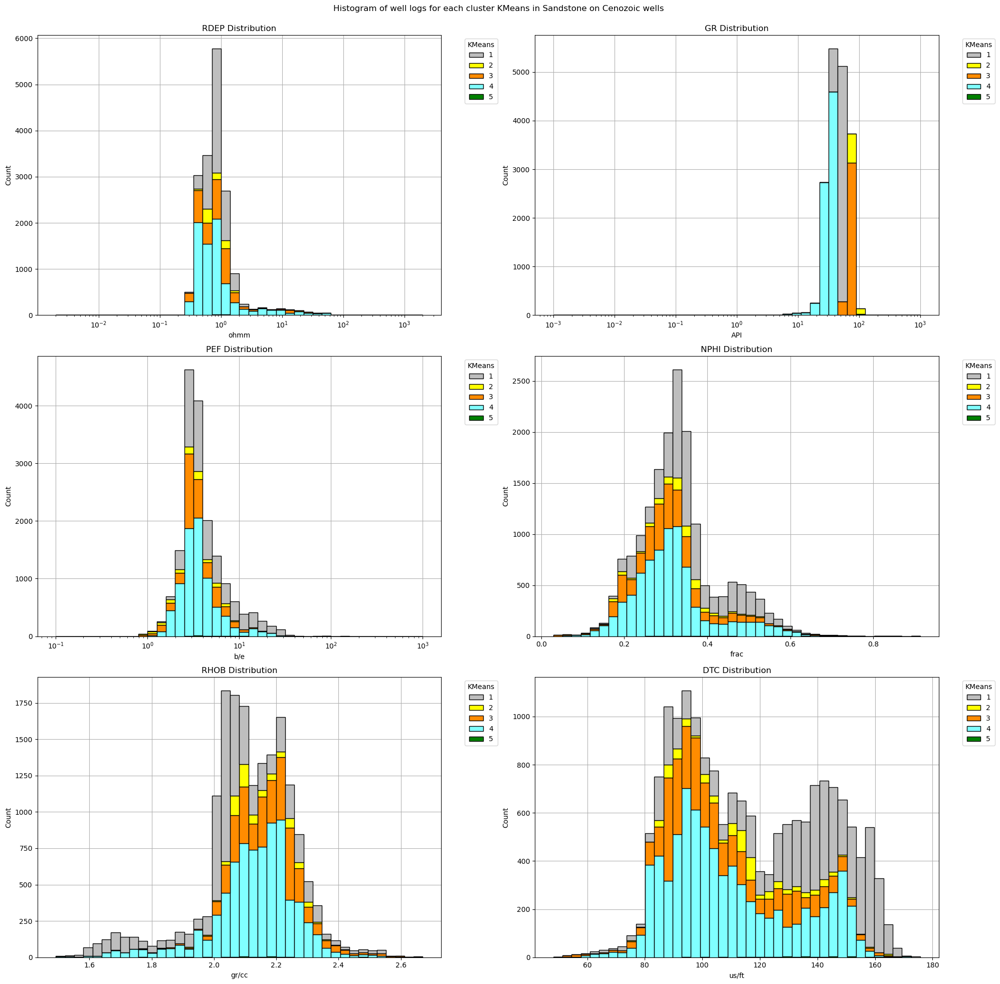

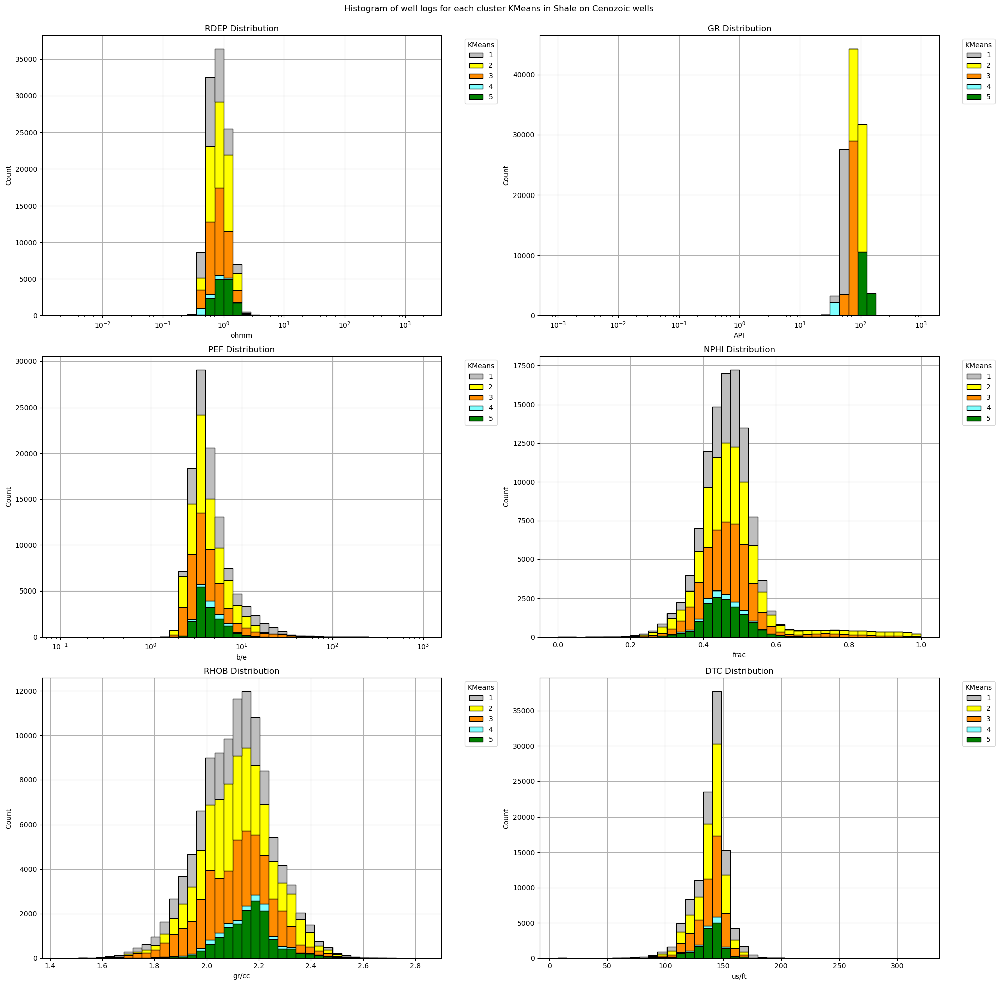

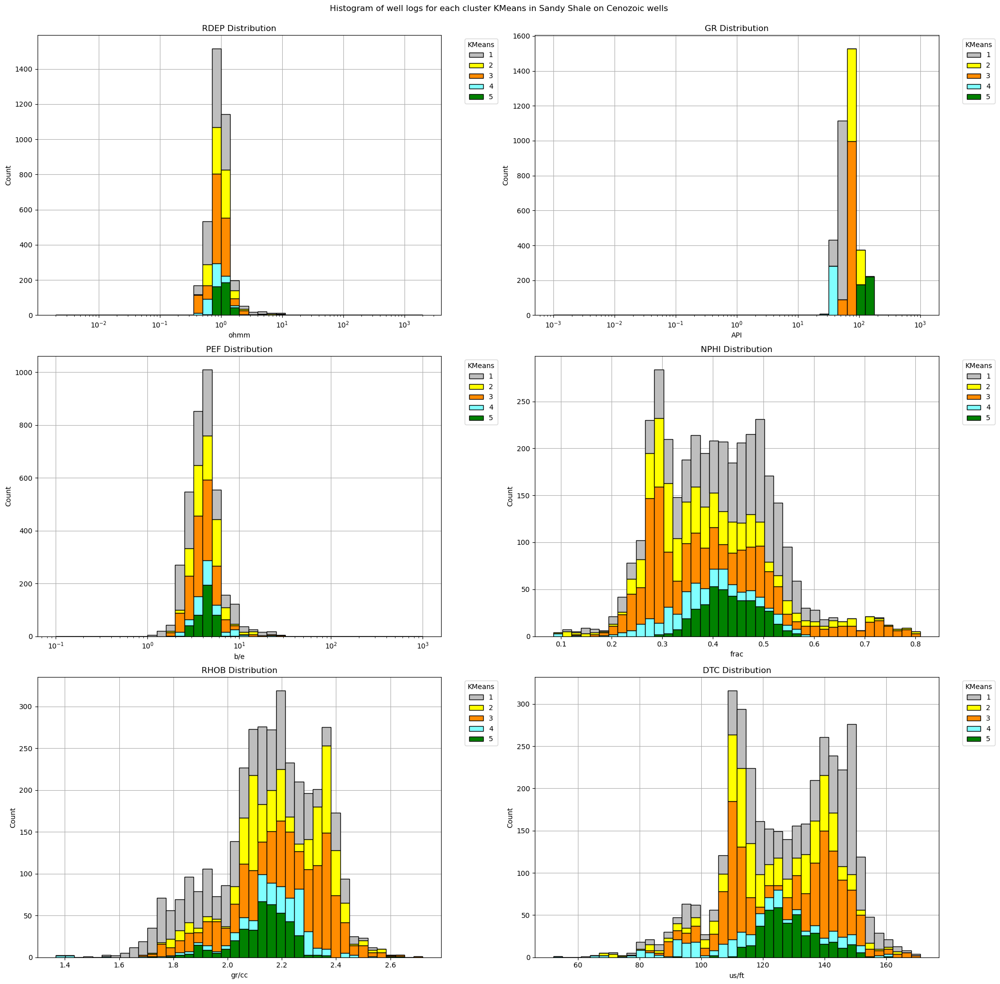

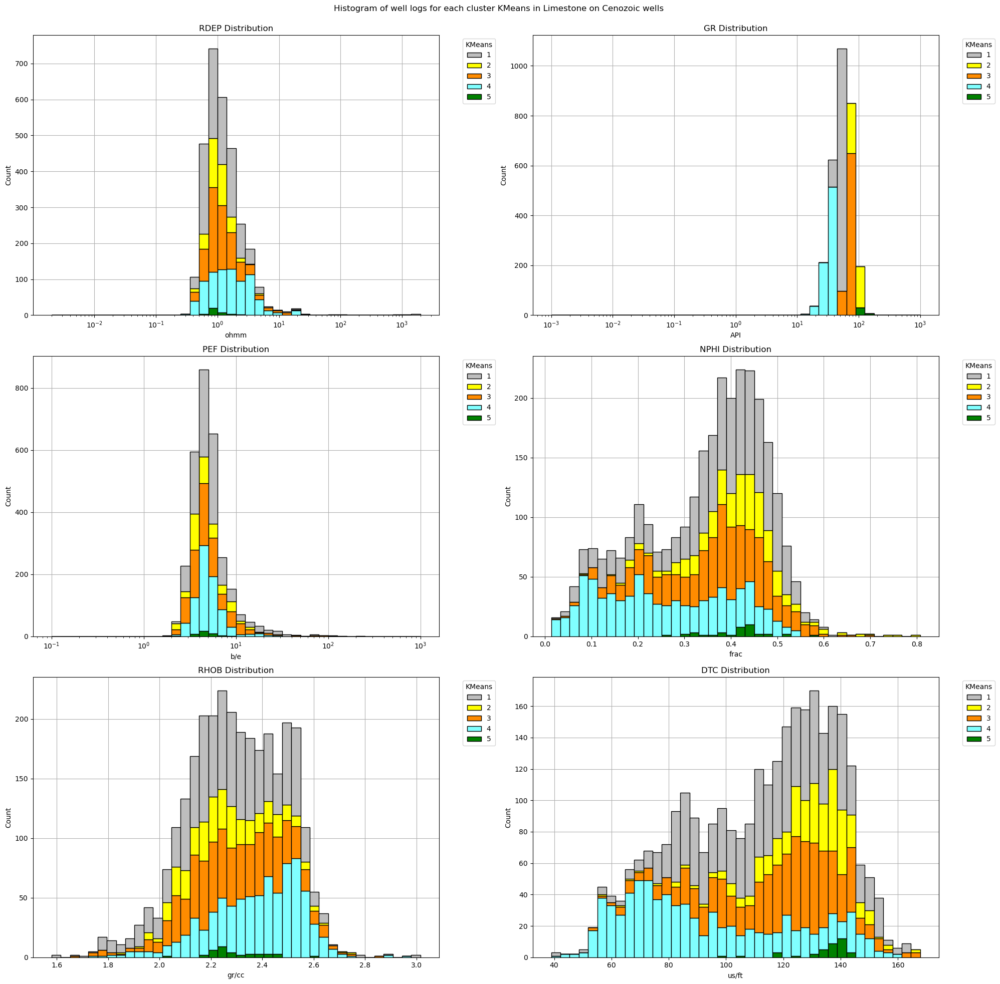

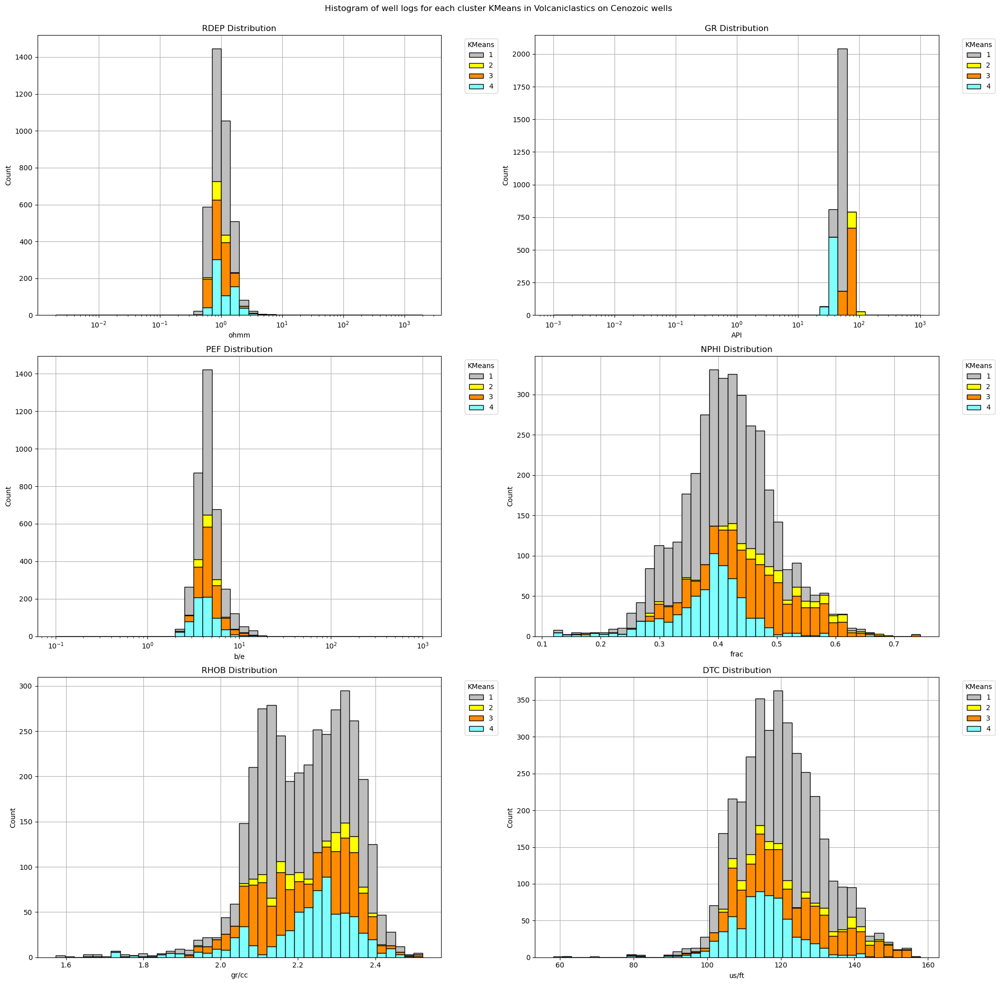

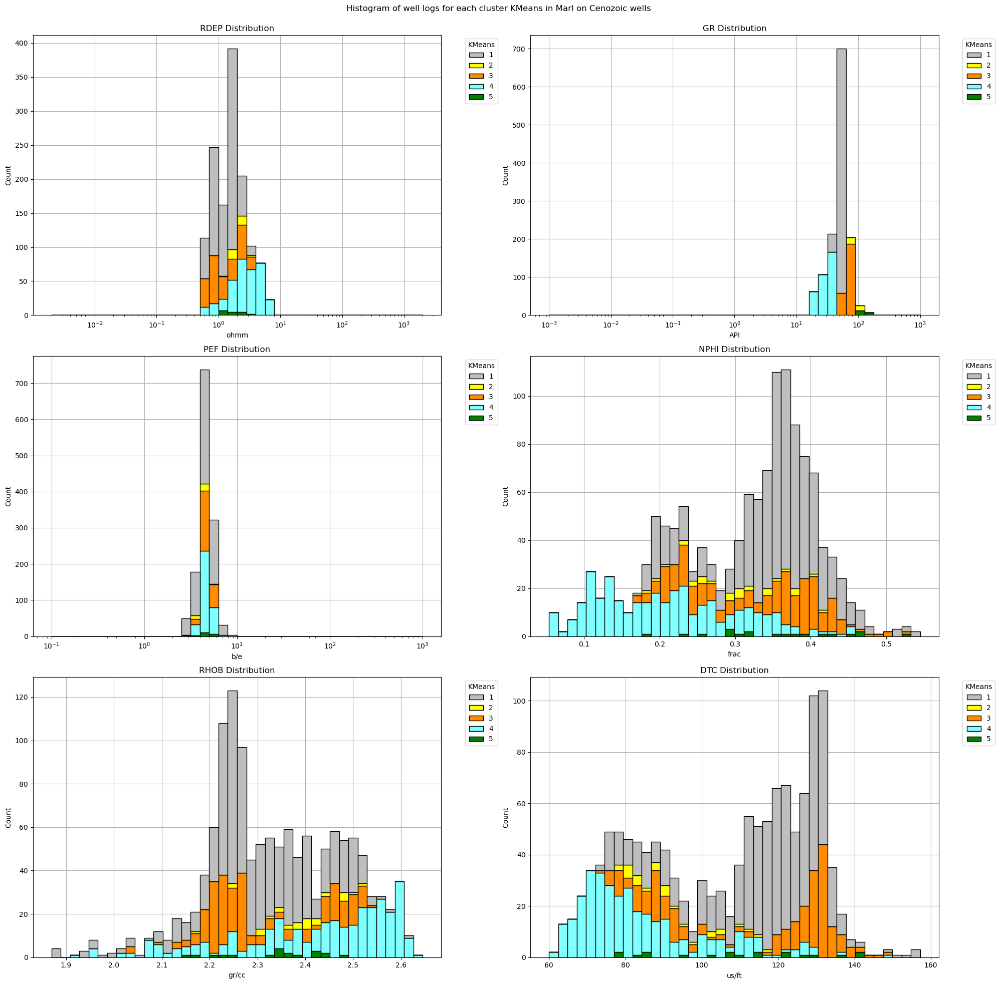

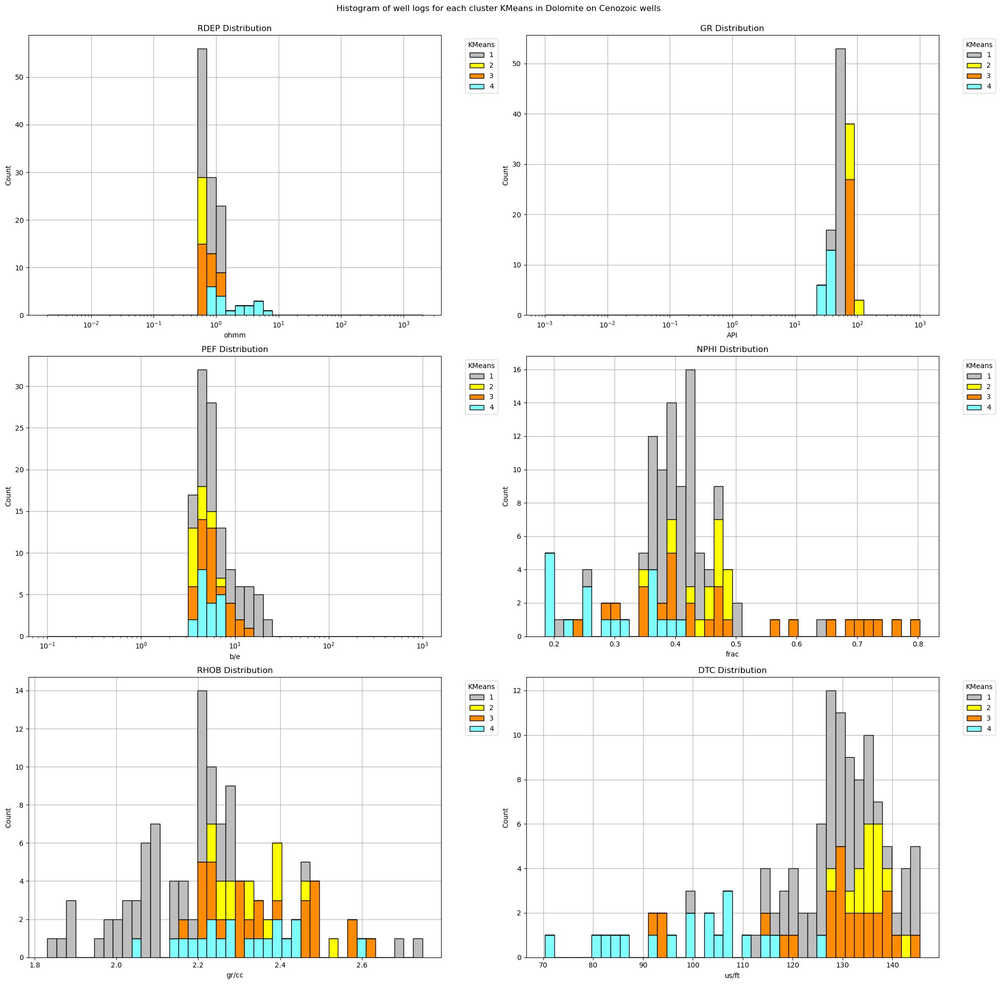

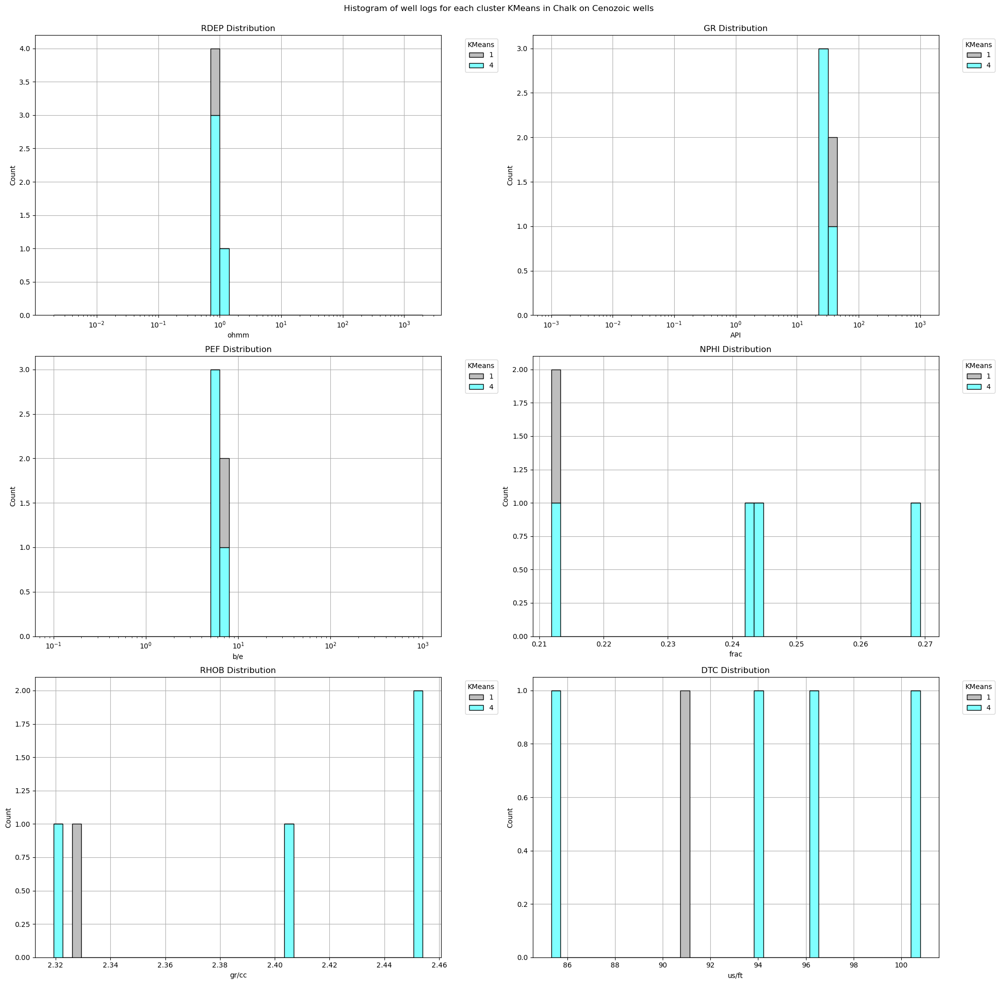

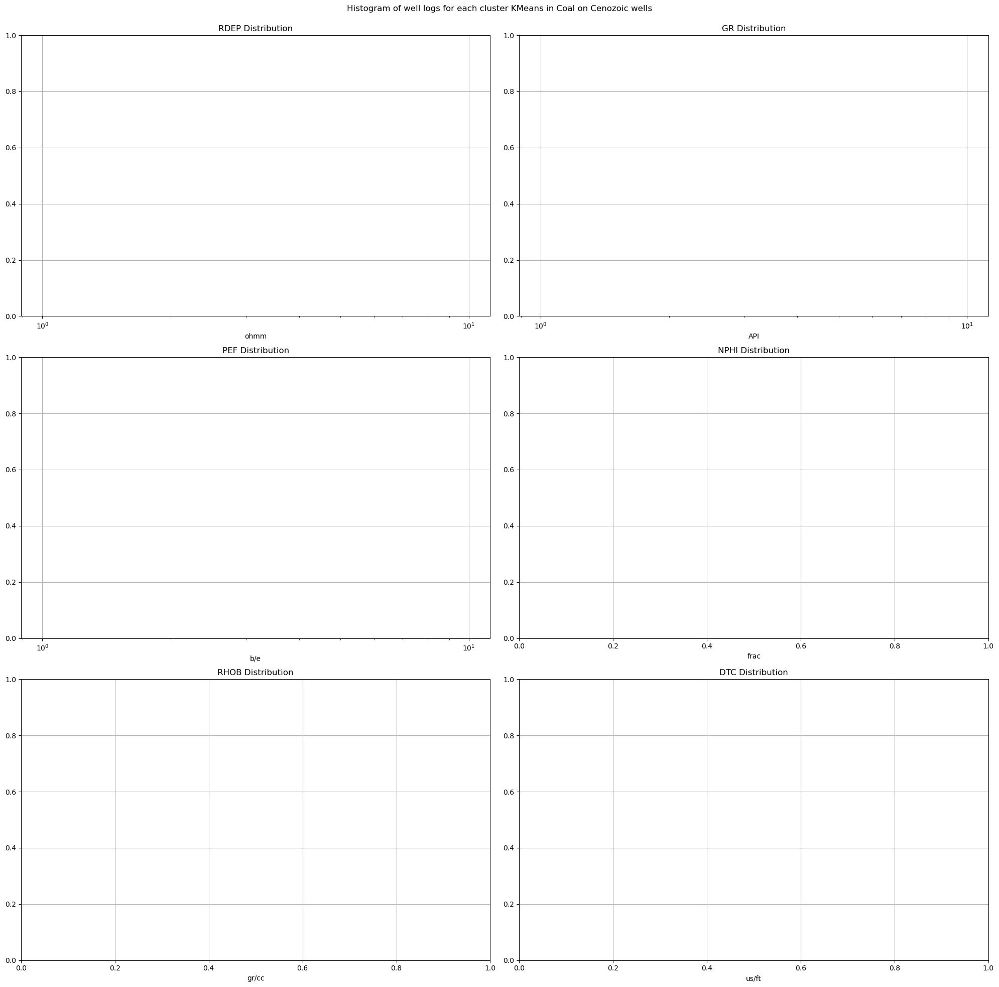

In [111]:
for i, litho in enumerate(keys_lithology):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each cluster KMeans in '+str(litho)+ ' on Cenozoic wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                #pass
            #else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                #ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwelllogkmeans_'+str(litho)+'_stackcount_cenozoicdata_old.png', bbox_inches='tight')
    plt.show()

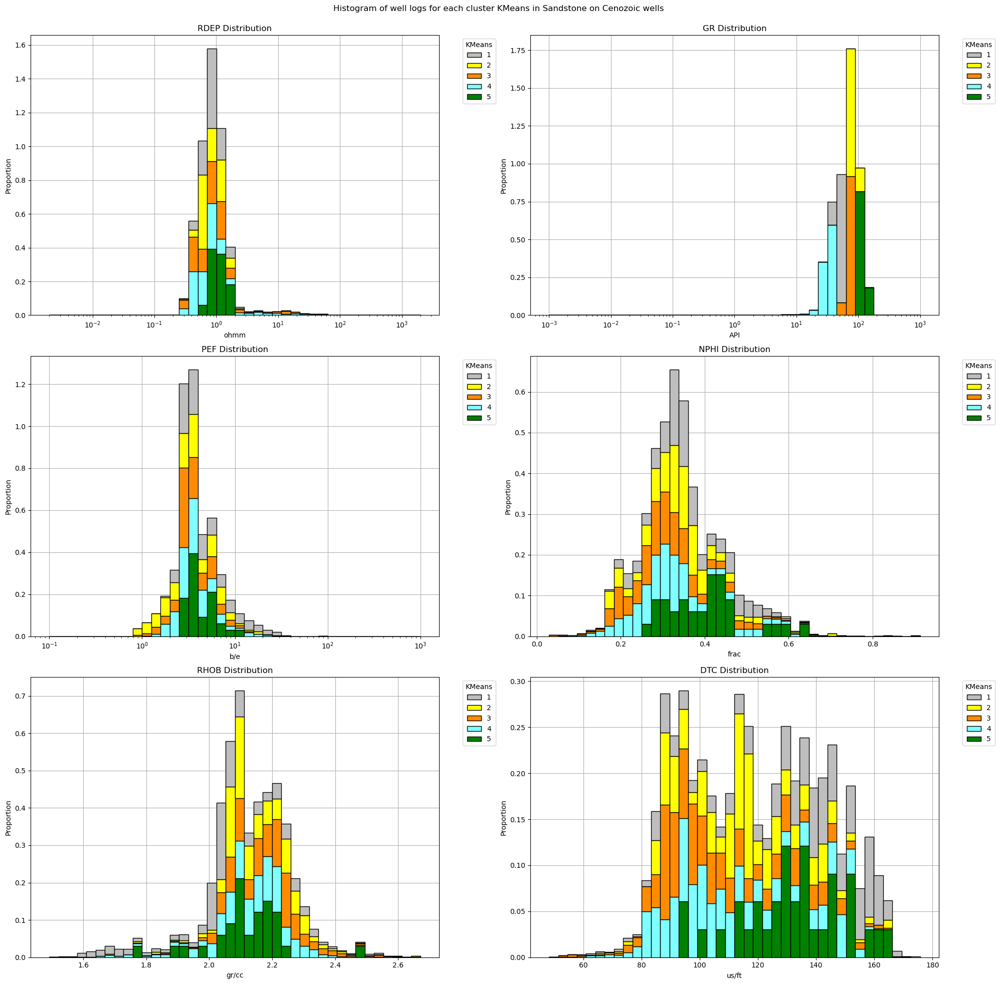

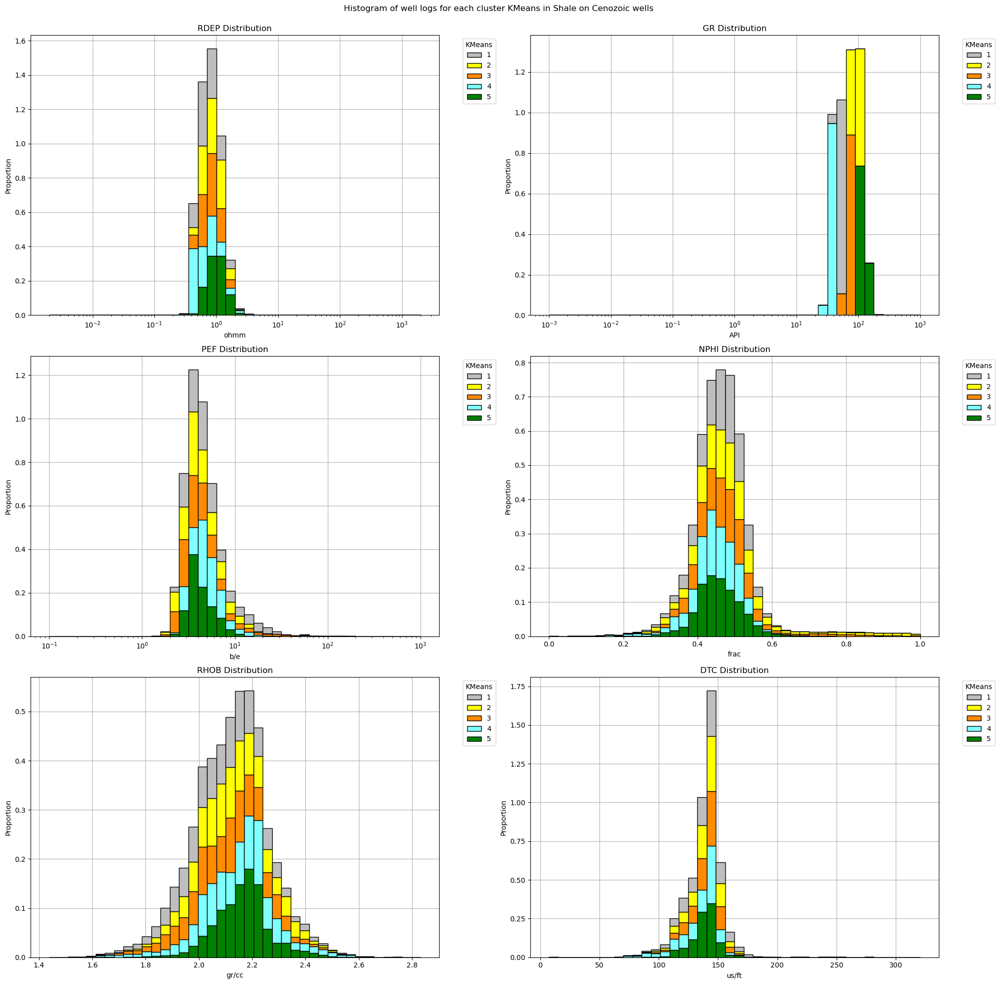

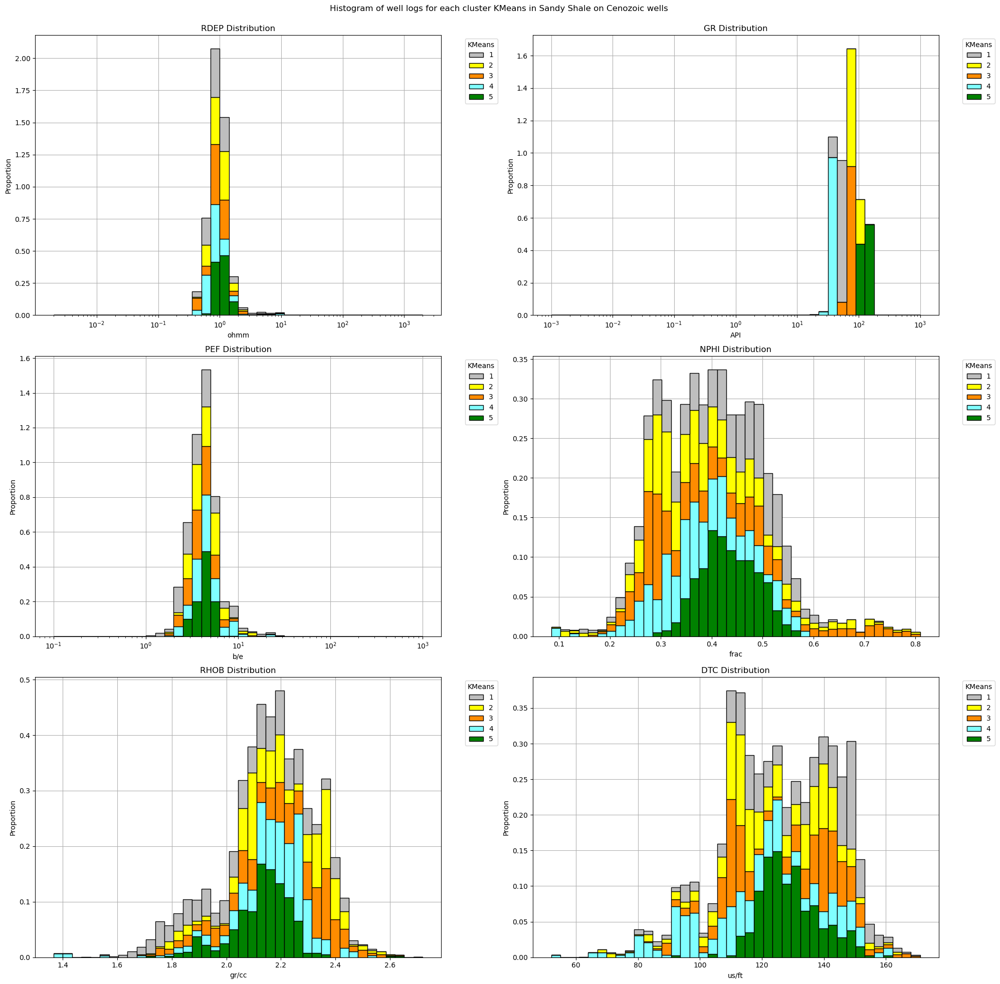

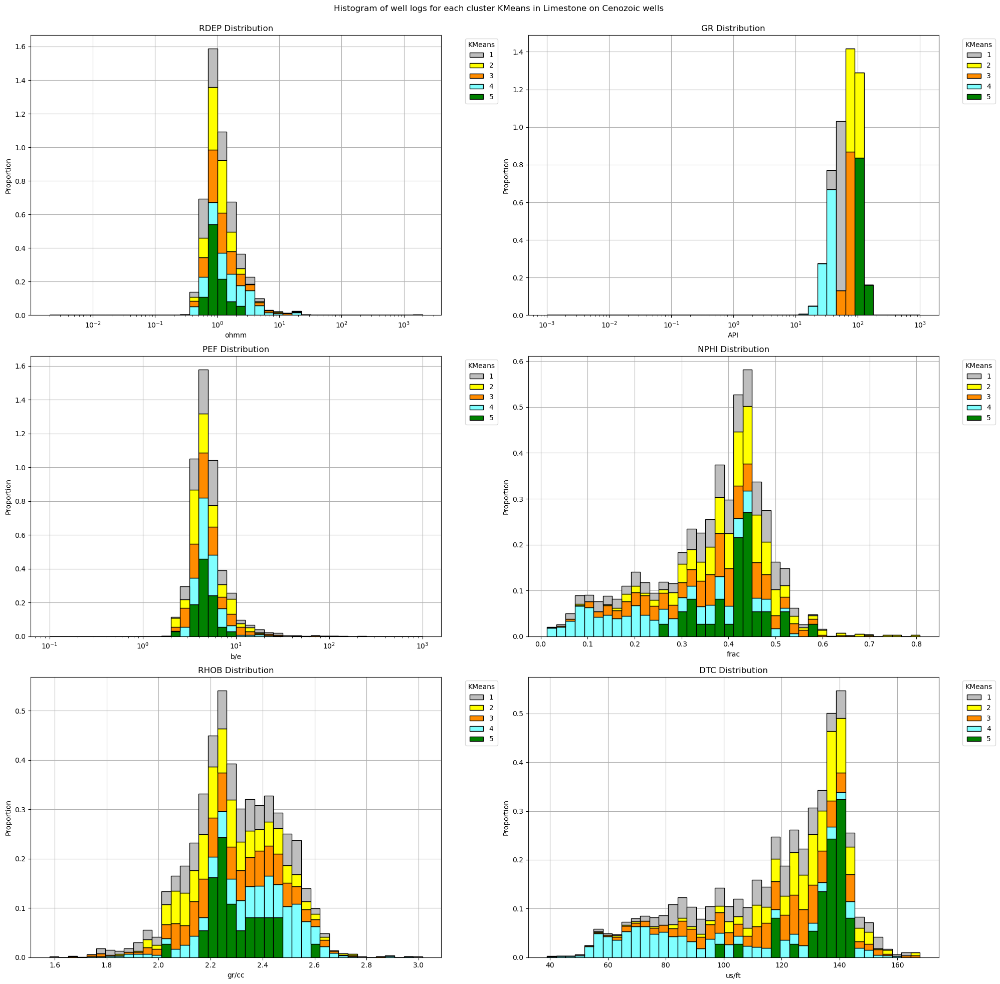

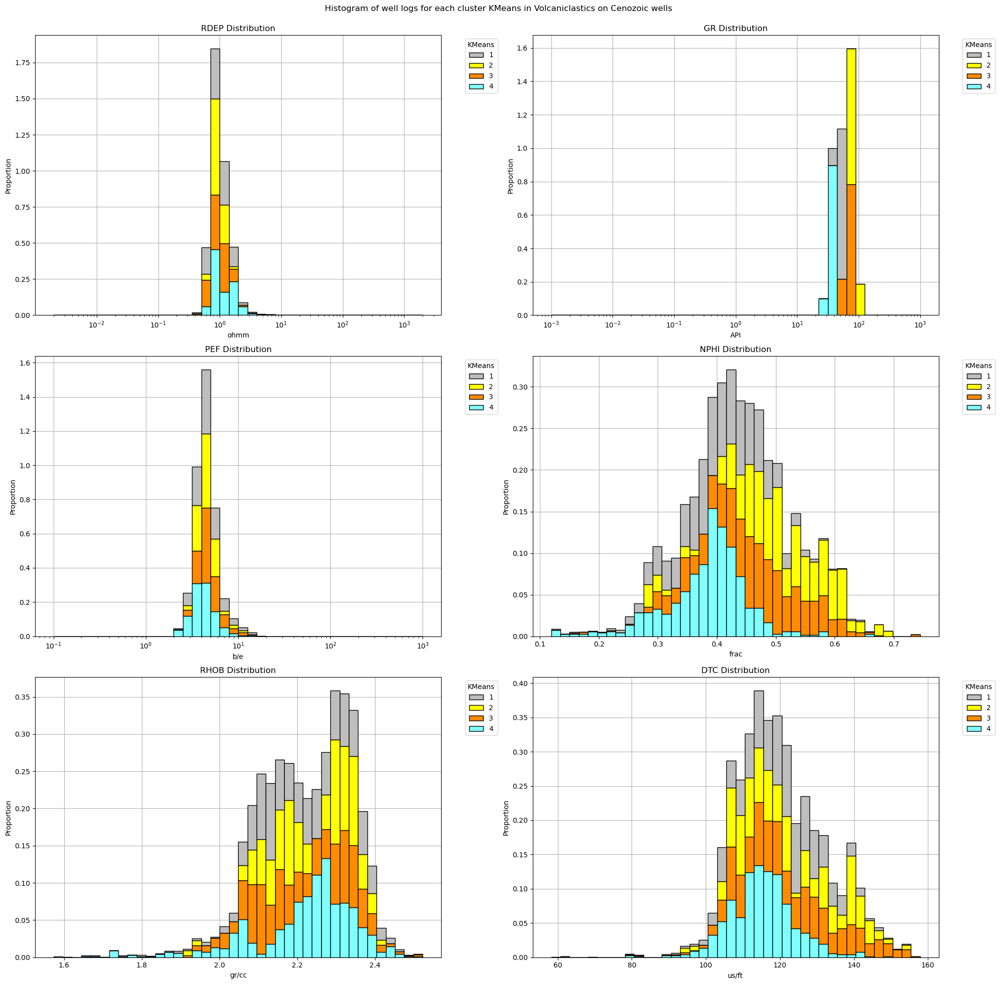

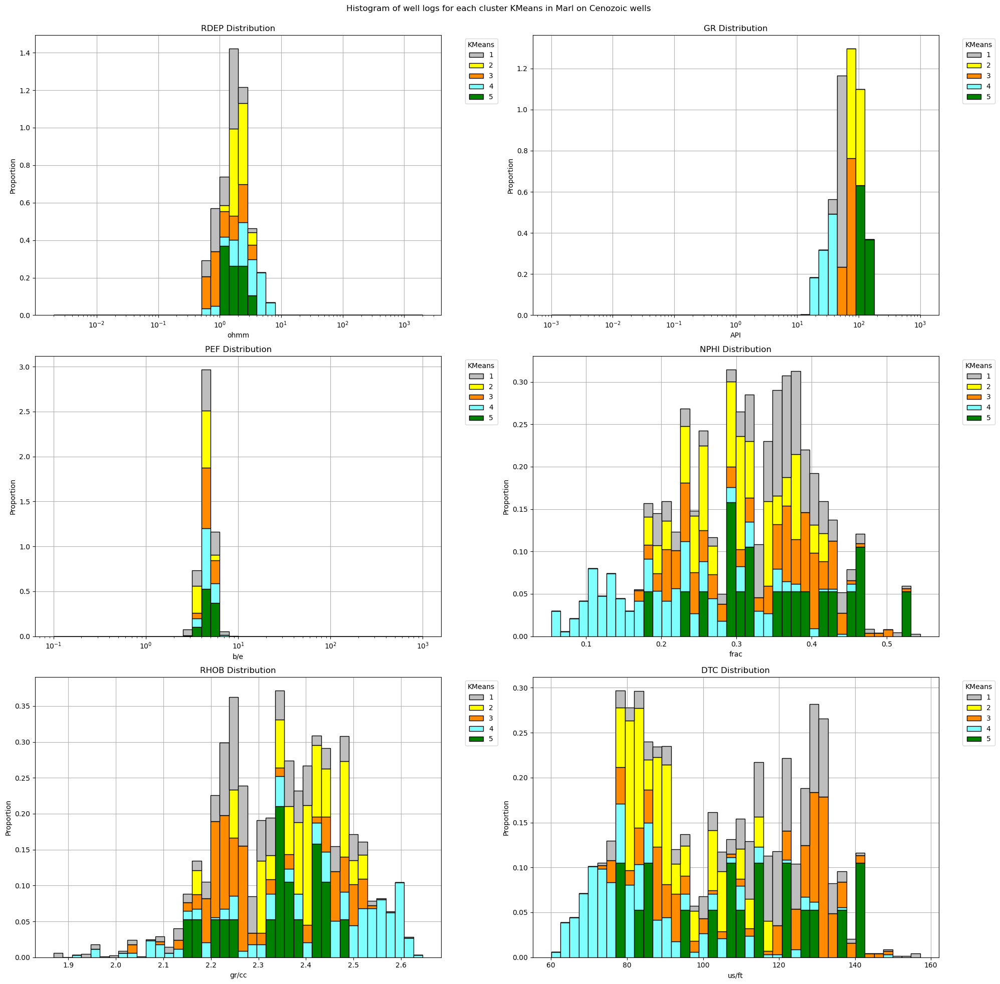

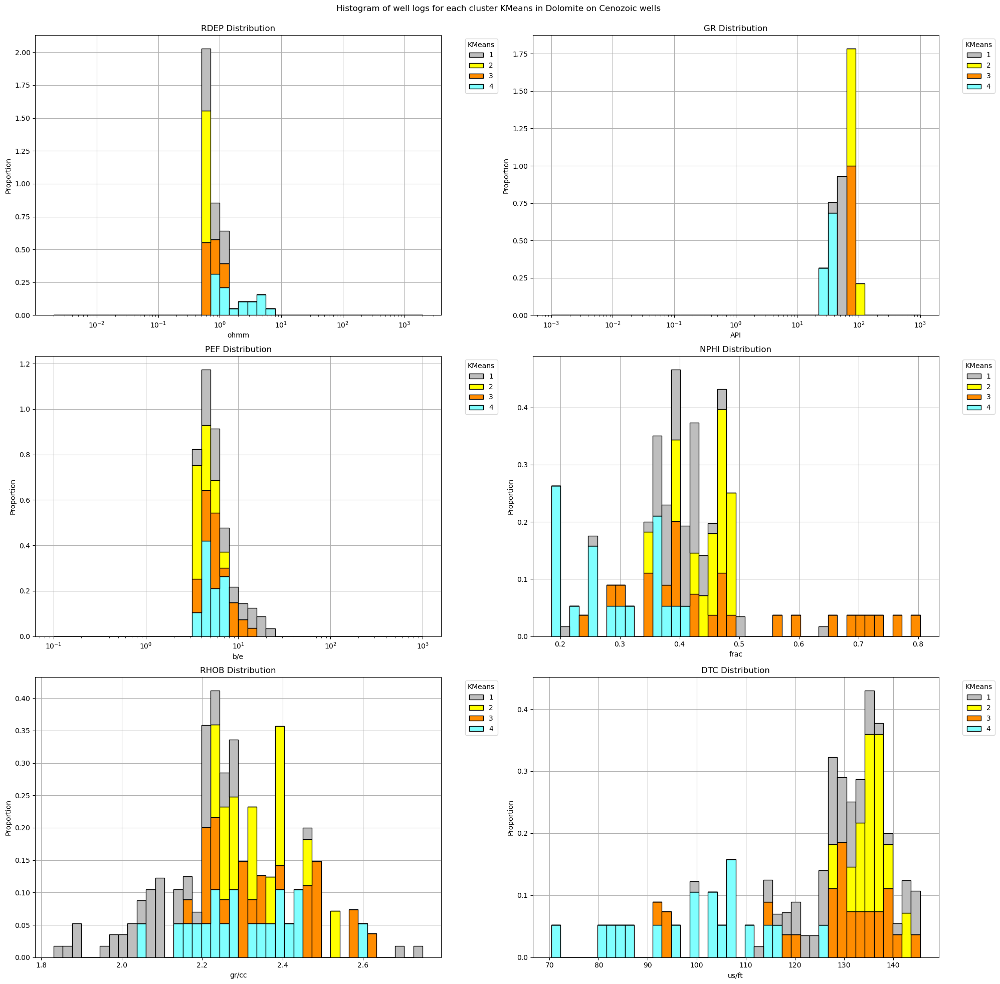

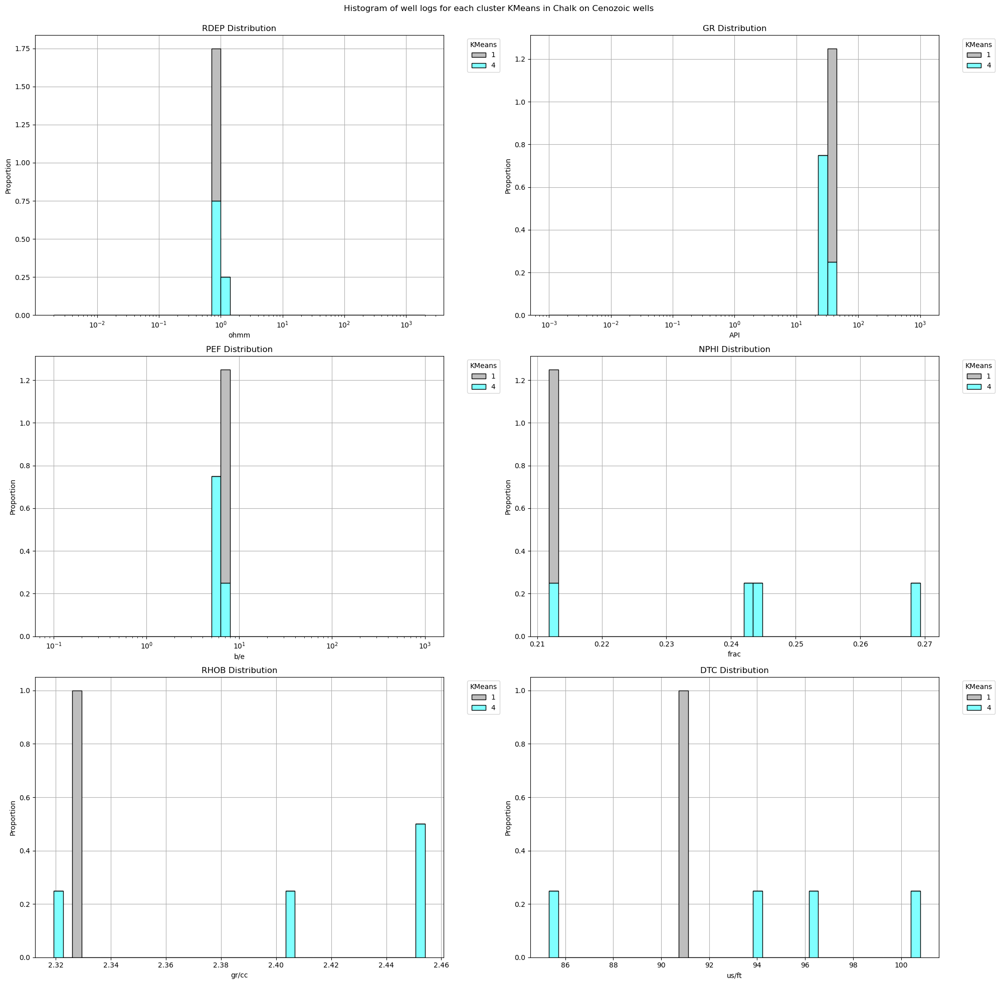

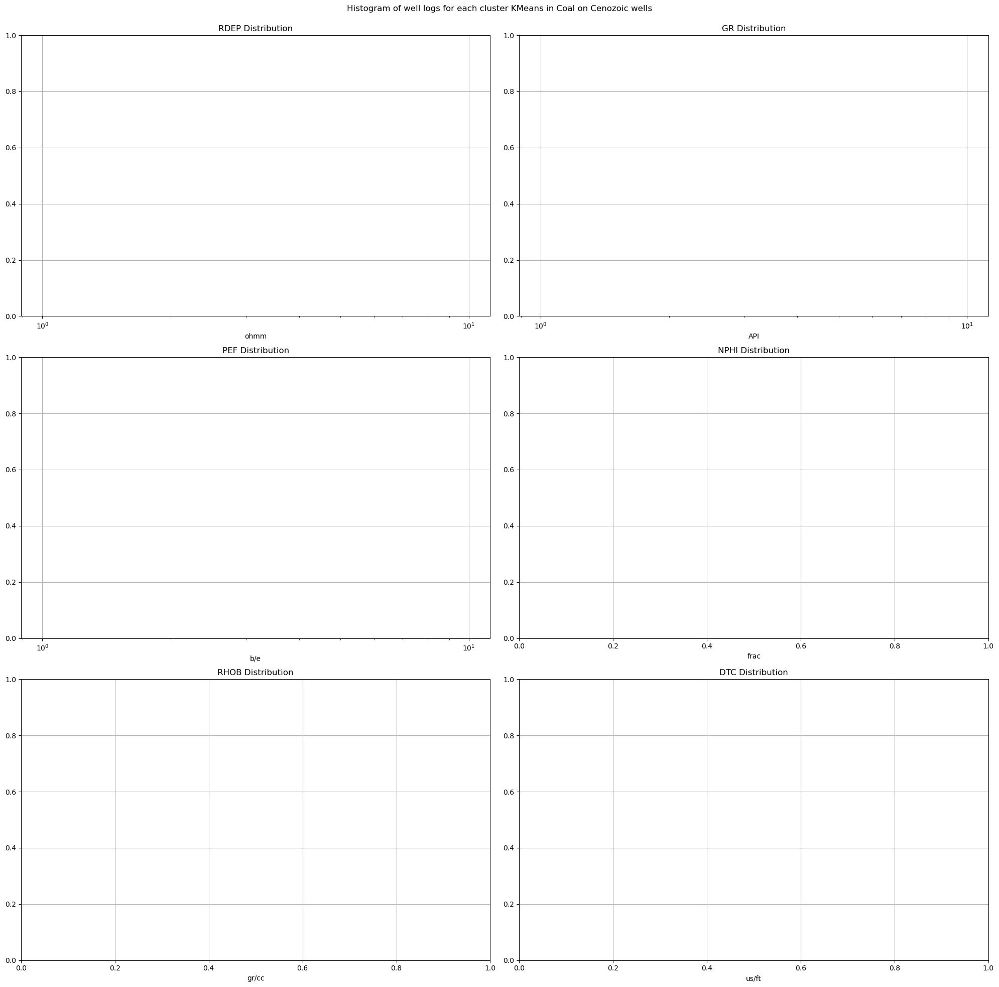

In [112]:
for i, litho in enumerate(keys_lithology):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each cluster KMeans in '+str(litho)+ ' on Cenozoic wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                #pass
            #else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                #ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='stack', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwelllogkmeans_'+str(litho)+'_stackproportion_cenozoicdata_old.png', bbox_inches='tight')
    plt.show()

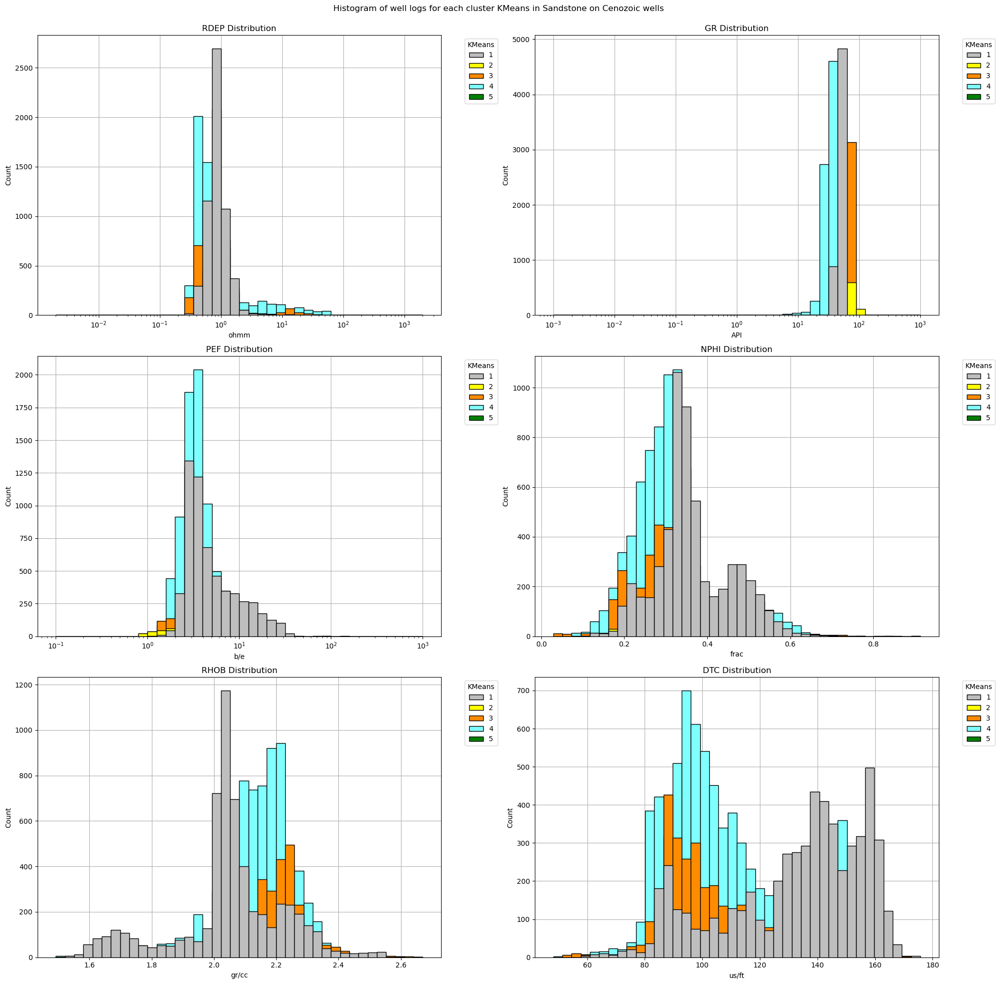

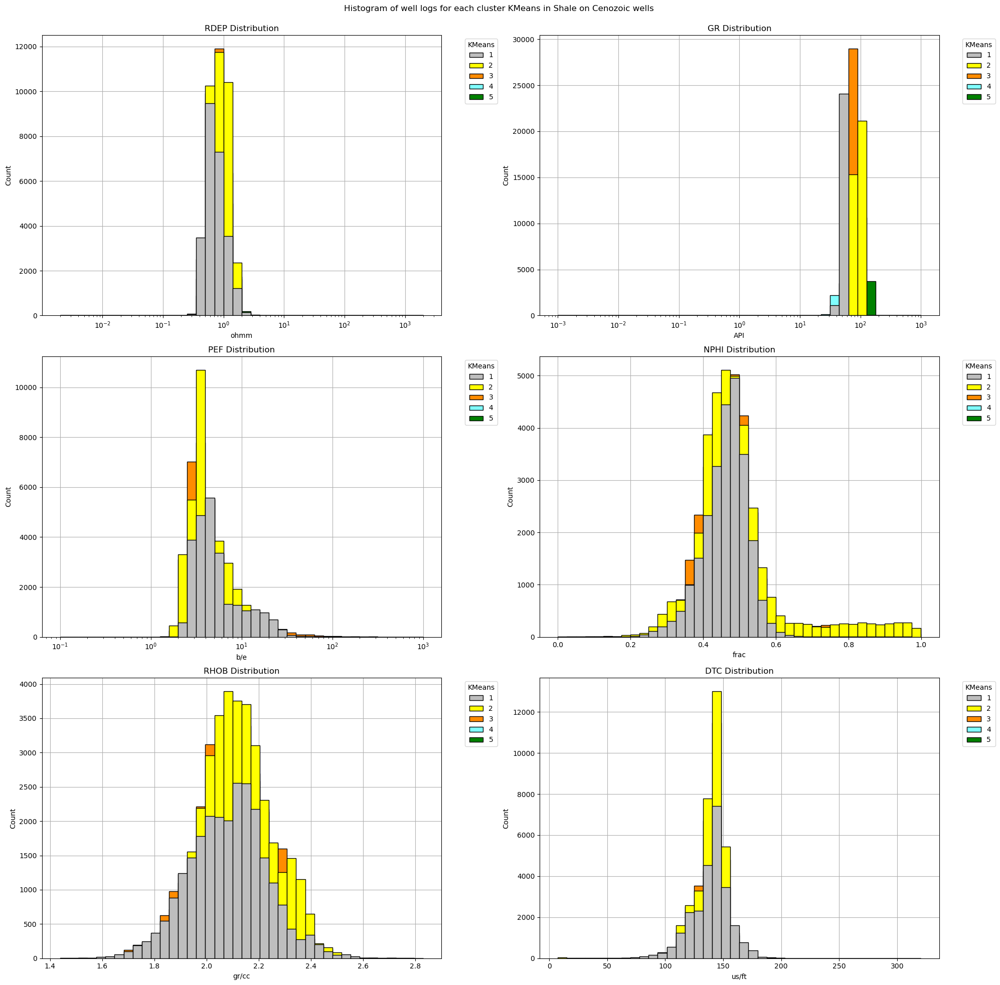

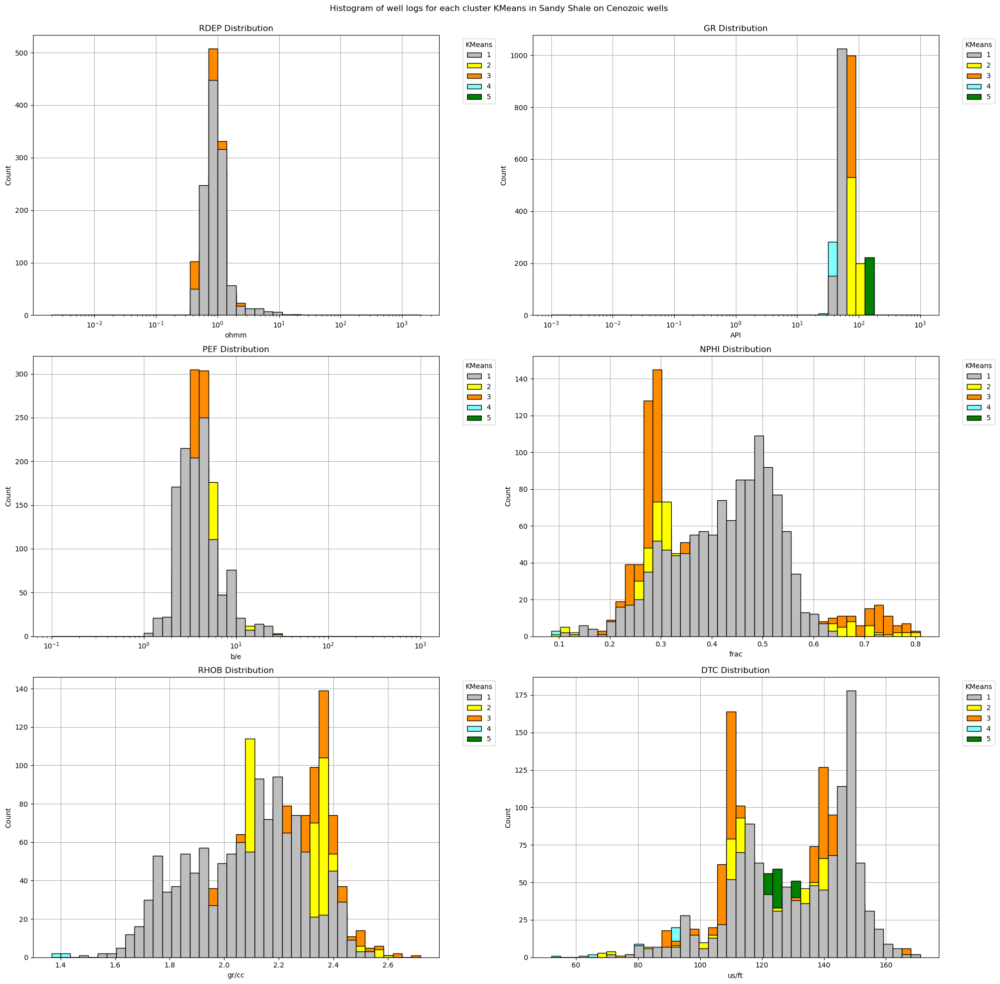

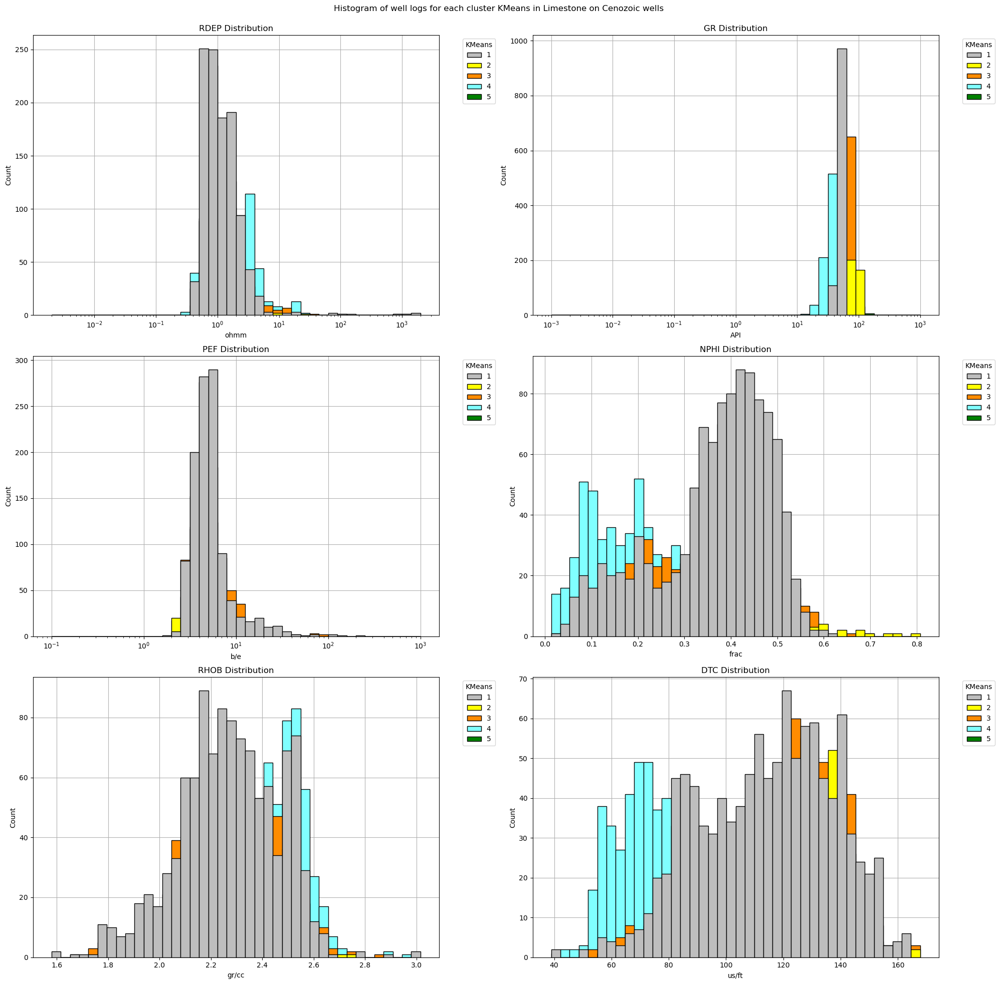

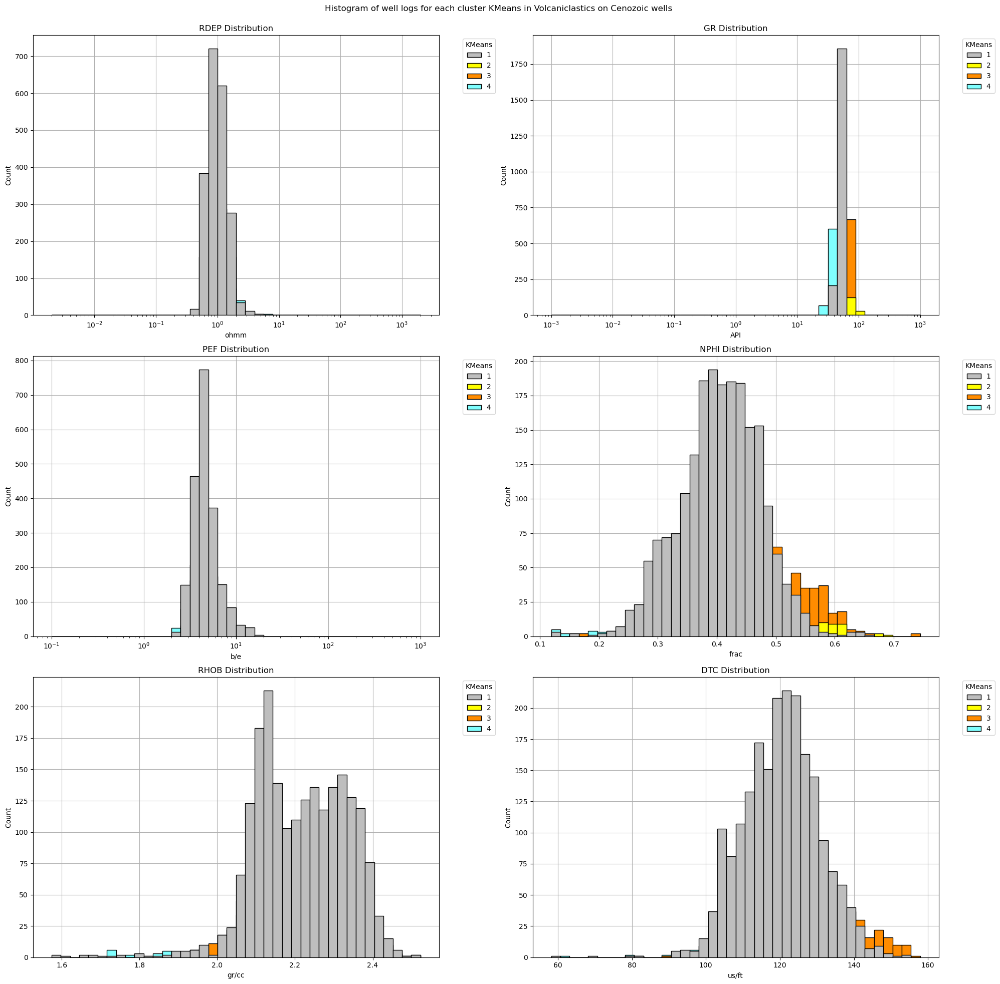

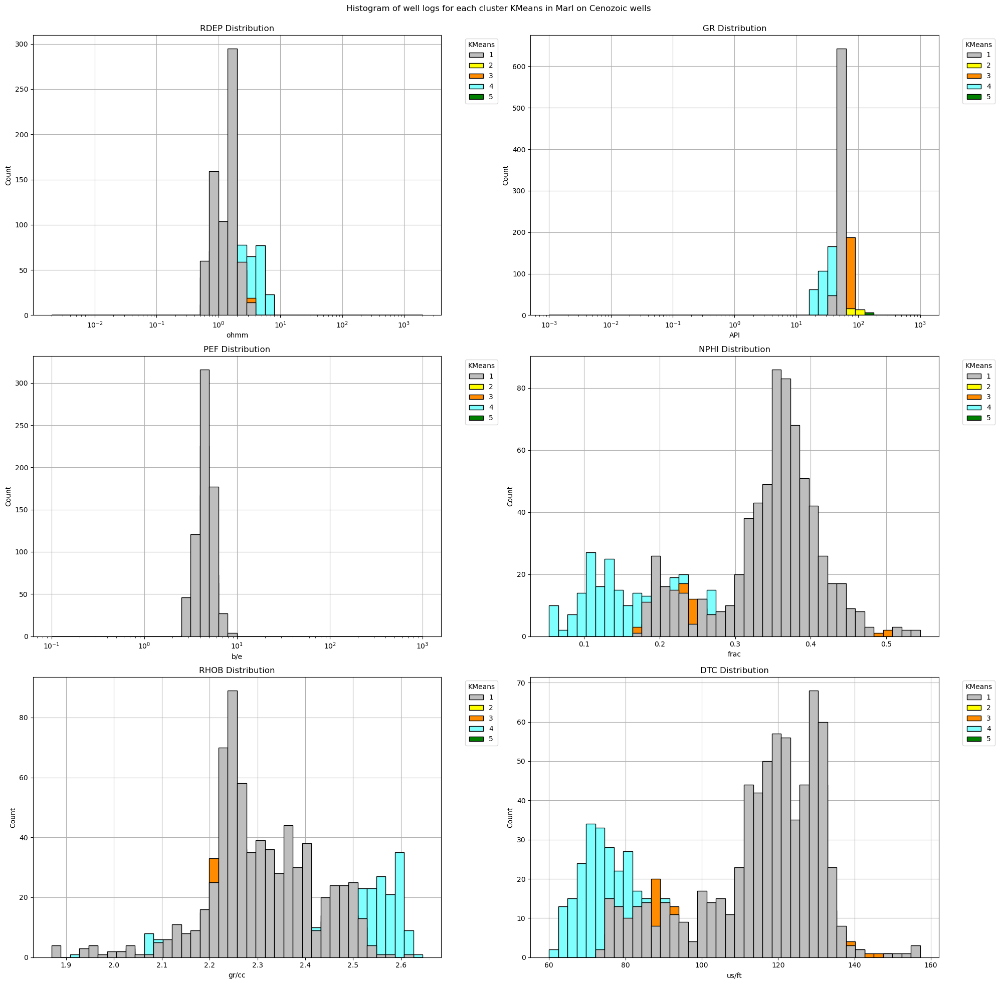

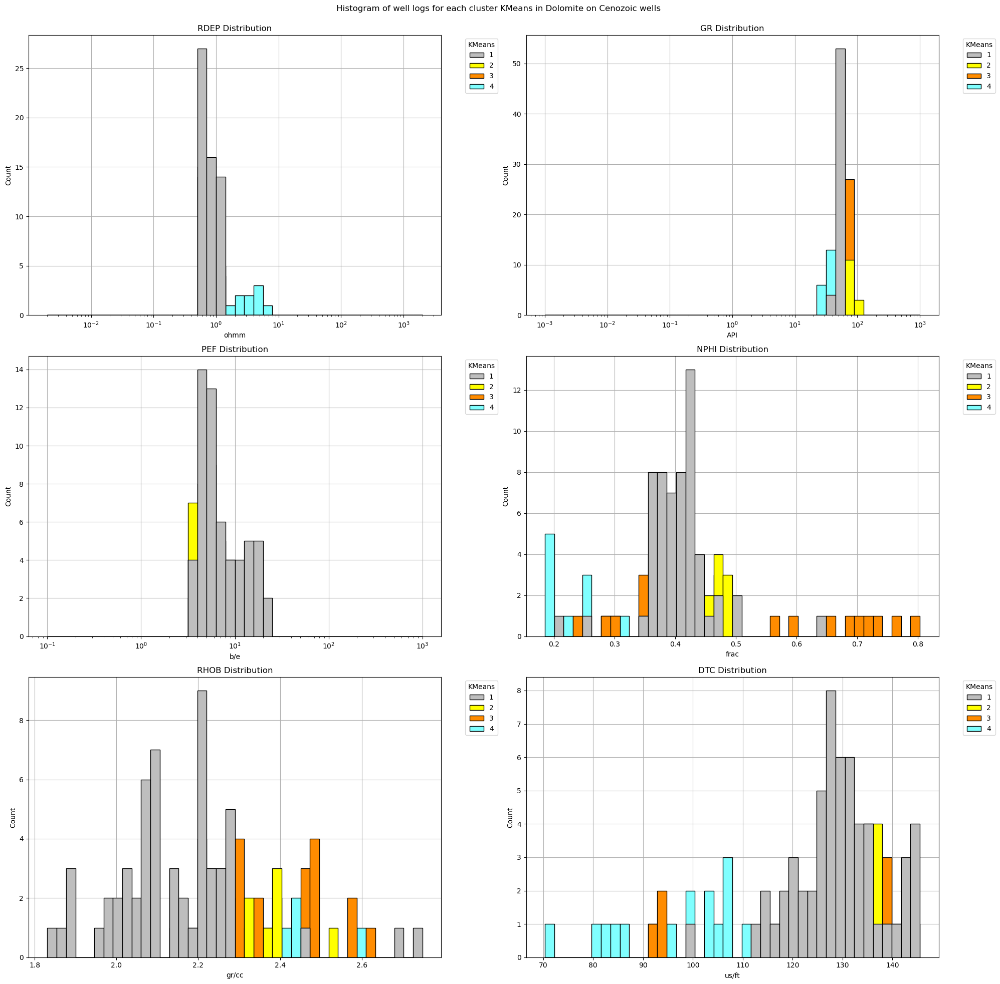

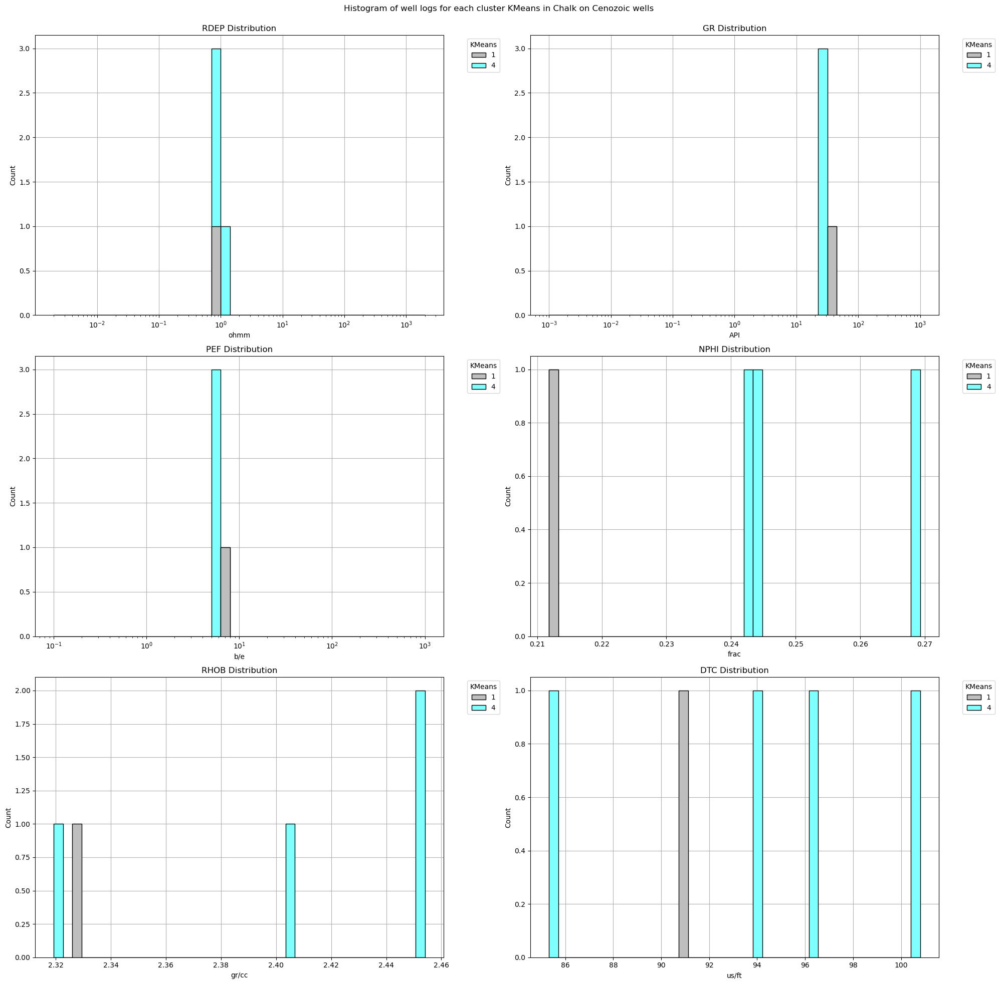

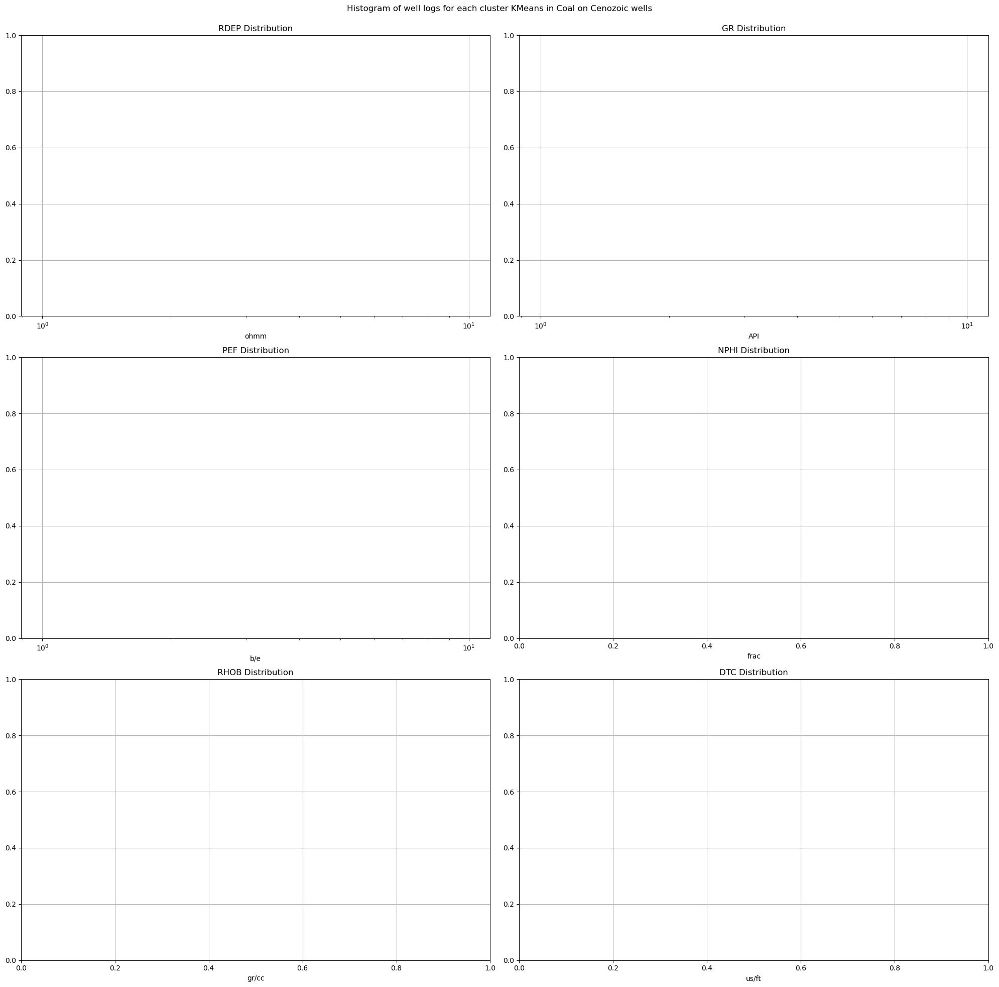

In [113]:
for i, litho in enumerate(keys_lithology):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each cluster KMeans in '+str(litho)+ ' on Cenozoic wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                #pass
            #else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                #ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='count', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwelllogkmeans_'+str(litho)+'_layercount_cenozoicdata_old.png', bbox_inches='tight')
    plt.show()

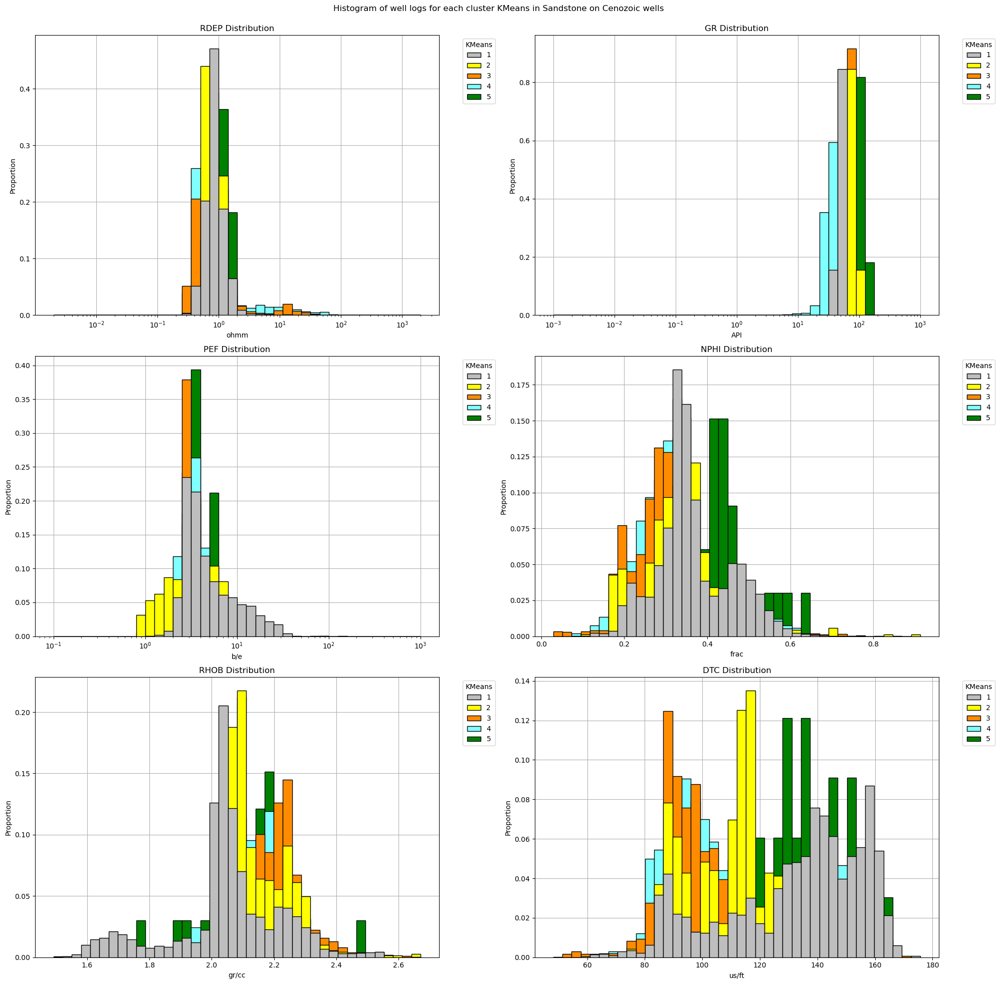

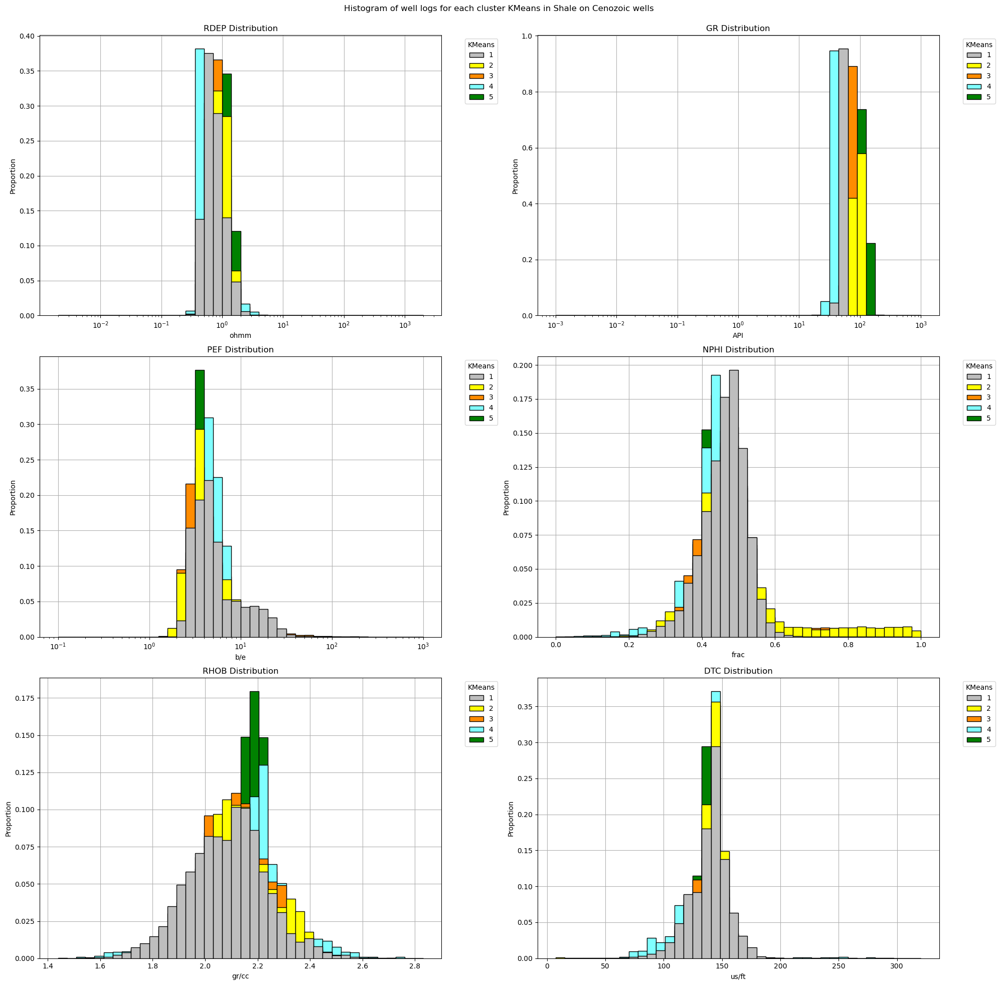

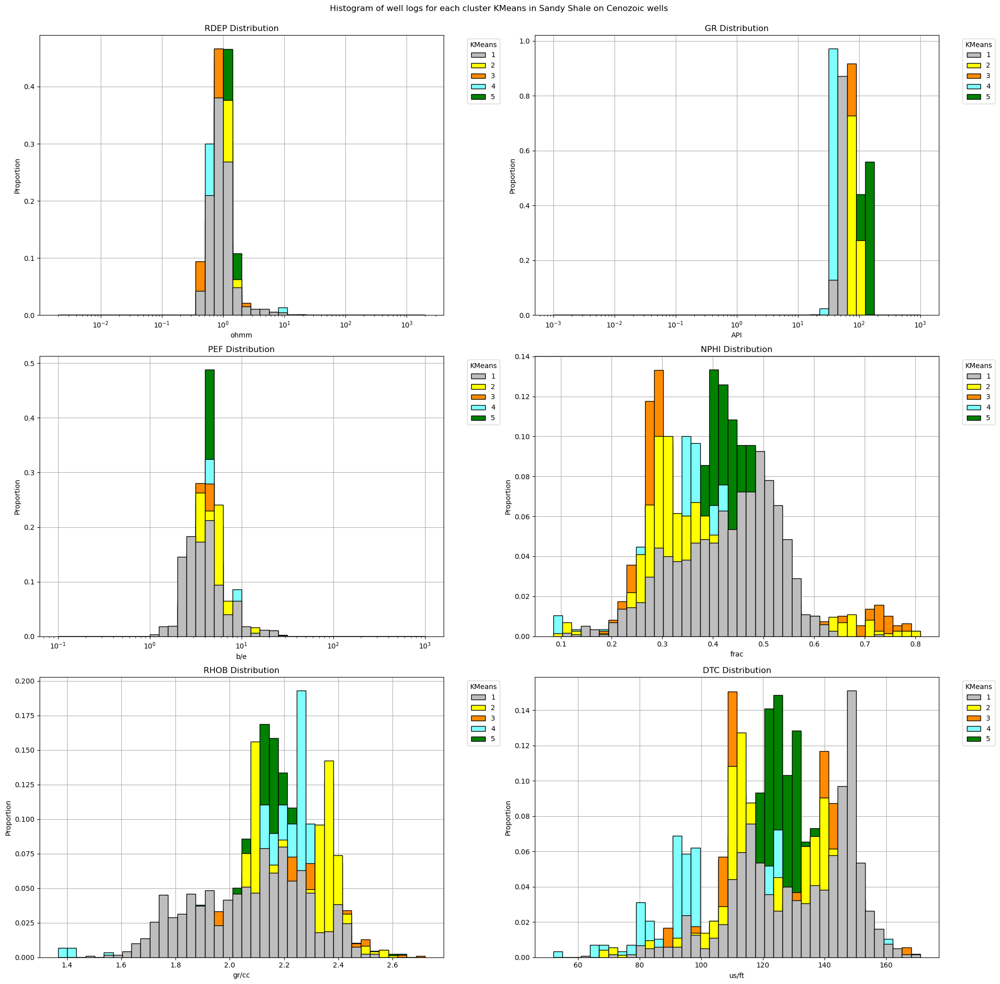

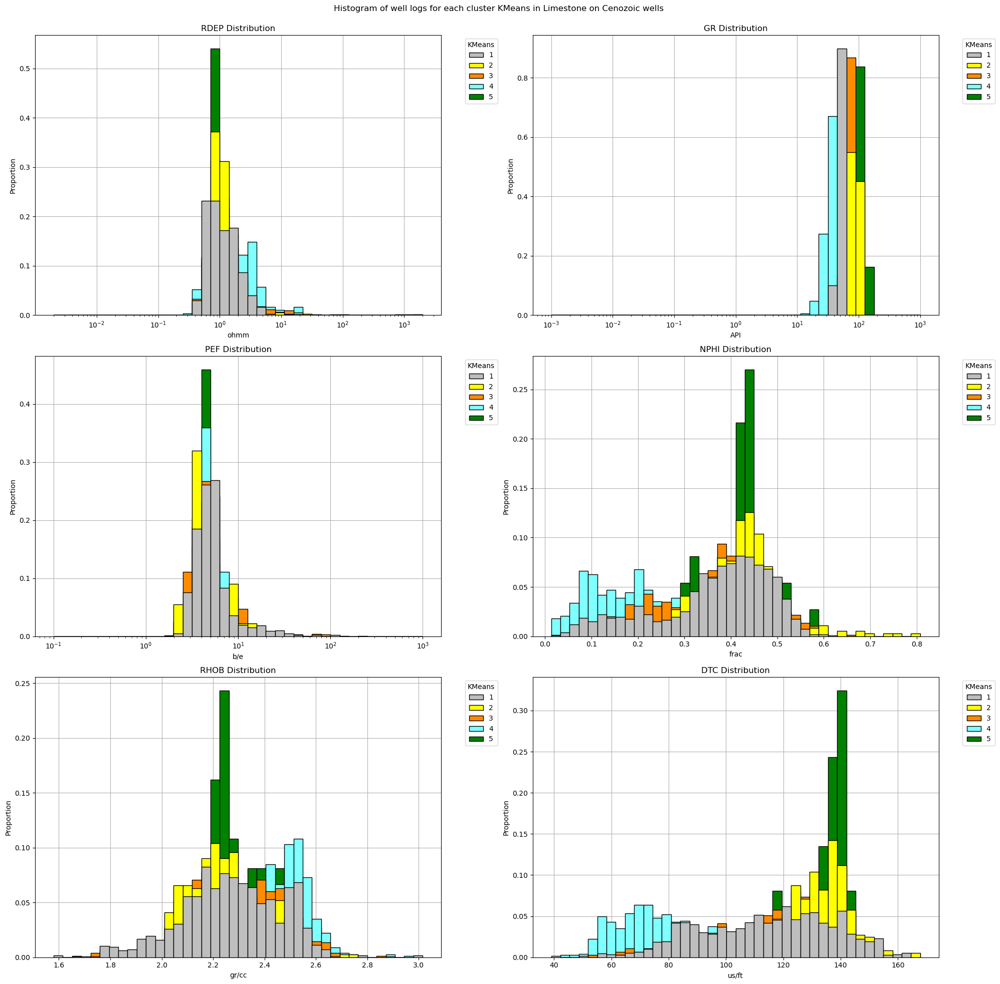

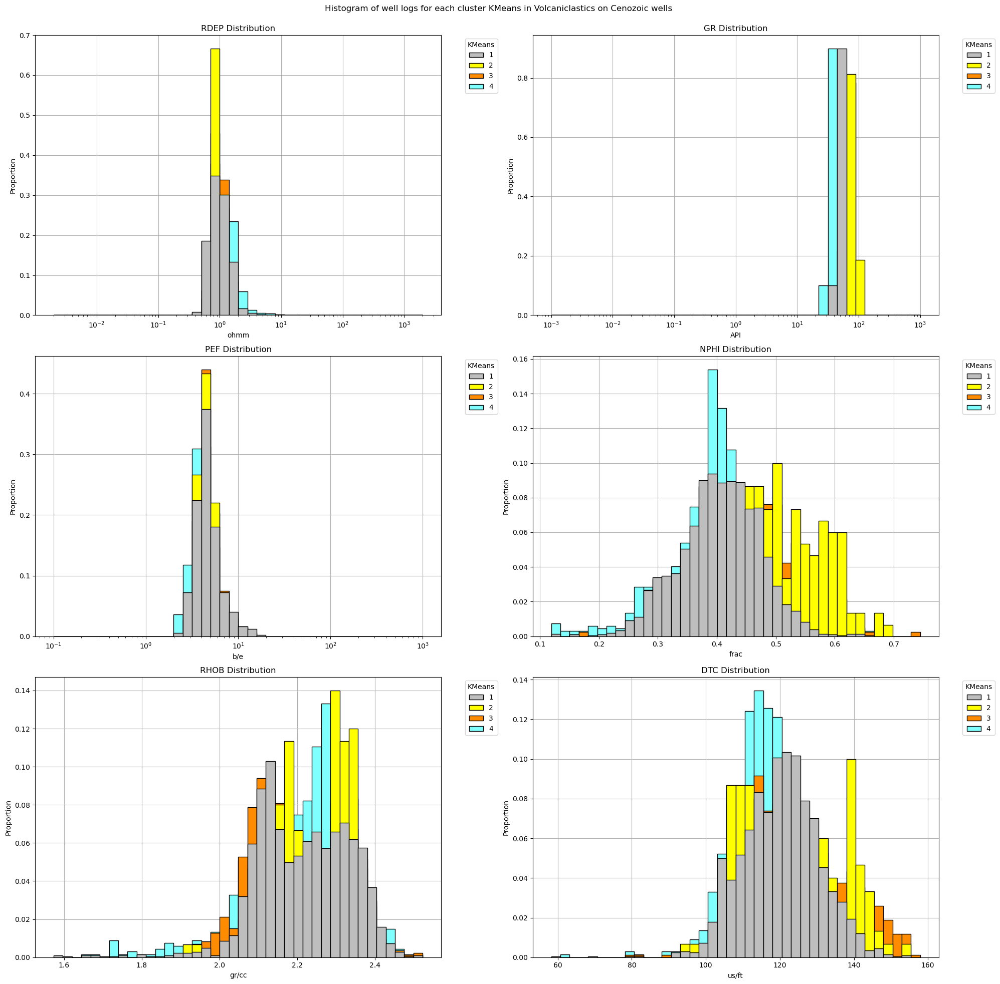

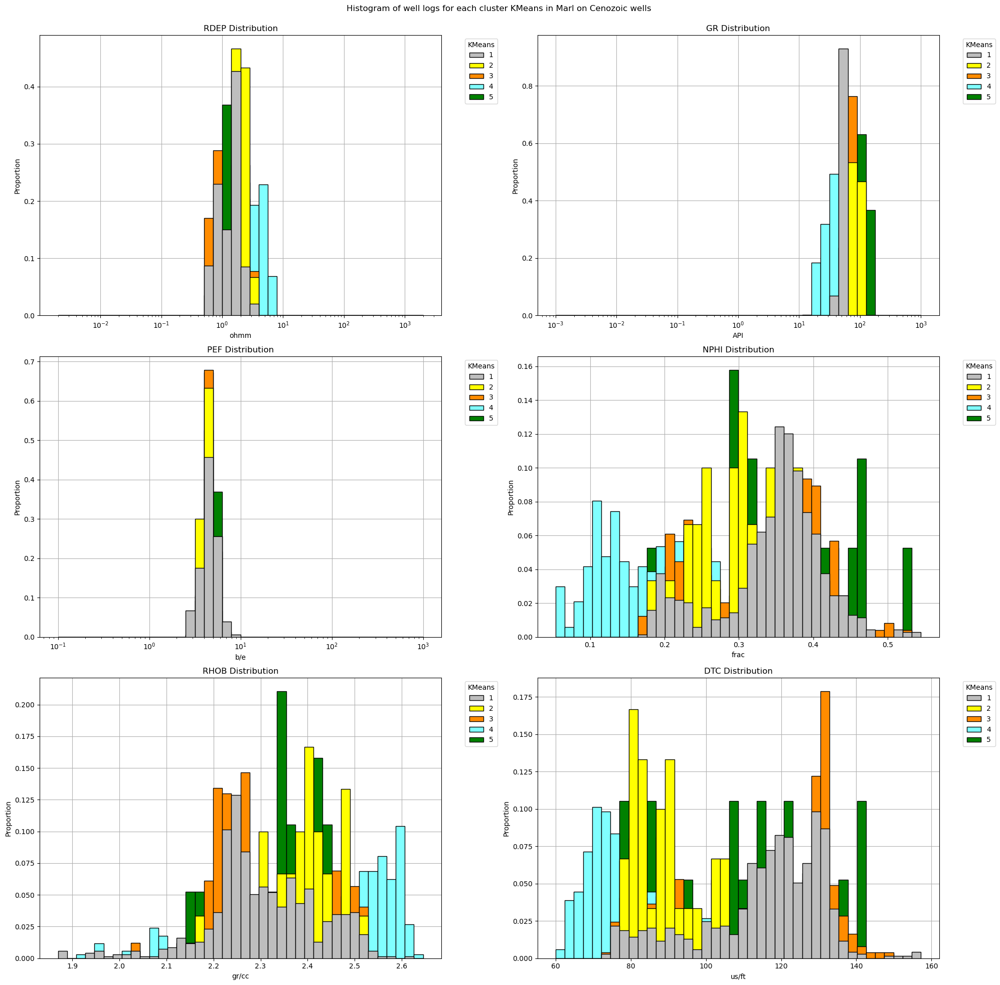

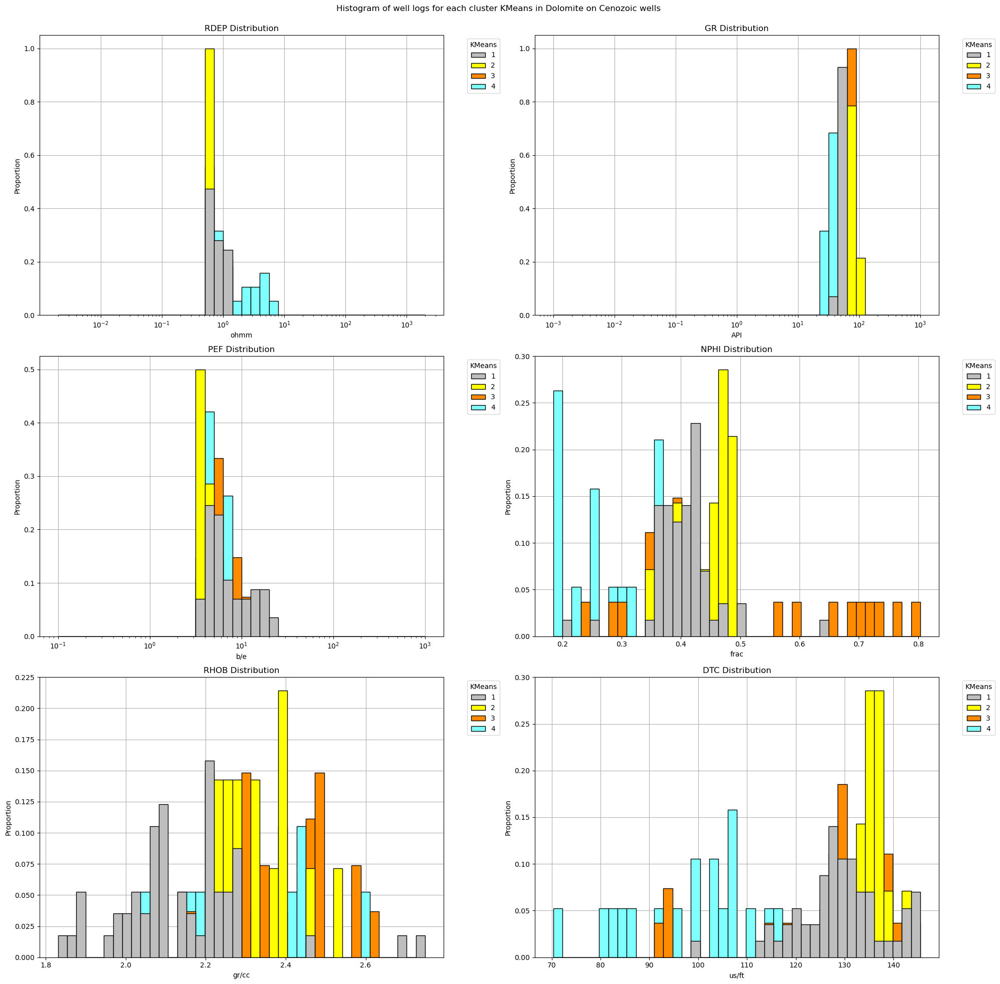

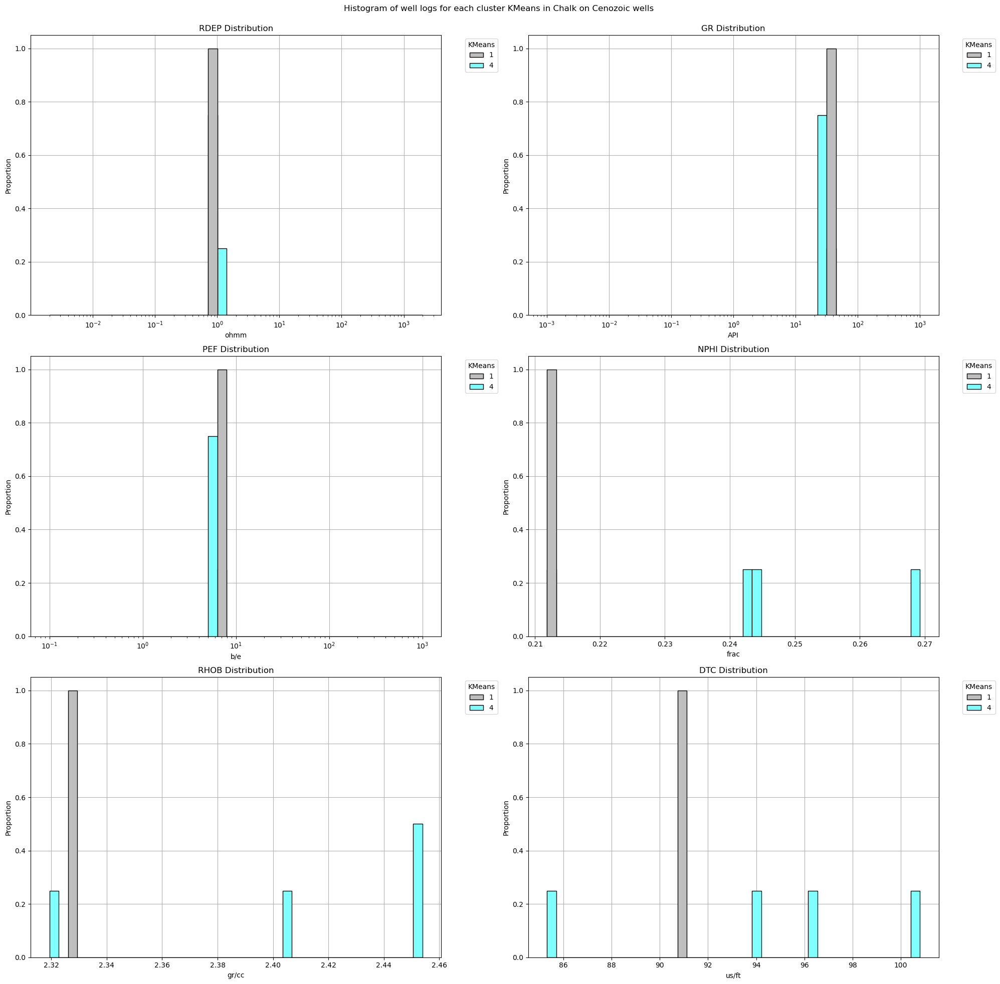

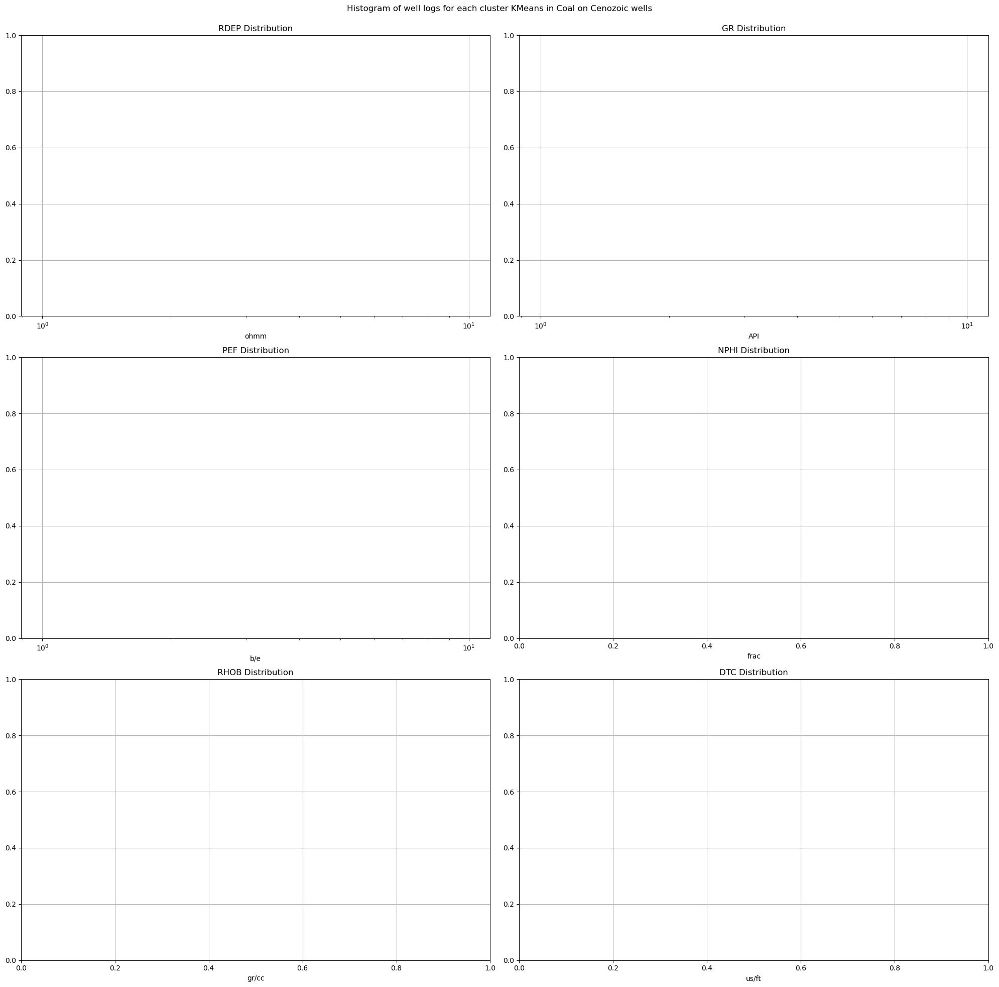

In [114]:
for i, litho in enumerate(keys_lithology):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('Histogram of well logs for each cluster KMeans in '+str(litho)+ ' on Cenozoic wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
            
        if i==0:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.002),np.log10(2000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
        elif i==1:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.001),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.001),np.log10(1000)), fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('API')
        elif i==2:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=np.logspace(np.log10(0.1),np.log10(1000),40), ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, binrange=(np.log10(0.1),np.log10(1000)),fill=True, log_scale=True, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
        elif i==3:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
        elif i==4:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
        #elif i==5:
            #if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                #pass
            #else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                #ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
        else:
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                #well.groupby('LIT')[feature].hist(bins=40, ax=ax, legend=True ,grid=True, color=kmeanscolor)
                ax=sns.histplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', stat='proportion', multiple='layer', alpha=1, bins=40, fill=True, log_scale=False, palette=kmeanscolor, common_norm=False)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')

        ax.grid()
    

    plt.tight_layout()
    plt.subplots_adjust(top=0.95)
    #plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('histogramwelllogkmeans_'+str(litho)+'_layerproportion_cenozoicdata_old.png', bbox_inches='tight')
    plt.show()

### KDEs


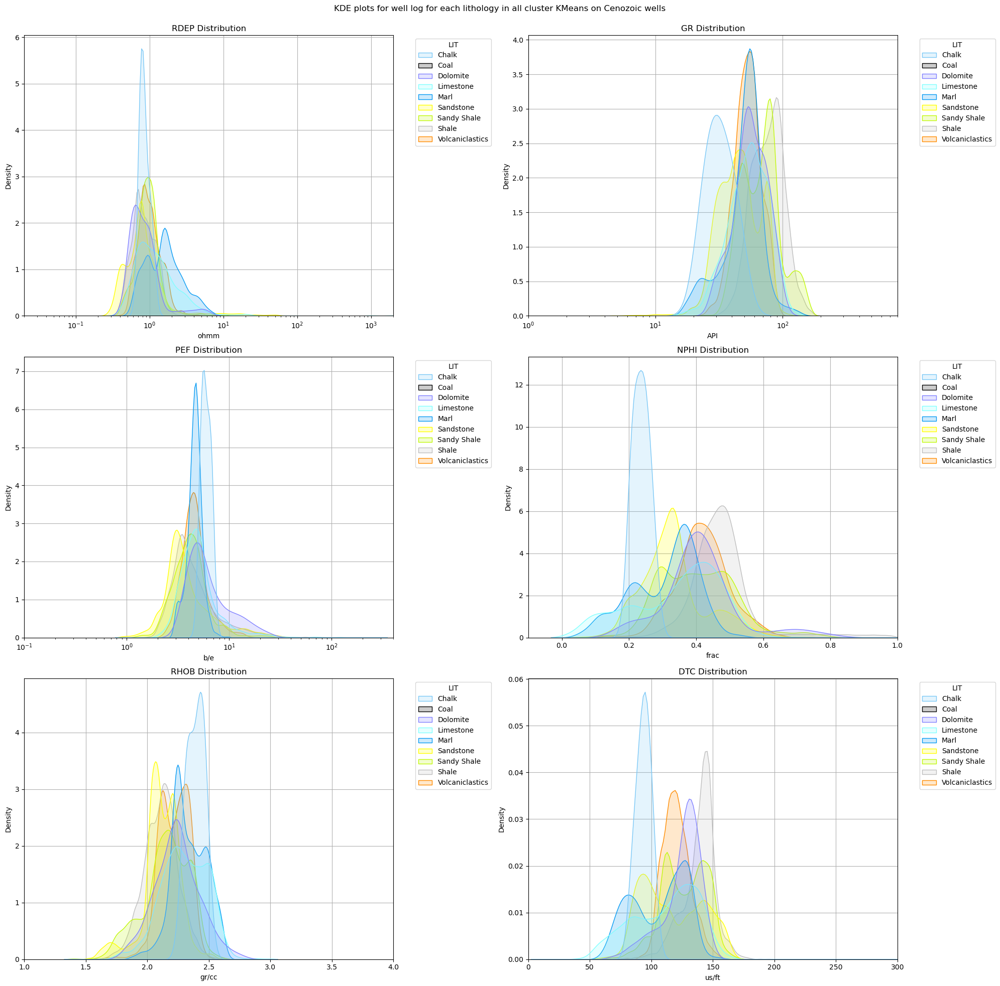

In [115]:
# KDE plots for each cluster group, lithology hue
fig = plt.figure(figsize=(20,20))
fig.suptitle('KDE plots for well log for each lithology in all cluster KMeans on Cenozoic wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    if i==0:
        #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
        ax.set_xlim(0.02, 2000)
    elif i==1:
        #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("log")
        ax.set_xlabel('API')
        ax.set_xlim(1, 800)
    elif i==2:
        #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
        ax.set_xlim(0.1, 400)
    elif i==3:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
        ax.set_xlim(-0.1, 1)
    elif i==4:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
        ax.set_xlim(1, 4)
    #elif i==5:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        #ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
        #ax.set_xlim(-500, 500)
    else:
        #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')
        ax.set_xlim(0, 300)

    sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('kdewellloglithology_allclusters_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

C:\Users\V330\AppData\Local\Temp\ipykernel_11160\3507365571.py:13: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_11160\3507365571.py:19: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_11160\3507365571.py:25: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=f

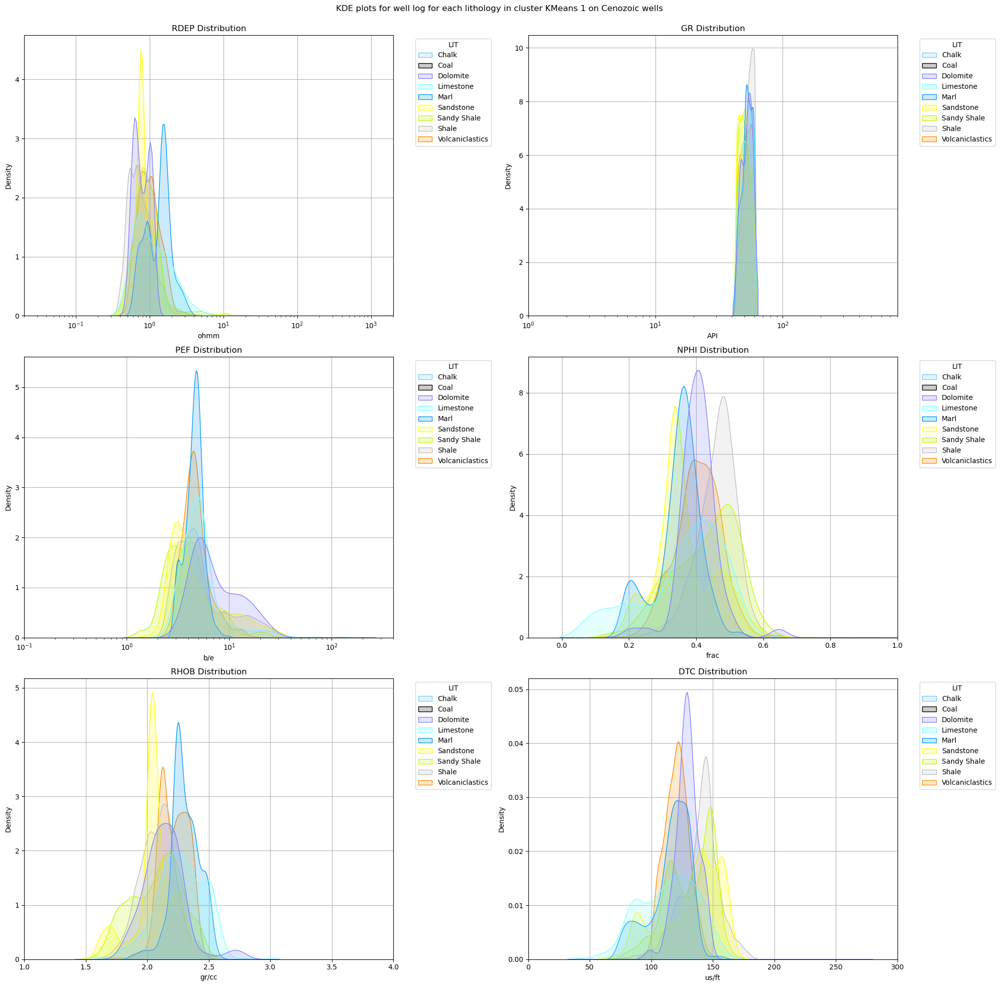

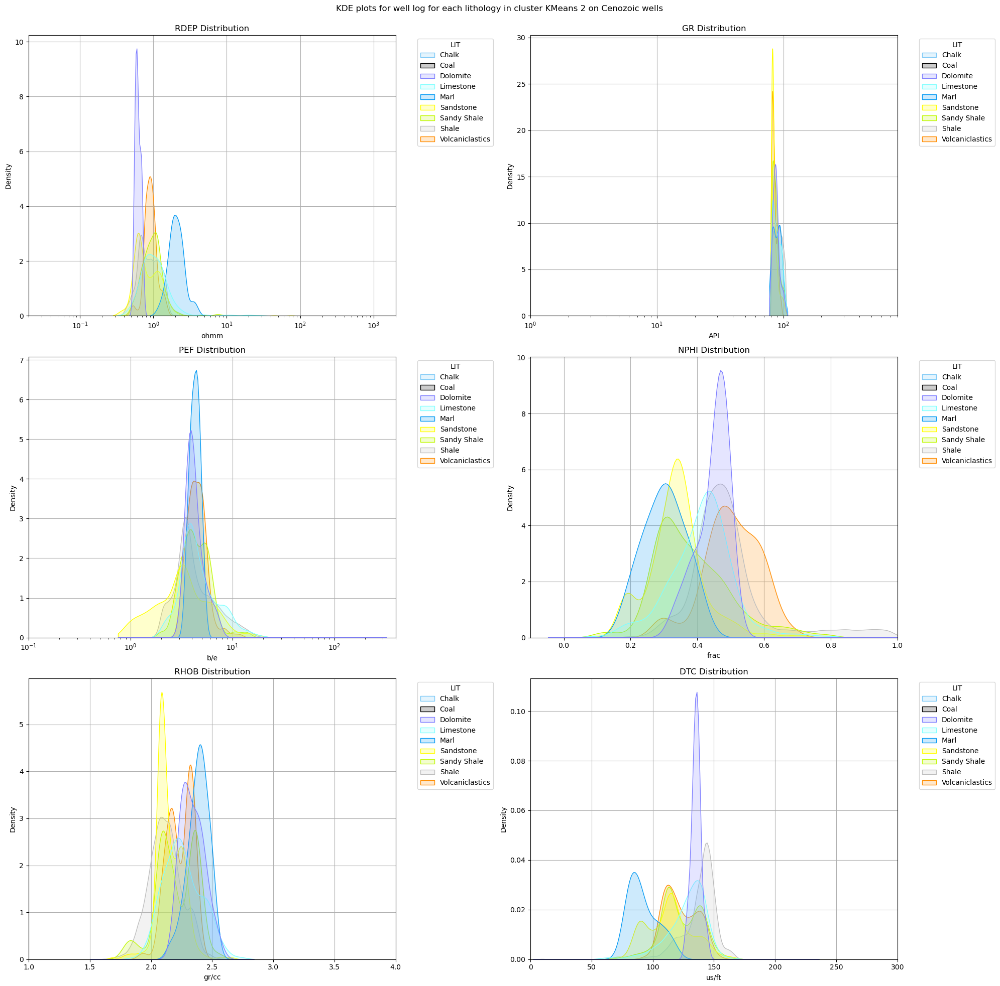

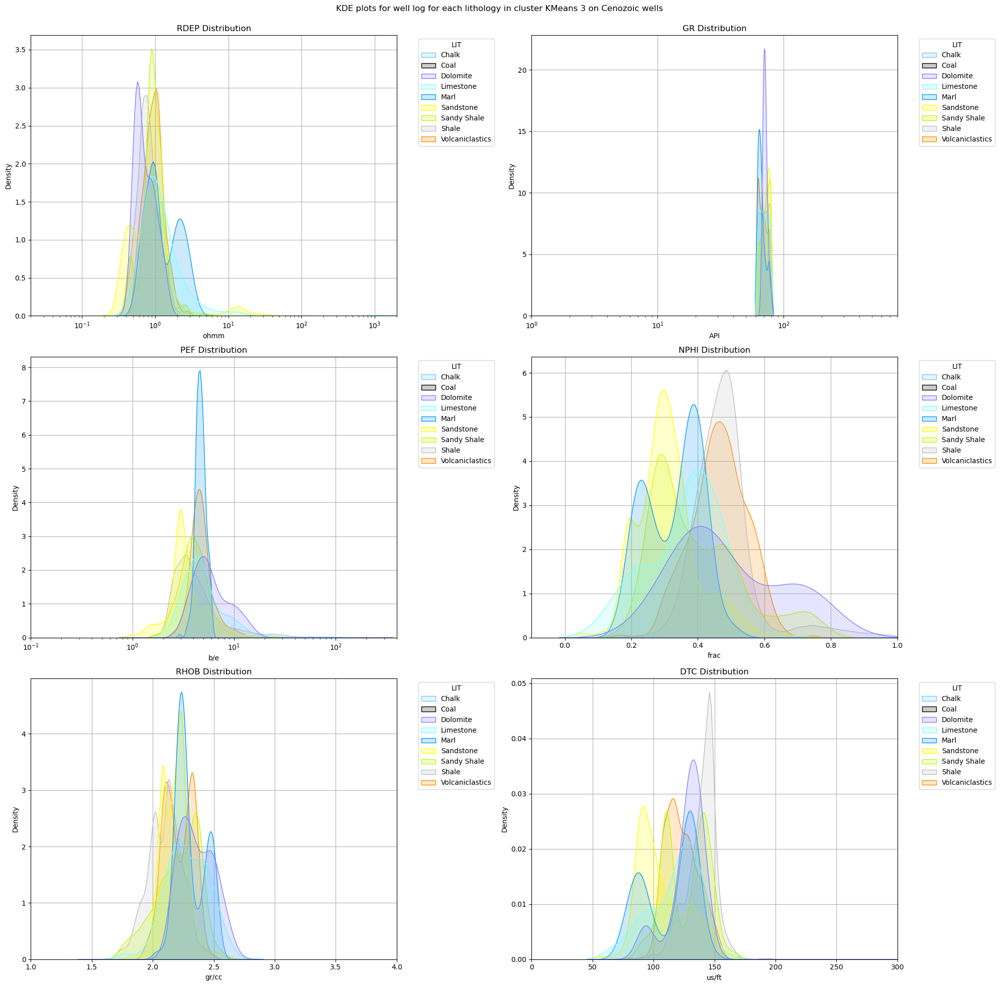

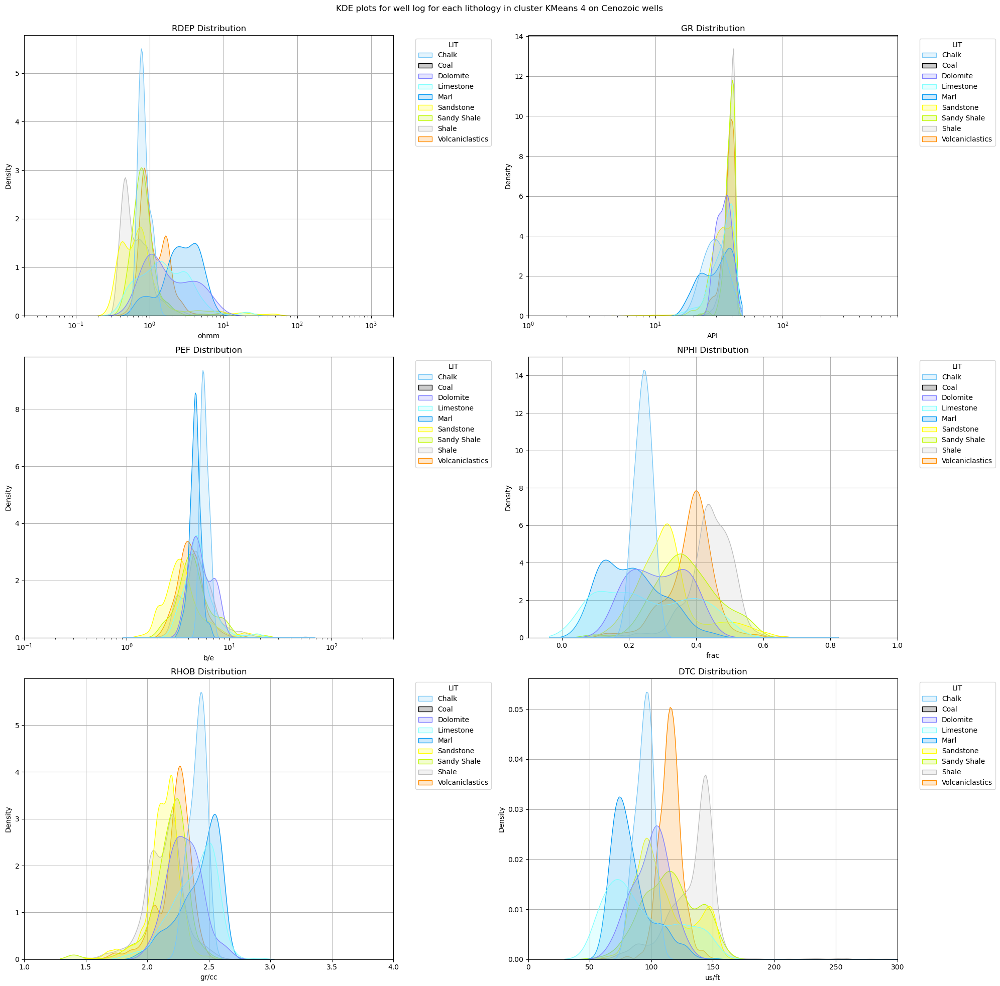

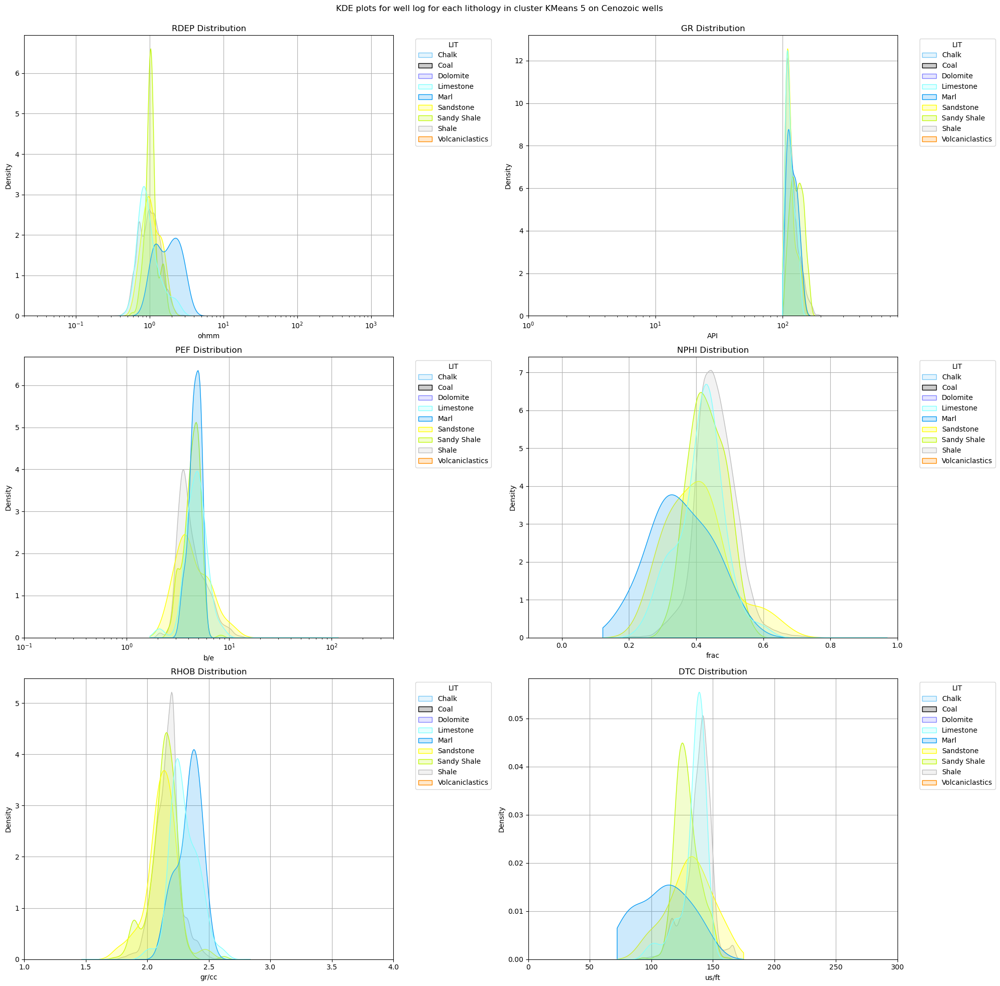

In [116]:
# KDE plots for each cluster group, lithology hue
for i, kmeans in enumerate(keys_kmeans):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('KDE plots for well log for each lithology in cluster KMeans '+str(kmeans)+ ' on Cenozoic wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
        
        if i==0:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
            ax.set_xlim(0.02, 2000)
        elif i==1:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("log")
            ax.set_xlabel('API')
            ax.set_xlim(1, 800)
        elif i==2:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=True, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
            ax.set_xlim(0.1, 400)
        elif i==3:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
            ax.set_xlim(-0.1, 1)
        elif i==4:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
            ax.set_xlim(1, 4)
        #elif i==5:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            #ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
            #ax.set_xlim(-500, 500)
        else:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            ax=sns.kdeplot(data=well_clustered[well_clustered['KMeans']==kmeans], x=feature, hue='LIT', fill=True, alpha=0.2, log_scale=False, palette=litocolor, common_norm=False, common_grid=True)
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')
            ax.set_xlim(0, 300)

        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.grid()
    
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)#plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('kdewellloglithology_kmeanscluster'+str(kmeans)+'_cenozoicdata_old.png', bbox_inches='tight')
    plt.show()

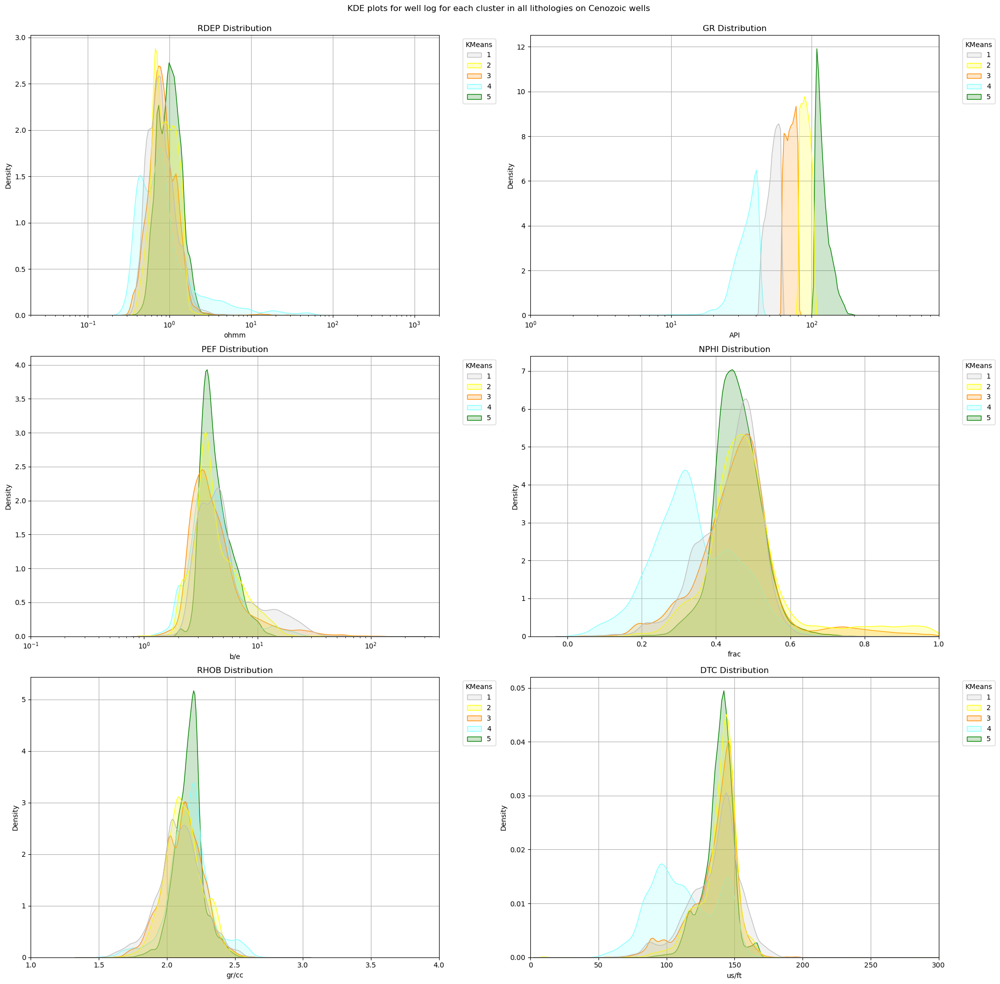

In [117]:
# KDE plots for each lithology group, cluster KMeans hue
fig = plt.figure(figsize=(20,20))
fig.suptitle('KDE plots for well log for each cluster in all lithologies on Cenozoic wells')

for i, feature in enumerate(well_clustered_curves):
    ax=fig.add_subplot(3,2,i+1)
    ax.set_title(feature+" Distribution")
    ax.set_axisbelow(True)
    
    if i==0:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('ohmm')
        ax.set_xlim(0.02, 2000)
        
    elif i==1:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('API')
        ax.set_xlim(1, 800)
        
    elif i==2:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("log")
        ax.set_xlabel('b/e')
        ax.set_xlim(0.1, 400)
    elif i==3:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('frac')
        ax.set_xlim(-0.1, 1)
    elif i==4:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('gr/cc')
        ax.set_xlim(1, 4)
        
    #elif i==5:
        #ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
        #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        #ax.set_xscale("linear")
        #ax.set_xlabel('mV')
        #ax.set_xlim(-500, 500)
        
    else:
        ax=sns.kdeplot(data=well_clustered, x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
        sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
        ax.set_xscale("linear")
        ax.set_xlabel('us/ft')
        ax.set_xlim(0, 300)
        
    ax.grid()


plt.tight_layout()
plt.subplots_adjust(top=0.95)#plt.subplots_adjust(hspace=0.15, wspace=0.5)
plt.savefig('kdewelllogkmeans_alllithology_cenozoicdata_old.png', bbox_inches='tight')
plt.show()

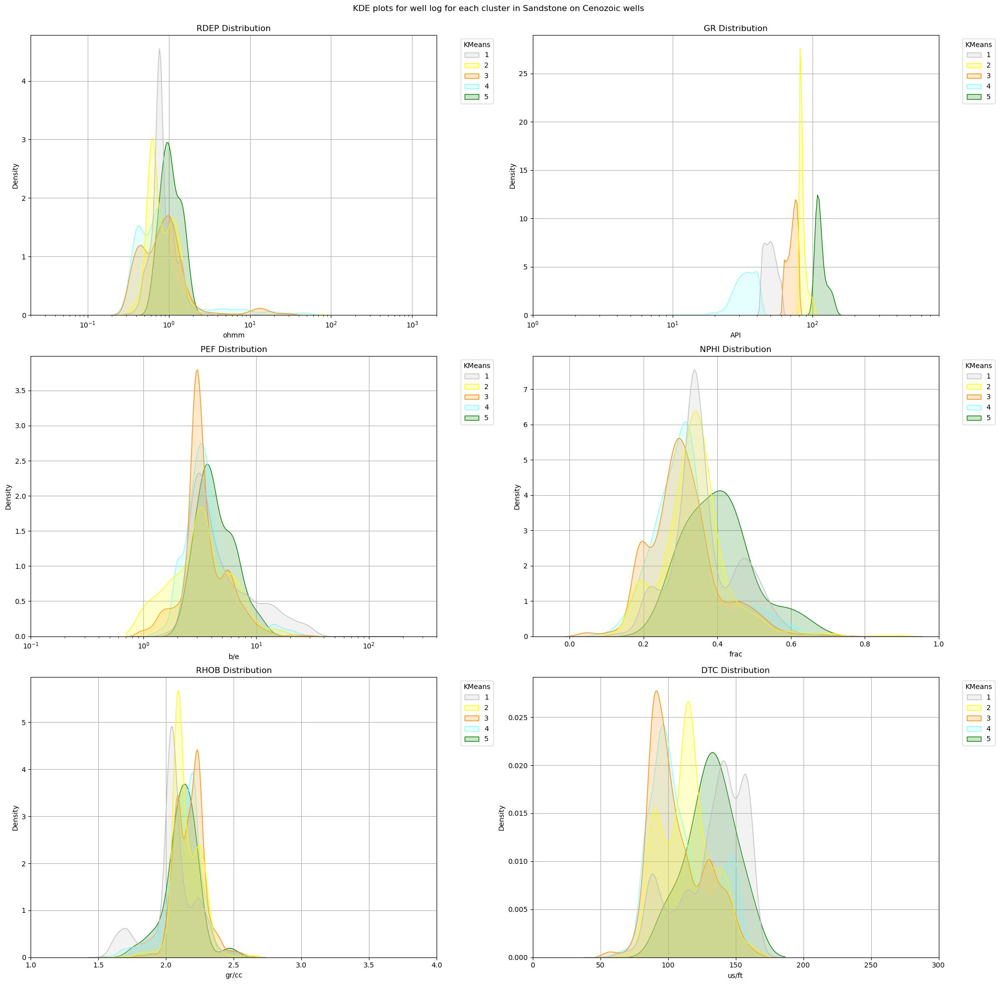

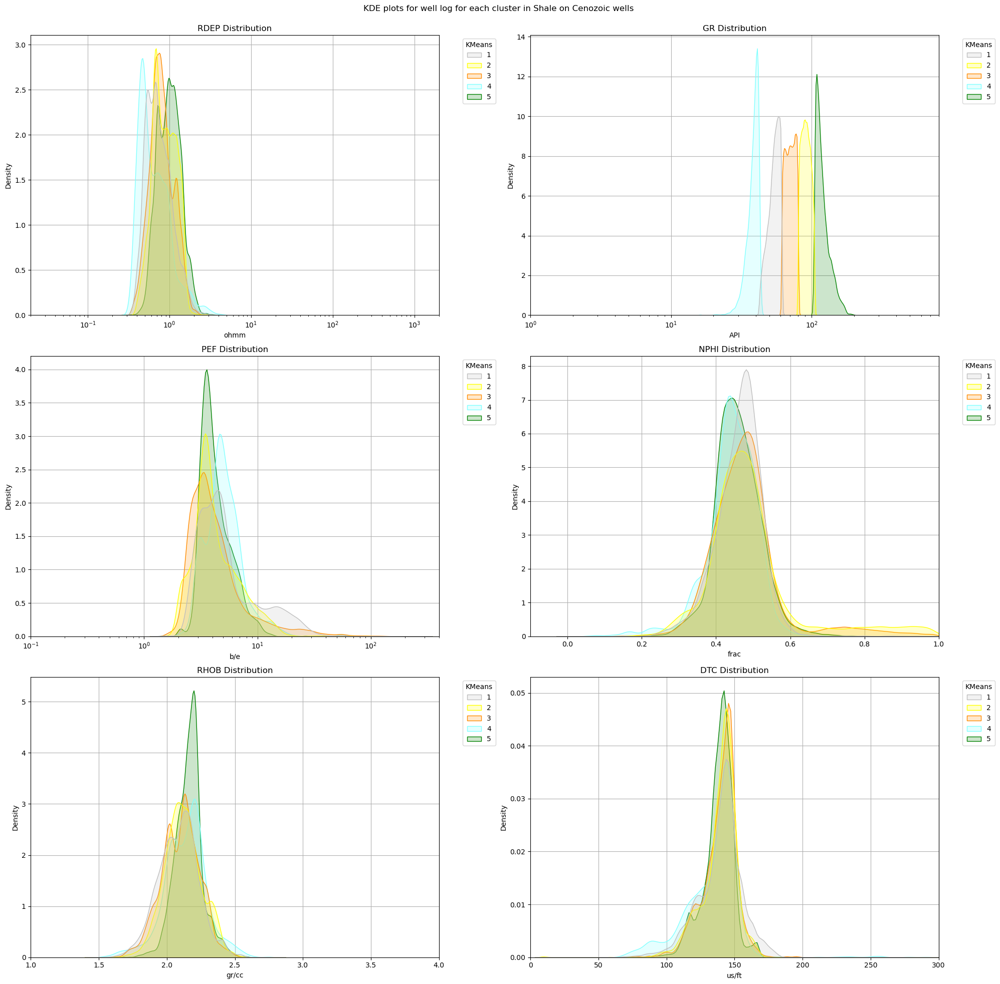

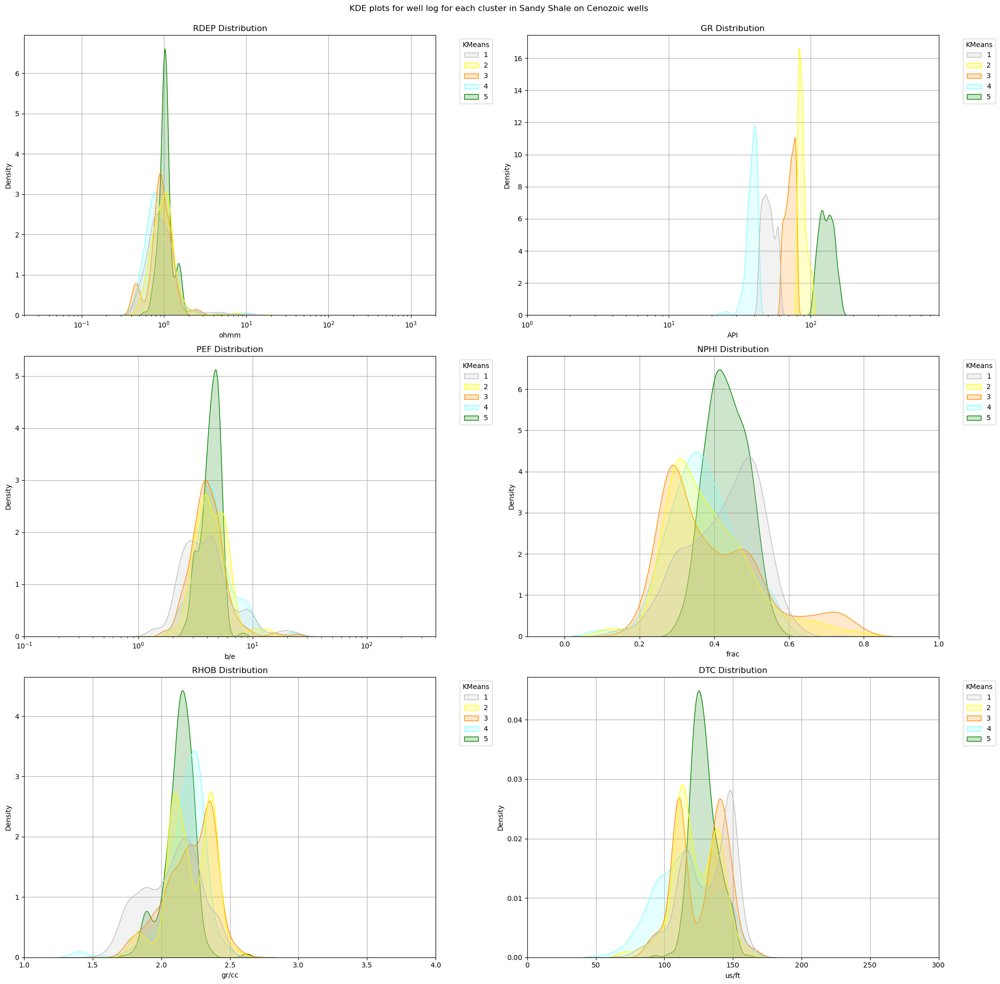

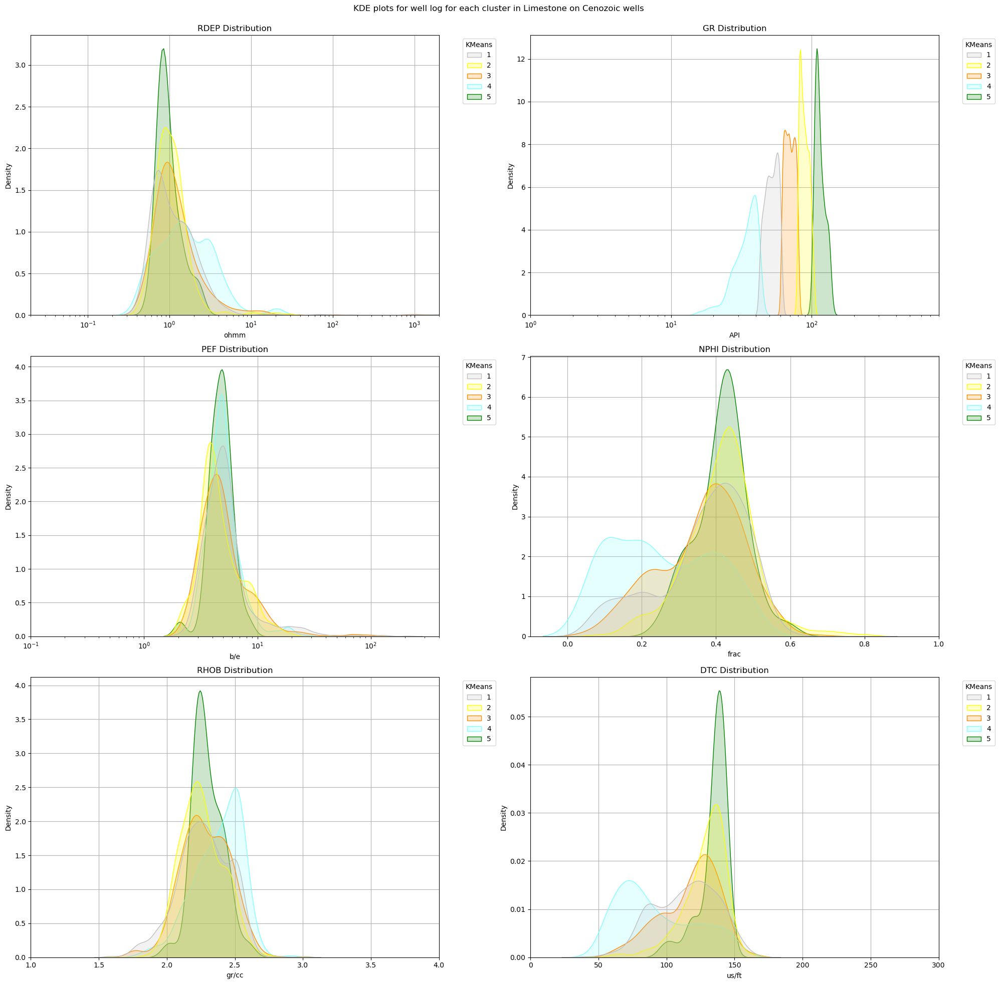

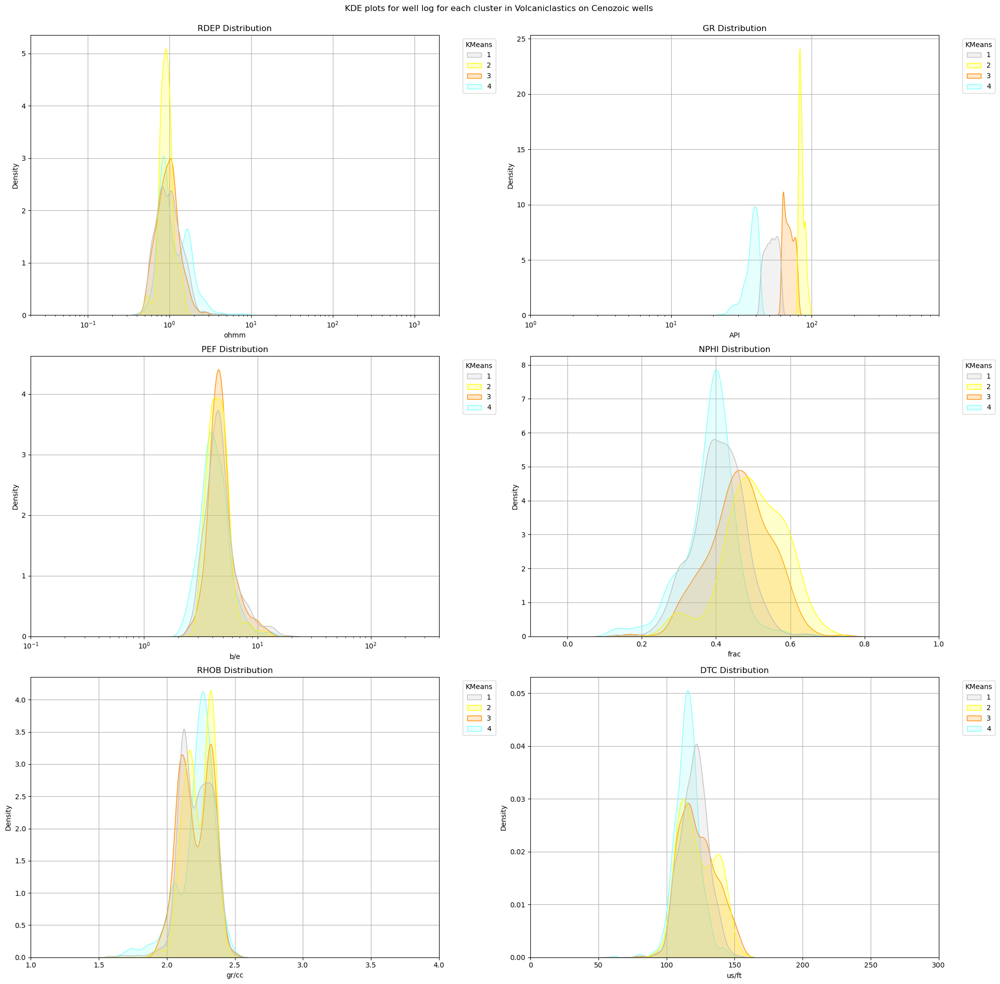

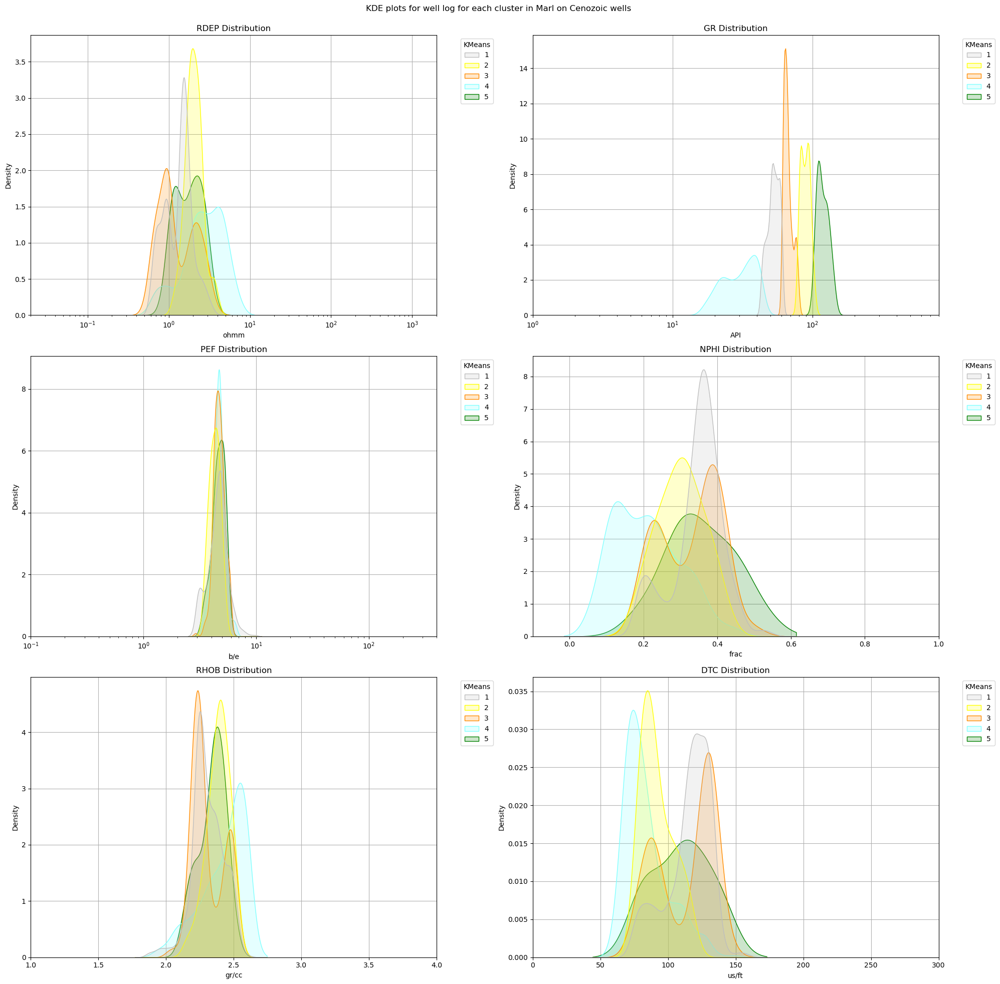

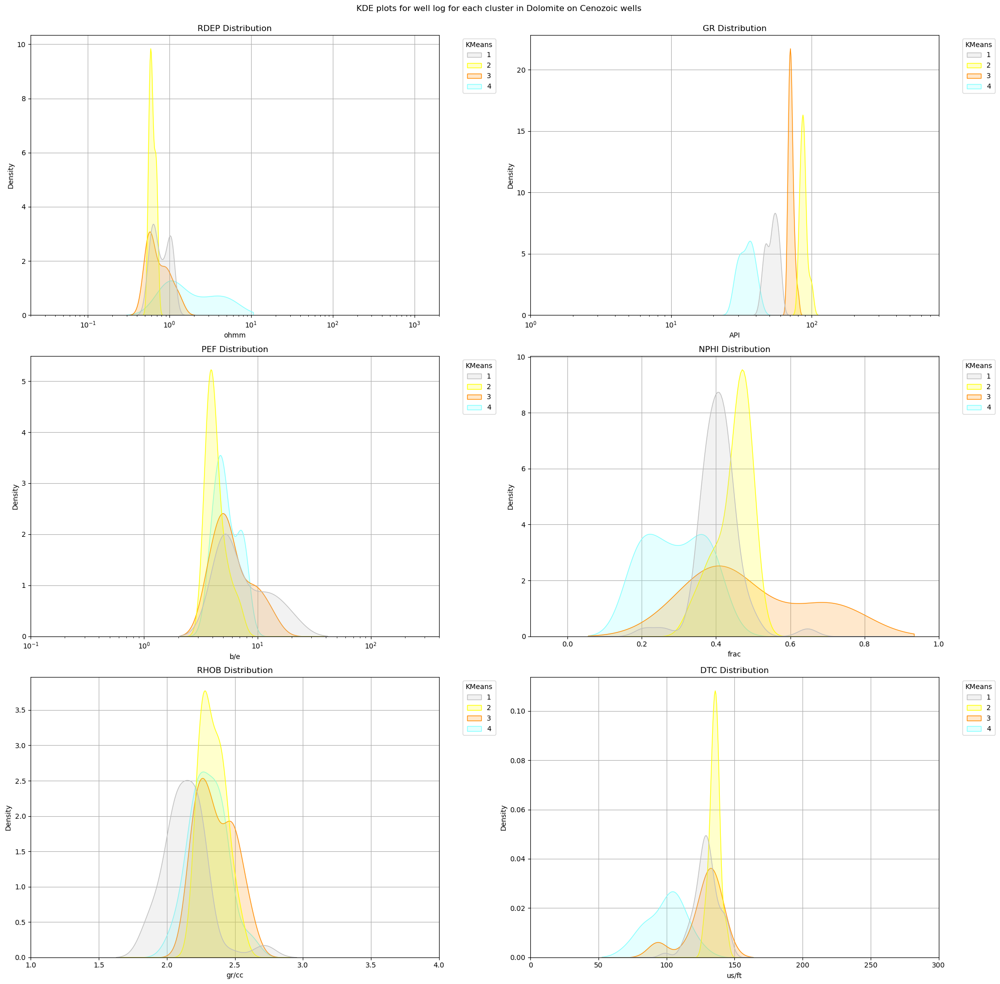

C:\Users\V330\AppData\Local\Temp\ipykernel_11160\3257747951.py:16: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_11160\3257747951.py:27: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
C:\Users\V330\AppData\Local\Temp\ipykernel_11160\3257747951.py:38: UserWarning: Dataset has 0 variance; skipping density estimate. Pass `warn_singular=False` to disable this warning.
  ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=fea

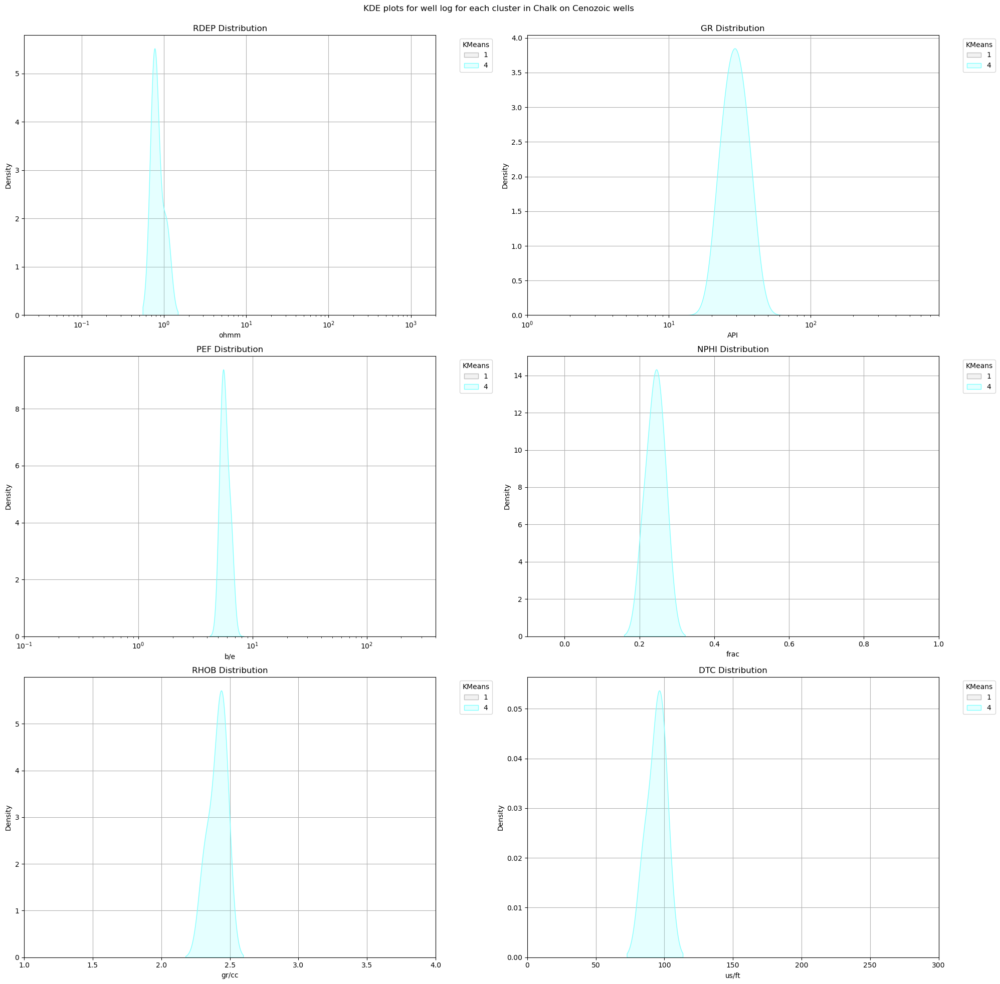

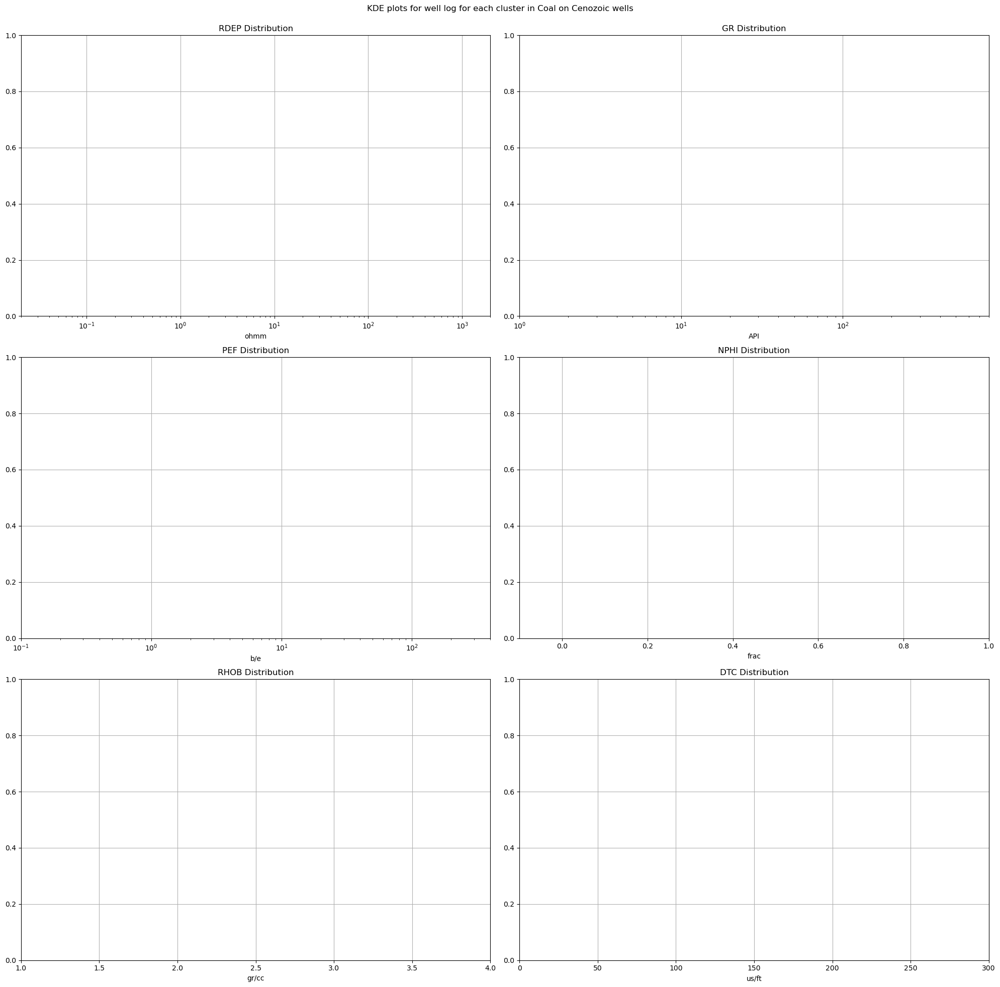

In [118]:
# KDE plots for each lithology group, cluster KMeans hue
for i, litho in enumerate(keys_lithology):
    fig = plt.figure(figsize=(20,20))
    fig.suptitle('KDE plots for well log for each cluster in '+str(litho)+ ' on Cenozoic wells')

    for i, feature in enumerate(well_clustered_curves):
        ax=fig.add_subplot(3,2,i+1)
        ax.set_title(feature+" Distribution")
        ax.set_axisbelow(True)
        
        if i==0:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(0.002),np.log10(2000),40), ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('ohmm')
            ax.set_xlim(0.02, 2000)
            
        elif i==1:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('API')
            ax.set_xlim(1, 800)
            
        elif i==2:
            #well.groupby('WELL')[feature].hist(bins=np.logspace(np.log10(1),np.log10(1000),40), ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=True, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("log")
            ax.set_xlabel('b/e')
            ax.set_xlim(0.1, 400)
        elif i==3:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('frac')
            ax.set_xlim(-0.1, 1)
        elif i==4:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('gr/cc')
            ax.set_xlim(1, 4)
            
        #elif i==5:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            #if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                #pass
            #else:
                #ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
                #sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            #ax.set_xscale("linear")
            #ax.set_xlabel('mV')
            #ax.set_xlim(-500, 500)
            
        else:
            #well.groupby('WELL')[feature].hist(bins=40, ax=ax, legend=False ,grid=True)
            if well_clustered[well_clustered['LIT']==litho][feature].unique().sum()==0:
                pass
            else:
                ax=sns.kdeplot(data=well_clustered[well_clustered['LIT']==litho], x=feature, hue='KMeans', fill=True, alpha=0.2, log_scale=False, palette=kmeanscolor, common_norm=False, common_grid=True)
                sns.move_legend(ax, loc='upper left', bbox_to_anchor=(1.05, 1.0))
            ax.set_xscale("linear")
            ax.set_xlabel('us/ft')
            ax.set_xlim(0, 300)
            
        ax.grid()
    
    
    plt.tight_layout()
    plt.subplots_adjust(top=0.95)#plt.subplots_adjust(hspace=0.15, wspace=0.5)
    plt.savefig('kdewelllogkmeans_'+str(litho)+'_cenozoicdata_old.png', bbox_inches='tight')
    plt.show()

## Logplot

The well log display will be created in triple-combo style in matplotlib to visualize the curves. The template will be incorporated into **triple_combo_plot** function, so it can be used depending on the selection of top and bottom depths of the graph.

The triple combo display will consists of:

- First track: Gamma Ray - Spectral Gamma Ray, Caliper, Bit size, SP
- Second track: Resistivities
- Third track: Density, Neutron, PEF
- Fourth track: Sonic (Compressional and Shear)
- Fifth track: Lithology log labels
- Sixth track: Clustering results


### Lithology labels


In [120]:
well_clustered['LITHOLOGY'].unique()

array([30000, 65000, 65030, 70000, 99000, 80000, 74000, 70032],
      dtype=int64)

In [121]:
lithology_numbers = {30000: {'lith':'Sandstone', 'lith_num':1, 'hatch': '', 'color':'#ffff00'},
                 65030: {'lith':'Sandy Shale', 'lith_num':2, 'hatch':'', 'color':'#c1f80a'},
                 65000: {'lith':'Shale', 'lith_num':3, 'hatch':'', 'color':'#bebebe'},
                 80000: {'lith':'Marl', 'lith_num':4, 'hatch':'', 'color':'#069af3'},
                 74000: {'lith':'Dolomite', 'lith_num':5, 'hatch':'', 'color':'#8080ff'},
                 70000: {'lith':'Limestone', 'lith_num':6, 'hatch':'', 'color':'#80ffff'},
                 70032: {'lith':'Chalk', 'lith_num':7, 'hatch':'', 'color':'#7bc8f6'},
                 88000: {'lith':'Halite', 'lith_num':8, 'hatch':'', 'color':'#7ddfbe'},
                 86000: {'lith':'Anhydrite', 'lith_num':9, 'hatch':'', 'color':'#ff80ff'},
                 99000: {'lith':'Volcaniclastics', 'lith_num':10, 'hatch':'', 'color':'#ff8c00'},
                 90000: {'lith':'Coal', 'lith_num':11, 'hatch':'', 'color':'black'},
                 93000: {'lith':'Basement', 'lith_num':12, 'hatch':'', 'color':'#ef138a'}}

df_lith = pd.DataFrame.from_dict(lithology_numbers, orient='index')
df_lith.index.name = 'LITHOLOGY'
df_lith

,lith,lith_num,hatch,color
LITHOLOGY,,,,
30000,Sandstone,1,,#ffff00
65030,Sandy Shale,2,,#c1f80a
65000,Shale,3,,#bebebe
80000,Marl,4,,#069af3
74000,Dolomite,5,,#8080ff
70000,Limestone,6,,#80ffff
70032,Chalk,7,,#7bc8f6
88000,Halite,8,,#7ddfbe
86000,Anhydrite,9,,#ff80ff


In [122]:
lith_code = dict(zip(df_lith.lith, df_lith.lith_num))
lith_colors = list(df_lith.color)
lith_cmap = ListedColormap(lith_colors)
lith_hatches = df_lith.hatch.to_list()

In [123]:
print(lith_code)
print(lith_colors)
#print(lith_cmap)
print(lith_hatches)

{'Sandstone': 1, 'Sandy Shale': 2, 'Shale': 3, 'Marl': 4, 'Dolomite': 5, 'Limestone': 6, 'Chalk': 7, 'Halite': 8, 'Anhydrite': 9, 'Volcaniclastics': 10, 'Coal': 11, 'Basement': 12}
['#ffff00', '#c1f80a', '#bebebe', '#069af3', '#8080ff', '#80ffff', '#7bc8f6', '#7ddfbe', '#ff80ff', '#ff8c00', 'black', '#ef138a']
['', '', '', '', '', '', '', '', '', '', '', '']


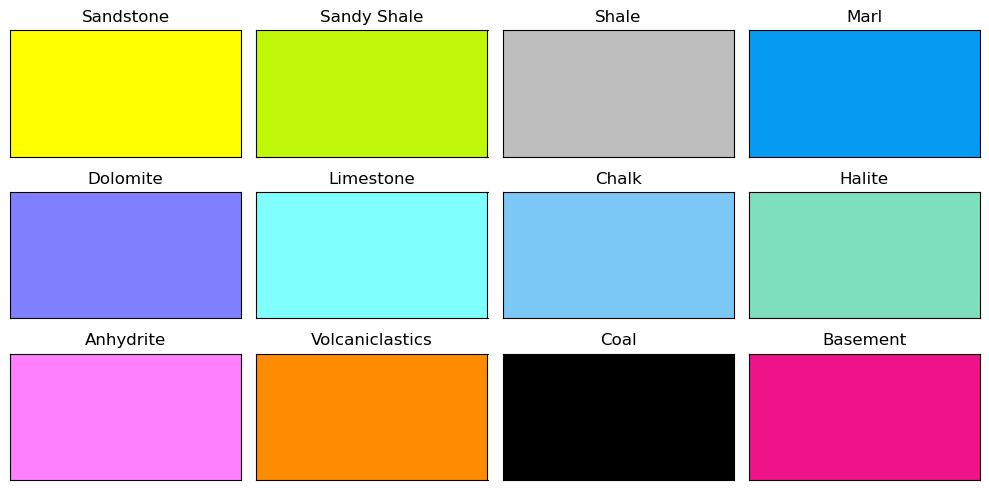

In [124]:
y = [0, 1]
x = [1, 1]

fig, axes = plt.subplots(ncols=4,nrows=3, sharex=True, sharey=True,
                         figsize=(10,5), subplot_kw={'xticks': [], 'yticks': []})

for ax, key in zip(axes.flat, lithology_numbers.keys()):
    ax.plot(x, y)
    ax.fill_betweenx(y, 0, 1, facecolor=lithology_numbers[key]['color'], hatch=lithology_numbers[key]['hatch'])
    ax.set_xlim(0, 0.1)
    ax.set_ylim(0, 1)
    ax.set_title(str(lithology_numbers[key]['lith']))

plt.tight_layout()

plt.show()

### Cluster labels


In [125]:
well_clustered['KMeans'].unique()

array([1, 3, 4, 2, 5], dtype=int64)

In [126]:
kmeans_numbers = {1: {'kmeans_num':1, 'hatch': '', 'color':'#bebebe'},
                 2: {'kmeans_num':2, 'hatch':'', 'color':'#ffff00'},
                 3: {'kmeans_num':3, 'hatch':'', 'color':'#ff8c00'},
                 4: {'kmeans_num':4, 'hatch':'', 'color':'#80ffff'},
                 5: {'kmeans_num':5, 'hatch':'', 'color':'#008100'}}

df_kmeans = pd.DataFrame.from_dict(kmeans_numbers, orient='index')
df_kmeans.index.name = 'KMeans'
df_kmeans

,kmeans_num,hatch,color
KMeans,,,
1,1,,#bebebe
2,2,,#ffff00
3,3,,#ff8c00
4,4,,#80ffff
5,5,,#008100


In [127]:
kmeans_code = dict(zip(df_kmeans.index, df_kmeans.kmeans_num))
kmeans_colors = list(df_kmeans.color)
kmeans_cmap = ListedColormap(kmeans_colors)
kmeans_hatches = df_kmeans.hatch.to_list()

In [128]:
print(kmeans_code)
print(kmeans_colors)
#print(kmeans_cmap)
print(kmeans_hatches)

{1: 1, 2: 2, 3: 3, 4: 4, 5: 5}
['#bebebe', '#ffff00', '#ff8c00', '#80ffff', '#008100']
['', '', '', '', '']


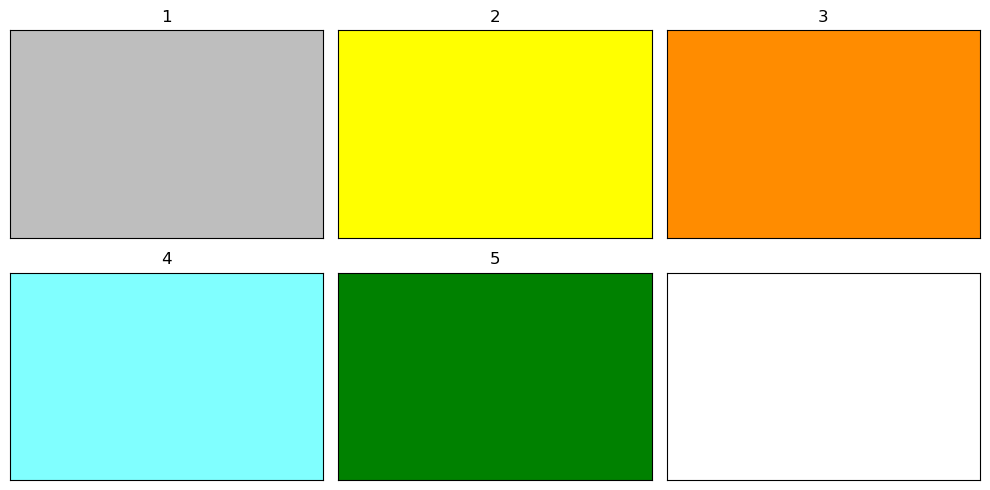

In [129]:
y = [0, 1]
x = [1, 1]

fig, axes = plt.subplots(ncols=3,nrows=2, sharex=True, sharey=True,
                         figsize=(10,5), subplot_kw={'xticks': [], 'yticks': []})

for ax, key in zip(axes.flat, kmeans_numbers.keys()):
    ax.plot(x, y)
    ax.fill_betweenx(y, 0, 1, facecolor=kmeans_numbers[key]['color'], hatch=kmeans_numbers[key]['hatch'])
    ax.set_xlim(0, 0.1)
    ax.set_ylim(0, 1)
    ax.set_title(str(kmeans_numbers[key]['kmeans_num']))

plt.tight_layout()

plt.show()

### Plotting


In [130]:
def triple_combo_plot(well_name, top_depth, bottom_depth):
    #Set well data
    well_data = well_clustered[well_clustered['WELL'] == well_name]
    logs=well_data[(well_data.DEPTH >= top_depth) & (well_data.DEPTH <= bottom_depth)]

    #Set plot axes
    fig, ax = plt.subplots(1,6, figsize=(24,48), sharey=True)
    fig.suptitle("Well " + str(well_name) + " Composite on Cenozoic interval", fontsize=22, va='baseline', y=1)
    fig.subplots_adjust(wspace=0.1)

    #General setting
    for axes in ax:
        axes.set_ylim(top_depth, bottom_depth)
        axes.invert_yaxis()
        axes.yaxis.grid(True, which='both')
        axes.get_yaxis().set_minor_locator(matplotlib.ticker.LogLocator())
        axes.get_xaxis().set_visible(False)
        axes.get_yaxis().set_visible(True)

        
    ## Track 1
    #Gamma Ray -- Main track
    ax11 = ax[0].twiny()
    ax11.plot("GR","DEPTH", data=logs, color="green")
    ax11.set_xlim(0, 250)
    ax11.set_xlabel("GR (API)", position='top',color='green')
    ax11.spines["top"].set_position(("outward", 5))
    ax11.spines["top"].set_edgecolor("green")
    ax11.tick_params(axis='x', colors="green")
    ax11.grid(True)

    #Caliper
    if logs['CALI'].count()==0:
        pass
    else:
        ax12 = ax[0].twiny()
        ax12.plot("CALI","DEPTH",'--', data=logs, color="black")
        ax12.set_xlim(6, 36)
        ax12.set_xlabel("CALI (inch)", position='top',color='black')
        ax12.spines["top"].set_position(("outward", 35))
        ax12.spines["top"].set_edgecolor("black")
        ax12.tick_params(axis='x', colors="black")
        ax12.set_xticks([6, 12, 18, 24, 30, 36])

    '''
    #SP
    if logs['SP'].count()==0:
        pass
    else:
        ax13 = ax[0].twiny()
        ax13.plot("SP","DEPTH", data=logs, color="blue")
        ax13.set_xlim(-600, 500)
        ax13.set_xlabel("SP (mV)", position='top',color='blue')
        ax13.spines["top"].set_position(("outward", 65))
        ax13.spines["top"].set_edgecolor("blue")
        ax13.tick_params(axis='x', colors="blue")
        ax13.set_xticks([-200, -100, 0, 100, 200])
    '''

    ##Track 2
    #Deep resistivity -- Main track
    ax21=ax[1].twiny()
    ax21.plot("RDEP","DEPTH", data=logs, color="red")
    ax21.set_xlim(0.2, 2000)
    ax21.set_xlabel("RDEP (ohmm)", position='top',color='red')
    ax21.set_xscale('log')
    ax21.spines["top"].set_position(("outward", 5))
    ax21.spines["top"].set_edgecolor("red")
    ax21.tick_params(axis='x', colors="red")
    ax21.set_xticks([0.2, 2, 20, 200, 2000])
    ax21.get_xaxis().set_major_formatter(matplotlib.ticker.ScalarFormatter())
    ax21.grid(True, which='both')
        
        
    ##Track 3
    #Density -- Main track
    ax31=ax[2].twiny()
    ax31.plot("RHOB","DEPTH", data=logs, color="red")
    ax31.set_xlim(1.95, 2.95)
    ax31.set_xlabel("RHOB (g/cm3)", position='top',color='red')
    ax31.spines["top"].set_position(("outward", 5))
    ax31.spines["top"].set_edgecolor("red")
    ax31.tick_params(axis='x', colors="red")
    ax31.set_xticks([1.95, 2.2, 2.45, 2.7, 2.95])
    ax31.grid(True)
        
    #Neutron
    ax32=ax[2].twiny()
    ax32.plot("NPHI","DEPTH", data=logs, color="green")
    ax32.set_xlim(-0.15, 0.45)
    ax32.invert_xaxis()
    ax32.set_xlabel("NPHI (frac)", position='top',color='green')
    ax32.spines["top"].set_position(("outward", 35))
    ax32.spines["top"].set_edgecolor("green")
    ax32.tick_params(axis='x', colors="green")
    ax32.set_xticks([-0.15, 0, 0.15, 0.30, 0.45])

    #PEF
    if logs['PEF'].count()==0:
        pass
    else:
        ax33=ax[2].twiny()
        ax33.plot("PEF","DEPTH", data=logs, color="purple")
        ax33.set_xlim(0, 20)
        ax33.set_xlabel("PEF (b/e)", position='top',color='purple')
        ax33.spines["top"].set_position(("outward", 65))
        ax33.spines["top"].set_edgecolor("purple")
        ax33.tick_params(axis='x', colors="purple")
        #ax33.set_xticks([140, 120, 100, 80, 60, 40])
        
        
    ##Track 4
    #Sonic compressional
    ax41=ax[3].twiny()
    ax41.plot("DTC","DEPTH", data=logs, color="purple")
    ax41.set_xlim(240, 40)
    ax41.set_xlabel("DTC (us/ft)", position='top',color='purple')
    ax41.spines["top"].set_position(("outward", 5))
    ax41.spines["top"].set_edgecolor("purple")
    ax41.tick_params(axis='x', colors="purple")
    #ax41.set_xticks([140, 120, 100, 80, 60, 40])
    ax41.grid(True)
    
        
    #Track 5
    ##Lithology log
    if logs['LIT'].count()==0:
        pass
    else:
        ax51=ax[4].twiny()
        #ax51.plot("LITHOLOGY","DEPTH", data=logs,  color = 'black', linewidth = 0.5)
        lithcode_values = logs['LIT'][:-1].map(lith_code).fillna(2).to_numpy(dtype=int)
        polycollection = ax51.pcolor( [0, 1], logs['DEPTH'], lithcode_values.reshape(-1, 1), cmap=lith_cmap, vmin=1, vmax=len(lith_colors))
        #ax51.set_xlim(0, 1)
        ax51.set_xlabel("LITHOLOGY", position='top',color='black')
        ax51.spines["top"].set_position(("outward", 0))
        ax51.spines["top"].set_edgecolor("black")
        ax51.tick_params(axis='x', colors="black")
        ax51.set_xticks([0, 1])
        
        for path, d2_val in zip(polycollection.get_paths(), lithcode_values):
            hatch = lith_hatches[d2_val - 1]
            if hatch != '':
                ax51.add_patch(PathPatch(path, hatch=hatch, facecolor='none', edgecolor='black'))

        hands = [Patch(facecolor=col, label=k, edgecolor='black') 
                 for k, col in zip(lith_code.keys(), lith_colors)]
        ax51.legend(handles=hands, bbox_to_anchor=(0.5, 1.05), loc='upper center', ncol=2, fontsize=12, facecolor=None)

    
    #Track 6
    ##KMeans log
    if logs['KMeans'].count()==0:
        pass
    else:
        ax61=ax[5].twiny()
        #ax51.plot("LITHOLOGY","DEPTH", data=logs,  color = 'black', linewidth = 0.5)
        #kmeanscode_values = logs['KMeans'][:-1].map(kmeans_code).fillna(2).to_numpy(dtype=int)
        kmeanscode_values = logs['KMeans'][:-1].map(kmeans_code).to_numpy()
        polycollection2 = ax61.pcolor( [0, 1], logs['DEPTH'], kmeanscode_values.reshape(-1, 1), cmap=kmeans_cmap, vmin=1, vmax=len(kmeans_colors))
        #ax51.set_xlim(0, 1)
        ax61.set_xlabel("KMeans Clusters", position='top',color='black')
        ax61.spines["top"].set_position(("outward", 0))
        ax61.spines["top"].set_edgecolor("black")
        ax61.tick_params(axis='x', colors="black")
        ax61.set_xticks([0, 1])
        
        for path, d2_val in zip(polycollection2.get_paths(), kmeanscode_values):
            hatch = kmeans_hatches[d2_val - 1]
            if hatch != '':
                ax61.add_patch(PathPatch(path, hatch=hatch, facecolor='none', edgecolor='black'))

        hands2 = [Patch(facecolor=col, label=k, edgecolor='black') 
                 for k, col in zip(kmeans_code.keys(), kmeans_colors)]
        ax61.legend(handles=hands2, bbox_to_anchor=(0.5, 1.04), loc='upper center', ncol=2, fontsize=14, facecolor=None)
    
    '''
    #Track 7
    ##GMM log
    if logs['GMM'].count()==0:
        pass
    else:
        ax71=ax[6].twiny()
        #ax51.plot("LITHOLOGY","DEPTH", data=logs,  color = 'black', linewidth = 0.5)
        #kmeanscode_values = logs['KMeans'][:-1].map(kmeans_code).fillna(2).to_numpy(dtype=int)
        gmmcode_values = logs['GMM'][:-1].map(kmeans_code).to_numpy()
        polycollection3 = ax71.pcolor( [0, 1], logs['DEPTH'], gmmcode_values.reshape(-1, 1), cmap=kmeans_cmap, vmin=1, vmax=len(kmeans_colors))
        #ax51.set_xlim(0, 1)
        ax71.set_xlabel("GMM Clusters", position='top',color='black')
        ax71.spines["top"].set_position(("outward", 0))
        ax71.spines["top"].set_edgecolor("black")
        ax71.tick_params(axis='x', colors="black")
        ax71.set_xticks([0, 1])
        
        for path, d2_val in zip(polycollection3.get_paths(), gmmcode_values):
            hatch = kmeans_hatches[d2_val - 1]
            if hatch != '':
                ax71.add_patch(PathPatch(path, hatch=hatch, facecolor='none', edgecolor='black'))

        hands2 = [Patch(facecolor=col, label=k, edgecolor='black') 
                 for k, col in zip(kmeans_code.keys(), kmeans_colors)]
        ax71.legend(handles=hands2, bbox_to_anchor=(0.5, 1.04), loc='upper center', ncol=2, fontsize=14, facecolor=None)
    '''
               
    fig.tight_layout()

In [160]:
well_clustered['WELL'].unique()

array(['15/9-13', '15/9-15', '15/9-17', '16/1-6 A', '16/10-1', '16/10-2',
       '16/10-3', '16/10-5', '16/2-11 A', '16/2-16', '16/2-6', '16/4-1',
       '16/5-3', '16/7-5', '25/11-19 S', '25/2-13 T4', '25/2-14',
       '25/2-7', '25/3-1', '25/4-5', '25/5-1', '25/5-4', '25/8-5 S',
       '25/8-7', '25/9-1', '26/4-1', '29/6-1', '30/3-5 S', '30/6-5',
       '31/2-19 S', '31/2-7', '31/2-8', '31/2-9', '31/3-2', '31/3-4',
       '31/4-5', '32/2-1', '33/6-3 S', '33/9-17', '34/10-21', '34/10-35',
       '34/11-2 S', '34/12-1', '34/2-4', '34/3-1 A', '34/4-10 R',
       '34/5-1 A', '34/5-1 S', '34/7-21', '34/8-1', '35/11-1', '35/11-11',
       '35/11-12', '35/11-13', '35/11-15 S', '35/11-6', '35/11-7',
       '35/12-1', '35/3-7 S', '35/4-1', '35/8-6 S', '35/9-10 S', '35/9-5',
       '35/9-6 S', '36/7-3', '7/1-2 S', '15/9-23', '16/2-7', '16/7-6',
       '25/10-9', '31/2-10', '31/2-21 S', '34/3-2 S', '35/11-5', '35/9-7'],
      dtype=object)

In [131]:
well['WELL'].nunique()

80

In [132]:
well_clustered['WELL'].nunique()

35

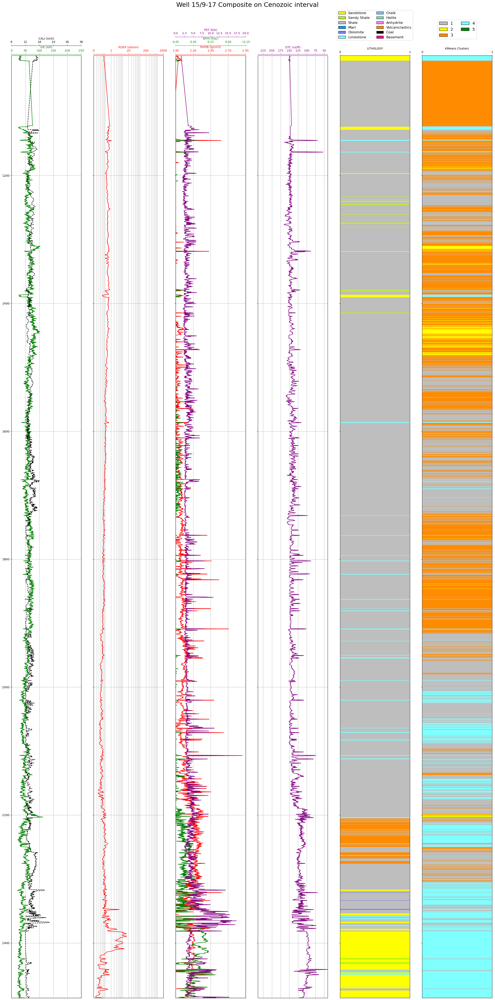

In [133]:
#Display logs for the whole well
triple_combo_plot('15/9-17',well_clustered[well_clustered['WELL'] == '15/9-17'].DEPTH.min(),well_clustered[well_clustered['WELL'] == '15/9-17'].DEPTH.max())

In [134]:
#Display logs for the whole well
for i, wellname in enumerate (well_clustered['WELL'].unique()):
    well_plot = triple_combo_plot(wellname,well_clustered[well_clustered['WELL'] == wellname].DEPTH.min(),well_clustered[well_clustered['WELL'] == wellname].DEPTH.max())
    well_name = wellname.replace('/', '-')
    plt.savefig('../improving-lithology-label-well-logs/Clustered well plot/Stratigraphy_old/02 Cenozoic/Composite_clustered_well_{}.png'.format(well_name),bbox_inches='tight')
    plt.close()

## Crossplots (not used)


In [ ]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection="3d")

ax.scatter(well_ex["NPHI"], well_ex["RHOB"], well_ex["DTC"], c=well_ex['GR'], cmap='rainbow')
ax.set_xlabel('NPHI')
ax.set_ylabel('RHOB')
ax.set_zlabel('DT')

plt.show()

In [ ]:
fig = go.Figure(data=[go.Scatter3d(
    x=well_ex["NPHI"],
    y=well_ex["RHOB"],
    z=well_ex["DTC"],
    mode='markers',
    marker=dict(
        size=8,
        color=well_ex["GR"],                # set color to an array/list of desired values
        opacity=0.8
    )
)])

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [ ]:
fig = plt.figure(figsize=(10, 10), layout="constrained")
spec = fig.add_gridspec(ncols=2, nrows=2)

ax1 = fig.add_subplot(spec[0, 0])
ax1.scatter(x= "NPHI", y= "RHOB", c = 'GR', data= well_ex, vmin)
ax1.set_ylim(3, 1)
ax1.set_ylabel("RHOB (g/cc)")
ax1.set_xlabel("NPHI (dec)")
ax1.grid(True)

ax2 = fig.add_subplot(spec[1, 0])
ax2.scatter(x= "NPHI", y= "DTC", c = 'GR', data= well_ex)
ax1.set_ylim(3, 1)
ax2.set_ylabel("DT (us/ft)")
ax2.set_xlabel("NPHI (dec)")
ax2.grid(True)

ax3 = fig.add_subplot(spec[0, 1])
ax3.scatter(x= "DTC", y= "RHOB", c = 'GR', data= well_ex)
ax3.set_ylim(3, 1)
ax3.set_ylabel("RHOB (g/cc)")
ax3.set_xlabel("DT (us/ft)")
ax3.grid(True)

ax4 = fig.add_subplot(spec[1, 1])
ax4.scatter(x= "GR", y= "DTC", data= well_ex)
ax4.set_ylabel("DT (us/ft)")
ax4.set_xlabel("GR (API)")
ax4.grid(True)

fig.tight_layout()